<a href="https://colab.research.google.com/github/kmeng01/rome/blob/main/notebooks/causal_trace.ipynb"><img src="https://colab.research.google.com/assets/colab-badge.svg" align="left"/></a>&nbsp;or in a local notebook.

In [ ]:
%%bash
!(stat -t /usr/local/lib/*/dist-packages/google/colab > /dev/null 2>&1) && exit
cd /content && rm -rf /content/memit
git clone https://github.com/kmeng01/memit memit > install.log 2>&1
pip install -r /content/memit/scripts/colab_reqs/rome.txt >> install.log 2>&1
pip install --upgrade google-cloud-storage >> install.log 2>&1

In [ ]:
IS_COLAB = False
try:
    import google.colab, torch, os

    IS_COLAB = True
    os.chdir("/content/memit")
    if not torch.cuda.is_available():
        raise Exception("Change runtime type to include a GPU.")
except ModuleNotFoundError as _:
    pass

[autoreload of util failed: Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/usr/local/lib/python3.10/dist-packages/IPython/extensions/autoreload.py", line 394, in superreload
    module = reload(module)
  File "/usr/lib/python3.10/imp.py", line 315, in reload
    return importlib.reload(module)
  File "/usr/lib/python3.10/importlib/__init__.py", line 168, in reload
    raise ModuleNotFoundError(f"spec not found for the module {name!r}", name=name)
ModuleNotFoundError: spec not found for the module 'util'
]
[autoreload of util.globals failed: Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/usr/local/lib/python3.10/dist-packages/IPython/extensions/autoreload.py", line 394, in superreload
    module = reload

## Causal Tracing

A demonstration of the double-intervention causal tracing method.

The strategy used by causal tracing is to understand important
states within a transfomer by doing two interventions simultaneously:

1. Corrupt a subset of the input.  In our paper, we corrupt the subject tokens
   to frustrate the ability of the transformer to accurately complete factual
   prompts about the subject.
2. Restore a subset of the internal hidden states.  In our paper, we scan
   hidden states at all layers and all tokens, searching for individual states
   that carry the necessary information for the transformer to recover its
   capability to complete the factual prompt.

The traces of decisive states can be shown on a heatmap.  This notebook
demonstrates the code for conducting causal traces and creating these heatmaps.

In [ ]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


The `experiments.causal_trace` module contains a set of functions for running causal traces.

In this notebook, we reproduce, demonstrate and discuss the interesting functions.

We begin by importing several utility functions that deal with tokens and transformer models.

In [ ]:
!pip install transformers

In [ ]:
pip install datasets

In [ ]:
import os, re, json
import torch, numpy
from collections import defaultdict
from util import nethook
from util.globals import DATA_DIR
from experiments.causal_trace import (
    ModelAndTokenizer,
    layername,
    guess_subject,
    plot_trace_heatmap,
)
from experiments.causal_trace import (
    make_inputs,
    decode_tokens,
    find_token_range,
    predict_token,
    predict_from_input,
    collect_embedding_std,
)
from dsets import KnownsDataset

torch.set_grad_enabled(False)

Now we load a model and tokenizer, and show that it can complete a couple factual statements correctly.

In [ ]:
!pip install accelerate

In [ ]:
model_name = "gpt2-xl"  # or "EleutherAI/gpt-j-6B" or "EleutherAI/gpt-neox-20b"
mt = ModelAndTokenizer(
    model_name,
    low_cpu_mem_usage=IS_COLAB,
    torch_dtype=(torch.float16 if "20b" in model_name else None),
)

In [ ]:
predict_token(
    mt,
    ["Megan Rapinoe plays the sport of", "The Space Needle is in the city of"],
    return_p=True,
)

([' soccer', ' Seattle'], tensor([0.7675, 0.9552], device='cuda:0'))

To obfuscate the subject during Causal Tracing, we use noise sampled from a zero-centered spherical Gaussian, whose stddev is 3 times the $\sigma$ stddev the model's embeddings. Let's compute that value.

In [ ]:
knowns = KnownsDataset(DATA_DIR)  # Dataset of known facts
noise_level = 3 * collect_embedding_std(mt, [k["subject"] for k in knowns])
print(f"Using noise level {noise_level}")

data/known_1000.json does not exist. Downloading from https://memit.baulab.info/data/dsets/known_1000.json


100%|██████████| 335k/335k [00:00<00:00, 2.00MB/s]


Loaded dataset with 1209 elements
Using noise level 0.13462981581687927


## Tracing a single location

The core intervention in causal tracing is captured in this function:

`trace_with_patch` a single causal trace.

It enables running a batch of inferences with two interventions.

  1. Random noise can be added to corrupt the inputs of some of the batch.
  2. At any point, clean non-noised state can be copied over from an
     uncorrupted batch member to other batch members.
  
The convention used by this function is that the zeroth element of the
batch is the uncorrupted run, and the subsequent elements of the batch
are the corrupted runs.  The argument tokens_to_mix specifies an
be corrupted by adding Gaussian noise to the embedding for the batch
inputs other than the first element in the batch.  Alternately,
subsequent runs could be corrupted by simply providing different
input tokens via the passed input batch.

To ensure that corrupted behavior is representative, in practice, we
will actually run several (ten) corrupted runs in the same batch,
each with its own sample of noise.

Then when running, a specified set of hidden states will be uncorrupted
by restoring their values to the same vector that they had in the
zeroth uncorrupted run.  This set of hidden states is listed in
states_to_patch, by listing [(token_index, layername), ...] pairs.
To trace the effect of just a single state, this can be just a single
token/layer pair.  To trace the effect of restoring a set of states,
any number of token indices and layers can be listed.

Note that this function is also in experiments.causal_trace; the code
is shown here to show the logic.

In [ ]:
def trace_with_patch(
    model,  # The model
    inp,  # A set of inputs
    states_to_patch,  # A list of (token index, layername) triples to restore
    answers_t,  # Answer probabilities to collect
    tokens_to_mix,  # Range of tokens to corrupt (begin, end)
    noise=0.1,  # Level of noise to add
    trace_layers=None,  # List of traced outputs to return
):
    prng = numpy.random.RandomState(1)  # For reproducibility, use pseudorandom noise
    patch_spec = defaultdict(list)
    for t, l in states_to_patch:
        patch_spec[l].append(t)
    embed_layername = layername(model, 0, "embed")

    def untuple(x):
        return x[0] if isinstance(x, tuple) else x

    # Define the model-patching rule.
    def patch_rep(x, layer):
        if layer == embed_layername:
            # If requested, we corrupt a range of token embeddings on batch items x[1:]
            if tokens_to_mix is not None:
                b, e = tokens_to_mix
                x[1:, b:e] += noise * torch.from_numpy(
                    prng.randn(x.shape[0] - 1, e - b, x.shape[2])
                ).to(x.device)
            return x
        if layer not in patch_spec:
            return x
        # If this layer is in the patch_spec, restore the uncorrupted hidden state
        # for selected tokens.
        h = untuple(x)
        for t in patch_spec[layer]:
            h[1:, t] = h[0, t]
        return x

    # With the patching rules defined, run the patched model in inference.
    additional_layers = [] if trace_layers is None else trace_layers
    with torch.no_grad(), nethook.TraceDict(
        model,
        [embed_layername] + list(patch_spec.keys()) + additional_layers,
        edit_output=patch_rep,
    ) as td:
        outputs_exp = model(**inp)

    # We report softmax probabilities for the answers_t token predictions of interest.
    probs = torch.softmax(outputs_exp.logits[1:, -1, :], dim=1).mean(dim=0)[answers_t]

    # If tracing all layers, collect all activations together to return.
    if trace_layers is not None:
        all_traced = torch.stack(
            [untuple(td[layer].output).detach().cpu() for layer in trace_layers], dim=2
        )
        return probs, all_traced

    return probs

## Scanning all locations

A causal flow heatmap is created by repeating `trace_with_patch` at every individual hidden state, and measuring the impact of restoring state at each location.

The `calculate_hidden_flow` function does this loop.  It handles both the case of restoring a single hidden state, and also restoring MLP or attention states.  Because MLP and attention make small residual contributions, to observe a causal effect in those cases, we need to restore several layers of contributions at once, which is done by `trace_important_window`.

In [ ]:
def calculate_hidden_flow(
    mt, prompt, subject, samples=10, noise=0.1, window=10, kind=None
):
    """
    Runs causal tracing over every token/layer combination in the network
    and returns a dictionary numerically summarizing the results.
    """
    inp = make_inputs(mt.tokenizer, [prompt] * (samples + 1))
    with torch.no_grad():
        answer_t, base_score = [d[0] for d in predict_from_input(mt.model, inp)]
    [answer] = decode_tokens(mt.tokenizer, [answer_t])
    e_range = find_token_range(mt.tokenizer, inp["input_ids"][0], subject)
    low_score = trace_with_patch(
        mt.model, inp, [], answer_t, e_range, noise=noise
    ).item()
    subj_prob = 0
    # if not kind:
    #     differences = trace_important_states(
    #         mt.model, mt.num_layers, inp, e_range, answer_t, noise=noise
    #     )
    # else:
    differences, subj_prob = trace_important_window(
        mt.model,
        mt.num_layers,
        inp,
        e_range,
        answer_t,
        noise=noise,
        window=window,
        kind=kind,
    )
    differences = differences.detach().cpu()
    # if not kind:
    #   return dict(
    #       scores=differences,
    #       low_score=low_score,
    #       high_score=base_score,
    #       input_ids=inp["input_ids"][0],
    #       input_tokens=decode_tokens(mt.tokenizer, inp["input_ids"][0]),
    #       subject_range=e_range,
    #       answer=answer,
    #       window=window,
    #       kind=kind or "",

    #   )

    # else:
    return (dict(
    scores=differences,
    low_score=low_score,
    high_score=base_score,
    input_ids=inp["input_ids"][0],
    input_tokens=decode_tokens(mt.tokenizer, inp["input_ids"][0]),
    subject_range=e_range,
    answer=answer,
    window=window,
    kind=kind or "",

), subj_prob)



def trace_important_states(model, num_layers, inp, e_range, answer_t, noise=0.1):
    ntoks = inp["input_ids"].shape[1]
    table = []
    for tnum in range(ntoks):
        row = []
        for layer in range(0, num_layers):
            r = trace_with_patch(
                model,
                inp,
                [(tnum, layername(model, layer))],
                answer_t,
                tokens_to_mix=e_range,
                noise=noise,
            )


            row.append(r)

        table.append(torch.stack(row))

    return torch.stack(table)


def trace_important_window(
    model, num_layers, inp, e_range, answer_t, kind, window=10, noise=0.1
):
    ntoks = inp["input_ids"].shape[1]
    table = []
    for tnum in range(ntoks):
        row = []
        for layer in range(0, num_layers):
            layerlist = [
                (tnum, layername(model, L, kind))
                for L in range(
                    max(0, layer - window // 2), min(num_layers, layer - (-window // 2))
                )
            ]
            r = trace_with_patch(
                model, inp, layerlist, answer_t, tokens_to_mix=e_range, noise=noise
            )

            row.append(r)
        table.append(torch.stack(row))
    #print('--------------------------------------')
    #print(torch.stack(table)[e_range[1] - 1])

    return torch.stack(table), torch.stack(table)[e_range[1] - 1]

## Plotting the results

The `plot_trace_heatmap` function draws the data on a heatmap.  That function is not shown here; it is in `experiments.causal_trace`.


In [ ]:
def plot_hidden_flow(
    mt,
    prompt,
    subject=None,
    samples=10,
    noise=0.1,
    window=10,
    kind=None,
    modelname=None,
    savepdf=None,
):

    if subject is None:
        subject = guess_subject(prompt)

    result, subj_prob = calculate_hidden_flow(
      mt, prompt, subject, samples=samples, noise=noise, window=window, kind=kind
    )
    #print(result)
    #print(result['scores'].shape)
    #plot_trace_heatmap(result, savepdf, modelname=modelname)

    # if kind == "mlp":
    #   fig, ax = plt.subplots()
    #   #print(subj_prob)
    #   ax.barh(range(len(subj_prob.cpu())), subj_prob.cpu(), color='blue')
    #   #h = ax.imshow([subj_prob], cmap='YlGnBu', aspect = 'auto')
    #   #plt.colorbar(h)
    #   ax.set_title('Activation for subject token')
    #   plt.show()


    return subj_prob




def plot_all_flow(mt, prompt, subject=None, noise=0.1, modelname=None):
    subj_prob = 0
    for kind in ["mlp"]:#[None, "mlp", "attn"]:
        subj_prob = plot_hidden_flow(
            mt, prompt, subject, modelname=modelname, noise=noise, kind=kind
        )
    return subj_prob

## Sports subject corruption activations

In [ ]:
sentences = [
    "Serena Williams plays the sport of",
    "Lionel Messi plays the sport of",
    "Novak Djokovic plays the sport of",
    "Cristiano Ronaldo plays the sport of",
    "Tom Brady plays the sport of",
    "Rafael Nadal plays the sport of",
    "Roger Federer plays the sport of",
    "Virat Kohli plays the sport of",
    "AJ Styles plays the sport of",
    "LeBron James plays the sport of",
    "Aaron Rodgers plays the sport of",
    "Stephen Curry plays the sport of",
    "Muhammad Ali plays the sport of",
    "John Cena plays the sport of",
    "The Nature Boy Ric Flair plays the sport of",
    "Neymar Jr. plays the sport of",
    "Kurt Angle plays the sport of",
    "Magnus Carlsen plays the sport of",
    "Mohamed Salah plays the sport of",
    "Anthony Davis  plays the sport of",
    "Roman Reigns plays the sport of",
    "Tiger Woods plays the sport of",
    "Sidney Crosby plays the sport of",
    "Gennady Golovkin plays the sport of",
    "Russell Wilson plays the sport of",
    "Wayne Gretzky plays the sport of",
    "Mike Tyson plays the sport of",
    "Viswanathan Anand plays the sport of",
    "Shawn Michaels plays the sport of",
    "Kevin Durant plays the sport of",
    "Jon Jones plays the sport of",
    "Kylian Mbappé plays the sport of",
    "Rory McIlroy plays the sport of",
    "Lamar Jackson plays the sport of",
    "Patrick Mahomes plays the sport of",
    "Kofi Kingston plays the sport of",
    "Alexander Ovechkin plays the sport of",
    "Manny Pacquiao plays the sport of",
    "James Harden  plays the sport of",
    "Judit Polgár plays the sport of",
    "Conor McGregor plays the sport of",
    "Connor McDavid plays the sport of",
    "Giannis Antetokounmpo plays the sport of",
    "Damian Lillard plays the sport of",
    "Bobby Orr plays the sport of",
    "Hou Yifan plays the sport of",
    "Hikaru Nakamura plays the sport of",
    "J.J. Watt plays the sport of",
    "Khabib Nurmagomedov plays the sport of",
    "Shikhar Dhawan plays the sport of",
    "Valentina Shevchenko plays the sport of",
    "Evander Holyfield plays the sport of",
    "Jordan Spieth plays the sport of",
    "Joe Root plays the sport of",
    "Devin Booker plays the sport of",
    "Jack Grealish plays the sport of",
    "Jack Grealish  plays the sport of",
    "Mario Lemieux plays the sport of",
    "Mohammed Shami plays the sport of",
    "Steven Stamkos plays the sport of",
    "Richie McCaw plays the sport of",
    "Jaromir Jagr plays the sport of",
    "Babar Azam plays the sport of",
    "Martin Brodeur plays the sport of",
    "Jonny Wilkinson plays the sport of",
    "Teemu Selanne plays the sport of",
    "Joel Embiid plays the sport of",
    "Christian McCaffrey plays the sport of",
    "Joe Sakic plays the sport of",
    "Dustin Johnson plays the sport of",
    "Rohit Sharma plays the sport of",
    "Khalil Mack plays the sport of",
    "Rose Namajunas plays the sport of",
    "Gordie Howe plays the sport of",
    "Max Holloway plays the sport of",
    "Fabiano Caruana plays the sport of",
    "Allan Donald plays the sport of",
    "Brian O'Driscoll plays the sport of",
    "Brett Hull plays the sport of",
    "Dimuth Karunaratne plays the sport of",
    "Jonah Lomu plays the sport of",
    "Dale Steyn plays the sport of",
    "Amanda Nunes plays the sport of",
    "Vladimir Kramnik plays the sport of",
    "Cheteshwar Pujara plays the sport of",
    "Levon Aronian plays the sport of",
    "Bradley Beal plays the sport of",
    "Patrick Roy plays the sport of",
    "Faf du Plessis plays the sport of",
    "Mark Messier plays the sport of",
    "Jacques Kallis plays the sport of",
    "Evgeni Malkin plays the sport of",
    "Ajinkya Rahane plays the sport of",
    "Jonathan Toews plays the sport of",
    "Stipe Miocic plays the sport of",
    "Mithali Raj plays the sport of",
    "Claressa Shields plays the sport of",
    "Graeme Smith plays the sport of",
    "Ravindra Jadeja plays the sport of",
    "KL Rahul plays the sport of",
    "Oliver Bjorkstrand plays the sport of",
    "Rashid Khan plays the sport of",
    "Hashim Amla plays the sport of",
    "Teimour Radjabov plays the sport of",
    "Nikita Kucherov plays the sport of",
    "Dan Carter plays the sport of",
    "Sergey Karjakin plays the sport of",
    "Pentala Harikrishna plays the sport of",
    "Pavel Datsyuk plays the sport of",
    "Ishant Sharma plays the sport of",
    "Juuse Saros plays the sport of",
    "Semi Radradra plays the sport of",
    "Anish Giri plays the sport of",
    "Olli Maatta plays the sport of",
    "Veselin Topalov plays the sport of",
    "David Pocock plays the sport of",
    "Jasprit Bumrah plays the sport of",
    "Sergio Parisse plays the sport of",
    "Vince Dunn plays the sport of",
    "Stuart Hogg plays the sport of",
    "Hardik Pandya plays the sport of",
    "Boris Gelfand  plays the sport of",
    "Duván Zapata plays the sport of",
    "Mako Vunipola plays the sport of",
    "Mark Boucher plays the sport of",
    "Prithvi Shaw plays the sport of",
    "Herschelle Gibbs plays the sport of",
    "Codie Taylor plays the sport of",
    "Suryakumar Yadav plays the sport of",
    "Ding Liren plays the sport of",
    "Shreyas Iyer plays the sport of",
    "Kuldeep Yadav plays the sport of",
    "Maxime Vachier-Lagrave plays the sport of",
    "Jordie Barrett plays the sport of",
    "Courtney Lawes plays the sport of",
    "Dan Biggar plays the sport of",
    "Shakhriyar Mamedyarov plays the sport of",
    "Mayank Agarwal plays the sport of",
    "Jakub Vrana plays the sport of",
    "Alexandra Kosteniuk plays the sport of",
    "Shaun Pollock plays the sport of",
    "Darnell Nurse plays the sport of",
    "A.J. Terrell plays the sport of",
    "Shardul Thakur plays the sport of",
    "Andreas Johnsson plays the sport of",
    "Bhuvneshwar Kumar plays the sport of",
    "Alex Tuch plays the sport of",
    "Romain Ntamack plays the sport of",
    "Taskin Ahmed plays the sport of",
    "Javonte Williams plays the sport of",
    "Shafali Verma plays the sport of",
    "Christian Dvorak plays the sport of",
    "Deepak Chahar plays the sport of",
    "Tadhg Furlong plays the sport of",
    "Devin Shore plays the sport of",
    "Calle Jarnkrok plays the sport of",
    "Trevor Zegras plays the sport of",
    "Kaapo Kahkonen plays the sport of",
    "Marcell Coetzee plays the sport of",
    "Mariya Muzychuk plays the sport of",
    "Leinier Dominguez plays the sport of",
    "Jamie Ritchie plays the sport of",
    "Sam Underhill plays the sport of",
    "Alina Kashlinskaya plays the sport of",
    "Anton Korobov plays the sport of",
    "Lachlan Boshier plays the sport of",
    "Adam Boqvist plays the sport of",
    "Jordan Larmour plays the sport of",
    "Martin Johnson plays the sport of",
    "Josh Adams plays the sport of",
    "Andrew Shaw plays the sport of",
    "Taniela Tupou plays the sport of",
    "Naseem Shah plays the sport of",
    "Caleb Clarke plays the sport of"
]

import pandas as pd
df = pd.DataFrame({})
for s in sentences:

  val = plot_all_flow(mt, s, noise=noise_level)
  #print(val)
  temp_df = pd.DataFrame(val.cpu().numpy()).transpose()
  df = pd.concat([df, temp_df])
  df.to_csv('df_causal_trace_sports_subject.csv')


## Plotting popular sports facts average activations

In [ ]:
prompts = [
    "Serena Williams plays the sport of",
    "Lionel Messi plays the sport of",
    "Novak Djokovic plays the sport of",
    "Cristiano Ronaldo plays the sport of",
    "Tom Brady plays the sport of",
    "Rafael Nadal plays the sport of",
    "Roger Federer plays the sport of",
    "Virat Kohli plays the sport of",
    "AJ Styles plays the sport of",
    "LeBron James plays the sport of",
    "Aaron Rodgers plays the sport of",
    "Stephen Curry plays the sport of",
    "Muhammad Ali plays the sport of",
    "John Cena plays the sport of",
    "The Nature Boy Ric Flair plays the sport of",
    "Neymar Jr. plays the sport of",
    "Kurt Angle plays the sport of",
    "Magnus Carlsen plays the sport of",
    "Mohamed Salah plays the sport of",
    "Anthony Davis  plays the sport of",
    "Roman Reigns plays the sport of",
    "Tiger Woods plays the sport of",
    "Sidney Crosby plays the sport of",
    "Gennady Golovkin plays the sport of",
    "Russell Wilson plays the sport of",
    "Wayne Gretzky plays the sport of",
    "Mike Tyson plays the sport of",
    "Viswanathan Anand plays the sport of",
    "Shawn Michaels plays the sport of",
    "Kevin Durant plays the sport of",
    "Jon Jones plays the sport of",
    "Kylian Mbappé plays the sport of",
    "Rory McIlroy plays the sport of",
    "Lamar Jackson plays the sport of",
    "Patrick Mahomes plays the sport of",
    "Kofi Kingston plays the sport of",
    "Alexander Ovechkin plays the sport of",
    "Manny Pacquiao plays the sport of",
    "James Harden  plays the sport of",
    "Judit Polgár plays the sport of",
    "Conor McGregor plays the sport of",
    "Connor McDavid plays the sport of",
    "Giannis Antetokounmpo plays the sport of",
    "Damian Lillard plays the sport of",
    "Bobby Orr plays the sport of",
    "Hou Yifan plays the sport of",
    "Hikaru Nakamura plays the sport of",
    "J.J. Watt plays the sport of",
    "Khabib Nurmagomedov plays the sport of",
    "Shikhar Dhawan plays the sport of",
    "Valentina Shevchenko plays the sport of",
    "Evander Holyfield plays the sport of",
    "Jordan Spieth plays the sport of",
    "Joe Root plays the sport of",
    "Devin Booker plays the sport of",
    "Jack Grealish plays the sport of",
    "Jack Grealish  plays the sport of",
    "Mario Lemieux plays the sport of",
    "Mohammed Shami plays the sport of",
    "Steven Stamkos plays the sport of",
    "Richie McCaw plays the sport of",
    "Jaromir Jagr plays the sport of",
    "Babar Azam plays the sport of",
    "Martin Brodeur plays the sport of",
    "Jonny Wilkinson plays the sport of",
    "Teemu Selanne plays the sport of",
    "Joel Embiid plays the sport of",
    "Christian McCaffrey plays the sport of",
    "Joe Sakic plays the sport of",
    "Dustin Johnson plays the sport of"
]

c = 0
unique_sentence = []
subj_prob_list = []
for prompt in prompts:
  val = plot_all_flow(mt, prompt, noise=noise_level)
  # if val != None:
  subj_prob_list.append(val)


KeyboardInterrupt: ignored

In [ ]:
import numpy as np
avg_prob_values = [x.cpu() for x in subj_prob_list]
#avg_prob_values = np.mean(np.array(), axis = 0)

In [ ]:
np.save("/content/avg_prob_list_sport", avg_prob_values)

/usr/local/lib/python3.10/dist-packages/numpy/lib/npyio.py:521: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  arr = np.asanyarray(arr)
/usr/local/lib/python3.10/dist-packages/numpy/lib/npyio.py:521: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


In [ ]:
import numpy as np
a = np.load('/content/avg_prob_list_sport.npy', allow_pickle=True)
a1 = np.array([t.numpy() for t in a])
a2 = np.mean(a1, axis = 0)
a2

array([0.2432691 , 0.24413812, 0.24459451, 0.2472625 , 0.2429224 ,
       0.24960344, 0.23031834, 0.233644  , 0.19676006, 0.17210579,
       0.18896882, 0.23770401, 0.27009737, 0.31514737, 0.34731752,
       0.3715441 , 0.38401237, 0.39686137, 0.3710707 , 0.34770346,
       0.3189193 , 0.27538544, 0.22007166, 0.19198096, 0.17302155,
       0.14119473, 0.13099647, 0.12100212, 0.11291333, 0.11186285,
       0.10970442, 0.10318094, 0.1040727 , 0.09363249, 0.09162849,
       0.08736077, 0.083622  , 0.08144907, 0.08057719, 0.07922085,
       0.07801329, 0.07722664, 0.07661433, 0.07635434, 0.07575437,
       0.07559141, 0.07554101, 0.07555545], dtype=float32)

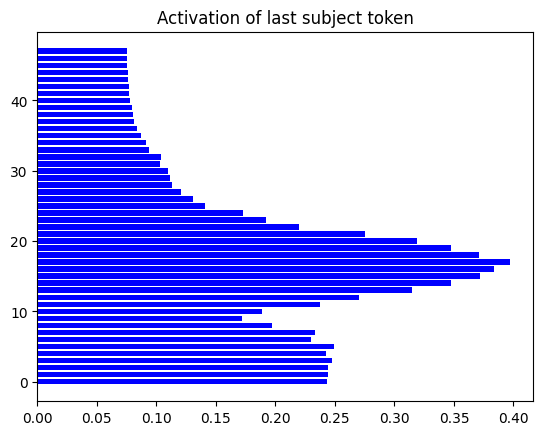

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
ax.barh(range(len(a2)), a2, color='blue')
ax.set_title('Activation of last subject token')
plt.show()


## Plotting rare sports facts average activations

In [ ]:
players = [
    "Teimour Radjabov plays the sport of",
    "Nikita Kucherov plays the sport of",
    "Dan Carter plays the sport of",
    "Sergey Karjakin plays the sport of",
    "Pentala Harikrishna plays the sport of",
    "Pavel Datsyuk plays the sport of",
    "Ishant Sharma plays the sport of",
    "Juuse Saros plays the sport of",
    "Semi Radradra plays the sport of",
    "Anish Giri plays the sport of",
    "Olli Maatta plays the sport of",
    "Veselin Topalov plays the sport of",
    "David Pocock plays the sport of",
    "Jasprit Bumrah plays the sport of",
    "Sergio Parisse plays the sport of",
    "Vince Dunn plays the sport of",
    "Stuart Hogg plays the sport of",
    "Hardik Pandya plays the sport of",
    "Boris Gelfand  plays the sport of",
    "Duván Zapata plays the sport of",
    "Mako Vunipola plays the sport of",
    "Mark Boucher plays the sport of",
    "Prithvi Shaw plays the sport of",
    "Herschelle Gibbs plays the sport of",
    "Codie Taylor plays the sport of",
    "Suryakumar Yadav plays the sport of",
    "Ding Liren plays the sport of",
    "Shreyas Iyer plays the sport of",
    "Kuldeep Yadav plays the sport of",
    "Maxime Vachier-Lagrave plays the sport of",
    "Jordie Barrett plays the sport of",
    "Courtney Lawes plays the sport of",
    "Dan Biggar plays the sport of",
    "Shakhriyar Mamedyarov plays the sport of",
    "Mayank Agarwal plays the sport of",
    "Jakub Vrana plays the sport of",
    "Alexandra Kosteniuk plays the sport of",
    "Shaun Pollock plays the sport of",
    "Darnell Nurse plays the sport of",
    "A.J. Terrell plays the sport of",
    "Shardul Thakur plays the sport of",
    "Andreas Johnsson plays the sport of",
    "Bhuvneshwar Kumar plays the sport of",
    "Alex Tuch plays the sport of",
    "Romain Ntamack plays the sport of",
    "Taskin Ahmed plays the sport of",
    "Javonte Williams plays the sport of",
    "Shafali Verma plays the sport of",
    "Christian Dvorak plays the sport of",
    "Deepak Chahar plays the sport of",
    "Tadhg Furlong plays the sport of",
    "Devin Shore plays the sport of",
    "Calle Jarnkrok plays the sport of",
    "Trevor Zegras plays the sport of",
    "Kaapo Kahkonen plays the sport of",
    "Marcell Coetzee plays the sport of",
    "Mariya Muzychuk plays the sport of",
    "Leinier Dominguez plays the sport of",
    "Jamie Ritchie plays the sport of",
    "Sam Underhill plays the sport of",
    "Alina Kashlinskaya plays the sport of",
    "Anton Korobov plays the sport of",
    "Lachlan Boshier plays the sport of",
    "Adam Boqvist plays the sport of",
    "Jordan Larmour plays the sport of",
    "Martin Johnson plays the sport of",
    "Josh Adams plays the sport of",
    "Andrew Shaw plays the sport of",
    "Taniela Tupou plays the sport of",
    "Naseem Shah plays the sport of",
    "Caleb Clarke plays the sport of"
]

c = 0
unique_sentence = []
subj_prob_list = []
for prompt in players:
  val = plot_all_flow(mt,prompt, noise=noise_level)
  # if val != None:
  subj_prob_list.append(val)


In [ ]:
import numpy as np
avg_prob_values = [x.cpu() for x in subj_prob_list]
#avg_prob_values = np.mean(np.array(), axis = 0)

In [ ]:
np.save("/content/avg_prob_list_sport_rare", avg_prob_values)

/usr/local/lib/python3.10/dist-packages/numpy/lib/npyio.py:521: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  arr = np.asanyarray(arr)
/usr/local/lib/python3.10/dist-packages/numpy/lib/npyio.py:521: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


In [ ]:
import numpy as np
a_1 = np.load('/content/avg_prob_list_sport_rare.npy', allow_pickle=True)
a1_1 = np.array([t.numpy() for t in a_1])
a2_1 = np.mean(a1_1, axis = 0)
a2_1

array([0.09539828, 0.09551572, 0.09480036, 0.09328355, 0.09334467,
       0.09498519, 0.08762545, 0.09023847, 0.07484251, 0.08046782,
       0.08461473, 0.11053639, 0.13856827, 0.16070575, 0.1751335 ,
       0.18518671, 0.18847227, 0.19215767, 0.18627228, 0.1790434 ,
       0.17479834, 0.15044138, 0.12387669, 0.1147102 , 0.10408513,
       0.09215339, 0.08925951, 0.08574502, 0.08156911, 0.07879169,
       0.07623953, 0.07730056, 0.07767598, 0.07405604, 0.07284532,
       0.0719991 , 0.06928939, 0.06860019, 0.06844215, 0.06789002,
       0.06743594, 0.06651797, 0.06631468, 0.06590585, 0.06576835,
       0.06561058, 0.06552569, 0.06546235], dtype=float32)

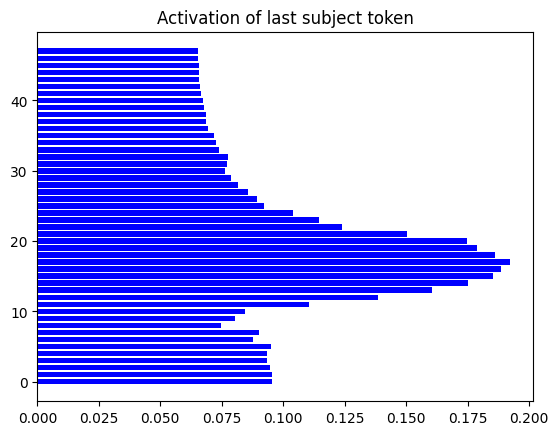

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
ax.barh(range(len(a2_1)), a2_1, color='blue')
ax.set_title('Activation of last subject token')
plt.show()

## Plotting popular capitals facts average activations

In [ ]:
prompts = [
    "Vilnius is the capital of",
    "Jerusalem is the capital of",
    "Havana is the capital of",
    "London is the capital of",
    "Indianapolis is the capital of",
    "Paris is the capital of",
    "Austin is the capital of",
    "Berlin is the capital of",
    "Boston is the capital of",
    "Brussels is the capital of",
    "Beijing is the capital of",
    "Madrid is the capital of",
    "Yerevan is the capital of",
    "Budapest is the capital of",
    "Copenhagen is the capital of",
    "Warsaw is the capital of",
    "Nashville is the capital of",
    "Skopje is the capital of",
    "Rome is the capital of",
    "Ljubljana is the capital of",
    "Montevideo is the capital of",
    "Canberra is the capital of",
    "Belgrade is the capital of",
    "Guatemala is the capital of",
    "Kiev is the capital of",
    "Bangkok is the capital of",
    "Dublin is the capital of",
    "Dushanbe is the capital of",
    "Hartford is the capital of",
    "Jakarta is the capital of",
    "Mogadishu is the capital of",
    "Ottawa is the capital of",
    "Cairo is the capital of",
    "Dhaka is the capital of",
    "Bogota is the capital of",
    "Raleigh is the capital of",
    "Athens is the capital of",
    "Stockholm is the capital of",
    "Vienna is the capital of",
    "Sofia is the capital of",
    "Lisbon is the capital of",
    "Oslo is the capital of",
    "Kabul is the capital of",
    "Harrisburg is the capital of",
    "Wellington is the capital of",
    "Lima is the capital of",
    "Helsinki is the capital of",
    "Prague is the capital of",
    "Beirut is the capital of",
    "Bucharest is the capital of",
    "Hanoi is the capital of",
    "Damascus is the capital of",
    "Sarajevo is the capital of",
    "Tokyo is the capital of",
    "Tegucigalpa is the capital of",
    "Kathmandu is the capital of",
    "Ankara is the capital of",
    "Bratislava is the capital of",
    "Luxembourg is the capital of",
    "Kigali is the capital of",
    "Tirana is the capital of",
    "Tbilisi is the capital of",
    "Tallahassee is the capital of",
    "Tunis is the capital of",
    "Baku is the capital of",
    "Sanaa is the capital of",
    "Santa is the capital of",
    "Nairobi is the capital of",
    "Taipei is the capital of",
    "Tehran is the capital of"
]


c = 0
unique_sentence = []
subj_prob_list = []
for prompt in prompts:
  val = plot_all_flow(mt, prompt, noise=noise_level)
  # if val != None:
  subj_prob_list.append(val)


In [ ]:
import numpy as np
avg_prob_values = [x.cpu() for x in subj_prob_list]
#avg_prob_values = np.mean(np.array(), axis = 0)

In [ ]:
np.save("/content/avg_prob_list_capital", avg_prob_values)

/usr/local/lib/python3.10/dist-packages/numpy/lib/npyio.py:521: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  arr = np.asanyarray(arr)
/usr/local/lib/python3.10/dist-packages/numpy/lib/npyio.py:521: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


In [ ]:
import numpy as np
a = np.load('/content/avg_prob_list_capital.npy', allow_pickle=True)
a1 = np.array([t.numpy() for t in a])
a2 = np.mean(a1, axis = 0)
a2

array([0.2341279 , 0.23873326, 0.254855  , 0.26719752, 0.2845788 ,
       0.3137764 , 0.2882666 , 0.29504997, 0.27396807, 0.26475844,
       0.27011123, 0.32706532, 0.35063943, 0.35435212, 0.35165417,
       0.36338866, 0.3506772 , 0.32823294, 0.3103401 , 0.24031067,
       0.21536852, 0.18403873, 0.1732118 , 0.15669672, 0.13282396,
       0.11678454, 0.10382641, 0.08958796, 0.07653746, 0.06446126,
       0.0573338 , 0.05165249, 0.04608241, 0.04215938, 0.03972698,
       0.03811953, 0.0365812 , 0.03613451, 0.03559977, 0.03540486,
       0.03533947, 0.03524915, 0.03510889, 0.03515358, 0.03504624,
       0.03510752, 0.03518358, 0.0352545 ], dtype=float32)

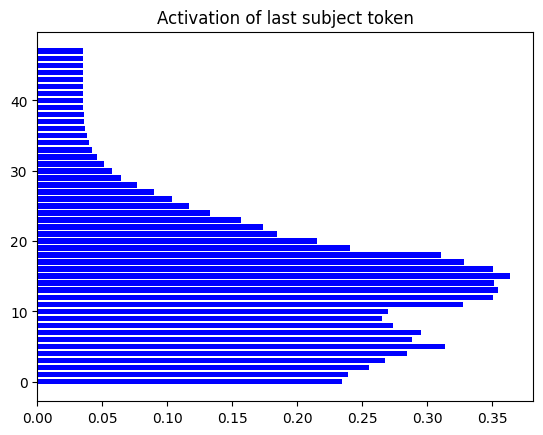

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
ax.barh(range(len(a2)), a2, color='blue')
ax.set_title('Activation of last subject token')
plt.show()


## Plotting rare capitals facts average activations

In [ ]:
prompts = [
    "Podgorica is the capital of",
    "Colombo is the capital of",
    "Tashkent is the capital of",
    "Kampala is the capital of",
    "Saint is the capital of",
    "Managua is the capital of",
    "Riyadh is the capital of",
    "Topeka is the capital of",
    "Honiara is the capital of",
    "Bangui is the capital of",
    "Port-au-Prince is the capital of",
    "Muscat is the capital of",
    "Dakar is the capital of",
    "Freetown is the capital of",
    "Luanda is the capital of",
    "Bamako is the capital of",
    "Bishkek is the capital of",
    "Khartoum is the capital of",
    "Nuuk is the capital of",
    "Cayenne is the capital of",
    "Torshavn is the capital of",
    "Juba is the capital of",
    "Monrovia is the capital of",
    "Malabo is the capital of",
    "Asmara is the capital of",
    "Port is the capital of",
    "Majuro is the capital of",
    "Nouakchott is the capital of",
    "Vientiane is the capital of",
    "Niamey is the capital of",
    "Ouagadougou is the capital of",
    "Praia is the capital of",
    "Noumea is the capital of",
    "Conakry is the capital of",
    "Papeete is the capital of",
    "Basseterre is the capital of",
    "Yamoussoukro is the capital of",
    "El-Aaiun is the capital of",
    "Columbia is the capital of",
    "Washington is the capital of",
    "West is the capital of",
    "Jefferson is the capital of",
    "Concord is the capital of",
    "Avarua is the capital of",
    "Diego is the capital of",
    "Columbus is the capital of",
    "Providence is the capital of",
    "Stanley is the capital of",
    "George is the capital of",
    "Kingstown is the capital of",
    "Albany is the capital of",
    "St. is the capital of",
    "Charleston is the capital of",
    "Bismarck is the capital of",
    "Carson is the capital of",
    "Montpelier is the capital of",
    "Abu is the capital of",
    "Trenton is the capital of",
    "San is the capital of",
    "Sao is the capital of",
    "Baton is the capital of",
    "Des is the capital of",
    "Vatican is the capital of",
    "Kuala is the capital of",
    "New is the capital of",
    "Santo is the capital of",
    "Ulan is the capital of",
    "Flying is the capital of",
    "Pago is the capital of",
    "Little is the capital of",
    "Addis is the capital of"
]



c = 0
unique_sentence = []
subj_prob_list = []
for prompt in prompts:
  val = plot_all_flow(mt, prompt, noise=noise_level)
  # if val != None:
  subj_prob_list.append(val)


In [ ]:
import numpy as np
avg_prob_values = [x.cpu() for x in subj_prob_list]
#avg_prob_values = np.mean(np.array(), axis = 0)

In [ ]:
np.save("/content/avg_prob_list_capital_rare", avg_prob_values)

/usr/local/lib/python3.10/dist-packages/numpy/lib/npyio.py:521: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  arr = np.asanyarray(arr)
/usr/local/lib/python3.10/dist-packages/numpy/lib/npyio.py:521: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


In [ ]:
import numpy as np
a = np.load('/content/avg_prob_list_capital_rare.npy', allow_pickle=True)
a1 = np.array([t.numpy() for t in a])
a2 = np.mean(a1, axis = 0)
a2

array([0.2435803 , 0.2448331 , 0.24651073, 0.24957885, 0.2514681 ,
       0.25722143, 0.24080475, 0.24880861, 0.23533912, 0.24855404,
       0.25415525, 0.26380077, 0.2855981 , 0.28985065, 0.2952198 ,
       0.2995407 , 0.298714  , 0.29735133, 0.2875085 , 0.27352324,
       0.25786528, 0.23688494, 0.22557674, 0.21942788, 0.20960379,
       0.20637384, 0.2040778 , 0.20150425, 0.19878054, 0.19818905,
       0.19719931, 0.19660063, 0.1964568 , 0.19648002, 0.19683893,
       0.19627774, 0.19544175, 0.19523063, 0.19529203, 0.19521502,
       0.1952388 , 0.19530247, 0.19537418, 0.19526018, 0.19521816,
       0.19531012, 0.19526969, 0.19530702], dtype=float32)

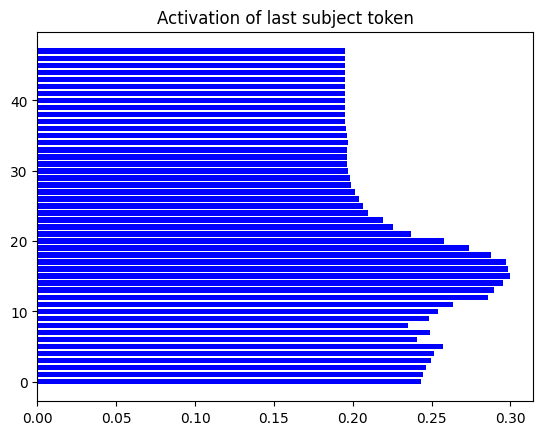

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
ax.barh(range(len(a2)), a2, color='blue')
ax.set_title('Activation of last subject token')
plt.show()

## Plotting popular capitals & sports facts average activations

In [ ]:
prompts = [
    "Serena Williams plays the sport of",
    "Lionel Messi plays the sport of",
    "Novak Djokovic plays the sport of",
    "Rafael Nadal plays the sport of",
    "Cristiano Ronaldo plays the sport of",
    "Tom Brady plays the sport of",
    "Vilnius is the capital of",
    "Roger Federer plays the sport of",
    "Jerusalem is the capital of",
    "Virat Kohli plays the sport of",
    "AJ Styles plays the sport of",
    "LeBron James plays the sport of",
    "Havana is the capital of",
    "Aaron Rodgers plays the sport of",
    "Stephen Curry plays the sport of",
    "London is the capital of",
    "Neymar Jr. plays the sport of",
    "Indianapolis is the capital of",
    "Muhammad Ali plays the sport of",
    "Paris is the capital of",
    "John Cena plays the sport of",
    "The Nature Boy Ric Flair plays the sport of",
    "Kurt Angle plays the sport of",
    "Austin is the capital of",
    "Berlin is the capital of",
    "Boston is the capital of",
    "Brussels is the capital of",
    "Beijing is the capital of",
    "Madrid is the capital of",
    "Magnus Carlsen plays the sport of",
    "Yerevan is the capital of",
    "Mohamed Salah plays the sport of",
    "Budapest is the capital of",
    "Copenhagen is the capital of",
    "Warsaw is the capital of",
    "Nashville is the capital of",
    "Skopje is the capital of",
    "Rome is the capital of",
    "Ljubljana is the capital of",
    "Anthony Davis plays the sport of",
    "Roman Reigns plays the sport of",
    "Montevideo is the capital of",
    "Tiger Woods plays the sport of",
    "Canberra is the capital of",
    "Sidney Crosby plays the sport of",
    "Gennady Golovkin plays the sport of",
    "Belgrade is the capital of",
    "Guatemala is the capital of",
    "Kiev is the capital of",
    "Russell Wilson plays the sport of",
    "Bangkok is the capital of",
    "Dublin is the capital of",
    "Dushanbe is the capital of",
    "Hartford is the capital of",
    "Jakarta is the capital of",
    "Mike Tyson plays the sport of",
    "Wayne Gretzky plays the sport of",
    "Mogadishu is the capital of",
    "Ottawa is the capital of",
    "Viswanathan Anand plays the sport of",
    "Cairo is the capital of",
    "Shawn Michaels plays the sport of",
    "Kevin Durant plays the sport of",
    "Dhaka is the capital of",
    "Bogota is the capital of",
    "Jon Jones plays the sport of",
    "Raleigh is the capital of",
    "Athens is the capital of",
    "Stockholm is the capital of",
    "Kylian Mbappé plays the sport of",
    "Vienna is the capital of",
    "Rory McIlroy plays the sport of",
    "Sofia is the capital of",
    "Lisbon is the capital of",
    "Patrick Mahomes plays the sport of",
    "Oslo is the capital of",
    "Kabul is the capital of",
    "Harrisburg is the capital of",
    "Wellington is the capital of",
    "Lima is the capital of",
    "Helsinki is the capital of",
    "Prague is the capital of",
    "Beirut is the capital of",
    "Lamar Jackson plays the sport of",
    "Bucharest is the capital of",
    "Hanoi is the capital of",
    "Damascus is the capital of",
    "Sarajevo is the capital of",
    "Tokyo is the capital of",
    "Tegucigalpa is the capital of",
    "Kofi Kingston plays the sport of",
    "Kathmandu is the capital of",
    "Ankara is the capital of",
    "Alexander Ovechkin plays the sport of",
    "Bratislava is the capital of",
    "Luxembourg is the capital of",
    "Manny Pacquiao plays the sport of",
    "Kigali is the capital of",
    "Tirana is the capital of",
    "James Harden plays the sport of",
    "Tbilisi is the capital of",
    "Tallahassee is the capital of",
    "Judit Polgár plays the sport of",
    "Conor McGregor plays the sport of",
    "Tunis is the capital of",
    "Baku is the capital of",
        "Sanaa is the capital of",
    "Santa is the capital of",
    "Nairobi is the capital of",
    "Taipei is the capital of",
    "Tehran is the capital of",
    "Amman is the capital of",
    "Tallinn is the capital of",
    "Panama is the capital of",
    "Connor McDavid plays the sport of",
    "Giannis Antetokounmpo plays the sport of",
    "Ashgabat is the capital of",
    "Dili is the capital of",
    "Damian Lillard plays the sport of",
    "Nicosia is the capital of",
    "Bobby Orr plays the sport of",
    "Doha is the capital of",
    "Baghdad is the capital of",
    "Riga is the capital of",
    "Boise is the capital of",
    "Hou Yifan plays the sport of",
    "Hikaru Nakamura plays the sport of",
    "J.J. Watt plays the sport of",
    "Khabib Nurmagomedov plays the sport of",
    "Kinshasa is the capital of",
    "Berne is the capital of",
    "Shikhar Dhawan plays the sport of",
    "Accra is the capital of",
    "Pretoria is the capital of",
    "Valentina Shevchenko plays the sport of",
    "Evander Holyfield plays the sport of",
    "Jordan Spieth plays the sport of",
    "Harare is the capital of",
    "Mohammed Shami plays the sport of",
    "Astana is the capital of"
]




c = 0
unique_sentence = []
subj_prob_list = []
for prompt in prompts:
  val = plot_all_flow(mt, prompt, noise=noise_level)
  # if val != None:
  subj_prob_list.append(val)


In [ ]:
import numpy as np
avg_prob_values = [x.cpu() for x in subj_prob_list]
#avg_prob_values = np.mean(np.array(), axis = 0)

In [ ]:
np.save("/content/avg_prob_list_prompts_popular", avg_prob_values)

In [ ]:
import numpy as np
a = np.load('/content/avg_prob_list_prompts_popular.npy', allow_pickle=True)
a1 = np.array([t.numpy() for t in a])
a2 = np.mean(a1, axis = 0)
a2

array([0.23400375, 0.23738243, 0.24813385, 0.25834355, 0.26765075,
       0.2887658 , 0.2726809 , 0.276037  , 0.25500798, 0.24446182,
       0.25544658, 0.30648383, 0.3311711 , 0.3444208 , 0.35803735,
       0.37392512, 0.36984885, 0.35811183, 0.3361313 , 0.28314957,
       0.2569273 , 0.21844651, 0.19123222, 0.16935775, 0.14877169,
       0.12660794, 0.11516877, 0.10299286, 0.09239224, 0.08555987,
       0.081201  , 0.07528298, 0.07311261, 0.06696064, 0.06489824,
       0.06179072, 0.05956377, 0.05879706, 0.05811887, 0.05745176,
       0.05691408, 0.05650372, 0.0561767 , 0.05609229, 0.05579749,
       0.05573977, 0.05575475, 0.05577987], dtype=float32)

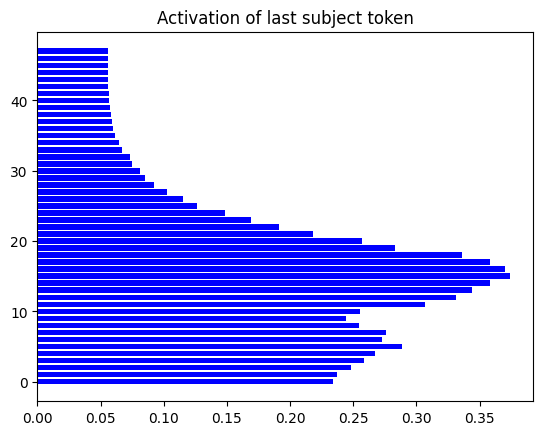

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
ax.barh(range(len(a2)), a2, color='blue')
ax.set_title('Activation of last subject token')
plt.show()

## Plotting rare capitals & sports facts average activations

In [ ]:
prompts = [
    "Faf du Plessis plays the sport of",
    "Mark Messier plays the sport of",
    "Jacques Kallis plays the sport of",
    "Bishkek is the capital of",
    "Khartoum is the capital of",
    "Ajinkya Rahane plays the sport of",
    "Jonathan Toews plays the sport of",
    "Stipe Miocic plays the sport of",
    "Mithali Raj plays the sport of",
    "Evgeni Malkin plays the sport of",
    "Nuuk is the capital of",
    "Claressa Shields plays the sport of",
    "Cayenne is the capital of",
    "Graeme Smith plays the sport of",
    "Ravindra Jadeja plays the sport of",
    "KL Rahul plays the sport of",
    "Rashid Khan plays the sport of",
    "Torshavn is the capital of",
    "Oliver Bjorkstrand plays the sport of",
    "Juba is the capital of",
    "Monrovia is the capital of",
    "Hashim Amla plays the sport of",
    "Teimour Radjabov plays the sport of",
    "Nikita Kucherov plays the sport of",
    "Asmara is the capital of",
    "Malabo is the capital of",
    "Dan Carter plays the sport of",
    "Sergey Karjakin plays the sport of",
    "Port is the capital of",
    "Majuro is the capital of",
    "Pavel Datsyuk plays the sport of",
    "Pentala Harikrishna plays the sport of",
    "Nouakchott is the capital of",
    "Ishant Sharma plays the sport of",
    "Vientiane is the capital of",
    "Juuse Saros plays the sport of",
    "Niamey is the capital of",
    "Semi Radradra plays the sport of",
    "Anish Giri plays the sport of",
    "Olli Maatta plays the sport of",
    "Veselin Topalov plays the sport of",
    "David Pocock plays the sport of",
    "Ouagadougou is the capital of",
    "Praia is the capital of",
    "Jasprit Bumrah plays the sport of",
    "Sergio Parisse plays the sport of",
    "Vince Dunn plays the sport of",
    "Stuart Hogg plays the sport of",
    "Noumea is the capital of",
    "Hardik Pandya plays the sport of",
    "Conakry is the capital of",
    "Papeete is the capital of",
    "Boris Gelfand  plays the sport of",
    "Duván Zapata plays the sport of",
    "Mako Vunipola plays the sport of",
    "Mark Boucher plays the sport of",
    "Prithvi Shaw plays the sport of",
    "Herschelle Gibbs plays the sport of",
    "Codie Taylor plays the sport of",
    "Suryakumar Yadav plays the sport of",
    "Shreyas Iyer plays the sport of",
    "Ding Liren plays the sport of",
    "Maxime Vachier-Lagrave plays the sport of",
    "Jordie Barrett plays the sport of",
    "Courtney Lawes plays the sport of",
    "Shakhriyar Mamedyarov plays the sport of",
    "Dan Biggar plays the sport of",
    "Mayank Agarwal plays the sport of",
    "Kuldeep Yadav plays the sport of",
    "Jakub Vrana plays the sport of",
    "Alexandra Kosteniuk plays the sport of",
    "Shaun Pollock plays the sport of",
    "Basseterre is the capital of",
    "Darnell Nurse plays the sport of",
    "Yamoussoukro is the capital of",
    "A.J. Terrell plays the sport of",
    "Shardul Thakur plays the sport of",
    "El-Aaiun is the capital of",
    "Andreas Johnsson plays the sport of",
    "Bhuvneshwar Kumar plays the sport of",
    "Alex Tuch plays the sport of",
    "Taskin Ahmed plays the sport of",
    "Romain Ntamack plays the sport of",
    "Javonte Williams plays the sport of",
    "Columbia is the capital of",
    "Shafali Verma plays the sport of",
    "Christian Dvorak plays the sport of",
    "Deepak Chahar plays the sport of",
    "Tadhg Furlong plays the sport of",
    "Devin Shore plays the sport of",
    "Calle Jarnkrok plays the sport of",
    "Washington is the capital of",
    "Trevor Zegras plays the sport of",
    "Kaapo Kahkonen plays the sport of",
    "Marcell Coetzee plays the sport of",
    "Mariya Muzychuk plays the sport of",
    "Leinier Dominguez plays the sport of",
    "Jamie Ritchie plays the sport of",
    "Sam Underhill plays the sport of",
    "West is the capital of",
    "Jefferson is the capital of",
    "Alina Kashlinskaya plays the sport of",
    "Concord is the capital of",
    "Anton Korobov plays the sport of",
    "Avarua is the capital of",
    "Diego is the capital of",
    "Columbus is the capital of",
    "Providence is the capital of",
    "Stanley is the capital of",
    "Lachlan Boshier plays the sport of",
    "George is the capital of",
    "Adam Boqvist plays the sport of",
    "Kingstown is the capital of",
    "Albany is the capital of",
    "Jordan Larmour plays the sport of",
    "St. is the capital of",
    "Charleston is the capital of",
    "Bismarck is the capital of",
    "Carson is the capital of",
    "Montpelier is the capital of",
    "Abu is the capital of",
    "Trenton is the capital of",
    "San is the capital of",
    "Sao is the capital of",
    "Baton is the capital of",
    "Des is the capital of",
    "Vatican is the capital of",
    "Kuala is the capital of",
    "New is the capital of",
    "Santo is the capital of",
    "Martin Johnson plays the sport of",
    "Ulan is the capital of",
    "Flying is the capital of",
    "Pago is the capital of",
    "Little is the capital of",
    "Addis is the capital of",
    "Josh Adams plays the sport of",
    "Andrew Shaw plays the sport of",
    "Taniela Tupou plays the sport of",
    "Naseem Shah plays the sport of",
    "Caleb Clarke plays the sport of"
]



c = 0
unique_sentence = []
subj_prob_list = []
for prompt in prompts:
  val = plot_all_flow(mt, prompt, noise=noise_level)
  # if val != None:
  subj_prob_list.append(val)


In [ ]:
import numpy as np
avg_prob_values = [x.cpu() for x in subj_prob_list]
#avg_prob_values = np.mean(np.array(), axis = 0)

In [ ]:
np.save("/content/avg_prob_list_prompts_rare", avg_prob_values)

In [ ]:
import numpy as np
a = np.load('/content/avg_prob_list_prompts_rare.npy', allow_pickle=True)
a1 = np.array([t.numpy() for t in a])
a2 = np.mean(a1, axis = 0)
a2

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
ax.barh(range(len(a2)), a2, color='blue')
ax.set_title('Activation of last subject token')
plt.show()

## Plotting individual prompts and obtaining highest activation layers, tokens

In [ ]:
import numpy as np

def find_highly_activated(matrix):

    if torch.mean(matrix) + torch.std(matrix) >= torch.max(matrix):
      threshold = torch.mean(matrix)
    else:
      threshold = torch.mean(matrix) + torch.std(matrix)

    print("Threshold: ", threshold)

    above_threshold_indices = np.where(matrix >= threshold)

    result = [( layer_number, token_number) for token_number, layer_number in zip(above_threshold_indices[0], above_threshold_indices[1])]
    print("\nHighly Activated Neurons:")
    for x,y in result:
      print("Layer: ", x, " Token: ", y)
    print()

In [ ]:
def plot_hidden_flow(
    mt,
    prompt,
    subject=None,
    samples=10,
    noise=0.1,
    window=10,
    kind=None,
    modelname=None,
    savepdf=None,
):
    if subject is None:
        subject = guess_subject(prompt)
    result = calculate_hidden_flow(
        mt, prompt, subject, samples=samples, noise=noise, window=window, kind=kind
    )
    find_highly_activated(result["scores"])
    plot_trace_heatmap(result, savepdf, modelname=modelname)


def plot_all_flow(mt, prompt, subject=None, noise=0.1, modelname=None):
    for kind in [None, "mlp", "attn"]:
        plot_hidden_flow(
            mt, prompt, subject, modelname=modelname, noise=noise, kind=kind
        )

The following prompt can be changed to any factual statement to trace.

In [ ]:
plot_all_flow(mt, "Bill Gates co-founded", noise=noise_level)

In [ ]:
plot_all_flow(mt, "Paul Allen co-founded", noise=noise_level)

Here we trace a few more factual statements from a file of test cases.

In [ ]:
# for knowledge in knowns[:5]:
#     plot_all_flow(mt, knowledge["prompt"], knowledge["subject"], noise=noise_level)

In [ ]:
plot_all_flow(mt, "Steve jobs was the co-founder of", noise=noise_level)

In [ ]:
plot_all_flow(mt, "Steve Wozniak was the co-founder of", noise=noise_level)

In [ ]:
plot_all_flow(mt, "Eiffel Tower is in the city of", noise=noise_level)

In [ ]:
plot_all_flow(mt, "Canal Saint-Martin is in the city of", noise=noise_level)

In [ ]:
plot_all_flow(mt, "Michael Jordan plays the sport of", noise=noise_level)

In [ ]:
plot_all_flow(mt, "Steve Kerr plays the sport of", noise=noise_level)

Threshold:  tensor(0.1042)

Highly Activated Neurons:
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  31  Token:  1
Layer:  32  Token:  1
Layer:  33  Token:  1
Layer:  34  Token:  1
Layer:  35  Token:  1
Layer:  36  Token:  1
Layer:  37  Token:  1
Layer:  38  Token:  1
Layer:  39  Token:  1
Layer:  40  Token:  1
Layer:  41  Token:  1
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  14  Token:  7
Layer:  15  Token:  7
Layer:  16  Token:  7
Layer:  18  Token:  7
Layer:  19  Token:  7
Layer:  20  Token:  7
Layer:  21  Token:  7
Layer:  22  Token:  7
Layer:  23  Token:  7
Layer:  24  Token:  7
Layer:  25  Token:  7
Layer:  26  Token:  7
Layer:  27  

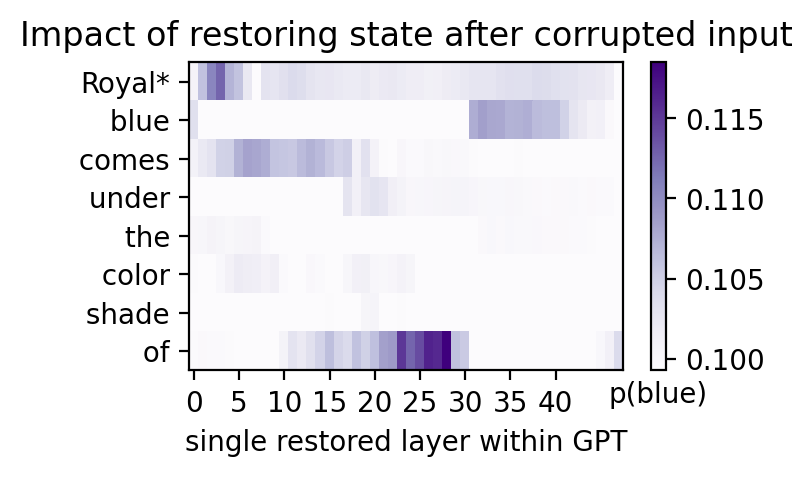

Threshold:  tensor(0.1045)

Highly Activated Neurons:
Layer:  6  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  9  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  6  Token:  6
Layer:  9  Token:  6
Layer:  10  Token:  6
Layer:  14  Token:  6
Layer:  13  Token:  7
Layer:  14  Token:  7
Layer:  15  Token:  7
Layer:  16  Token:  7
Layer:  17  Token:  7
Layer:  18  Token:  7
Layer:  19  Token:  7
Layer:  37  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



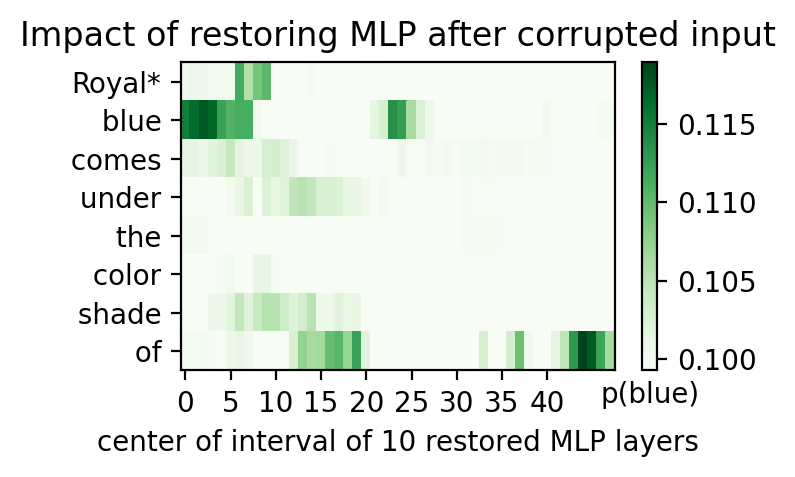

Threshold:  tensor(0.1077)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  9  Token:  0
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  11  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



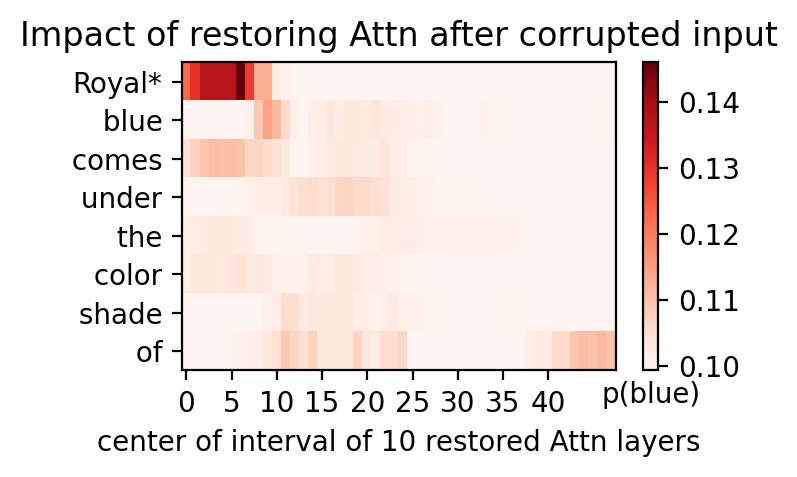

In [ ]:
plot_all_flow(mt, "Royal blue comes under the color shade of", noise=noise_level)

Threshold:  tensor(0.0568)

Highly Activated Neurons:
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  31  Token:  2
Layer:  32  Token:  2
Layer:  33  Token:  2
Layer:  34  Token:  2
Layer:  35  Token:  2
Layer:  36  Token:  2
Layer:  37  Token:  2
Layer:  38  Token:  2
Layer:  39  Token:  2
Layer:  40  Token:  2
Layer:  41  Token:  2
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  18  Token:  8
Layer:  19  Token:  8
Layer

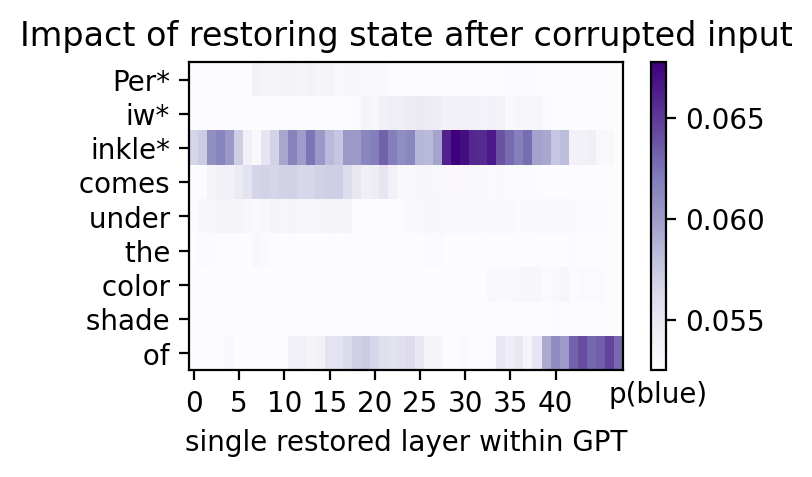

Threshold:  tensor(0.0570)

Highly Activated Neurons:
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  20  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  14  Token:  8
Layer:  15  Token:  8
Layer:  17  Token:  8
Layer:  18  Token:  8
Layer:  19  Token:  8
Layer:  20  Token:  8
Layer:  21  Token:  8
Layer:  28  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  38  Token:  8



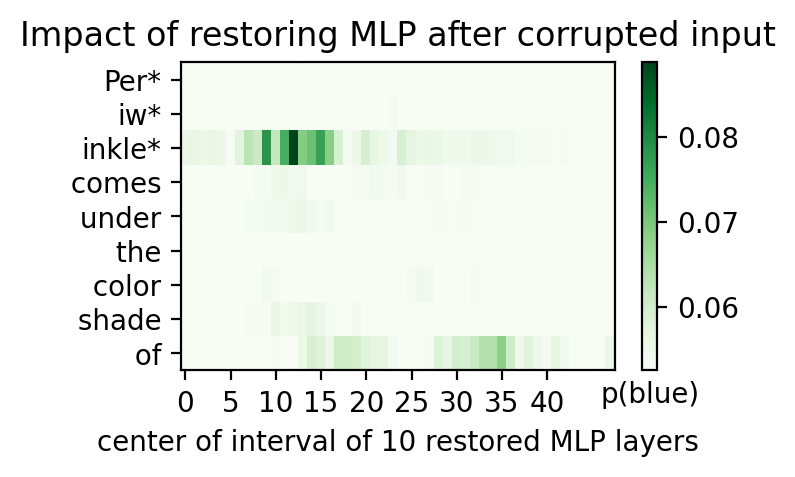

Threshold:  tensor(0.0553)

Highly Activated Neurons:
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  8  Token:  6
Layer:  9  Token:  6
Layer:  12  Token:  7
Layer:  11  Token:  8
Layer:  12  Token:  8
Layer:  13  Token:  8
Layer:  14  Token:  8
Layer:  15  Token:  8
Layer:  16  Token:  8
Layer:  19  Token:  8
Layer:  20  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token: 

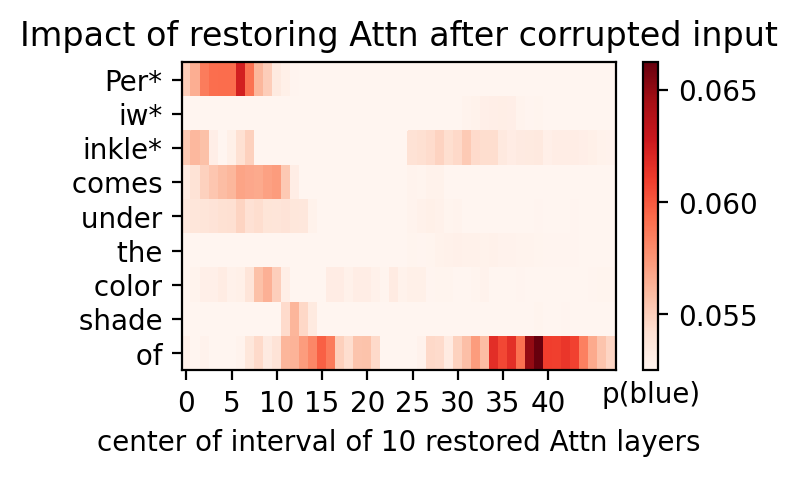

In [ ]:
plot_all_flow(mt, "Periwinkle comes under the color shade of", noise=noise_level)

Threshold:  tensor(0.6492)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  27  Token:  1
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



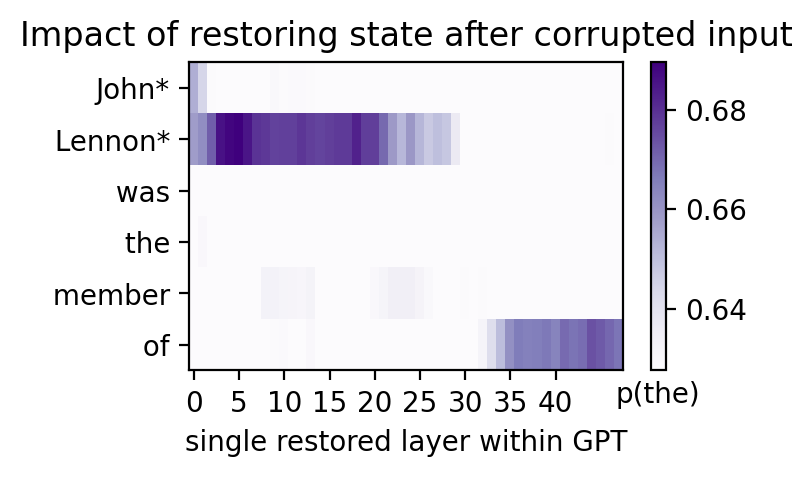

Threshold:  tensor(0.6489)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  22  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



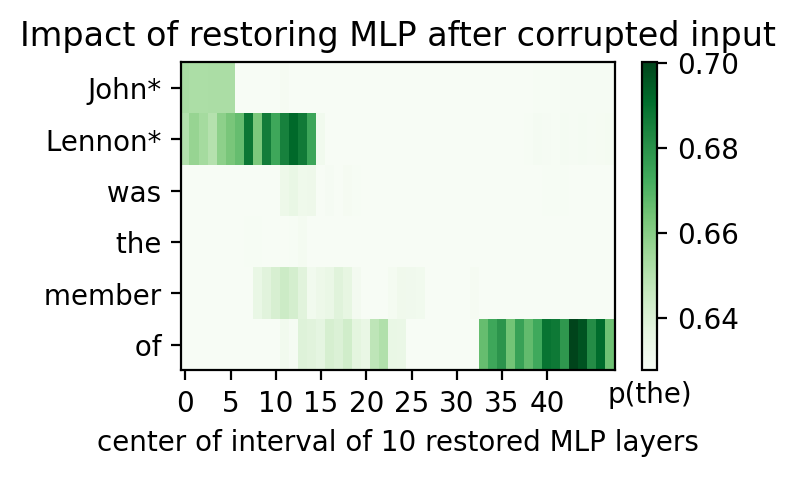

Threshold:  tensor(0.6393)

Highly Activated Neurons:
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5



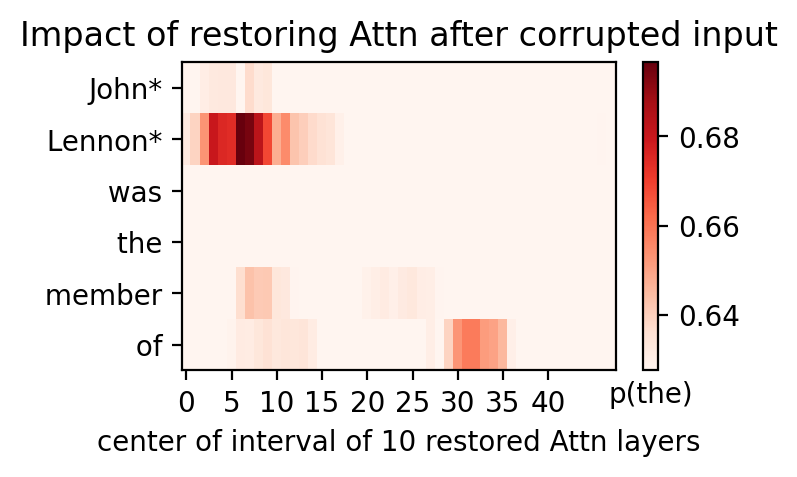

In [ ]:
plot_all_flow(mt, "John Lennon was the member of", noise=noise_level)

Threshold:  tensor(0.6571)

Highly Activated Neurons:
Layer:  6  Token:  0
Layer:  1  Token:  5
Layer:  2  Token:  5
Layer:  3  Token:  5
Layer:  4  Token:  5
Layer:  5  Token:  5
Layer:  6  Token:  5
Layer:  7  Token:  5
Layer:  8  Token:  5
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5



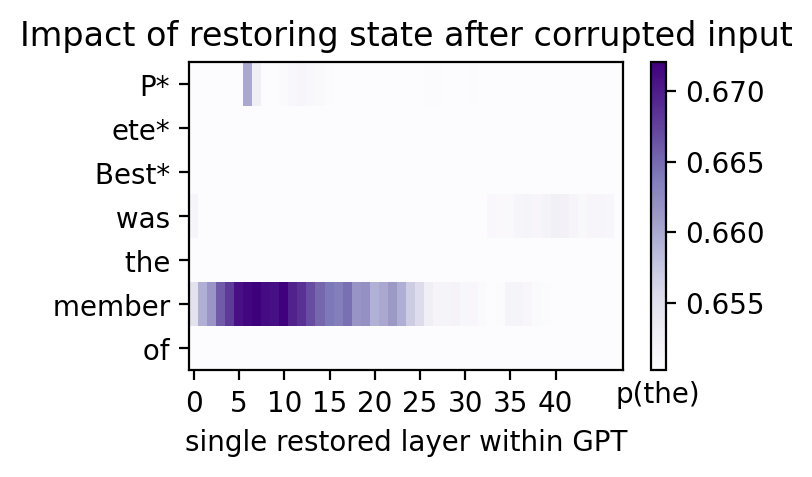

Threshold:  tensor(0.6652)

Highly Activated Neurons:
Layer:  10  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  1  Token:  5
Layer:  2  Token:  5
Layer:  3  Token:  5
Layer:  4  Token:  5
Layer:  5  Token:  5
Layer:  6  Token:  5
Layer:  7  Token:  5
Layer:  8  Token:  5
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



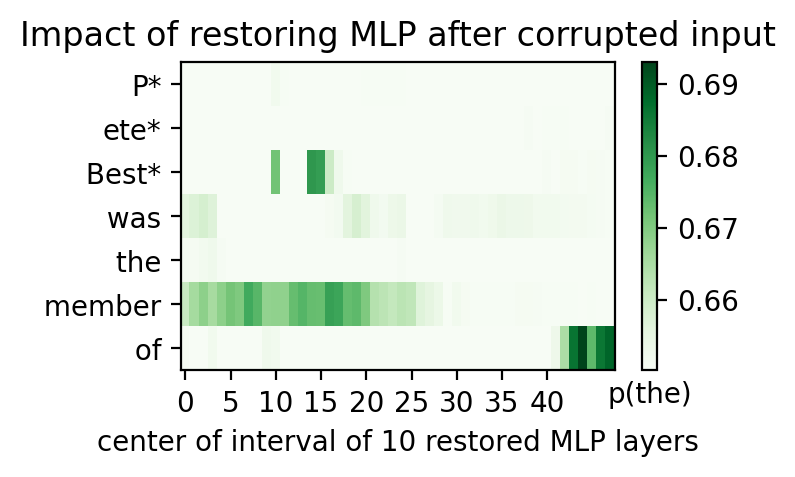

Threshold:  tensor(0.6550)

Highly Activated Neurons:
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  0  Token:  5
Layer:  1  Token:  5
Layer:  2  Token:  5
Layer:  3  Token:  5
Layer:  4  Token:  5
Layer:  5  Token:  5
Layer:  6  Token:  5
Layer:  7  Token:  5
Layer:  8  Token:  5
Layer:  20  Token:  5



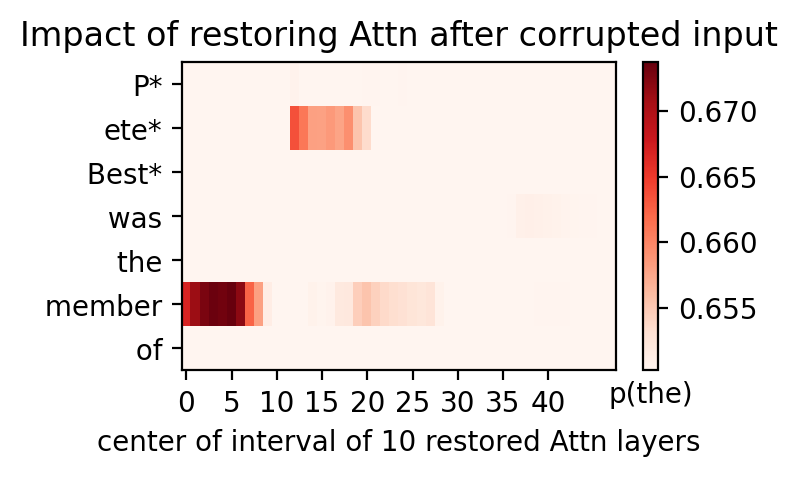

In [ ]:
plot_all_flow(mt, "Pete Best was the member of", noise=noise_level)

Threshold:  tensor(0.5439)

Highly Activated Neurons:
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  6  Token:  5
Layer:  7  Token:  5
Layer:  8  Token:  5
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  24  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  29  Token:  11
Layer:  30  Token:  11
Layer:  31  Token:  11
Layer:  32  Token:  11
Layer:  33  T

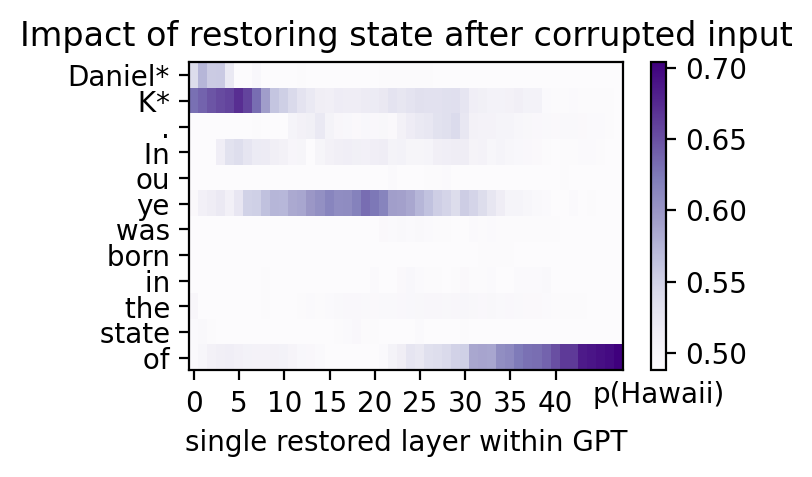

Threshold:  tensor(0.5234)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  12  Token:  3
Layer:  14  Token:  3
Layer:  19  Token:  3
Layer:  4  Token:  5
Layer:  5  Token:  5
Layer:  6  Token:  5
Layer:  7  Token:  5
Layer:  8  Token:  5
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Lay

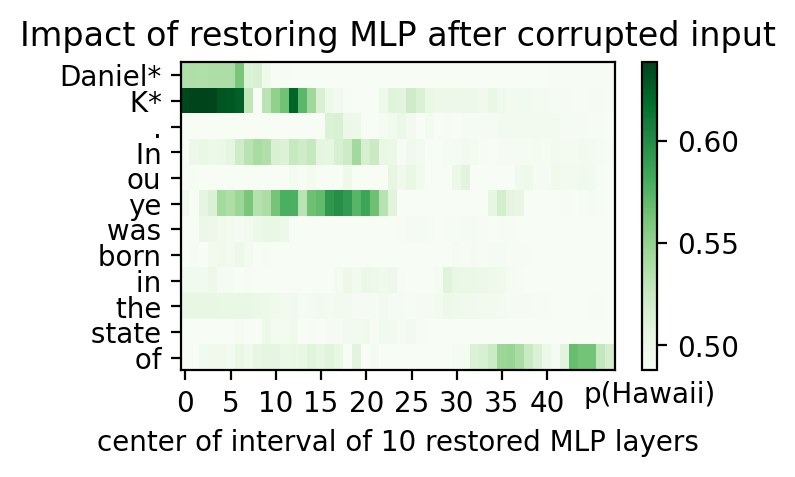

Threshold:  tensor(0.5150)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  8  Token:  0
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  1  Token:  5
Layer:  2  Token:  5
Layer:  3  Token:  5
Layer:  4  Token:  5
Layer:  5  Token:  5
Layer:  6  Token:  5
Layer:  7  Token:  5
Layer:  8  Token:  5
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  22  Token:  11
Layer:  23  Token: 

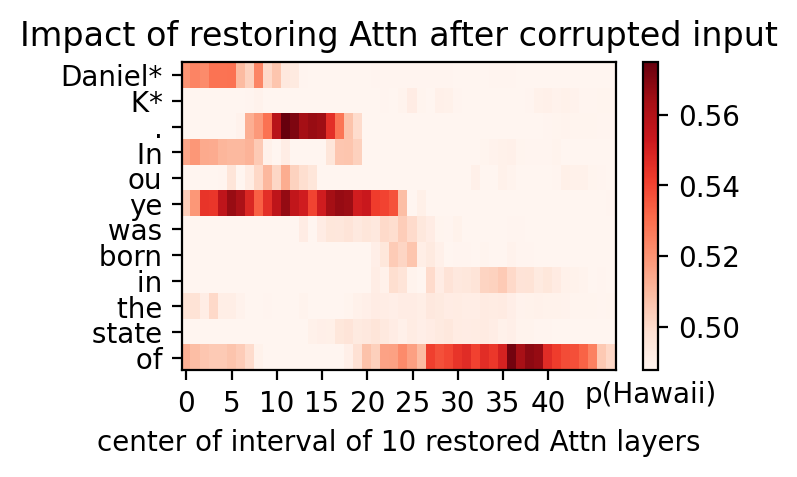

In [ ]:
plot_all_flow(mt, "Daniel K. Inouye was born in the state of", noise=noise_level)

Threshold:  tensor(0.3304)

Highly Activated Neurons:
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Tok

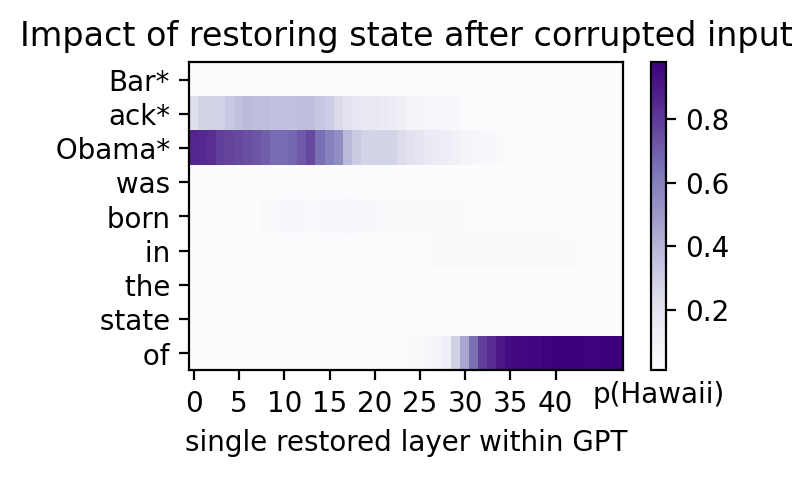

Threshold:  tensor(0.1636)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2



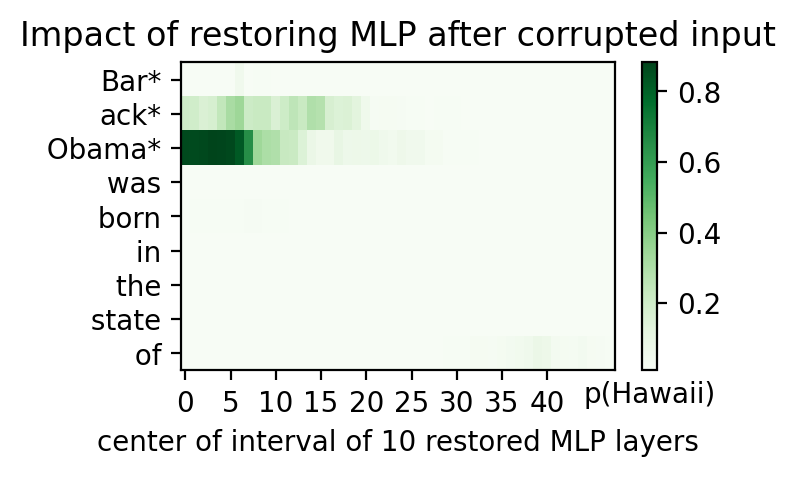

Threshold:  tensor(0.0850)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  25  Token:  8
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8



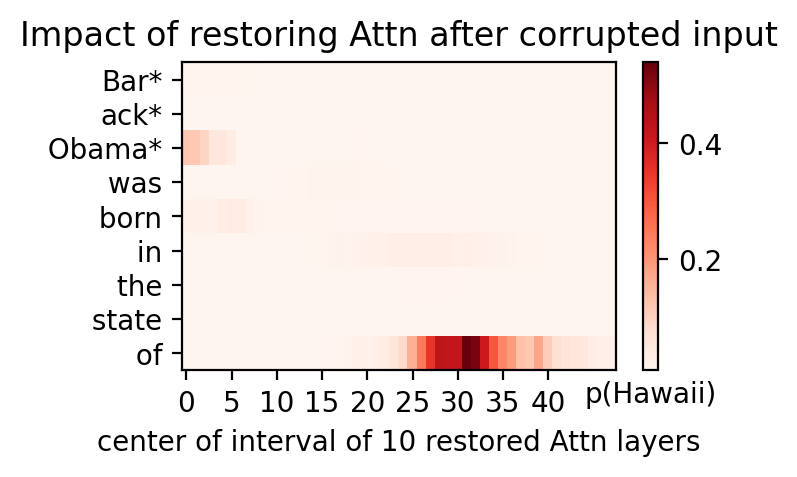

In [ ]:
plot_all_flow(mt, "Barack Obama was born in the state of", noise=noise_level)

Threshold:  tensor(0.1035)

Highly Activated Neurons:
Layer:  2  Token:  4



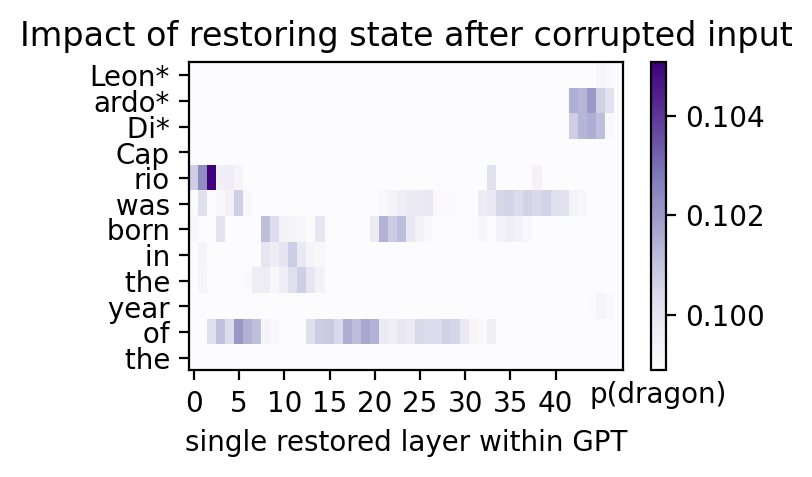

Threshold:  tensor(0.1045)

Highly Activated Neurons:
Layer:  28  Token:  3
Layer:  0  Token:  4
Layer:  1  Token:  4
Layer:  2  Token:  4
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  0  Token:  6
Layer:  3  Token:  6
Layer:  5  Token:  6
Layer:  6  Token:  6
Layer:  7  Token:  6
Layer:  8  Token:  6
Layer:  9  Token:  6
Layer:  10  Token:  6
Layer:  11  Token:  6
Layer:  7  Token:  11
Layer:  9  Token:  11



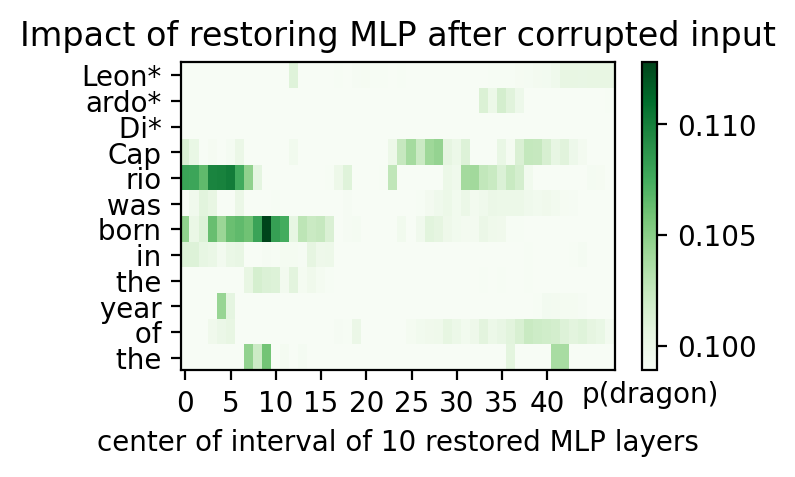

Threshold:  tensor(0.1016)

Highly Activated Neurons:
Layer:  10  Token:  1
Layer:  36  Token:  2
Layer:  37  Token:  2
Layer:  10  Token:  6
Layer:  11  Token:  6
Layer:  6  Token:  8
Layer:  7  Token:  8
Layer:  8  Token:  8
Layer:  9  Token:  8
Layer:  10  Token:  8
Layer:  11  Token:  8
Layer:  1  Token:  10
Layer:  3  Token:  10
Layer:  11  Token:  11
Layer:  14  Token:  11



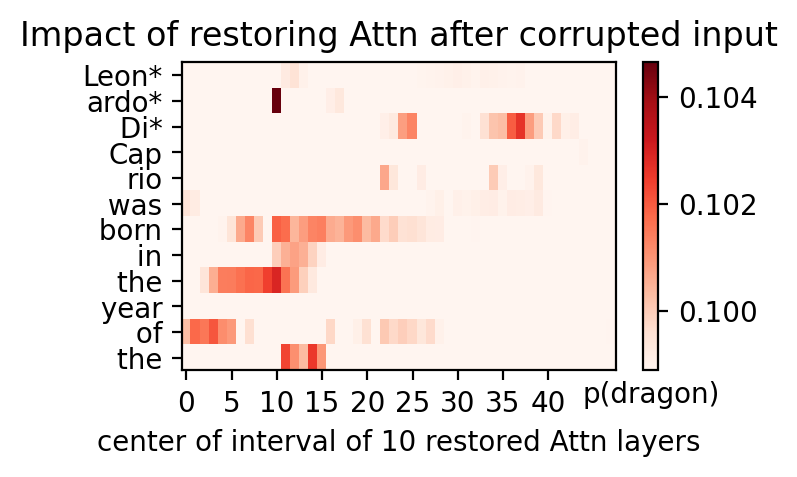

In [ ]:
plot_all_flow(mt, "Leonardo DiCaprio was born in the year of the", noise=noise_level)

Threshold:  tensor(0.0797)

Highly Activated Neurons:
Layer:  1  Token:  0
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  24  Token:  8
Layer:  25  Token:  8
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:

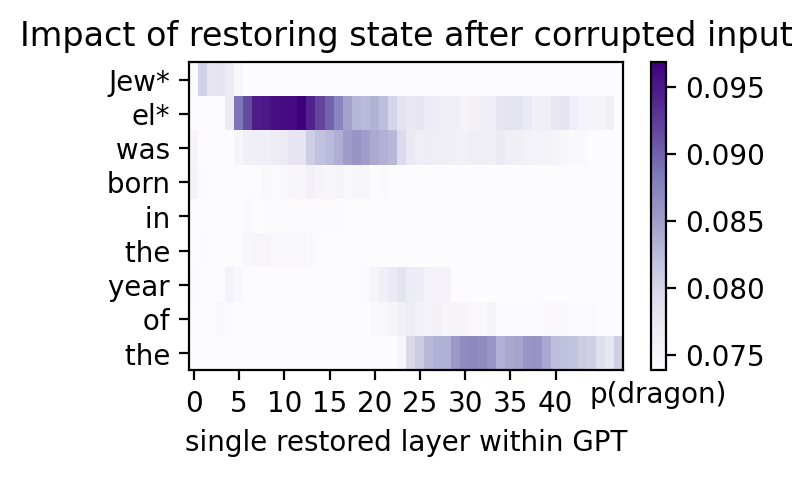

Threshold:  tensor(0.0813)

Highly Activated Neurons:
Layer:  6  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  9  Token:  0
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  26  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  

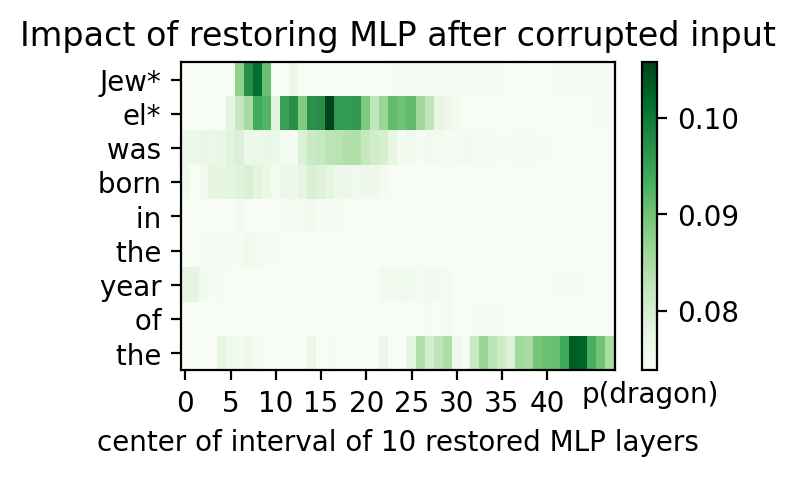

Threshold:  tensor(0.0786)

Highly Activated Neurons:
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  10  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  19  Token:  6
Layer:  20  Token:  6
Layer:  21  Token:  6
Layer:  22  Token:  6
Layer:  23  Token:  6
Layer:  24  Token:  6
Layer:  25  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  10  Token:  8
Layer:  11  Token:  8
Layer:  13  Token:  8
Layer:  14  Token:  8
Layer:  19  Token:  8
Layer:  20  Token:  8
Layer:  21  Token:  8
Layer:  22  Token:  8
Layer:  23  Token:  8
Layer:  24  Token:  8
Layer:  25  Token:  8
Layer:  26  Token:  8
Layer: 

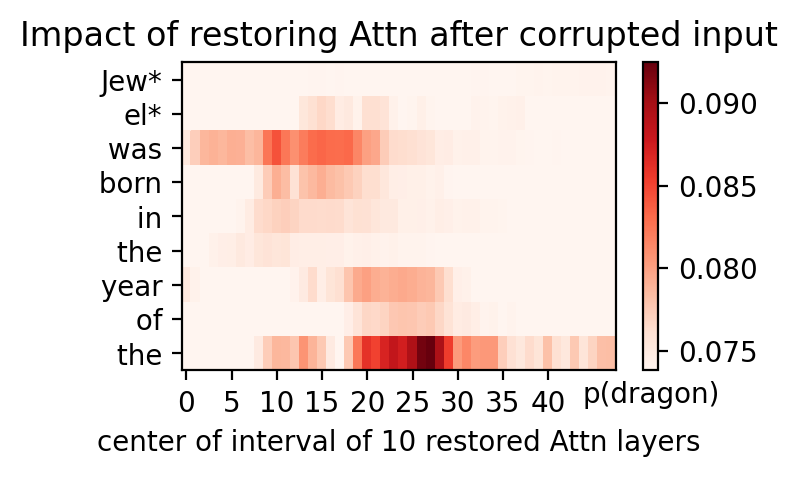

In [ ]:
plot_all_flow(mt, "Jewel was born in the year of the", noise=noise_level)

Threshold:  tensor(0.0340)

Highly Activated Neurons:
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



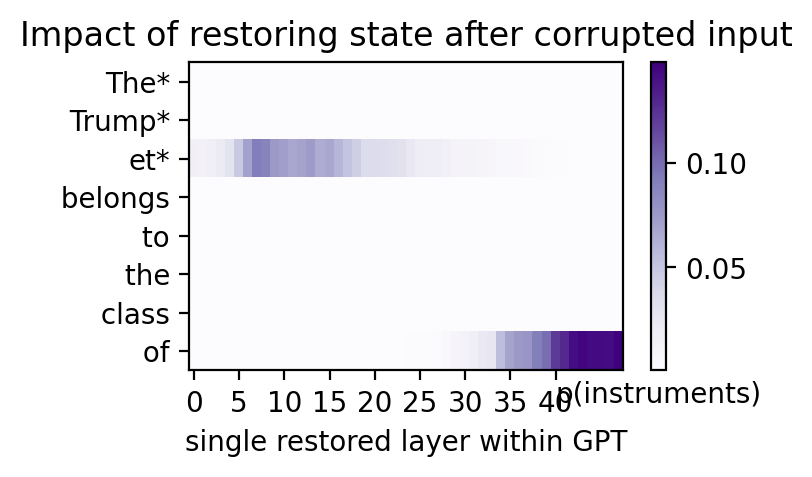

Threshold:  tensor(0.0120)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2



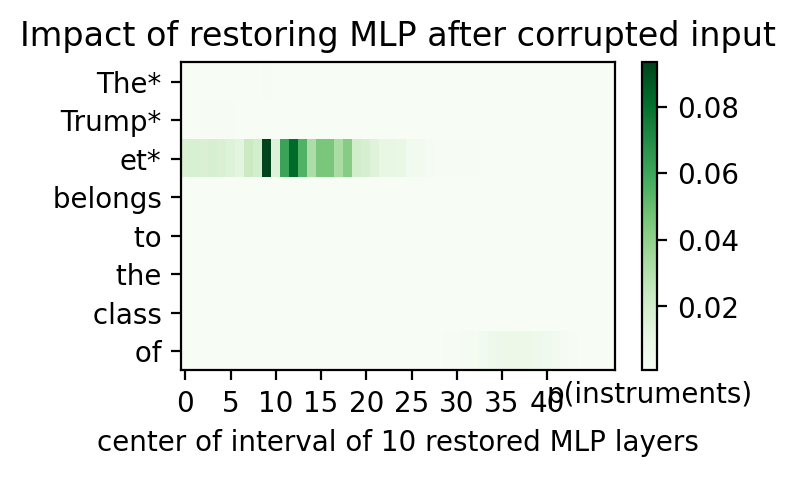

Threshold:  tensor(0.0043)

Highly Activated Neurons:
Layer:  24  Token:  7
Layer:  25  Token:  7
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7



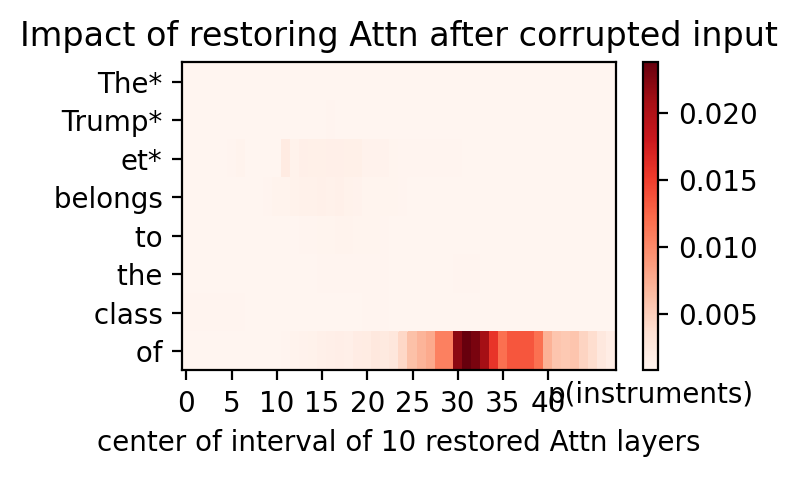

In [ ]:
plot_all_flow(mt, "The Trumpet belongs to the class of", noise=noise_level)

Threshold:  tensor(0.0329)

Highly Activated Neurons:
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  30  Token:  9
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9
Layer:  44  Token:  9
Layer:  45  Token:  9
Layer:  46  Token:  9
Layer:  47  Token:  9



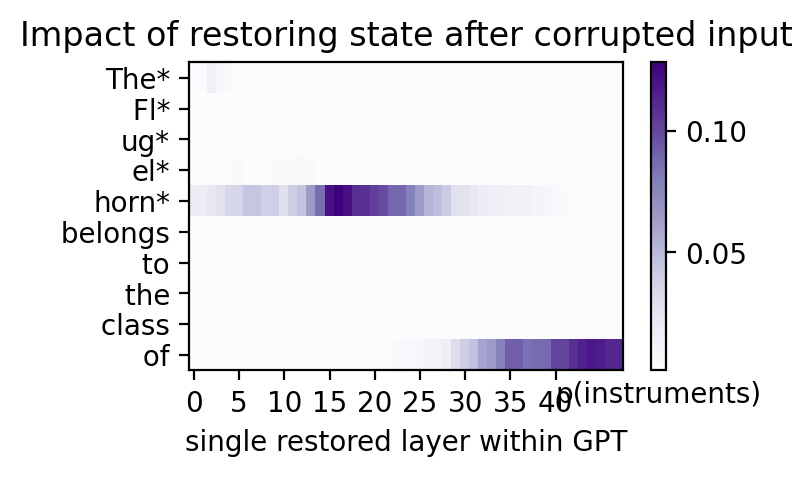

Threshold:  tensor(0.0162)

Highly Activated Neurons:
Layer:  0  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4



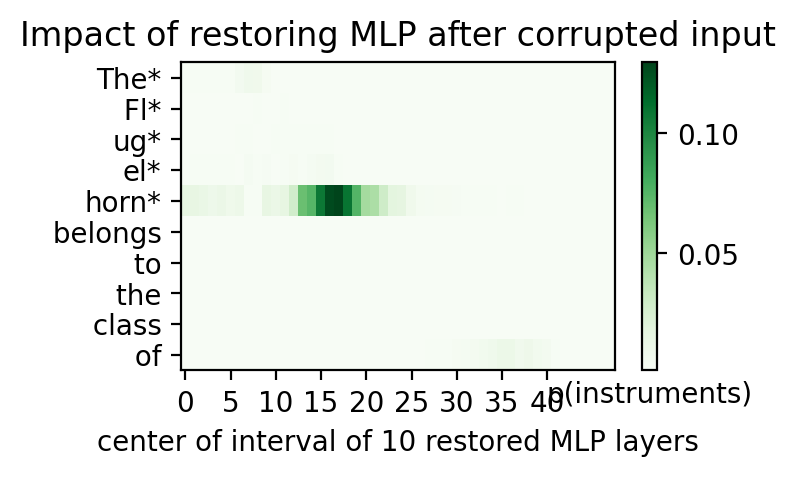

Threshold:  tensor(0.0123)

Highly Activated Neurons:
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  24  Token:  9
Layer:  25  Token:  9
Layer:  26  Token:  9
Layer:  27  Token:  9
Layer:  28  Token:  9
Layer:  29  Token:  9
Layer:  30  Token:  9
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9



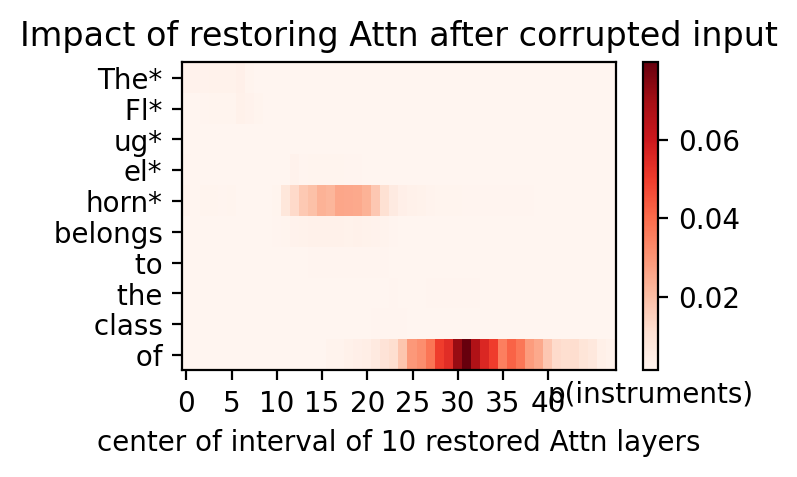

In [ ]:
plot_all_flow(mt, "The Flugelhorn belongs to the class of", noise=noise_level)

Threshold:  tensor(0.3846)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



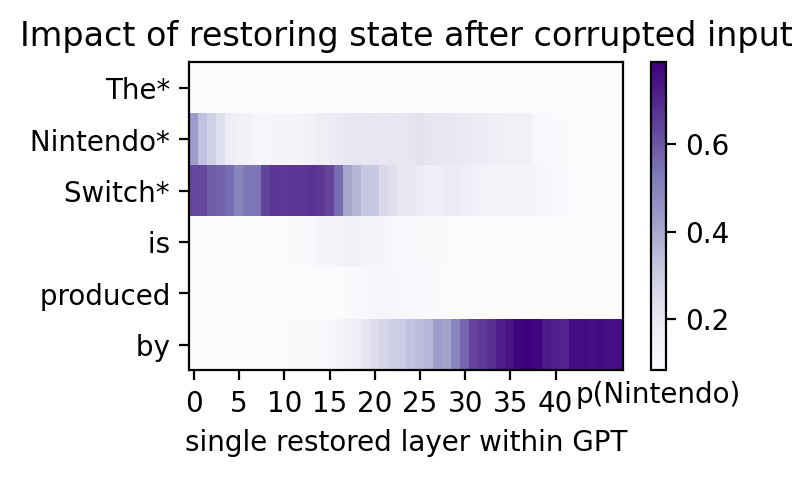

Threshold:  tensor(0.2194)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  9  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2



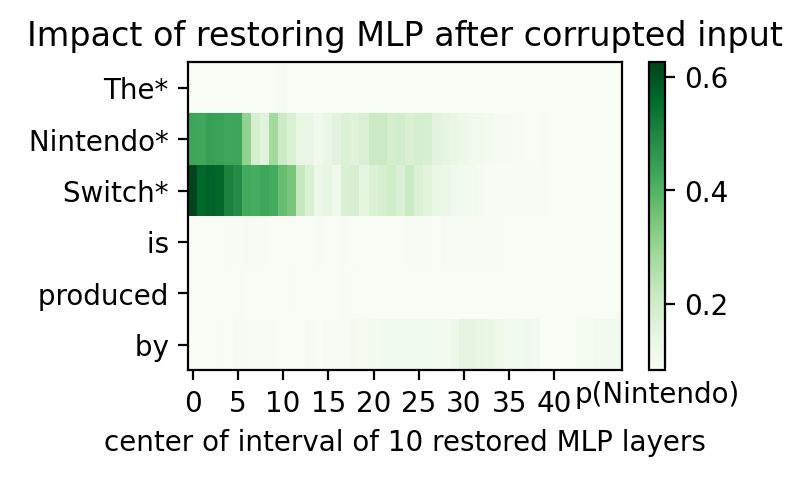

Threshold:  tensor(0.1727)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  24  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5



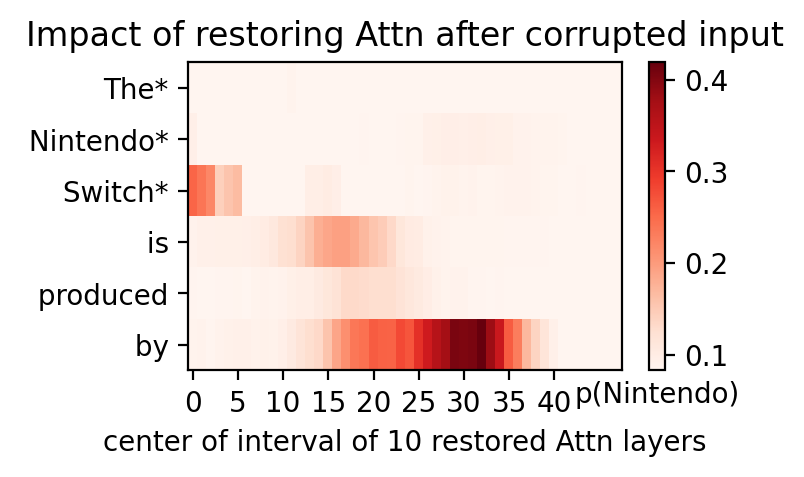

In [ ]:
plot_all_flow(mt, "The Nintendo Switch is produced by", noise=noise_level)

Threshold:  tensor(0.0848)

Highly Activated Neurons:
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



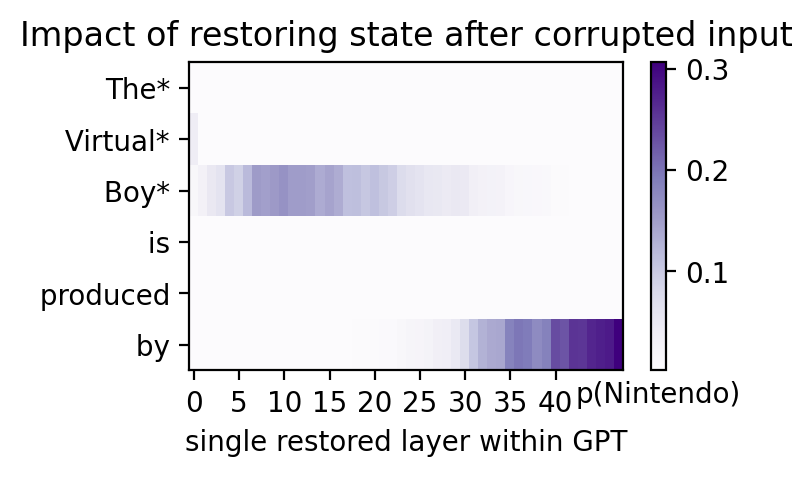

Threshold:  tensor(0.0219)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  7  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2



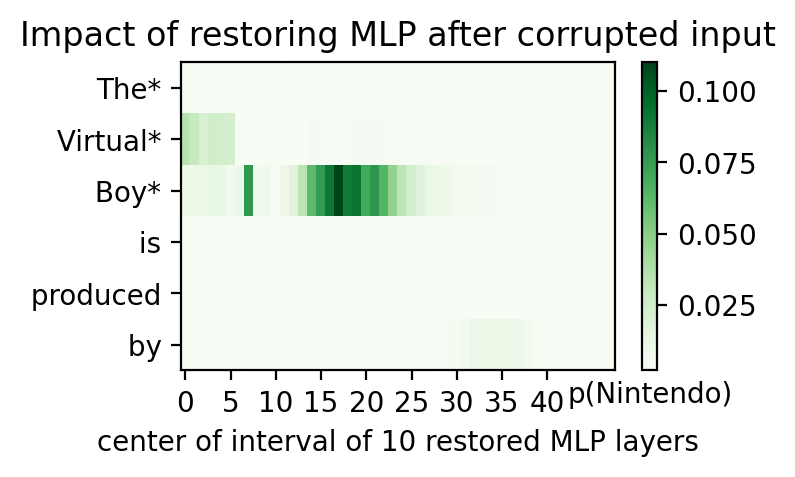

Threshold:  tensor(0.0164)

Highly Activated Neurons:
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  24  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5



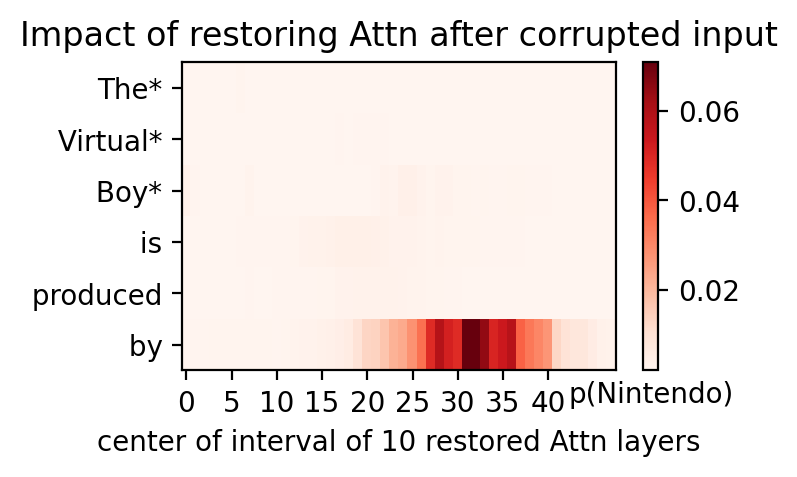

In [ ]:
plot_all_flow(mt, "The Virtual Boy is produced by", noise=noise_level)

Threshold:  tensor(0.5062)

Highly Activated Neurons:
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  30  Token:  3
Layer:  31  Token:  3
Layer:  32  Token:  3
Layer:  33  Token:  3
Layer:  34  Token:  3
Layer:  35  Token:  3
Layer:  36  Token:  3
Layer:  33  Token:  4
Layer:  34  Token:  4
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  3

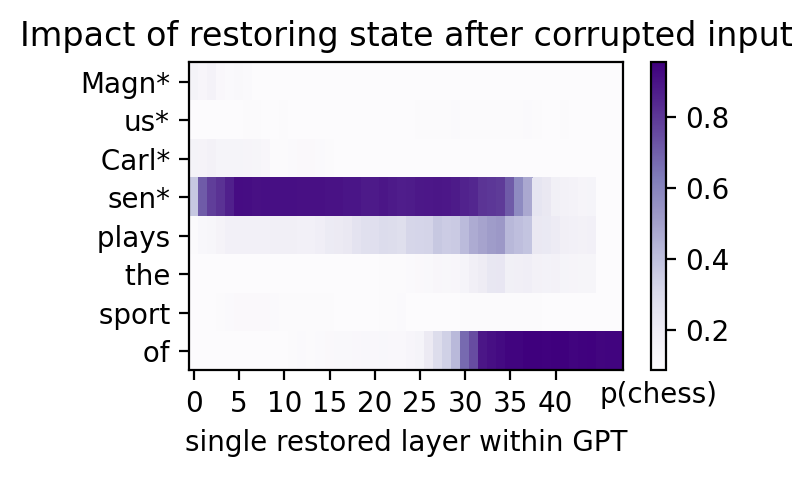

Threshold:  tensor(0.2681)

Highly Activated Neurons:
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7



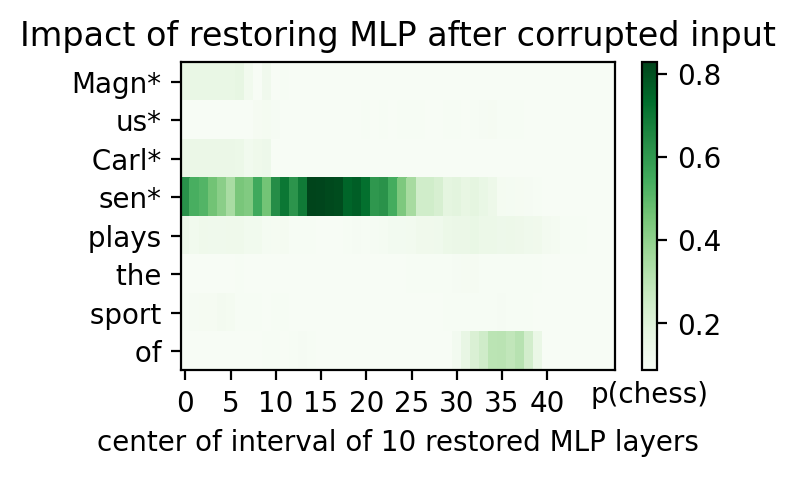

Threshold:  tensor(0.3082)

Highly Activated Neurons:
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  30  Token:  4
Layer:  31  Token:  4
Layer:  32  Token:  4
Layer:  33  Token:  4
Layer:  34  Token:  4
Layer:  35  Token:  4
Layer:  36  Token:  4
Layer:  25  Token:  7
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7



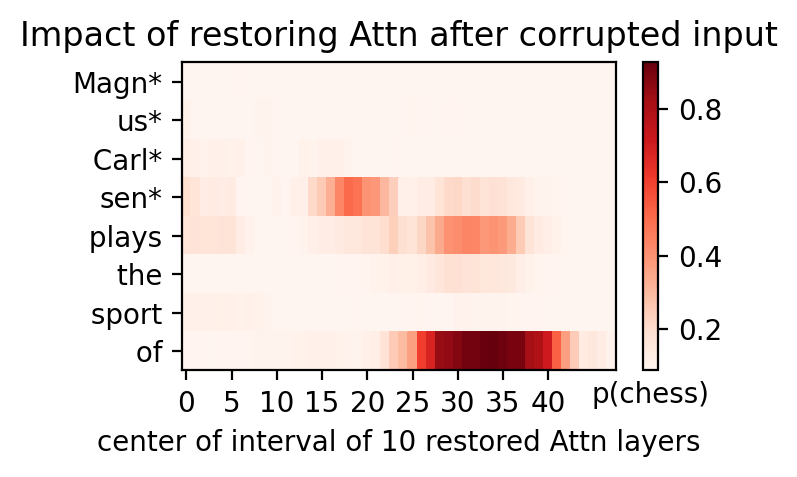

In [ ]:
plot_all_flow(mt, "Magnus Carlsen plays the sport of", noise=noise_level)

Threshold:  tensor(0.0966)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  24  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  28

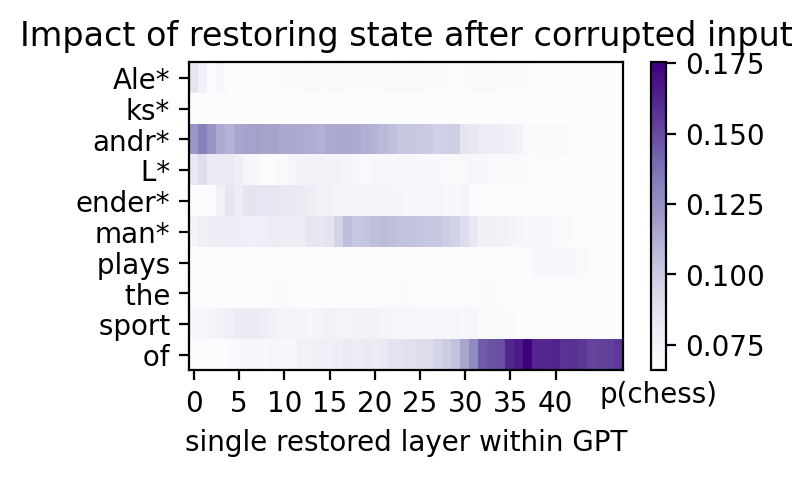

Threshold:  tensor(0.0845)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
L

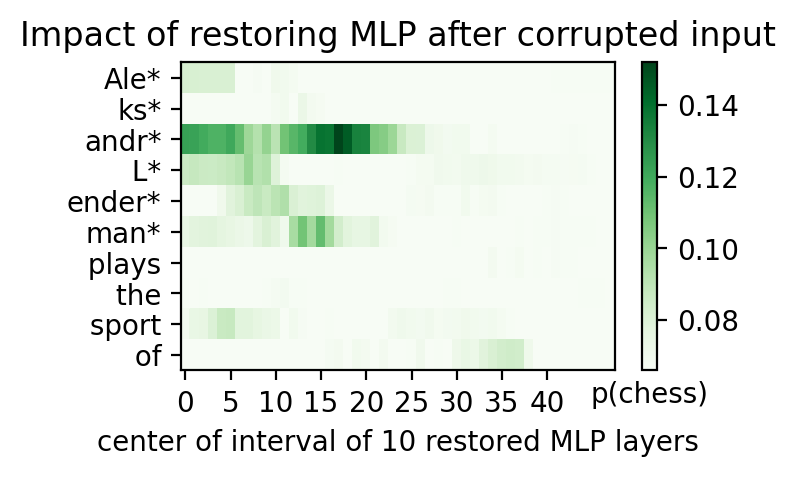

Threshold:  tensor(0.0842)

Highly Activated Neurons:
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  3  Token:  8
Layer:  4  Token:  8
Layer:  26  Token:  9
Layer:  27  Token:  9
Layer:  28  Token:  9
Layer:  29  Token:  9
Layer:  30  Token:  9
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9



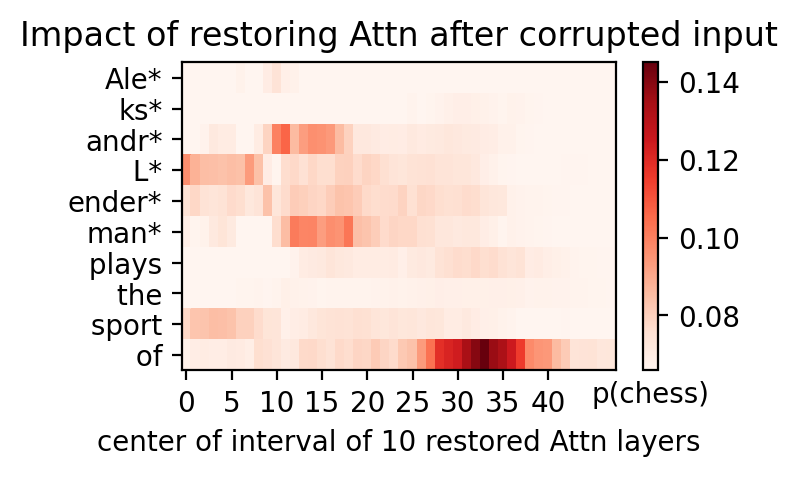

In [ ]:
plot_all_flow(mt, "Aleksandr Lenderman plays the sport of", noise=noise_level)

Threshold:  tensor(0.3570)

Highly Activated Neurons:
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  30  Token:  3
Layer:  31  Token:  3
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43

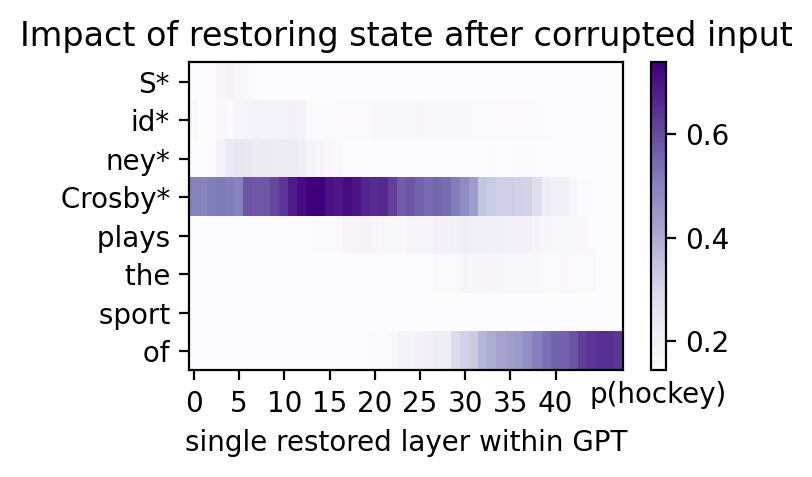

Threshold:  tensor(0.2545)

Highly Activated Neurons:
Layer:  8  Token:  1
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  29  Token:  3



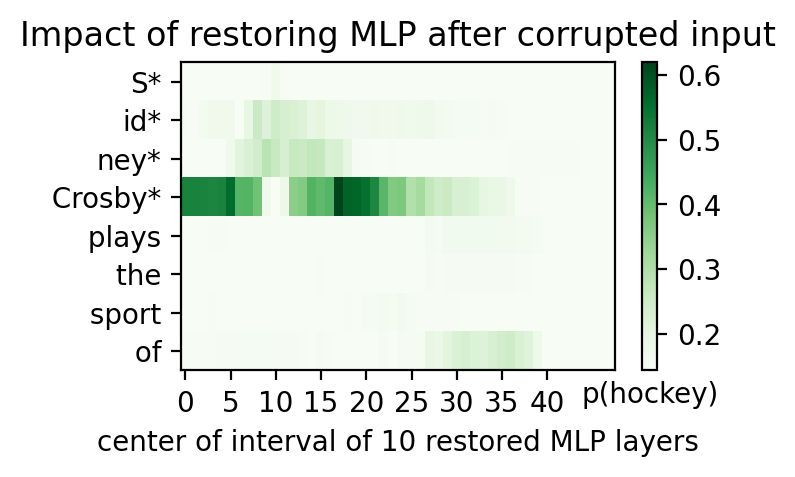

Threshold:  tensor(0.2257)

Highly Activated Neurons:
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  30  Token:  3
Layer:  25  Token:  7
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



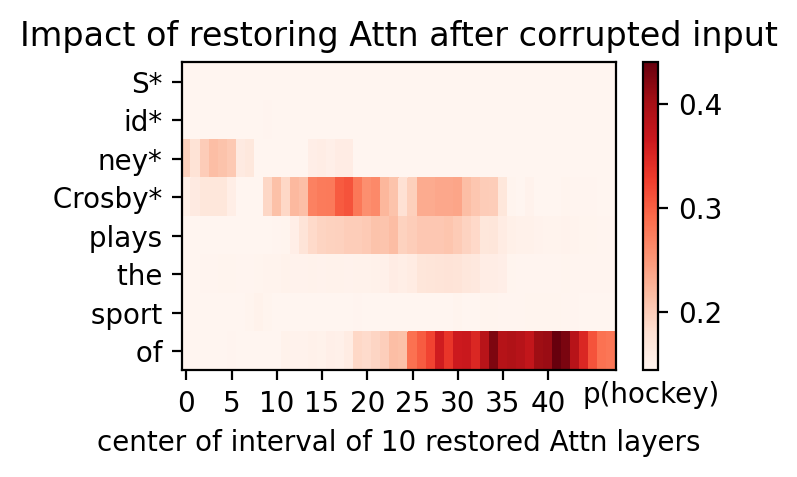

In [ ]:
plot_all_flow(mt, "Sidney Crosby plays the sport of", noise=noise_level)

Threshold:  tensor(0.1072)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  1  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  To

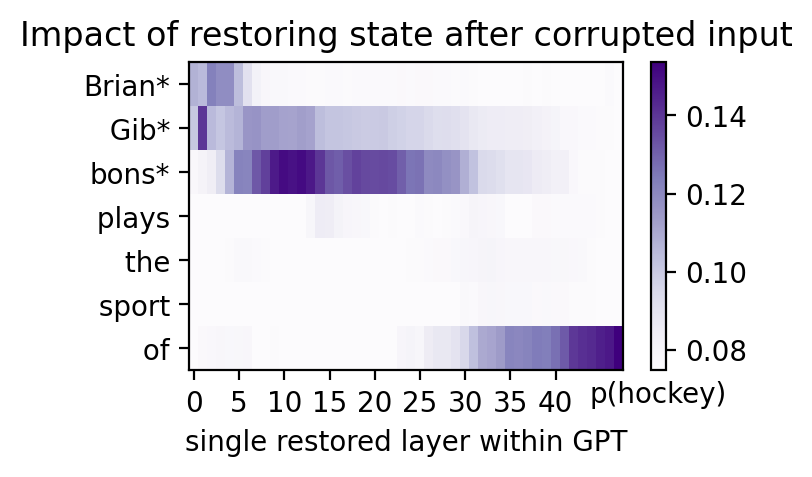

Threshold:  tensor(0.0944)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  9  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  12  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2



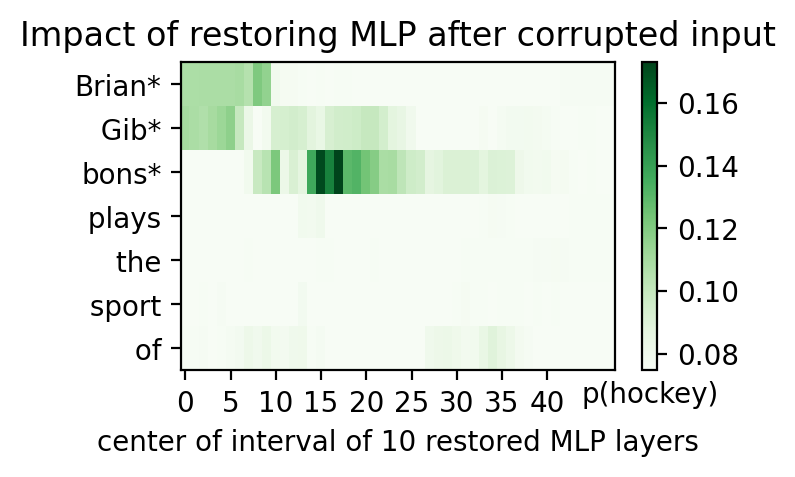

Threshold:  tensor(0.0937)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



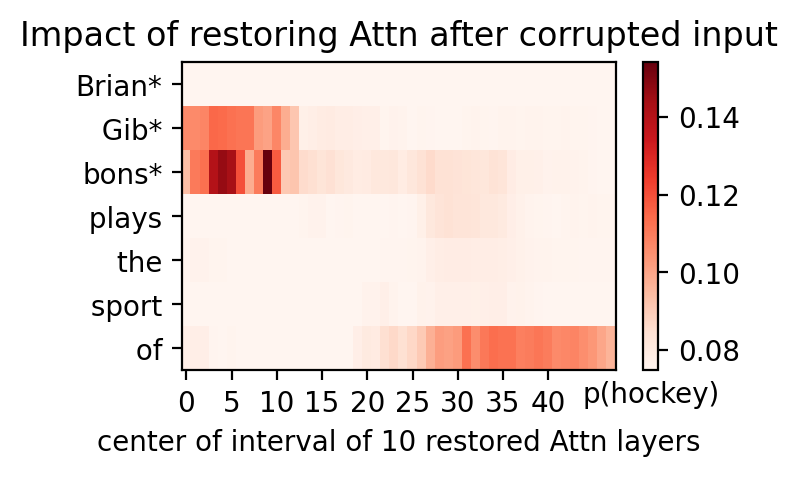

In [ ]:
plot_all_flow(mt, "Brian Gibbons plays the sport of", noise=noise_level)

# Basketball

Threshold:  tensor(0.4479)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  32  Toke

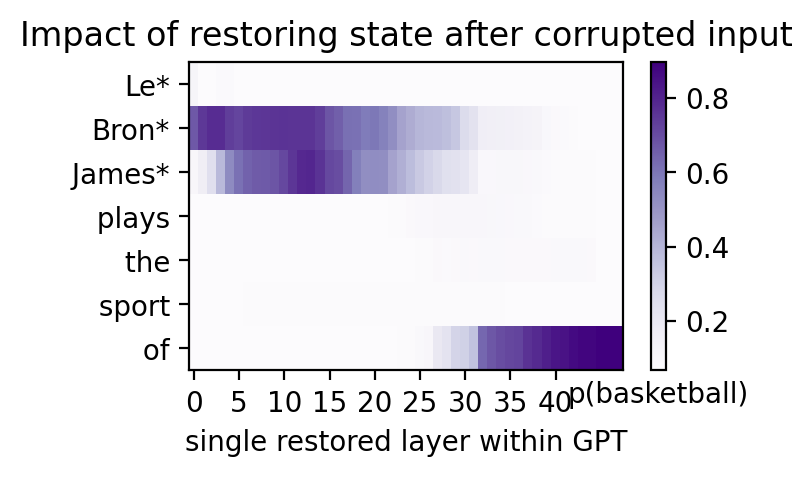

Threshold:  tensor(0.2842)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  22  Token:  1
Layer:  6  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2



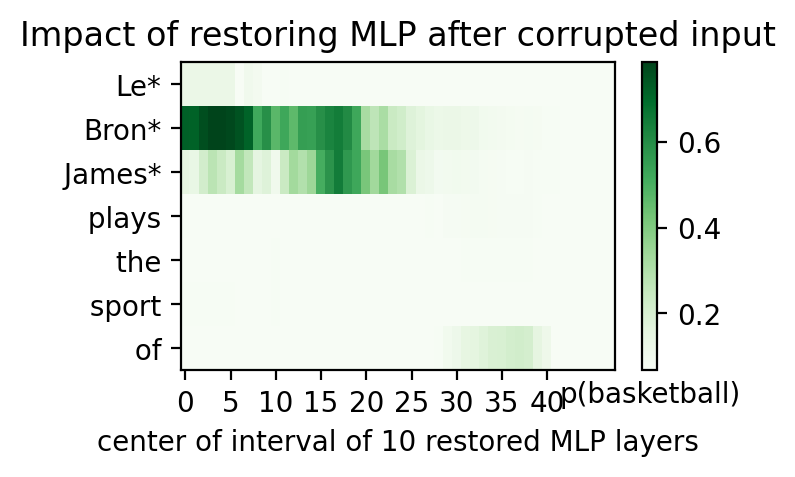

Threshold:  tensor(0.1629)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  23  Token:  6
Layer:  24  Token:  6
Layer:  25  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6



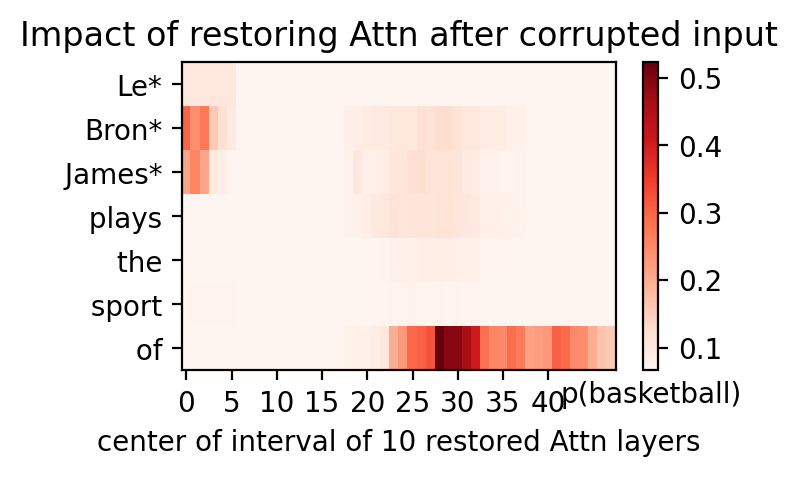

Threshold:  tensor(0.5062)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45

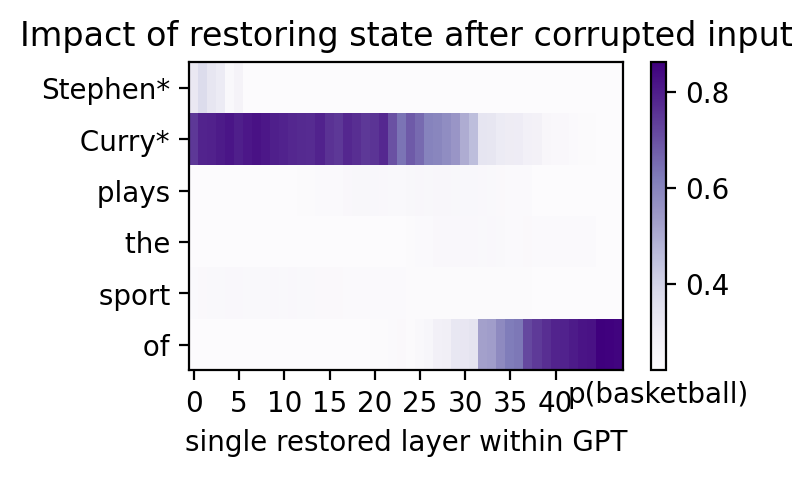

Threshold:  tensor(0.4066)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1



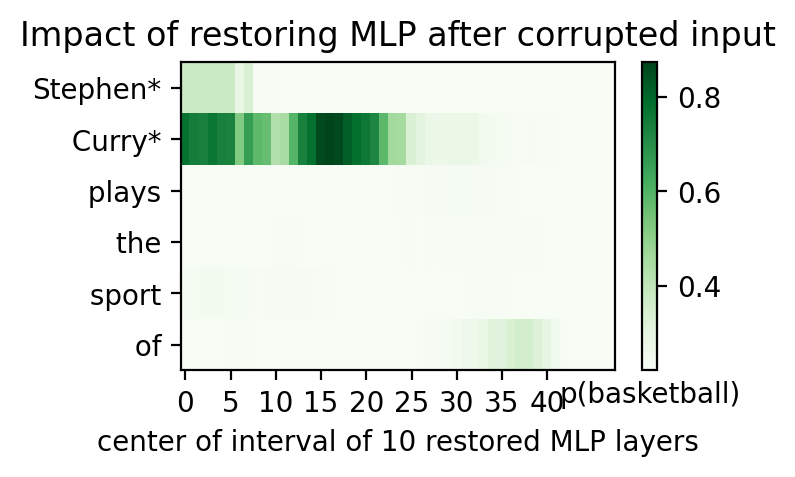

Threshold:  tensor(0.3051)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



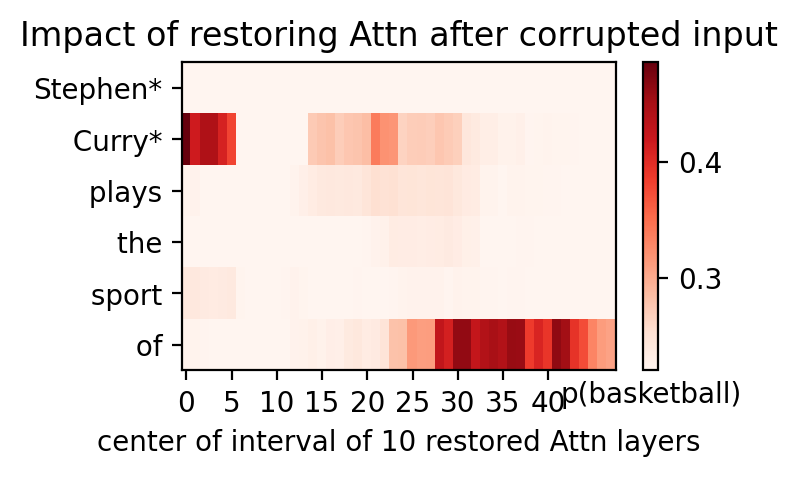

Threshold:  tensor(0.5673)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



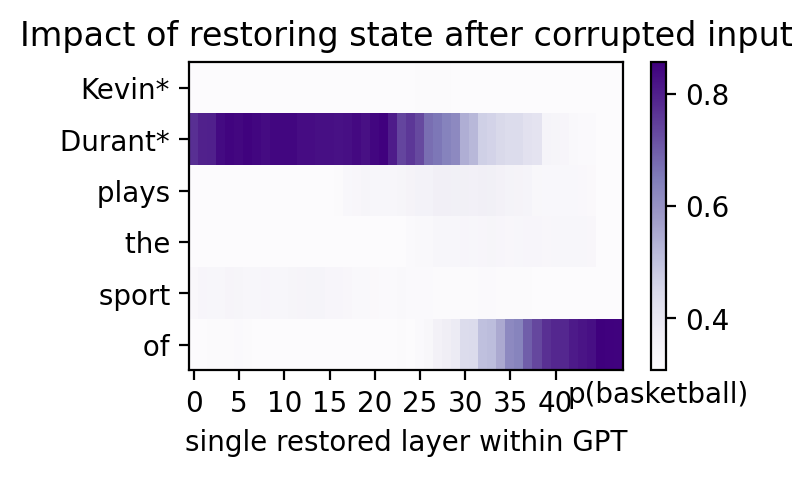

Threshold:  tensor(0.4412)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  8  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  30  Token:  1
Layer:  37  Token:  5



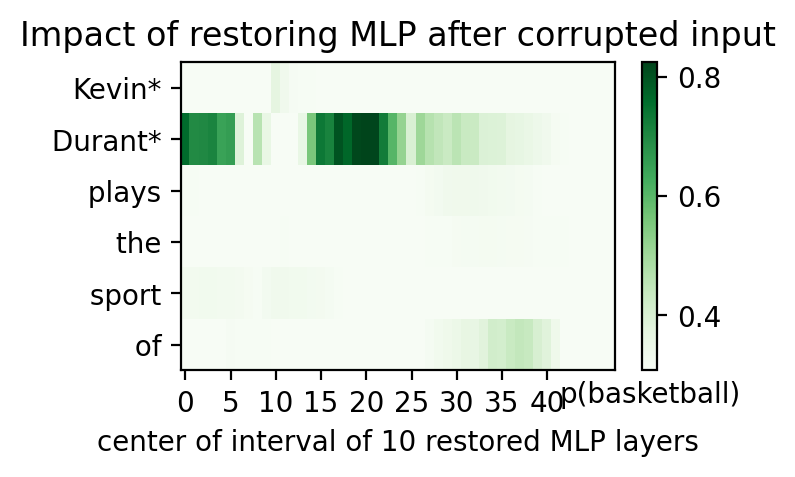

Threshold:  tensor(0.3959)

Highly Activated Neurons:
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



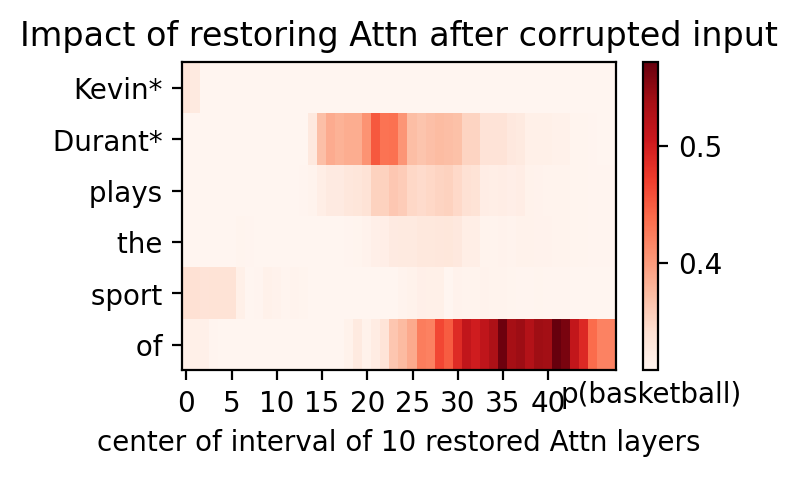

Threshold:  tensor(0.0964)

Highly Activated Neurons:
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9
Layer:  44  Token:  9
Layer:  45  Token:  9
Layer:  46  Token:  9
Layer:  47

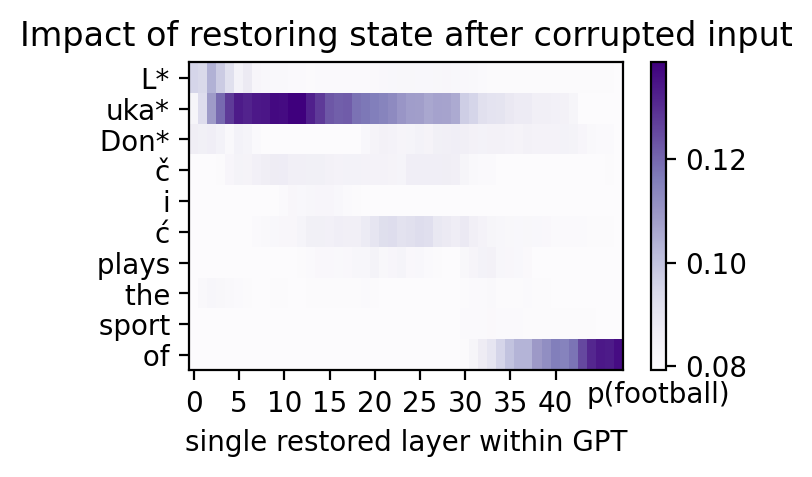

Threshold:  tensor(0.0905)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  9  Token:  0
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  24  Token:  5
Layer:  19  Token:  6
Layer:  20  Token:  6
Layer:  31  Token:  9
Layer:  33  Token:

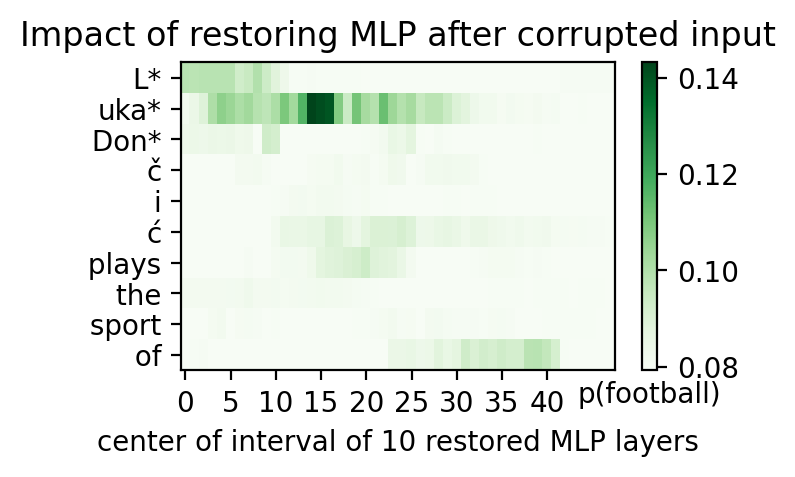

Threshold:  tensor(0.0884)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  27  Token:  9
Layer:  28  Token:  9
Layer:  29  Token:  9
Layer:  30  Token:  9
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9
Layer:  44  Token:  9
Layer:  45  Token:  9
Layer:  46  Token:  9
Layer:  47  Token:  9



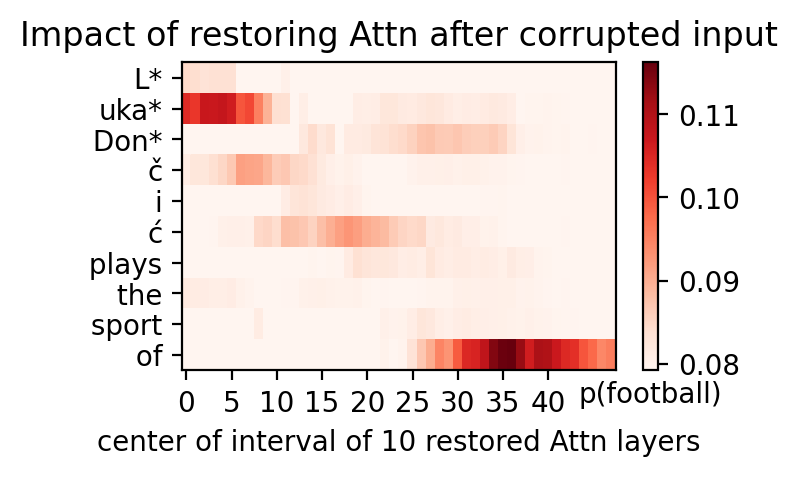

Threshold:  tensor(0.2300)

Highly Activated Neurons:
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  8  Token:  8
Layer:  9  Token:  8
Layer:  10  Token:  8
Layer:  11  Token:  8
Layer:  12  Token:  8
Layer:  13  Token:  8
Layer:  14  Token:  8
Layer:  15  Token:  8
Layer:  16  Token:  8
Layer:  17  Token:  8
Layer:  18  Token:  8
Layer:  19  Token:  8
Layer:  20  Token:  8
Layer:  21  Token:  8
Layer:  22  Token:  8
Layer:  23  Token:  8
Layer:  24  Token:  8
Layer:  25  Token:  8
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Lay

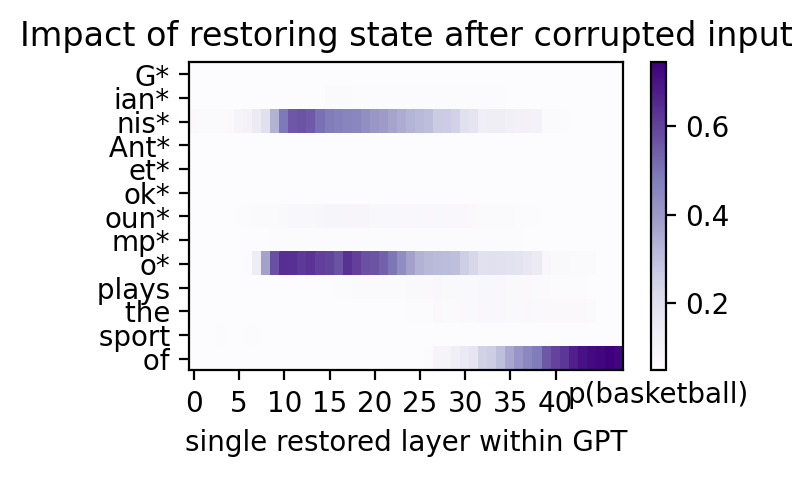

Threshold:  tensor(0.1063)

Highly Activated Neurons:
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  12  Token:  8
Layer:  13  Token:  8
Layer:  14  Token:  8
Layer:  15  Token:  8
Layer:  16  Token:  8
Layer:  17  Token:  8
Layer:  18  Token:  8
Layer:  19  Token:  8
Layer:  20  Token:  8
Layer:  21  Token:  8
Layer:  22  Token:  8
Layer:  23  Token:  8
Layer:  33  Token:  12
Layer:  34  Token:  12
Layer:  35  Token:  12
Layer:  36  Token:  12
Layer:  37  Token:  12
Layer:  38  Token:  12



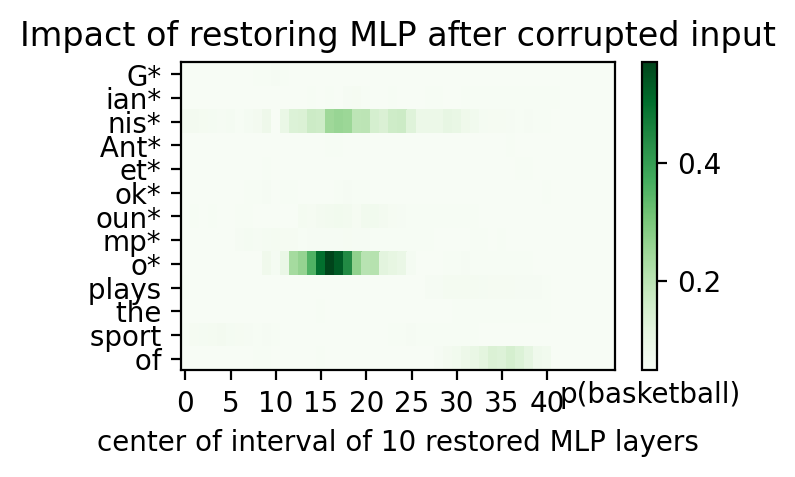

Threshold:  tensor(0.1002)

Highly Activated Neurons:
Layer:  23  Token:  12
Layer:  24  Token:  12
Layer:  25  Token:  12
Layer:  26  Token:  12
Layer:  27  Token:  12
Layer:  28  Token:  12
Layer:  29  Token:  12
Layer:  30  Token:  12
Layer:  31  Token:  12
Layer:  32  Token:  12
Layer:  33  Token:  12
Layer:  34  Token:  12
Layer:  35  Token:  12
Layer:  36  Token:  12
Layer:  37  Token:  12
Layer:  38  Token:  12
Layer:  39  Token:  12
Layer:  40  Token:  12
Layer:  41  Token:  12
Layer:  42  Token:  12
Layer:  43  Token:  12
Layer:  44  Token:  12
Layer:  45  Token:  12
Layer:  46  Token:  12
Layer:  47  Token:  12



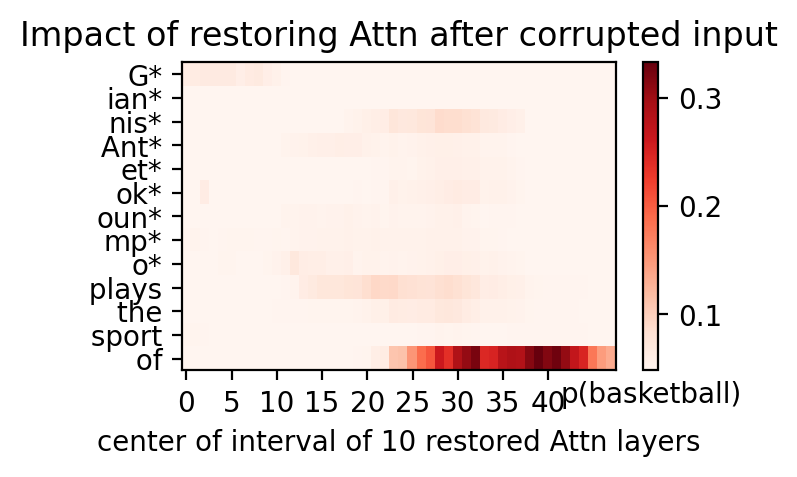

Threshold:  tensor(0.0601)

Highly Activated Neurons:
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  10  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  30  Token:  3
Layer:  32  Token:  3
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer: 

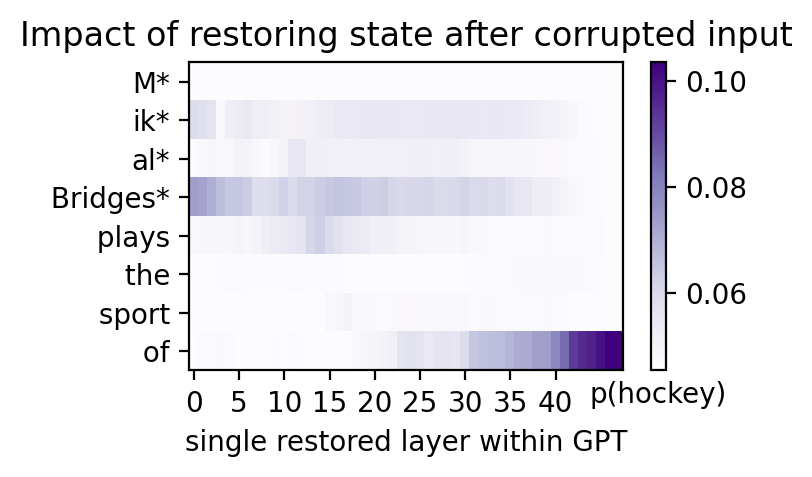

Threshold:  tensor(0.0557)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  13  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  30  Token:  3
Layer:  31  Token:  3
Layer:  32  Token:  3
Layer:  38  Token:  7



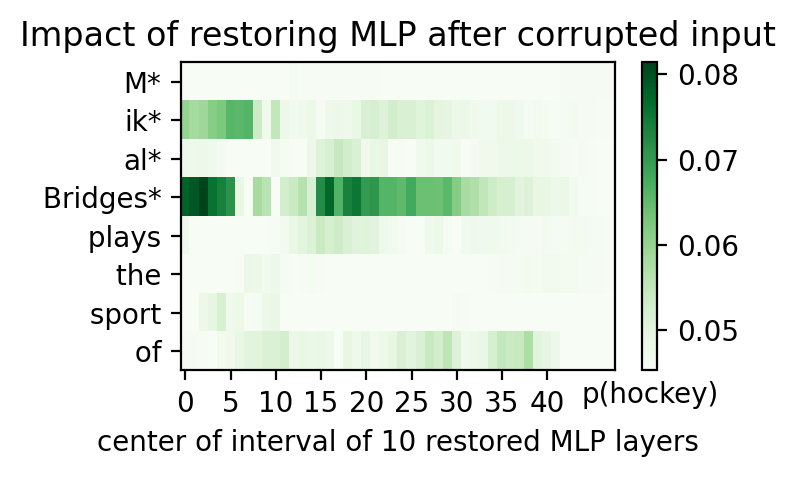

Threshold:  tensor(0.0544)

Highly Activated Neurons:
Layer:  8  Token:  2
Layer:  10  Token:  2
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  19  Token:  7
Layer:  20  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
L

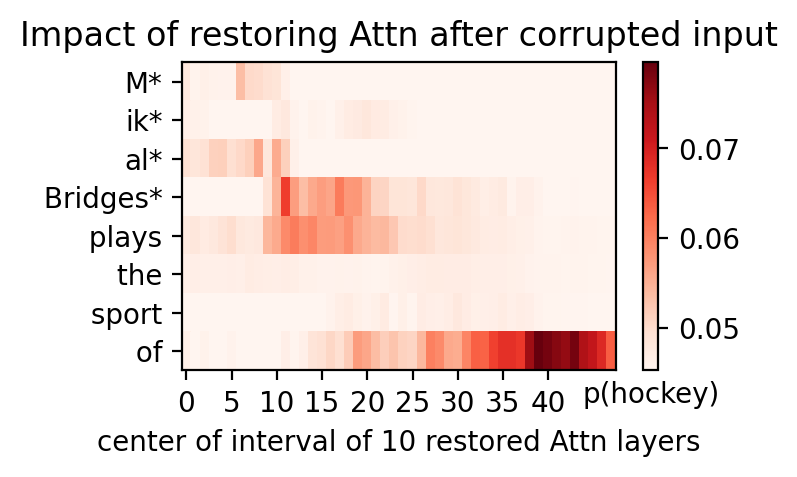

Threshold:  tensor(0.1107)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  1
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  24  Token:  6
Layer:  26  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



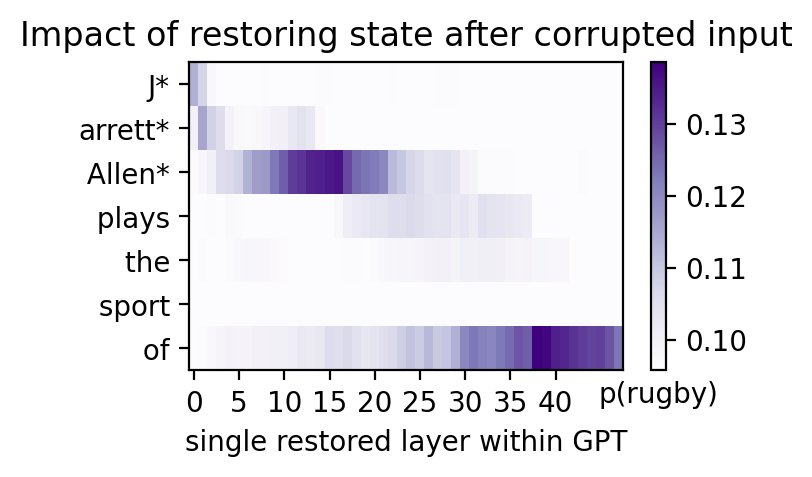

Threshold:  tensor(0.1056)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  18  Token:  2
Layer:  20  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6



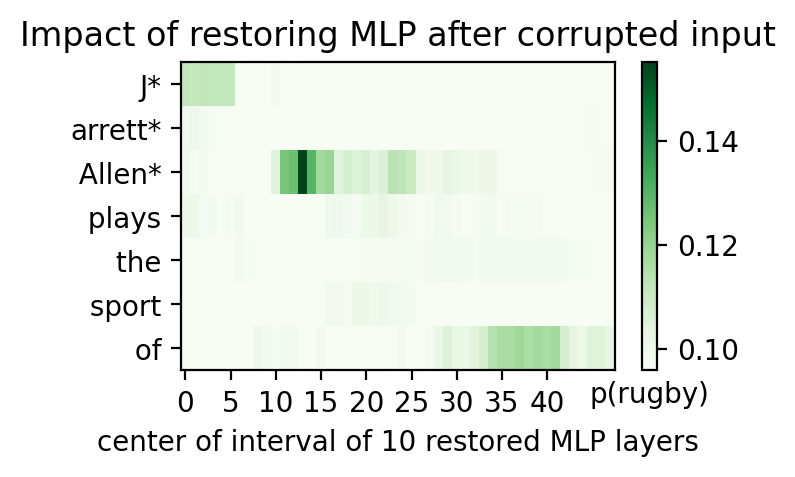

Threshold:  tensor(0.1025)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  12  Token:  6
Layer:  25  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6



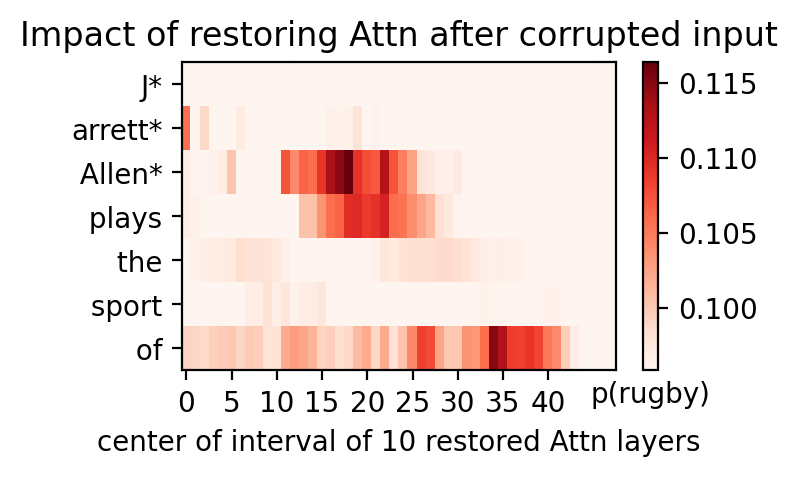

Threshold:  tensor(0.1034)

Highly Activated Neurons:
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  27  Token:  9
Layer:  28  Token:  9
Layer:  29  Token:  9
Layer:  30  Token:  9
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9
Layer:  44  Token:  9
Layer:  

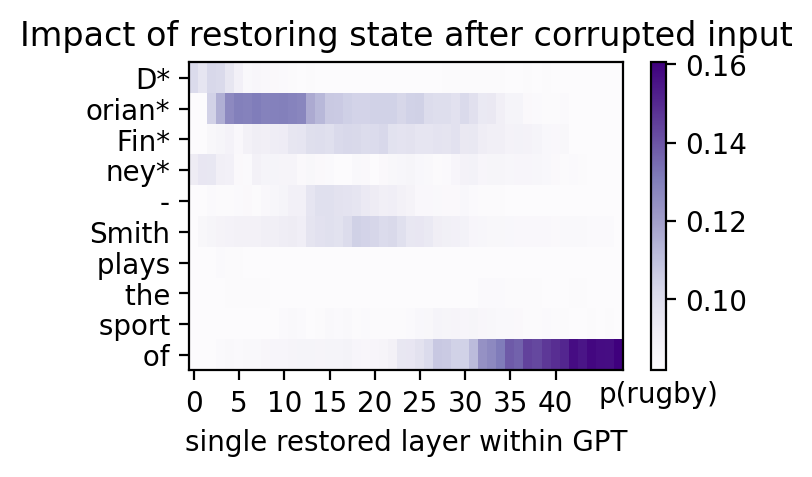

Threshold:  tensor(0.0913)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  16  Token:  2
Layer:  5  Token:  3
Layer:  11  Token:  4
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  32  Token:  9
Layer:  34  To

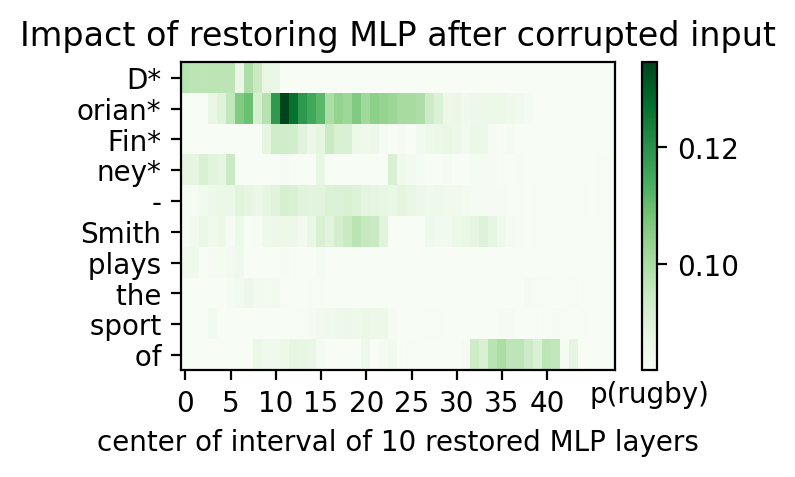

Threshold:  tensor(0.0949)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  10  Token:  1
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  22  Token:  9
Layer:  23  Token:  9
Layer:  24  Token:  9
Layer:  25  Token:  9
Layer:  26 

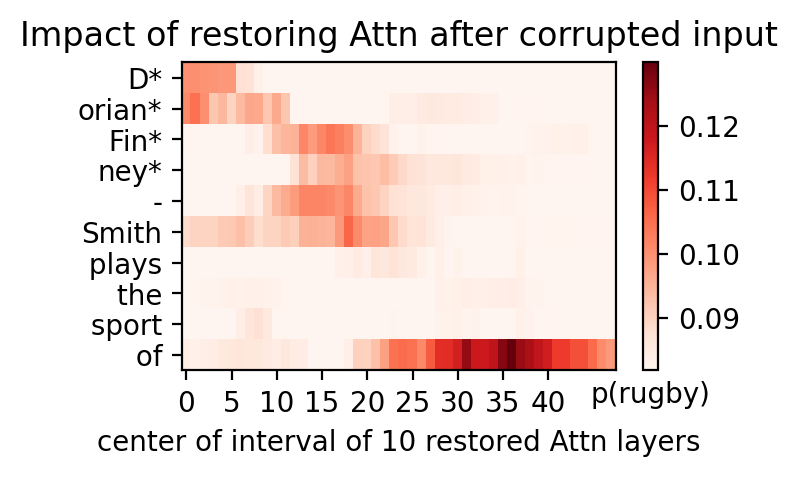

Threshold:  tensor(0.0804)

Highly Activated Neurons:
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  47  Token:  8



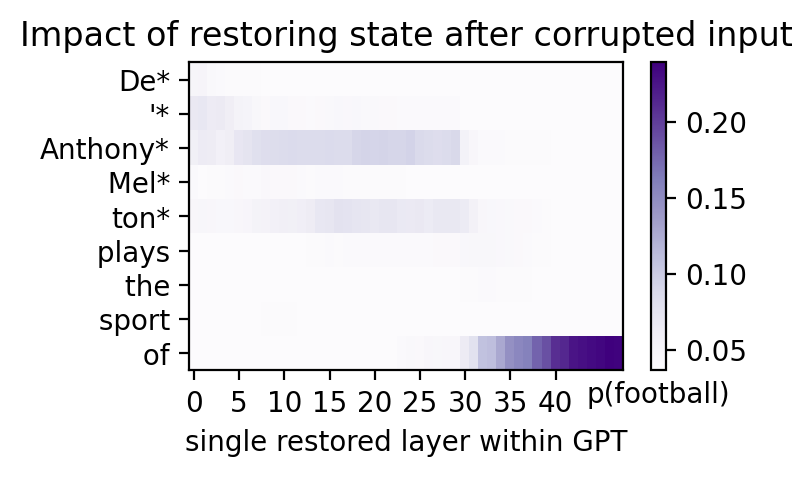

Threshold:  tensor(0.0544)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  19  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  10  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:

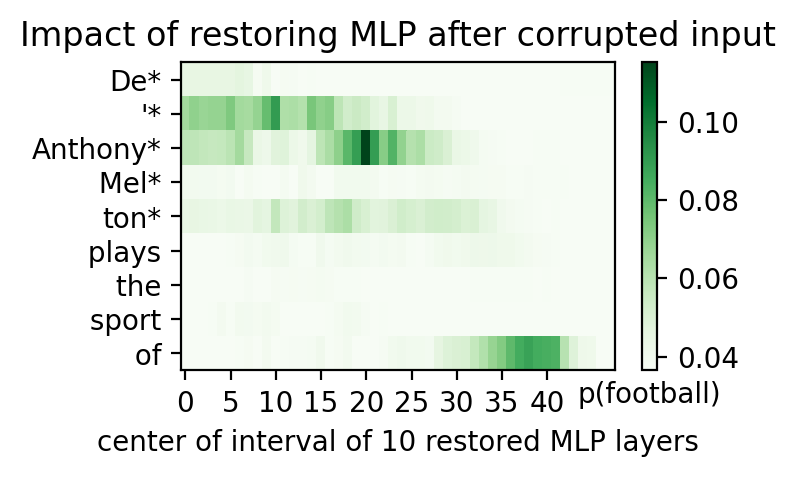

Threshold:  tensor(0.0538)

Highly Activated Neurons:
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8



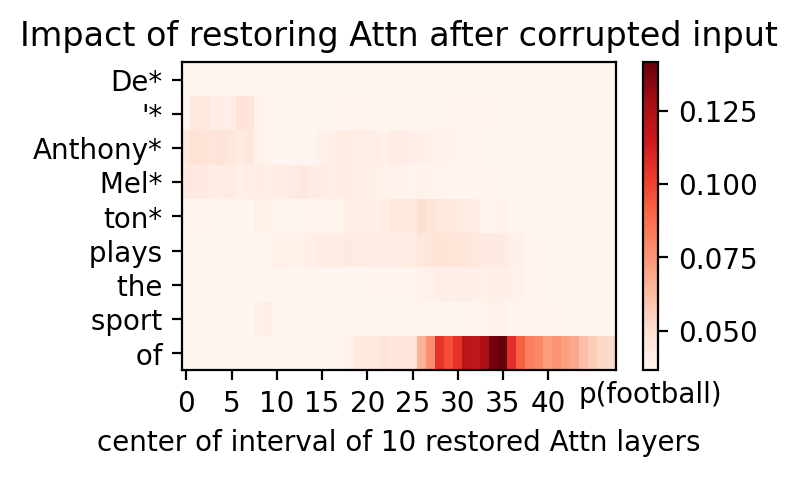

Threshold:  tensor(0.0926)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  28  Token:  1
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  34  Toke

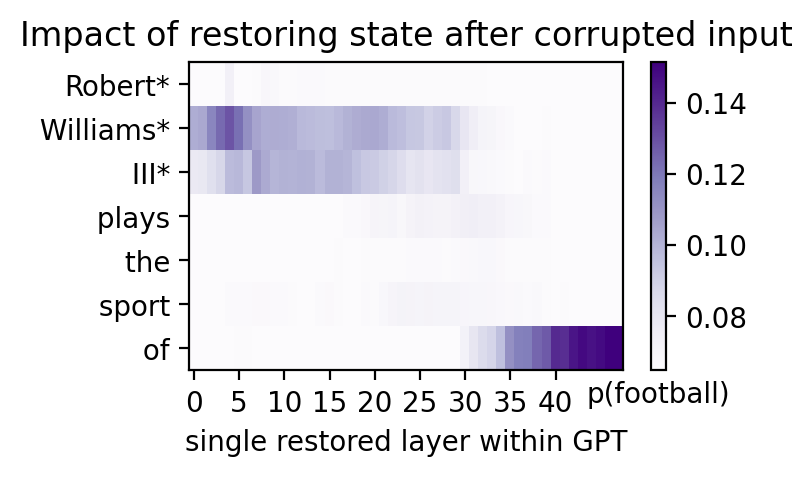

Threshold:  tensor(0.0868)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  17  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  11  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6



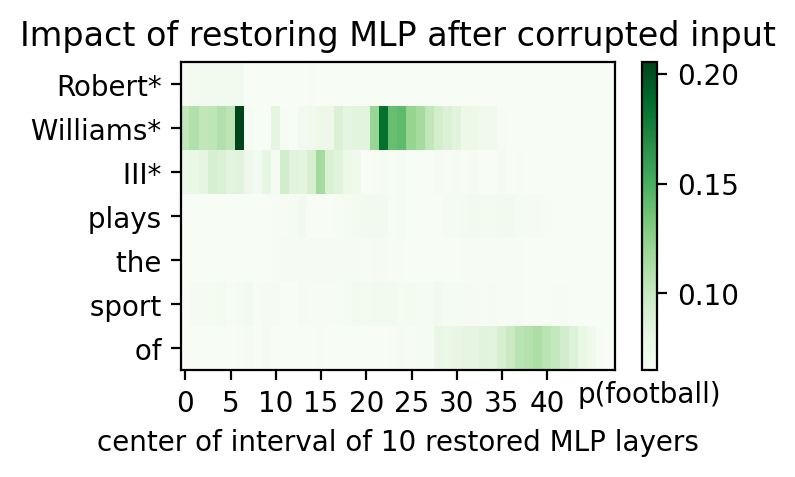

Threshold:  tensor(0.0754)

Highly Activated Neurons:
Layer:  25  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



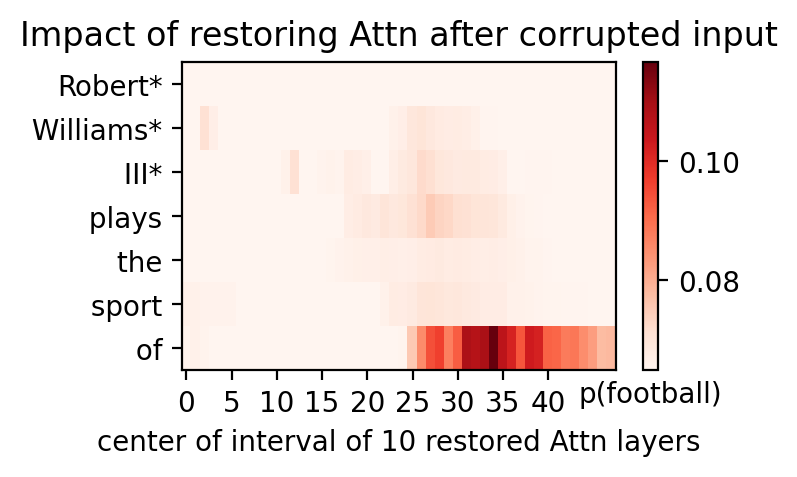

In [ ]:
prompts = [
    "LeBron James plays the sport of",
    "Stephen Curry plays the sport of",
    "Kevin Durant plays the sport of",
    "Luka Dončić plays the sport of",
    "Giannis Antetokounmpo plays the sport of",
    "Mikal Bridges plays the sport of",
    "Jarrett Allen plays the sport of",
    "Dorian Finney-Smith plays the sport of",
    "De'Anthony Melton plays the sport of",
    "Robert Williams III plays the sport of"
]

for prompt in prompts:
    plot_all_flow(mt, prompt, noise=noise_level)

Threshold:  tensor(0.2785)

Highly Activated Neurons:
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  30  Token:  3
Layer:  31  Token:  3
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



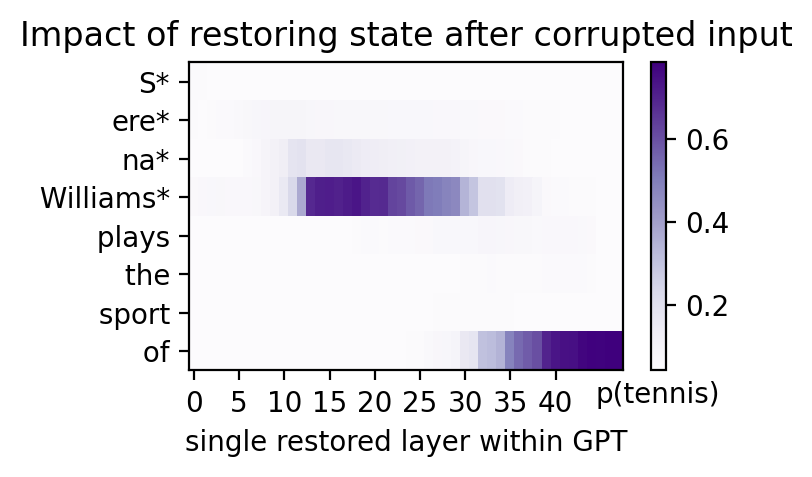

Threshold:  tensor(0.1316)

Highly Activated Neurons:
Layer:  11  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3



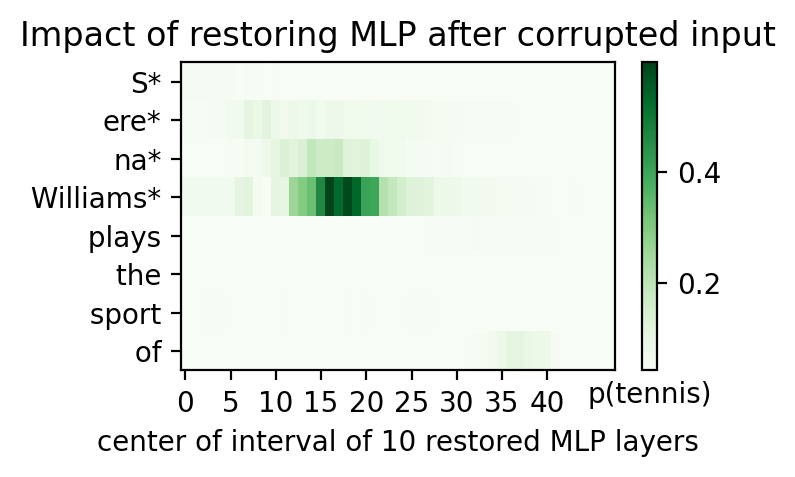

Threshold:  tensor(0.1365)

Highly Activated Neurons:
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7



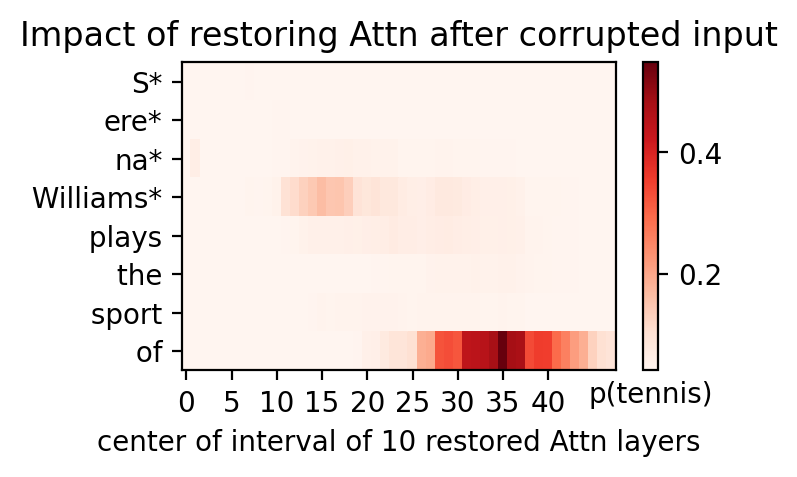

Threshold:  tensor(0.2752)

Highly Activated Neurons:
Layer:  1  Token:  4
Layer:  2  Token:  4
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  30  Token:  4
Layer:  31  Token:  4
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  4

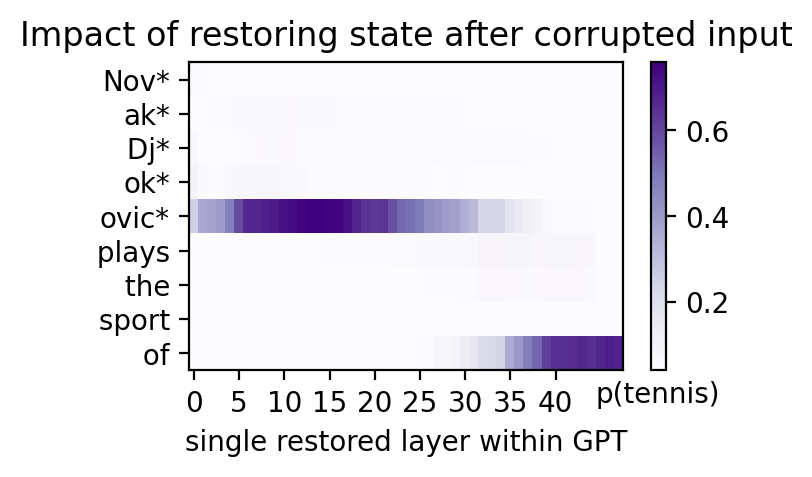

Threshold:  tensor(0.1231)

Highly Activated Neurons:
Layer:  0  Token:  4
Layer:  1  Token:  4
Layer:  2  Token:  4
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  7  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4



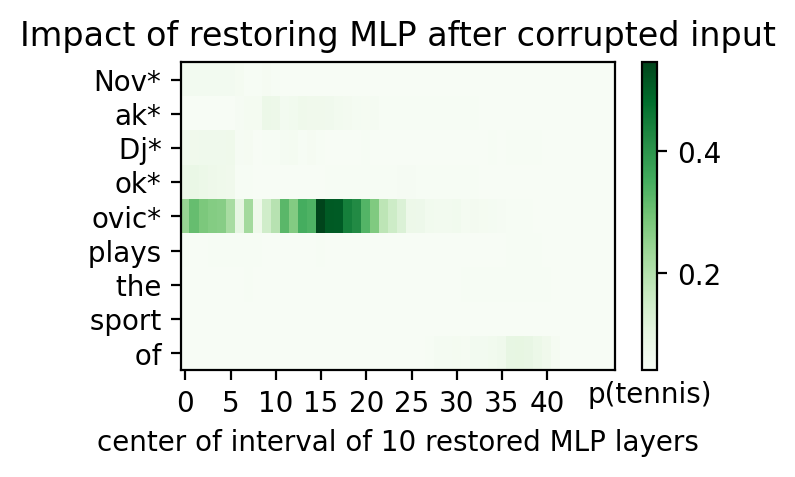

Threshold:  tensor(0.1090)

Highly Activated Neurons:
Layer:  0  Token:  4
Layer:  1  Token:  4
Layer:  2  Token:  4
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8



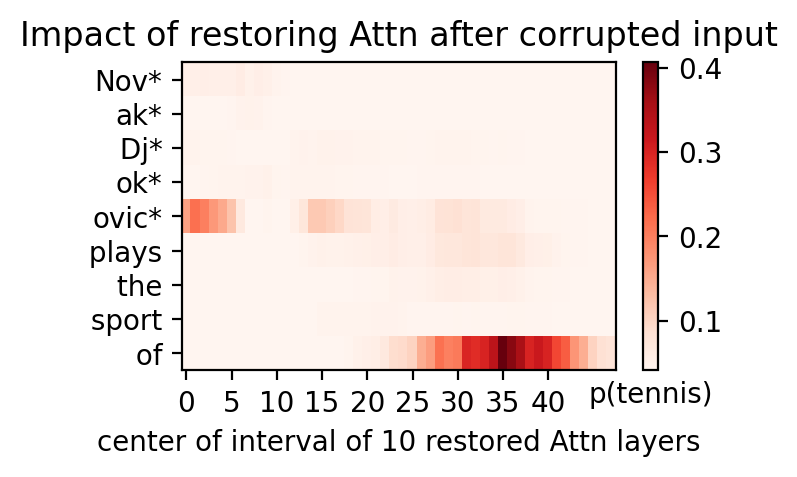

Threshold:  tensor(0.2402)

Highly Activated Neurons:
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  30  Token:  4
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
La

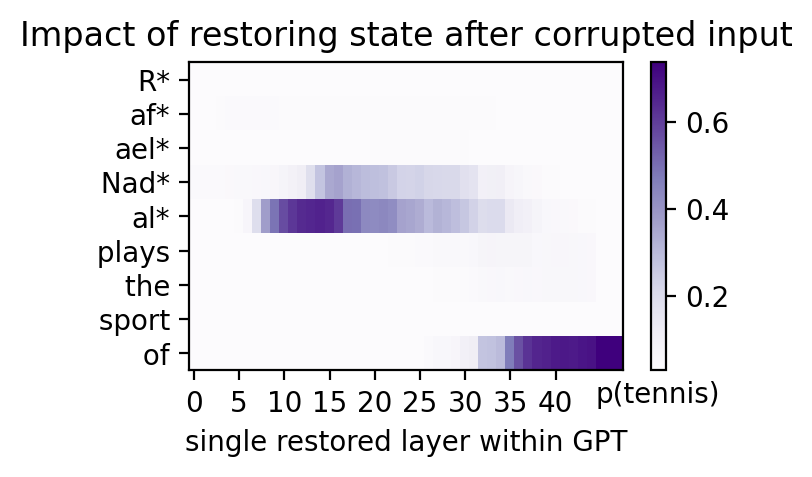

Threshold:  tensor(0.0896)

Highly Activated Neurons:
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4



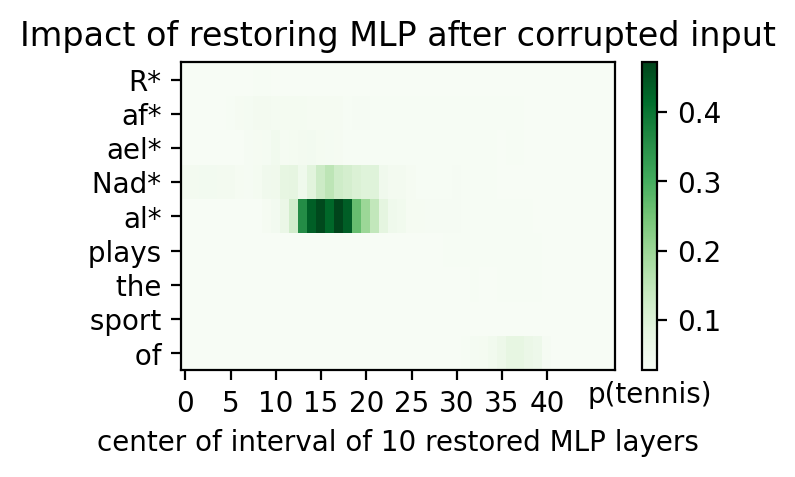

Threshold:  tensor(0.1043)

Highly Activated Neurons:
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8



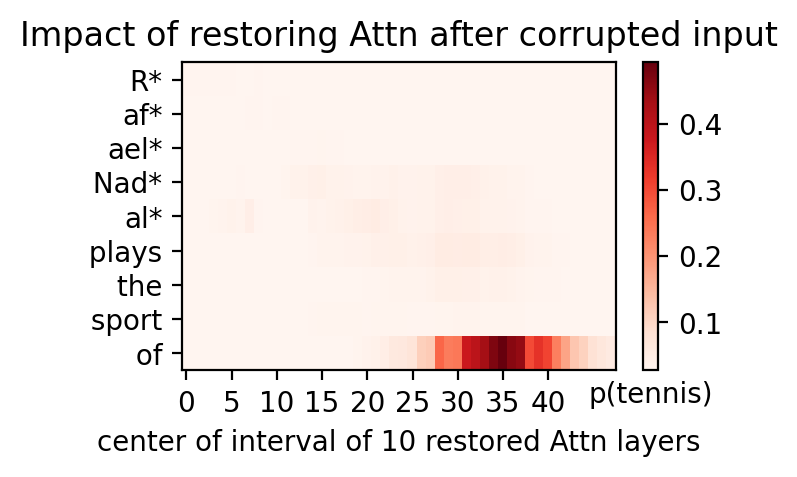

Threshold:  tensor(0.4845)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  31  Token:  2
Layer:  32  Token:  2
Layer:  33  Token:  2
Layer:  34  Token:  2
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40

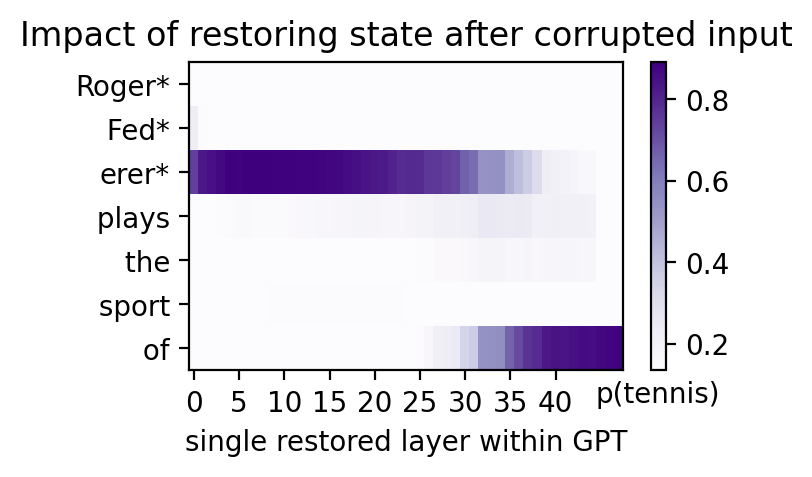

Threshold:  tensor(0.3355)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2



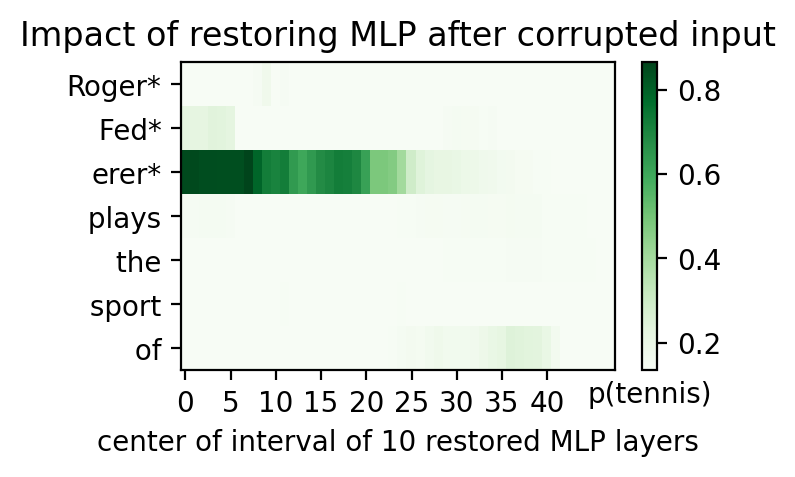

Threshold:  tensor(0.2750)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6



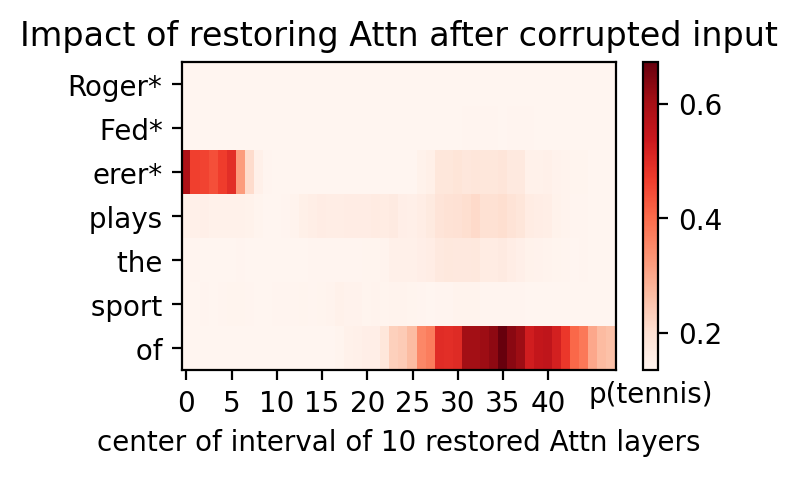

Threshold:  tensor(0.0466)

Highly Activated Neurons:
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  1
Layer:  32  Token:  1
Layer:  33  Token:  1
Layer:  34  Token:  1
Layer:  35  Token:  1
Layer:  36  Token:  1
Layer:  37  Token:  1
Layer:  38  Token:  1
Layer:  10  Token:  2
Layer:  12  T

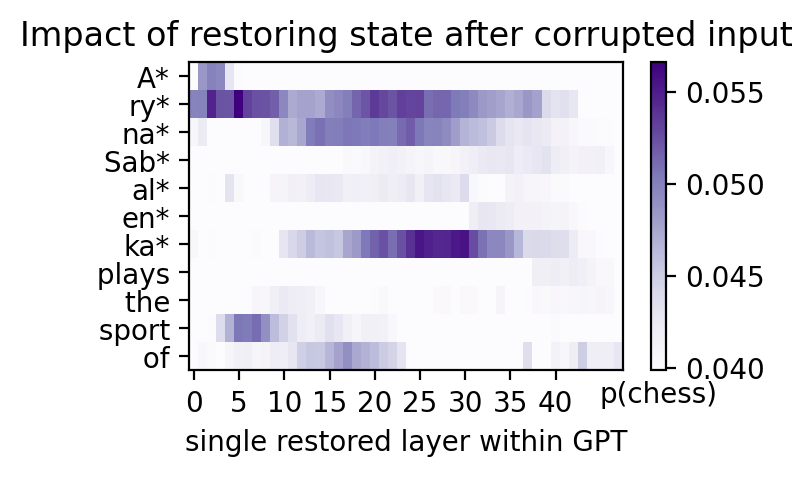

Threshold:  tensor(0.0480)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  7  Token:  4
Layer:  8  

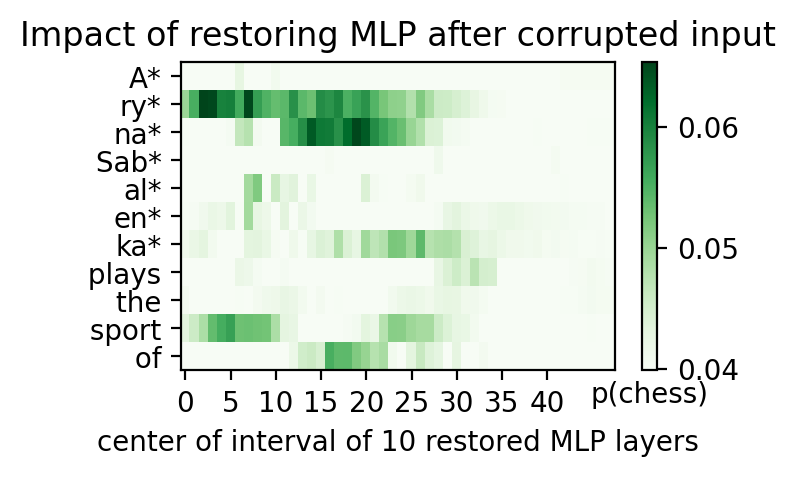

Threshold:  tensor(0.0442)

Highly Activated Neurons:
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  23  Token:  1
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  30  Token:  4
Layer:  31  Token:  4
Layer:  32  Token:  4
Layer:  33  Token:  4
Layer:  34  Token:  4
Layer:  30  Token:  6
Layer:  30  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  0  Token:  9
Layer:  1  Token:  9
Layer:  2  Token:  9
Layer

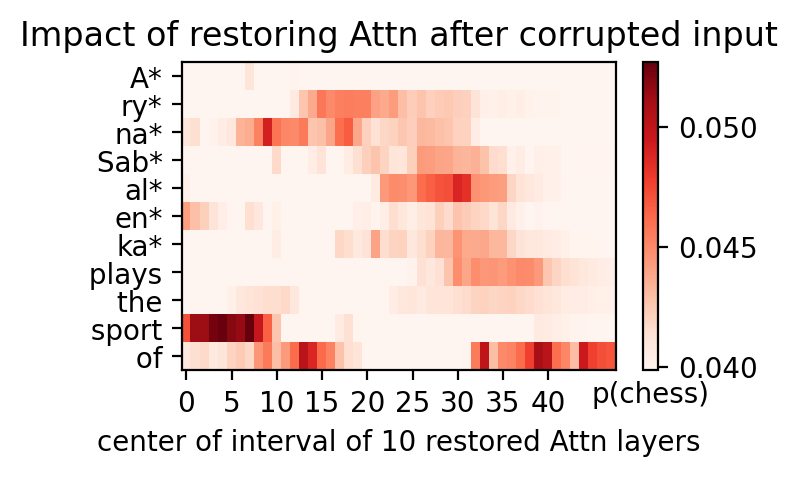

Threshold:  tensor(0.0408)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



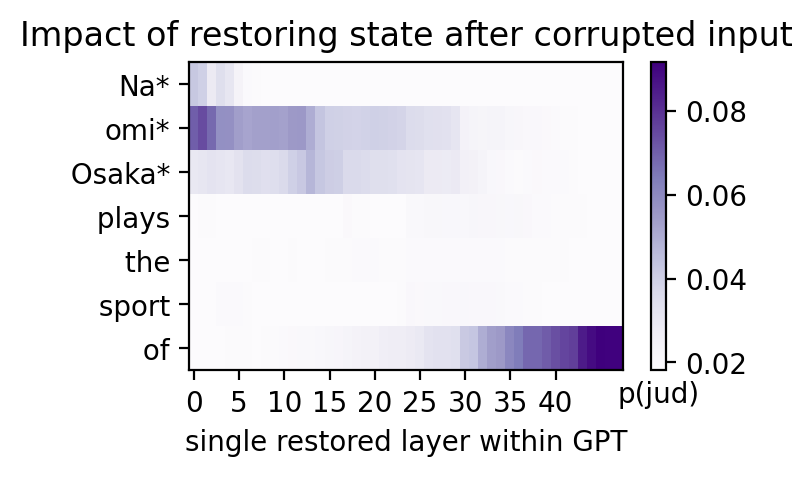

Threshold:  tensor(0.0324)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  21  Token:  2



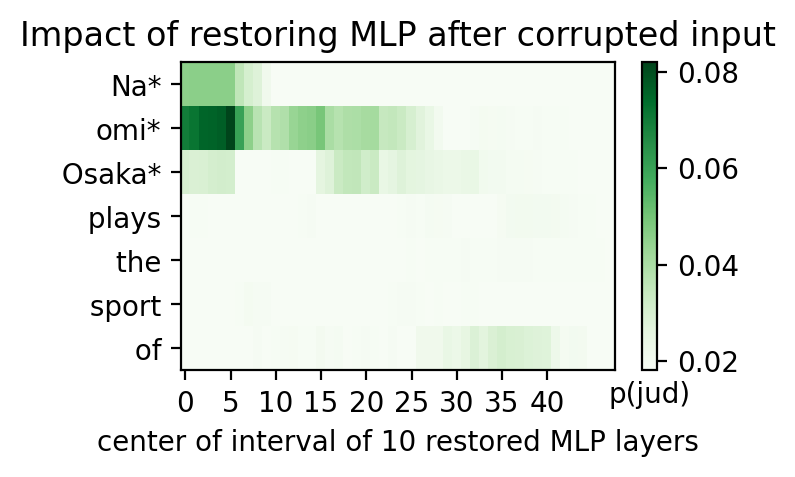

Threshold:  tensor(0.0255)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  22  Token:  6
Layer:  23  Token:  6
Layer:  24  Token:  6
Layer:  25  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6



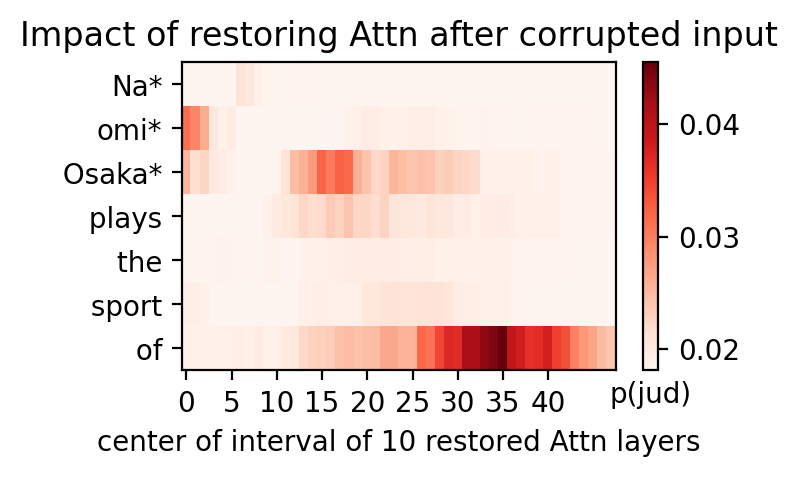

Threshold:  tensor(0.0422)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  1
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  30  Token:  3
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  30  Token:  4
Layer:  31  Token:  4
Layer:  32  Token:  4
Layer:  3

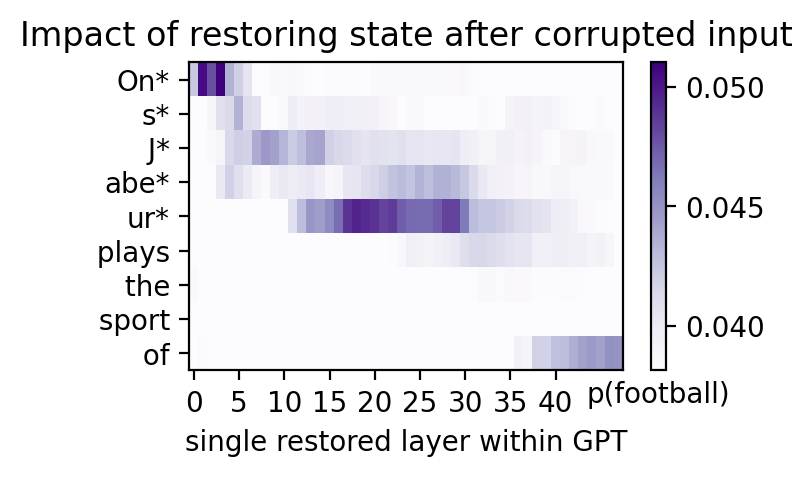

Threshold:  tensor(0.0414)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  11  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  30  Token:  3
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  T

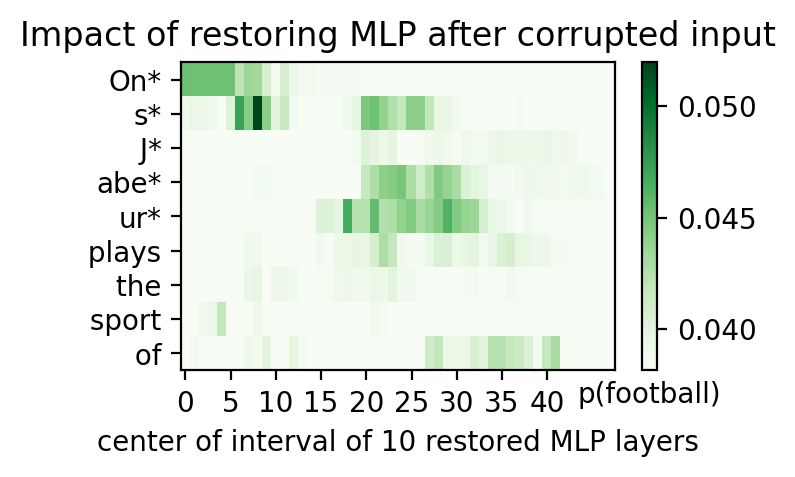

Threshold:  tensor(0.0416)

Highly Activated Neurons:
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  10  Token:  1
Layer:  8  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  13  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  0  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  27  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  

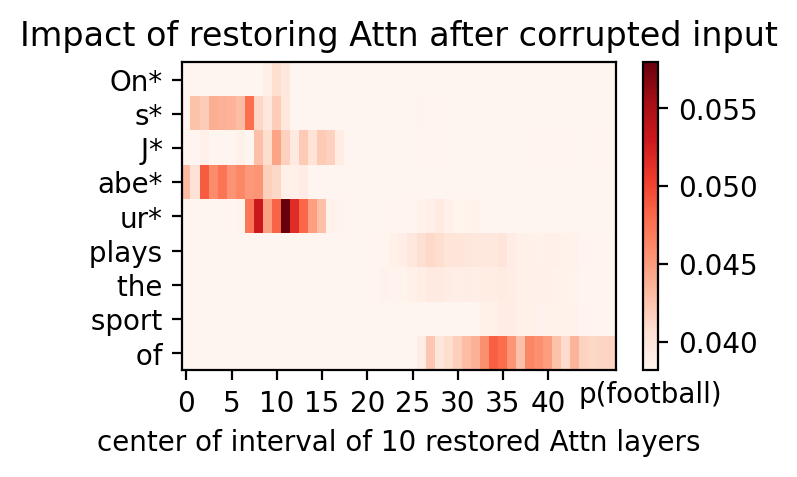

Threshold:  tensor(0.0651)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  1
Layer:  32  Token:  1
Layer:  33  Token:  1
Layer:  34  Token:  1
Layer:  35  Token:  1
Layer:  36  Token:  1
Layer:  11  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2



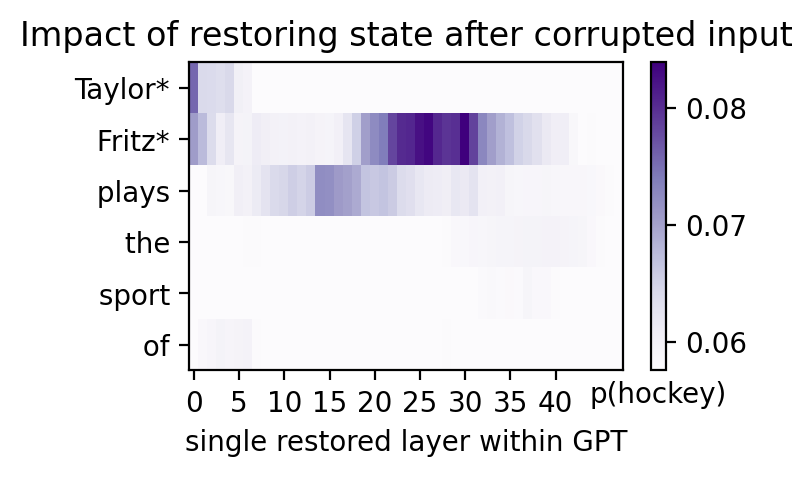

Threshold:  tensor(0.0651)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  31  Token:  1
Layer:  32  Token:  1
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2



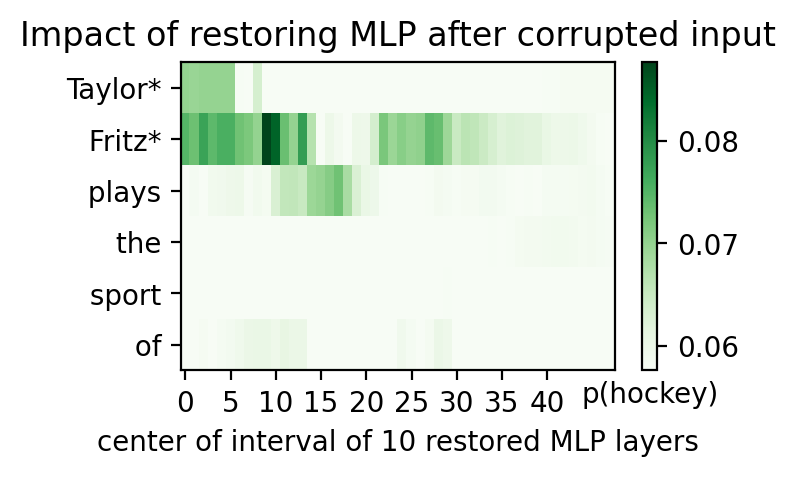

Threshold:  tensor(0.0626)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  7  Token:  1
Layer:  9  Token:  1
Layer:  13  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  31  Token:  2
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



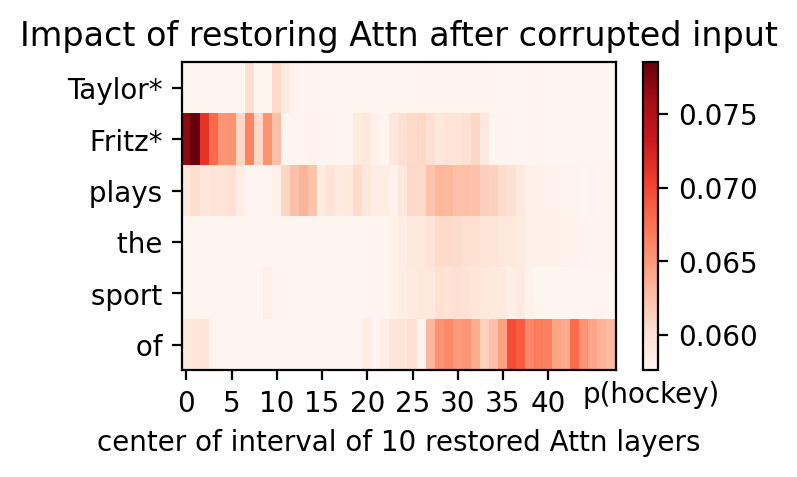

Threshold:  tensor(0.0557)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



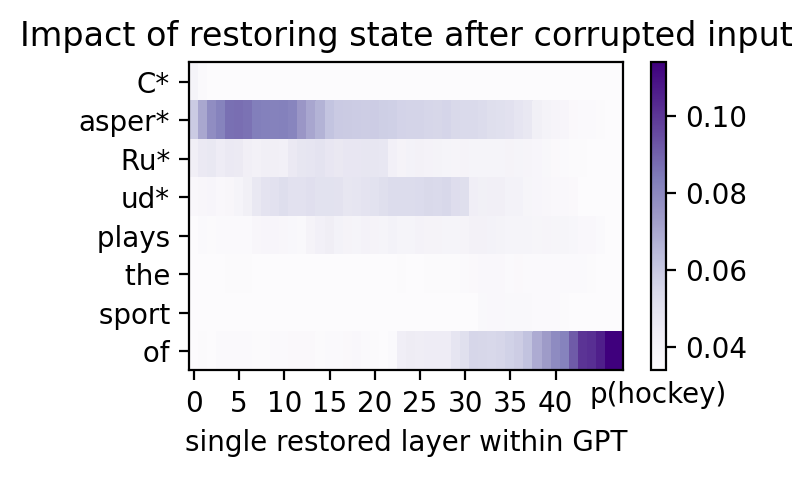

Threshold:  tensor(0.0437)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3



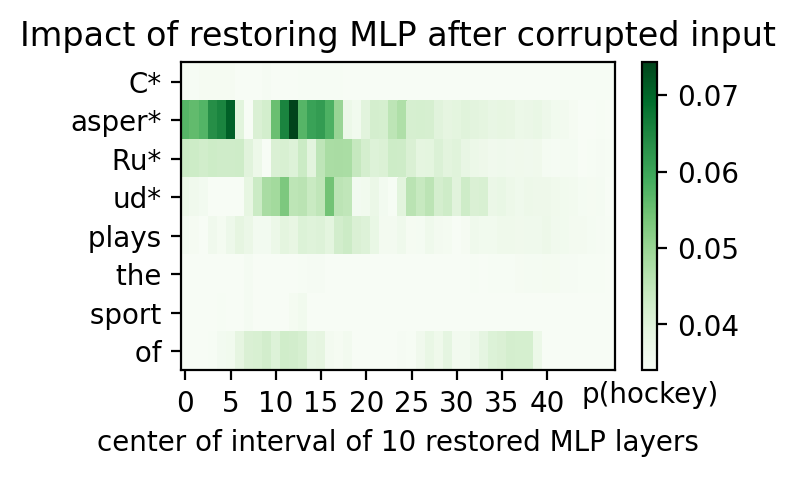

Threshold:  tensor(0.0473)

Highly Activated Neurons:
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  12  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  18  Token:  4
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



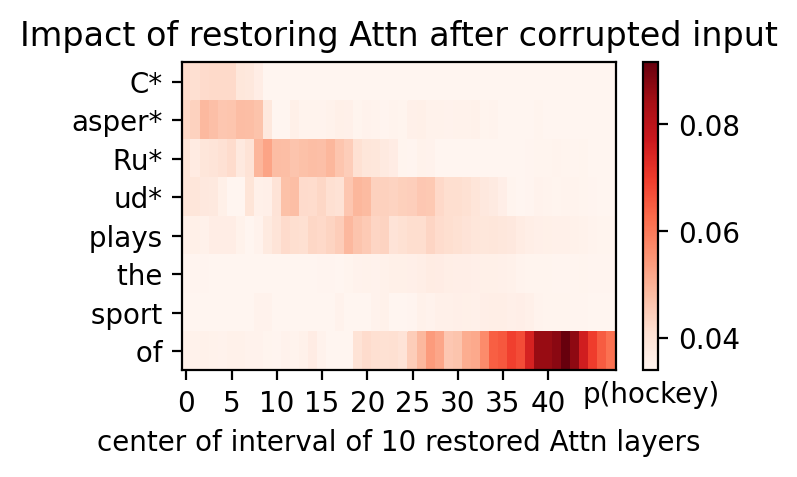

Threshold:  tensor(0.0322)

Highly Activated Neurons:
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



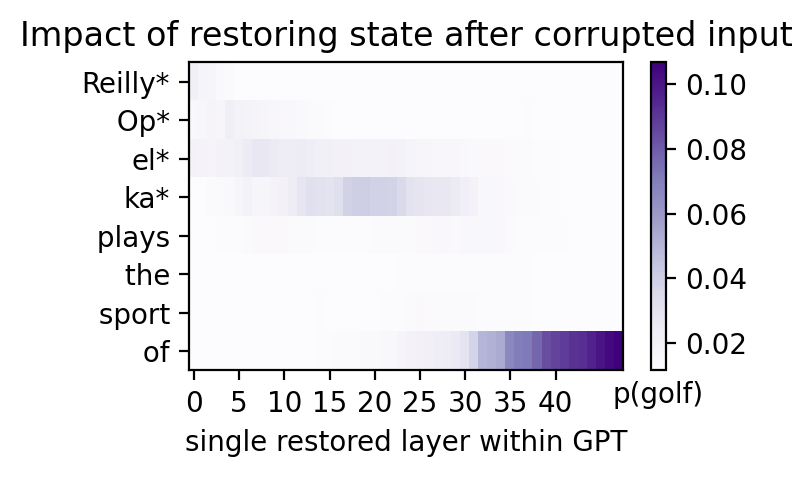

Threshold:  tensor(0.0194)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  9  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7



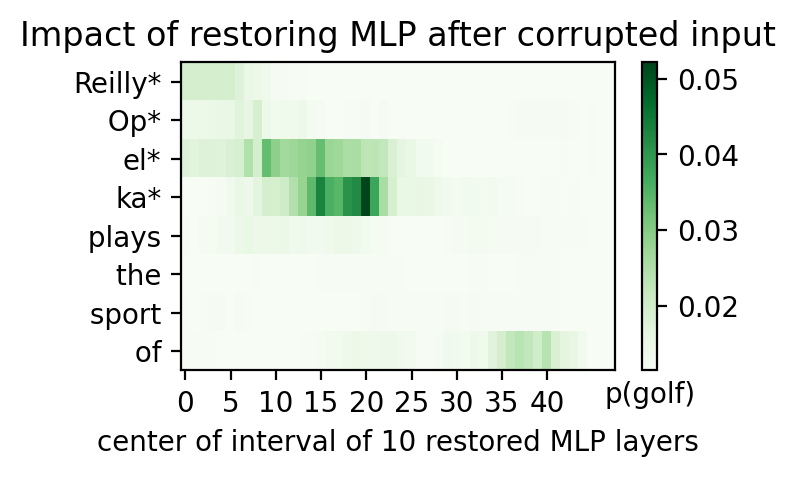

Threshold:  tensor(0.0183)

Highly Activated Neurons:
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  23  Token:  7
Layer:  24  Token:  7
Layer:  25  Token:  7
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7



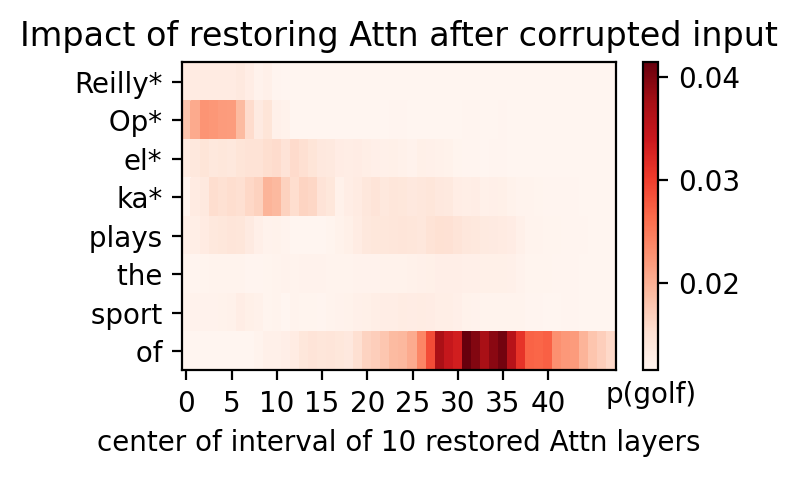

In [ ]:
prompts = [
    "Serena Williams plays the sport of",
    "Novak Djokovic plays the sport of",
    "Rafael Nadal plays the sport of",
    "Roger Federer plays the sport of",
    "Aryna Sabalenka plays the sport of",
    "Naomi Osaka plays the sport of",
    "Ons Jabeur plays the sport of",
    "Taylor Fritz plays the sport of",
    "Casper Ruud plays the sport of",
    "Reilly Opelka plays the sport of"
]

for prompt in prompts:
    plot_all_flow(mt, prompt, noise=noise_level)

Threshold:  tensor(0.2576)

Highly Activated Neurons:
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  30  Token:  3
Layer:  31  Token:  3
Layer:  32  Token:  3
Layer:  33  Token:  3
Layer:  34  Token:  3
Layer:  35  Token:  3
Layer:  36  Token:  3
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36

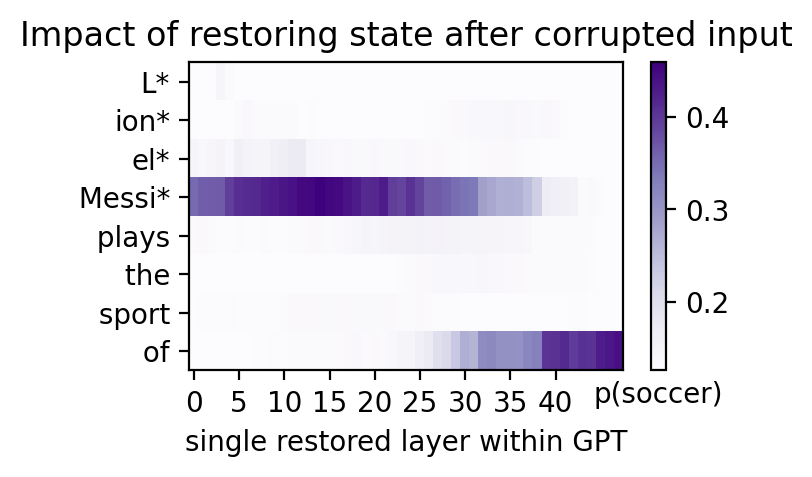

Threshold:  tensor(0.1894)

Highly Activated Neurons:
Layer:  7  Token:  2
Layer:  10  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3



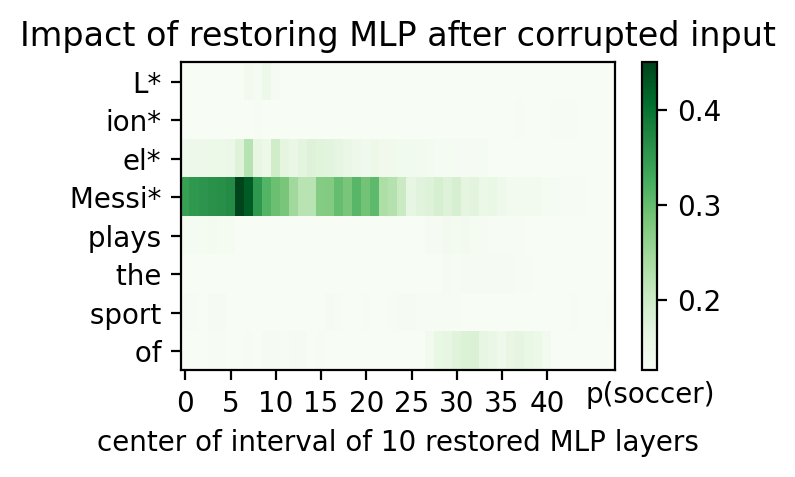

Threshold:  tensor(0.1780)

Highly Activated Neurons:
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  5  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  24  Token:  7
Layer:  25  Token:  7
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



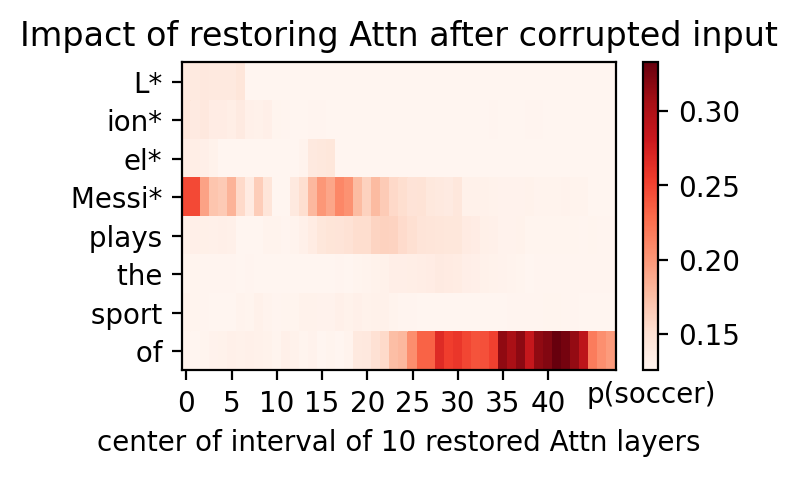

Threshold:  tensor(0.2136)

Highly Activated Neurons:
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  24  Token:  3
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45 

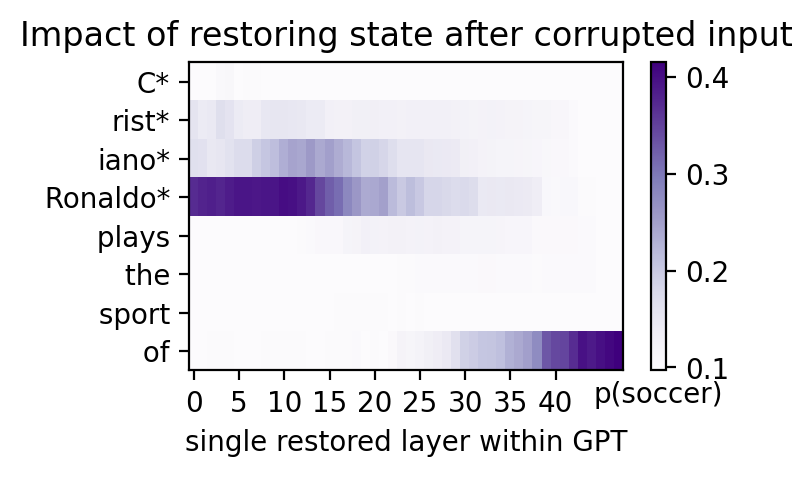

Threshold:  tensor(0.1638)

Highly Activated Neurons:
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  5  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3



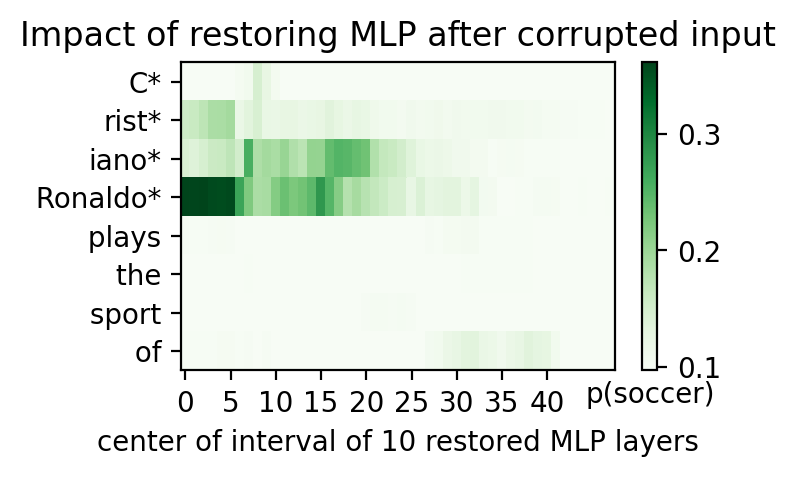

Threshold:  tensor(0.1352)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  25  Token:  7
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



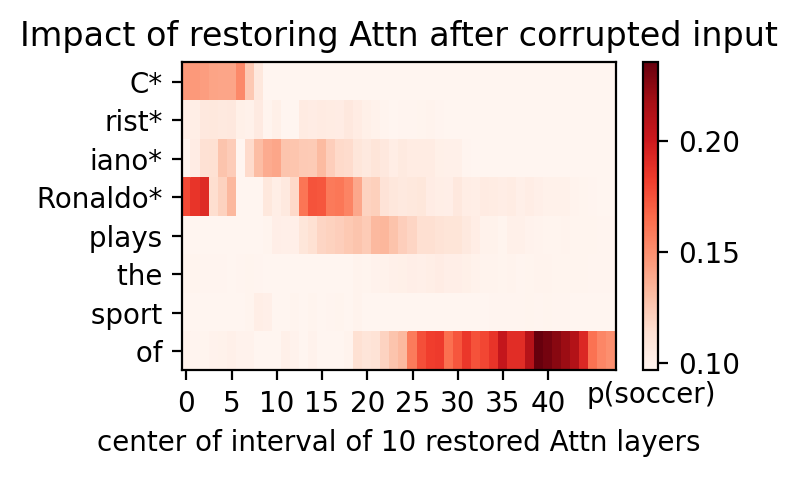

Threshold:  tensor(0.1298)

Highly Activated Neurons:
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  47  Token:  8



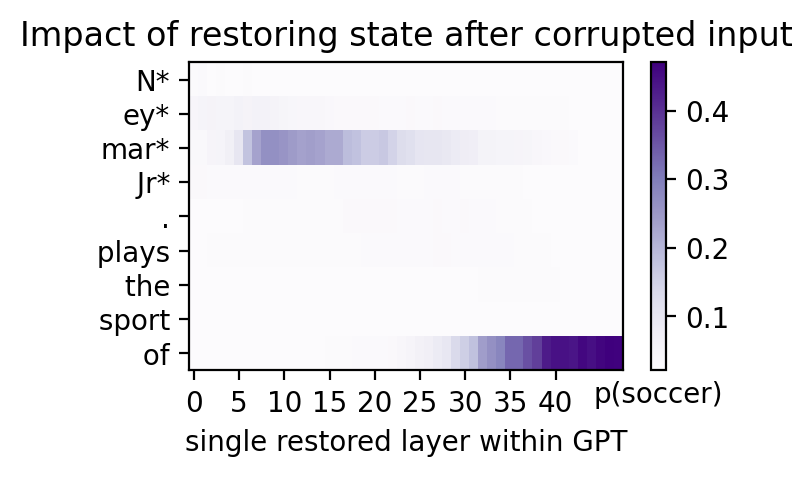

Threshold:  tensor(0.0600)

Highly Activated Neurons:
Layer:  5  Token:  1
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  32  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8



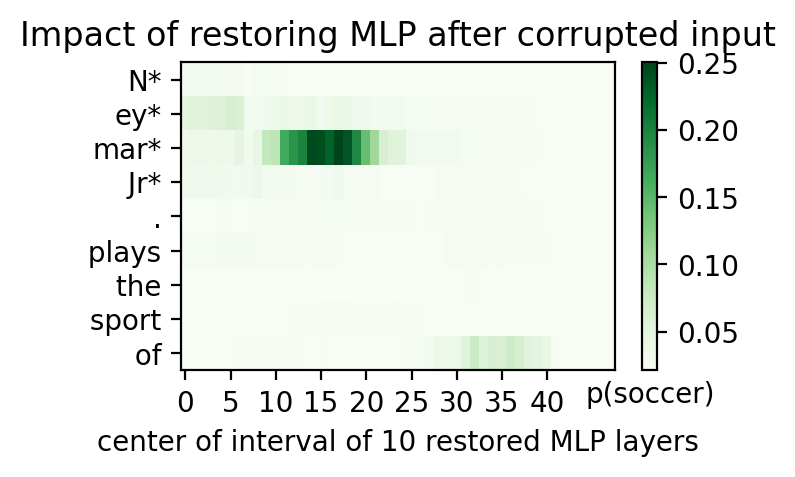

Threshold:  tensor(0.0499)

Highly Activated Neurons:
Layer:  21  Token:  8
Layer:  22  Token:  8
Layer:  23  Token:  8
Layer:  24  Token:  8
Layer:  25  Token:  8
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  47  Token:  8



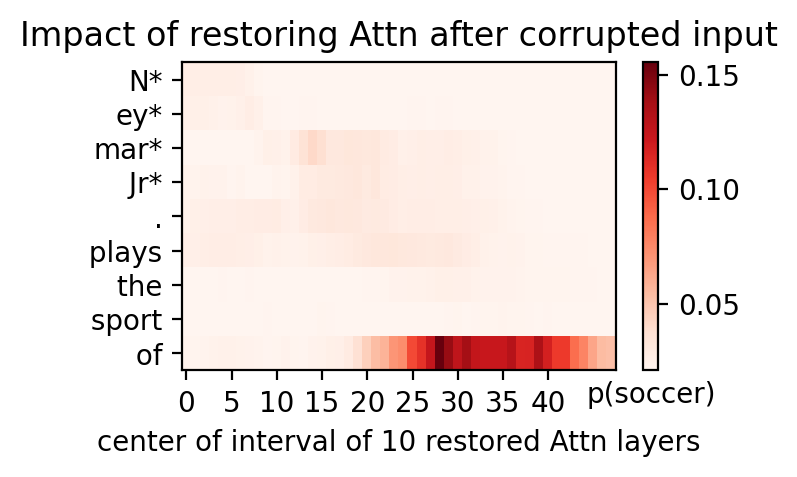

Threshold:  tensor(0.2239)

Highly Activated Neurons:
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



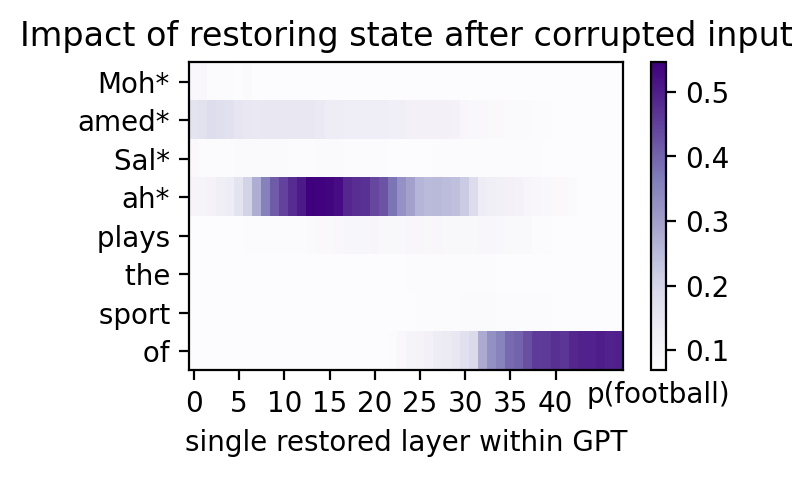

Threshold:  tensor(0.1385)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  9  Token:  1
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7



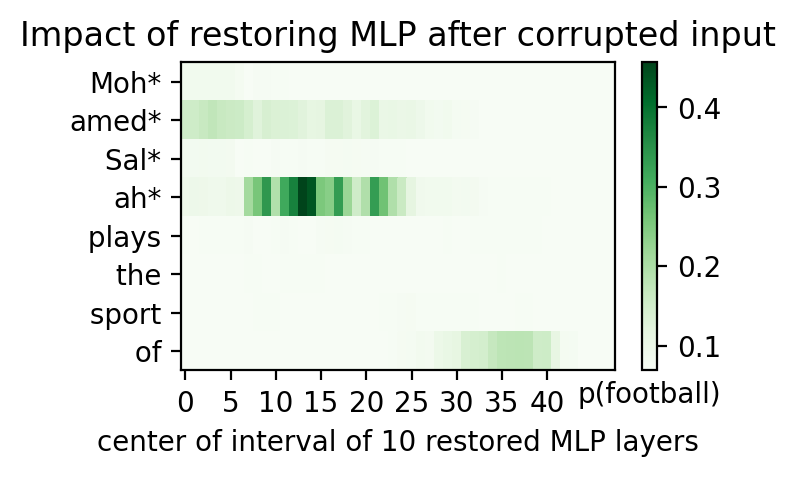

Threshold:  tensor(0.1164)

Highly Activated Neurons:
Layer:  22  Token:  7
Layer:  23  Token:  7
Layer:  24  Token:  7
Layer:  25  Token:  7
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7



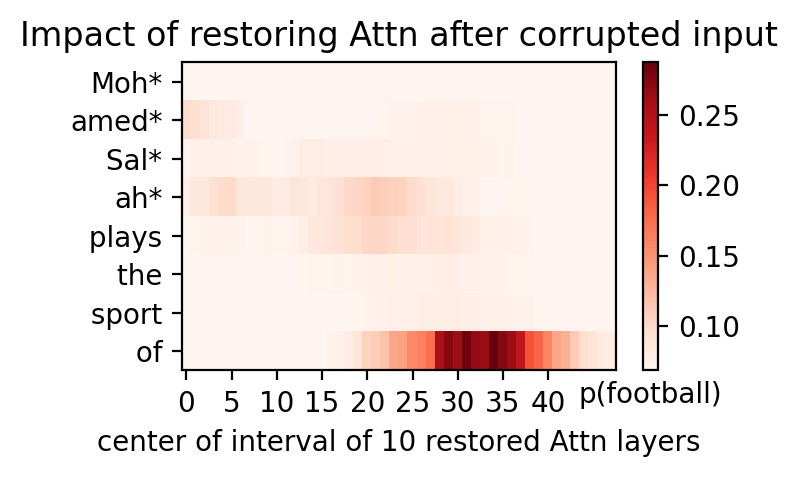

Threshold:  tensor(0.1481)

Highly Activated Neurons:
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  24  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9
Layer:  44  Token:  9
Layer:  45  Token:  9
Layer:  46  Token:  9
Layer:  47  Token:  9



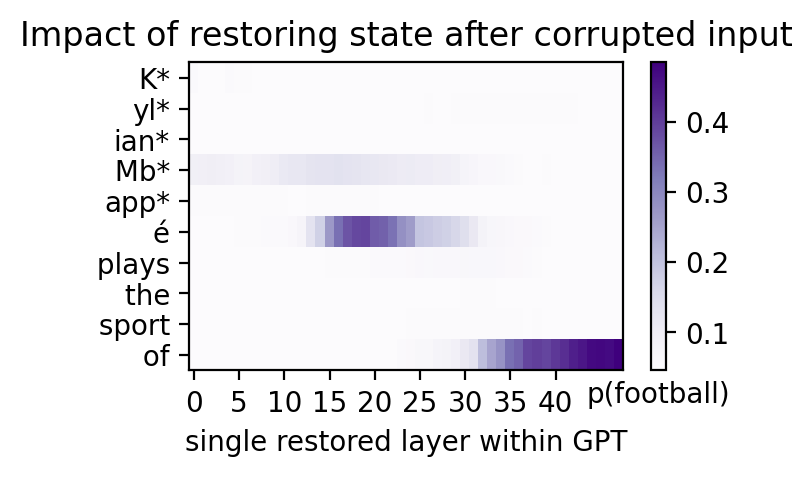

Threshold:  tensor(0.0689)

Highly Activated Neurons:
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  29  Token:  9
Layer:  30  Token:  9
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9



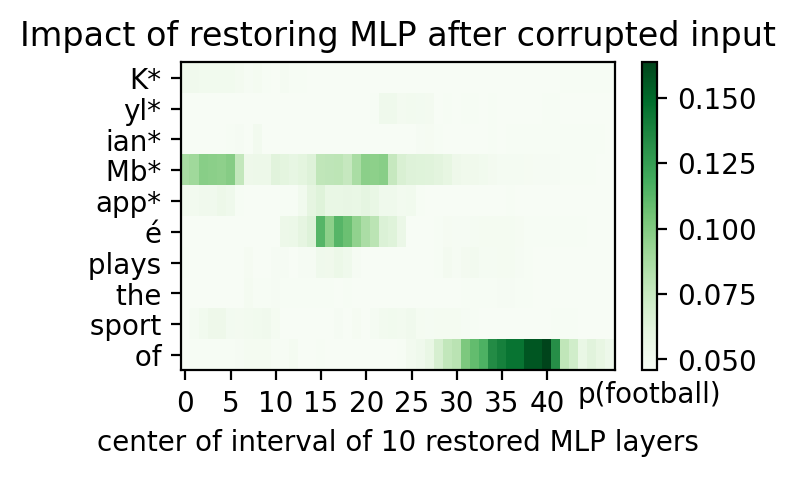

Threshold:  tensor(0.0757)

Highly Activated Neurons:
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  23  Token:  9
Layer:  24  Token:  9
Layer:  25  Token:  9
Layer:  26  Token:  9
Layer:  27  Token:  9
Layer:  28  Token:  9
Layer:  29  Token:  9
Layer:  30  Token:  9
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9



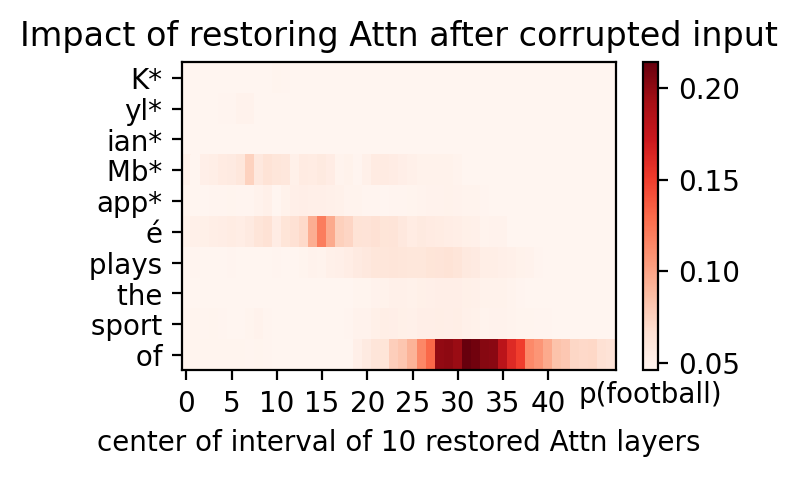

Threshold:  tensor(0.1796)

Highly Activated Neurons:
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



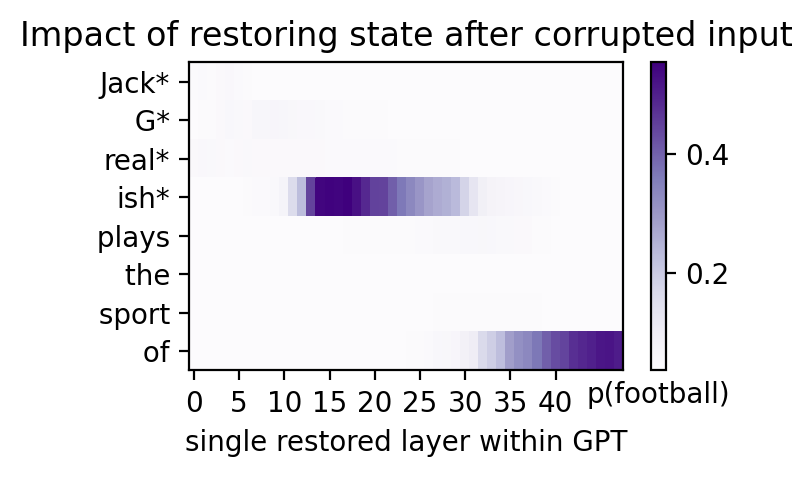

Threshold:  tensor(0.0730)

Highly Activated Neurons:
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7



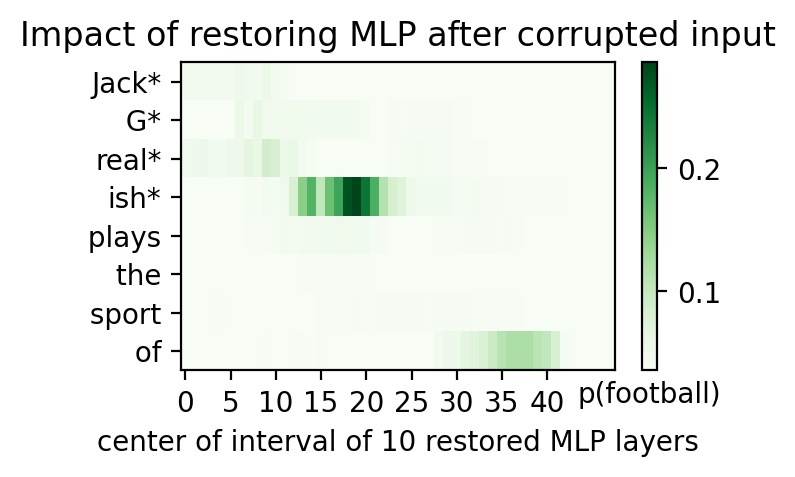

Threshold:  tensor(0.0788)

Highly Activated Neurons:
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7



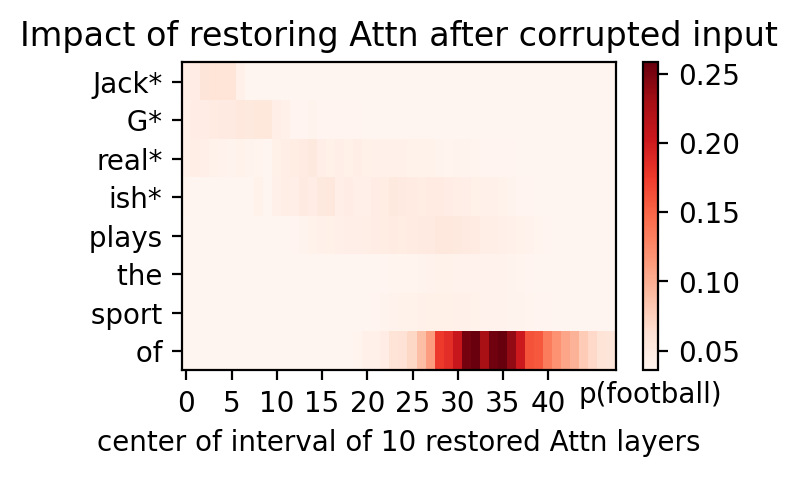

Threshold:  tensor(0.0997)

Highly Activated Neurons:
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  3  Token:  3
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9
Layer:  44  Token:  9
Layer:  45  Token:  9
Layer:  46  Token:  9
Layer:  47  Token:  9



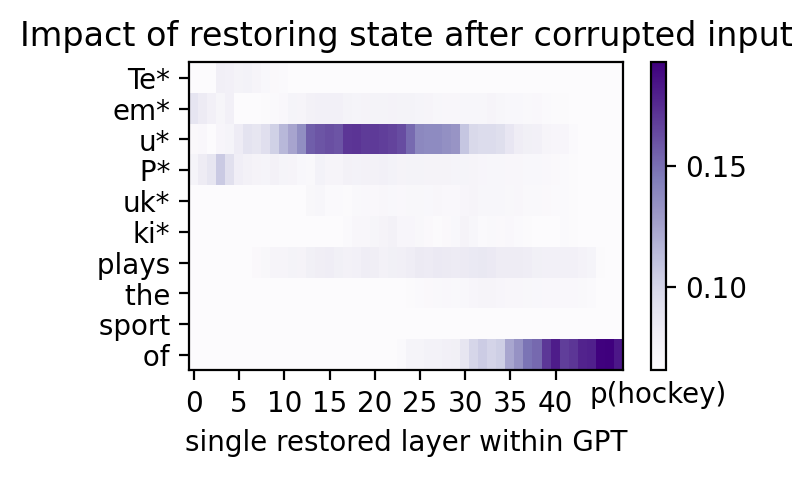

Threshold:  tensor(0.0896)

Highly Activated Neurons:
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  17  Token:  4
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  15  Token:  6
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9



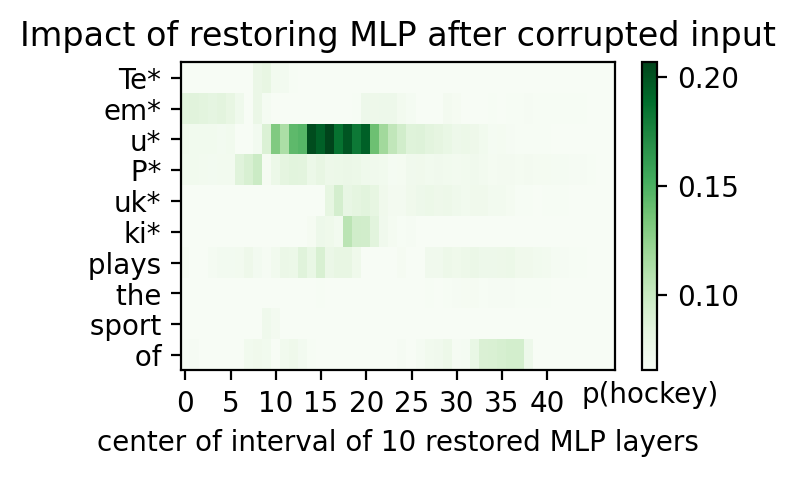

Threshold:  tensor(0.0883)

Highly Activated Neurons:
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  20  Token:  6
Layer:  21  Token:  6
Layer:  22  Token:  6
Layer:  23  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  26  Token:  9
Layer:  27  Token:  9
Layer:  28  Token:  9
Layer:  29  Token:  9
Layer:  30  Token:  9
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9
Layer:  44  Token:  9
Layer:  45  Token:  9
Layer:  46  Token:  9
Layer:  47  Token:  9



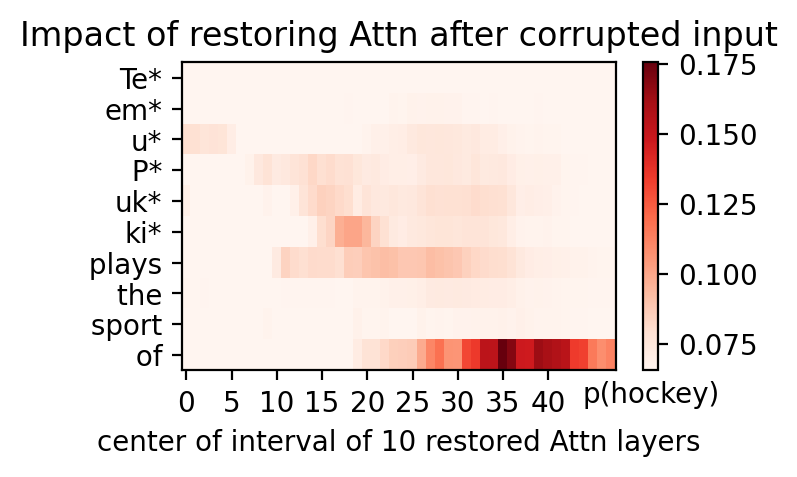

Threshold:  tensor(0.0645)

Highly Activated Neurons:
Layer:  5  Token:  1
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  2  Token:  3
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



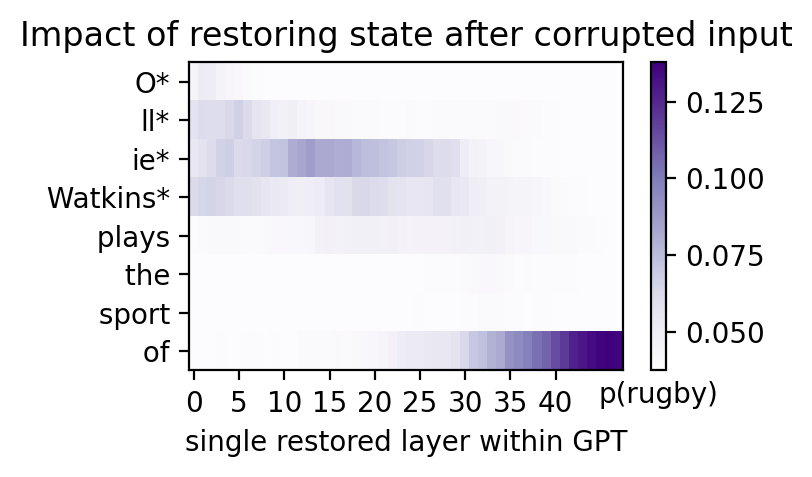

Threshold:  tensor(0.0505)

Highly Activated Neurons:
Layer:  6  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  9  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:

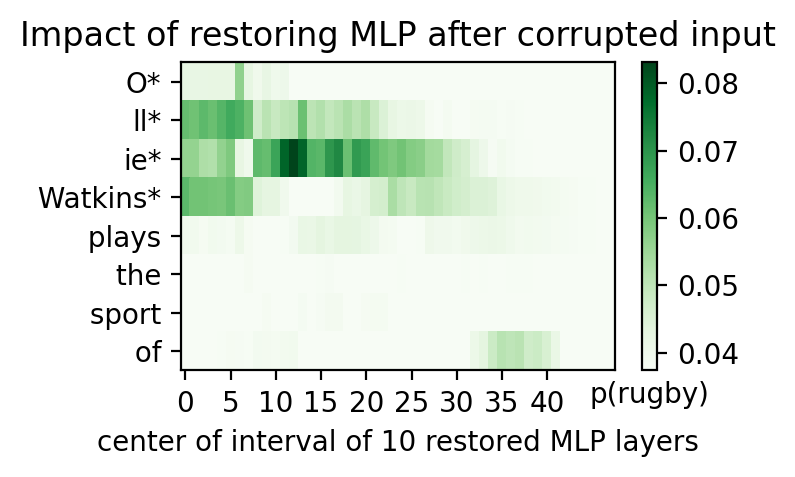

Threshold:  tensor(0.0555)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  2  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  T

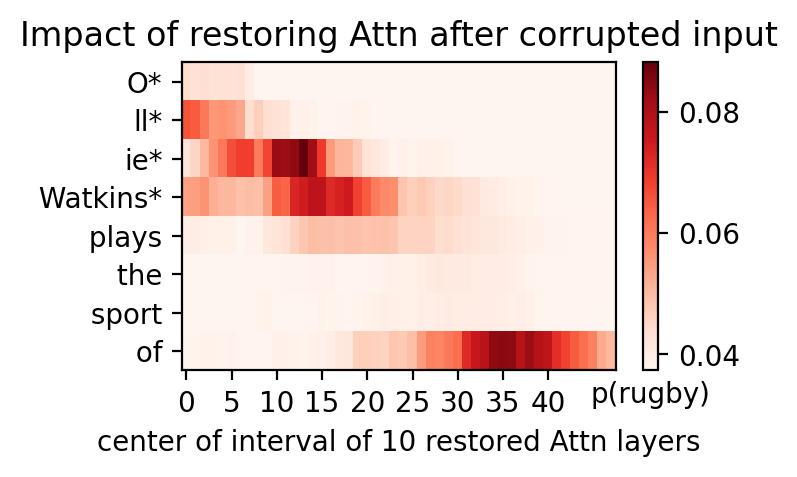

Threshold:  tensor(0.0794)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  10  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28

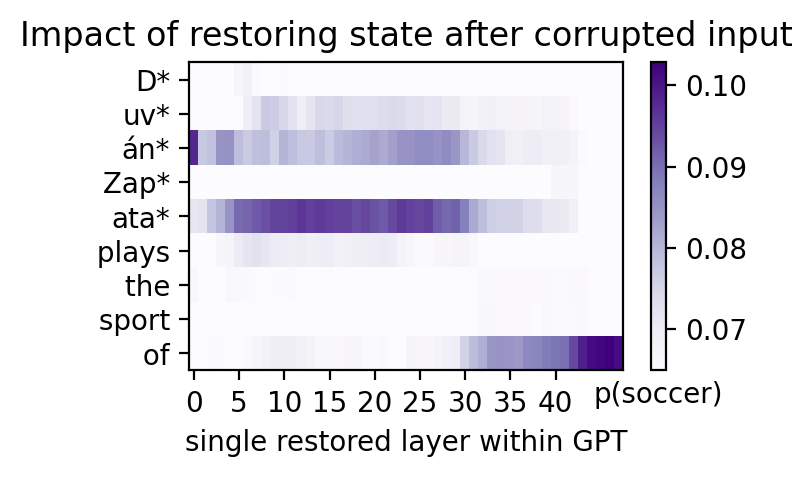

Threshold:  tensor(0.0749)

Highly Activated Neurons:
Layer:  16  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  10  Token:  2
Layer:  17  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  28  Token:  2
Layer:  0  Token:  4
Layer:  1  Token:  4
Layer:  7  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  26  Token:  4
Layer:  7  Token:  5



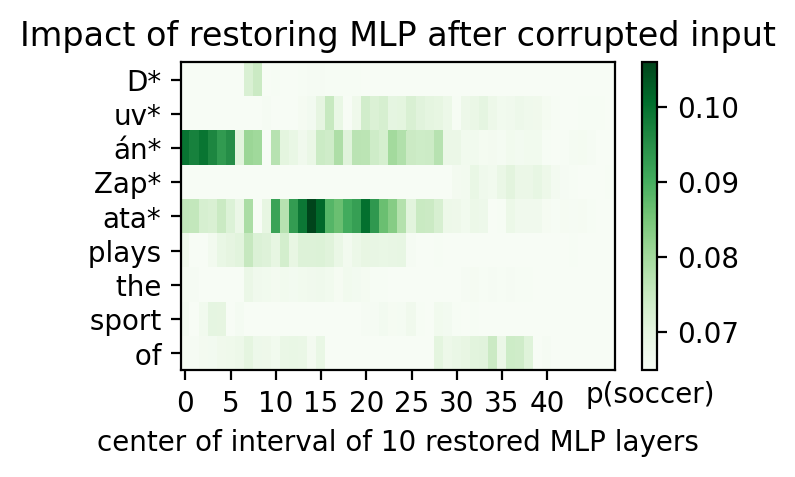

Threshold:  tensor(0.0700)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  31  Token:  2
Layer:  32  Token:  2
Layer:  0  Token:  4
Layer:  1  Token:  4
Layer:  2  Token:  4
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  3  Token:  5
Layer:  4  Token:  5
Layer:  5  Token:  5
Layer:  6  Token:  5
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Tok

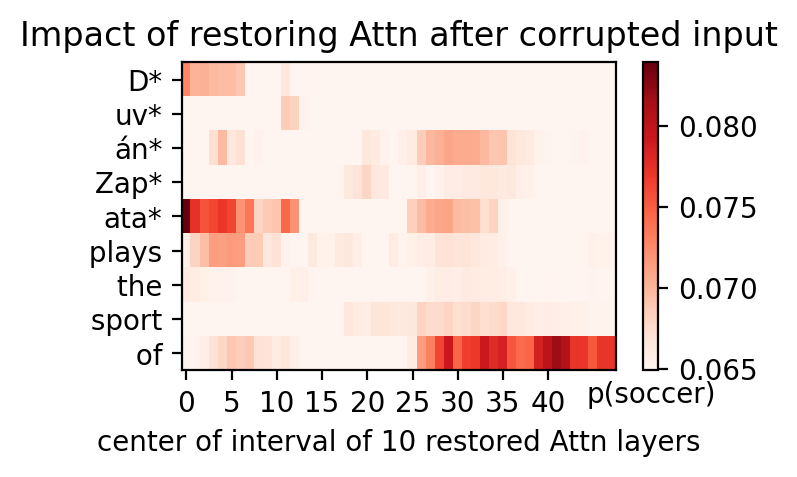

Threshold:  tensor(0.0674)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  24  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  23  Token:  8
Layer:  24  Token:  8
Layer:  25  Token:  8
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  

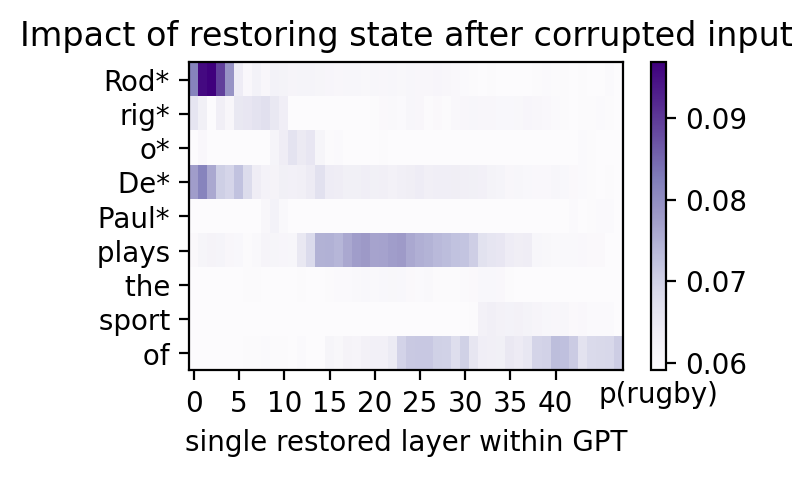

Threshold:  tensor(0.0705)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  6  Token:  5
Layer:  7  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5

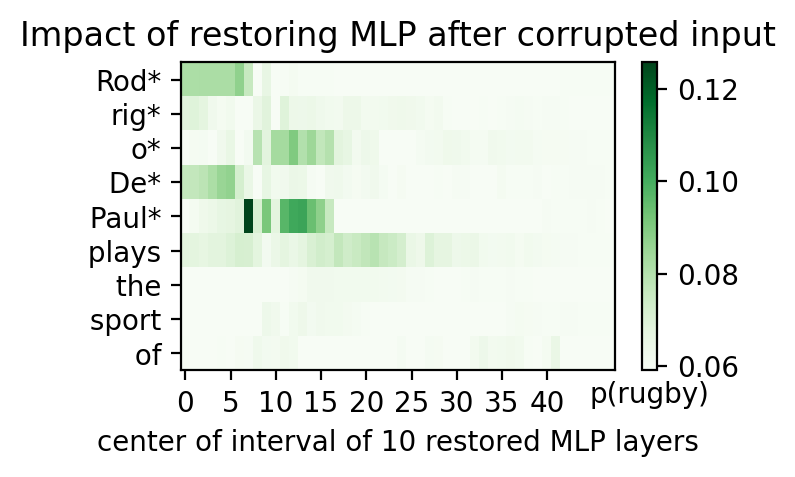

Threshold:  tensor(0.0658)

Highly Activated Neurons:
Layer:  7  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  

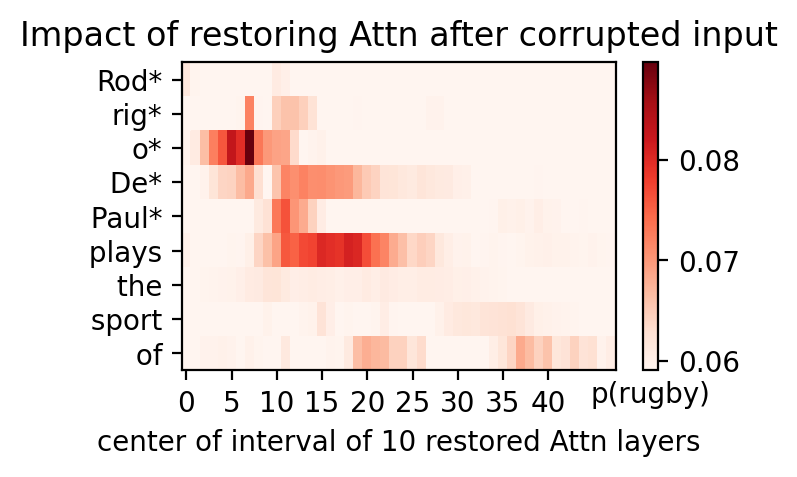

In [ ]:
prompts = [
    "Lionel Messi plays the sport of",
    "Cristiano Ronaldo plays the sport of",
    "Neymar Jr. plays the sport of",
    "Mohamed Salah plays the sport of",
    "Kylian Mbappé plays the sport of",
    "Jack Grealish plays the sport of",
    "Teemu Pukki plays the sport of",
    "Ollie Watkins plays the sport of",
    "Duván Zapata plays the sport of",
    "Rodrigo De Paul plays the sport of"
]
for prompt in prompts:
    plot_all_flow(mt, prompt, noise=noise_level)

Threshold:  tensor(0.5151)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  31  Token:  2
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41

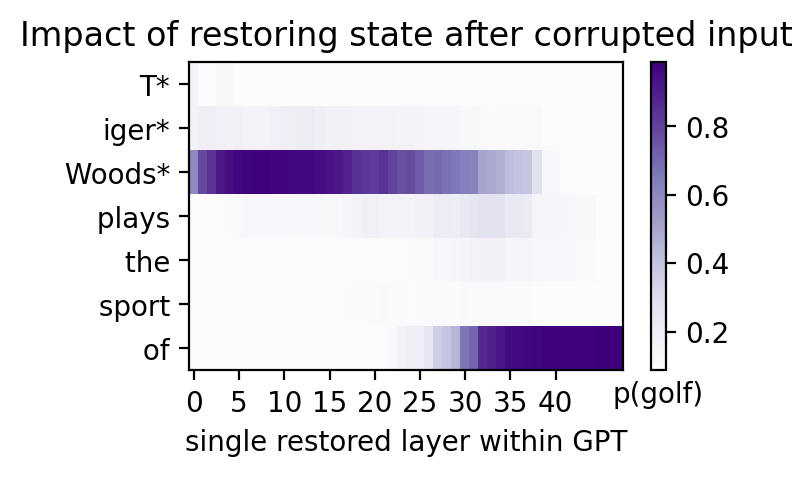

Threshold:  tensor(0.3191)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2



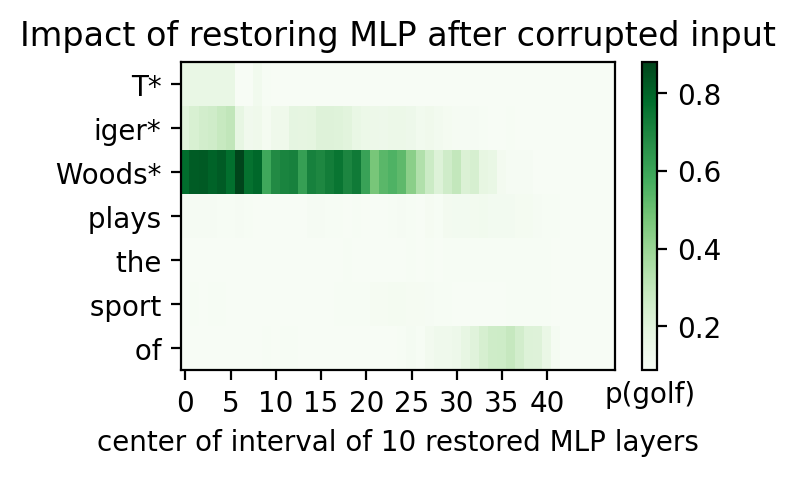

Threshold:  tensor(0.2938)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  23  Token:  6
Layer:  24  Token:  6
Layer:  25  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6



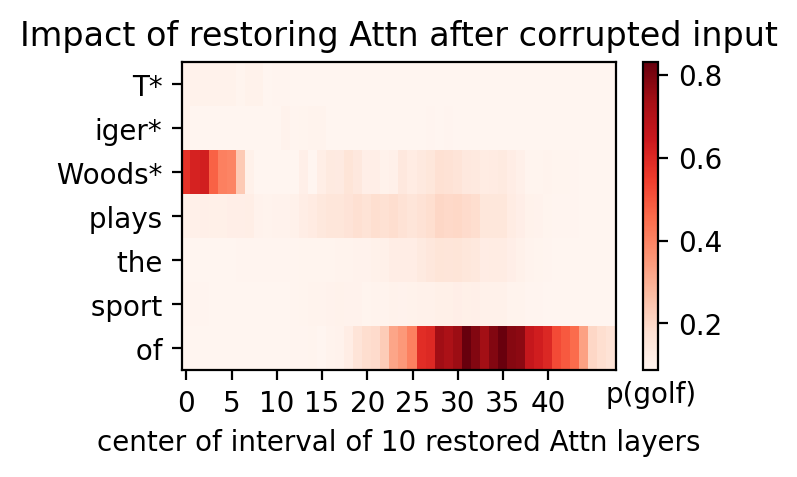

Threshold:  tensor(0.7129)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  30  Token: 

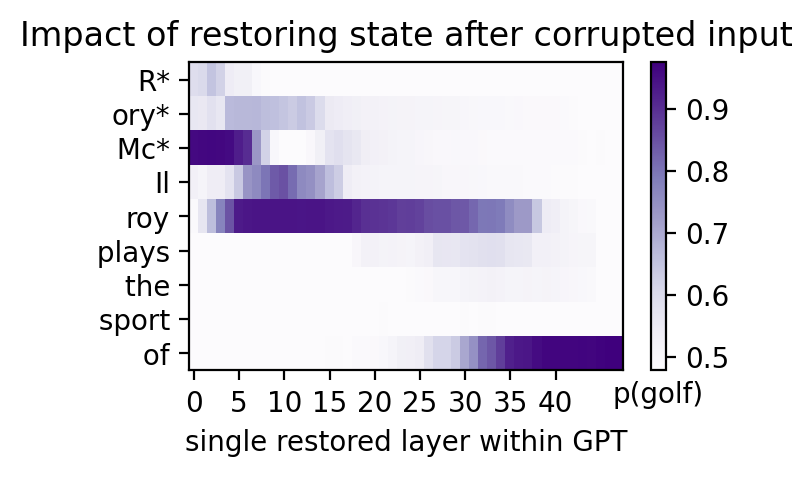

Threshold:  tensor(0.6445)

Highly Activated Neurons:
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  6  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4

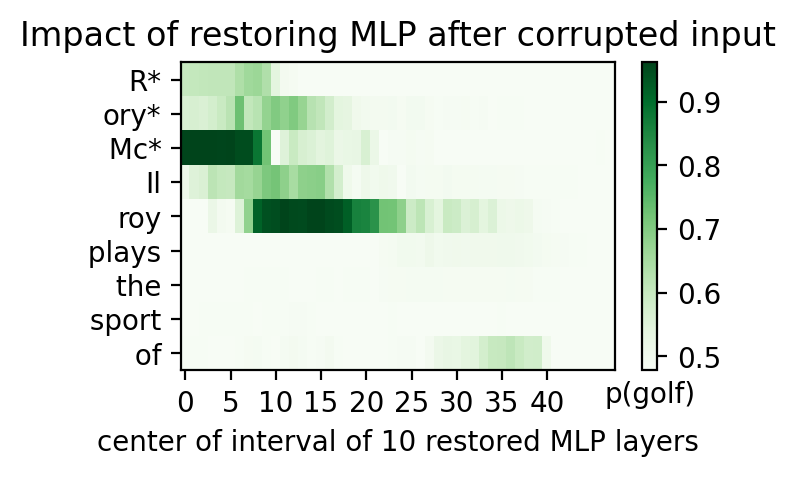

Threshold:  tensor(0.6638)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  0  Token:  2
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  0  Token:  4
Layer:  1  Token:  4
Layer:  2  Token:  4
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:

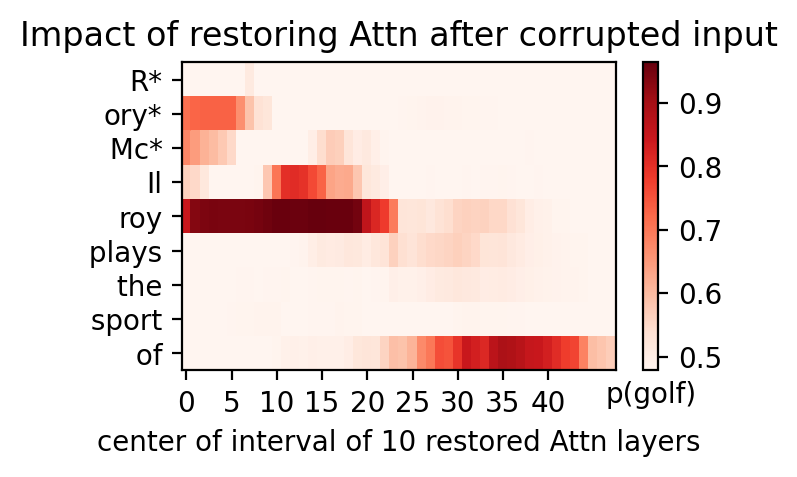

Threshold:  tensor(0.4539)

Highly Activated Neurons:
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  31  Token:  2
Layer:  32  Token:  2
Layer:  33  Token:  2
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  

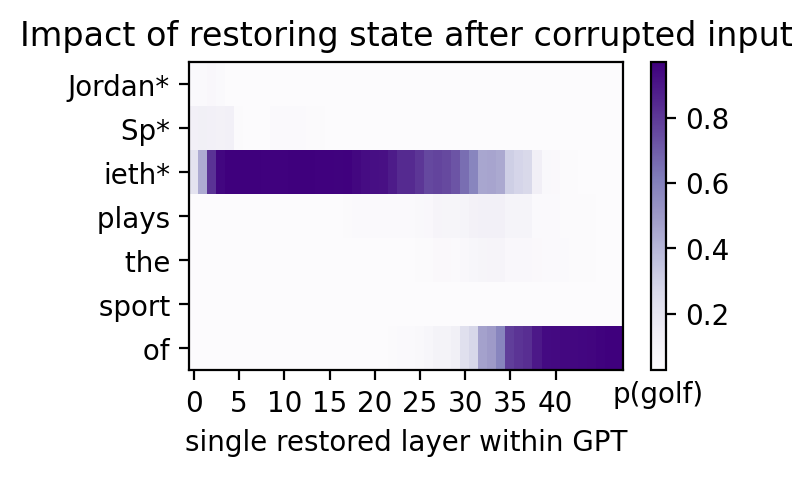

Threshold:  tensor(0.2567)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2



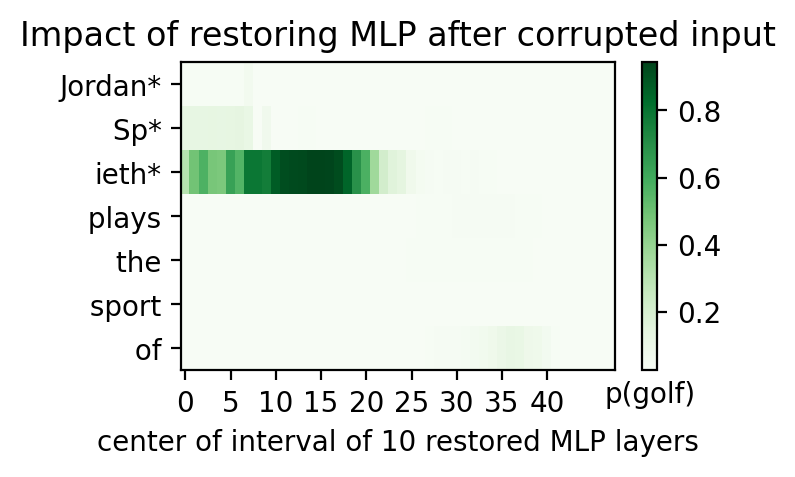

Threshold:  tensor(0.1631)

Highly Activated Neurons:
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6



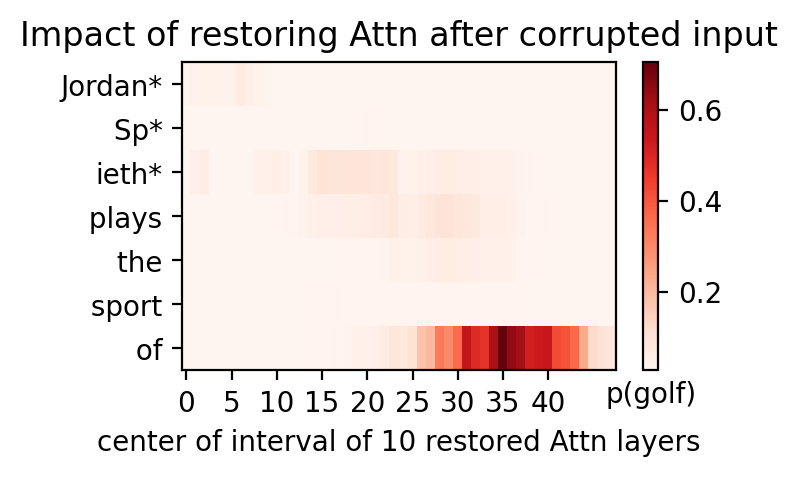

Threshold:  tensor(0.1421)

Highly Activated Neurons:
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



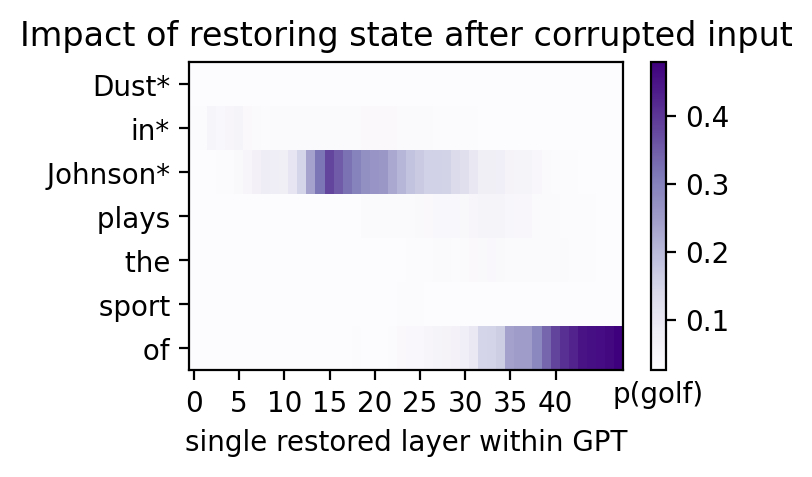

Threshold:  tensor(0.0777)

Highly Activated Neurons:
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2



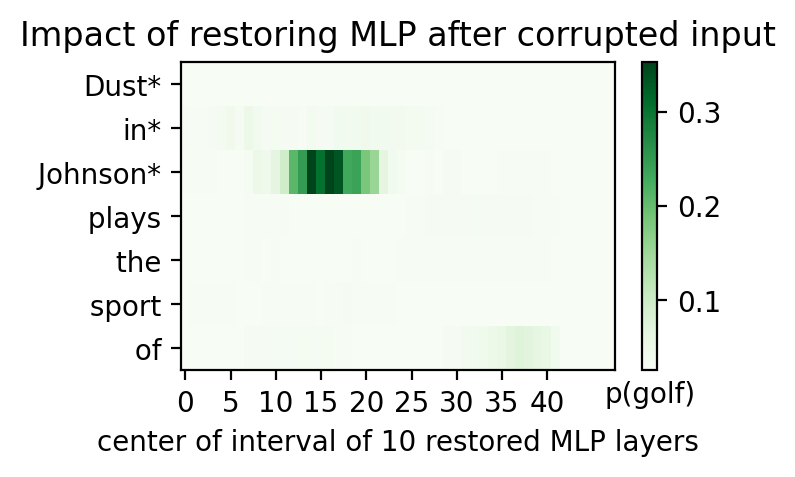

Threshold:  tensor(0.0673)

Highly Activated Neurons:
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6



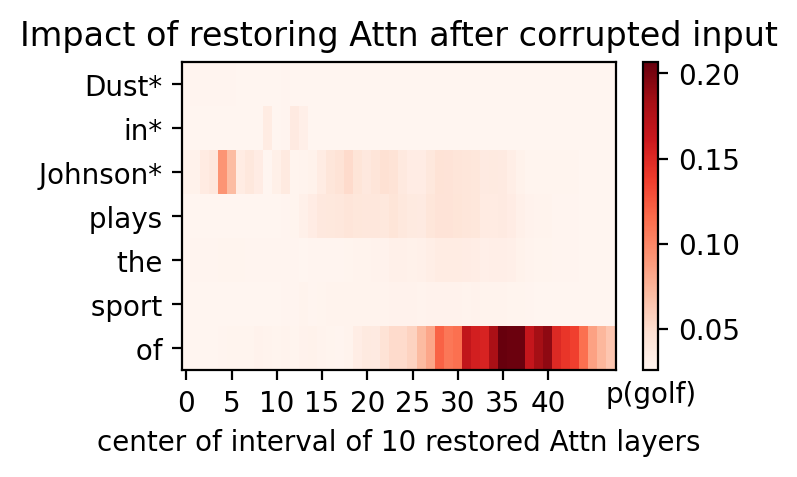

Threshold:  tensor(0.0636)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer

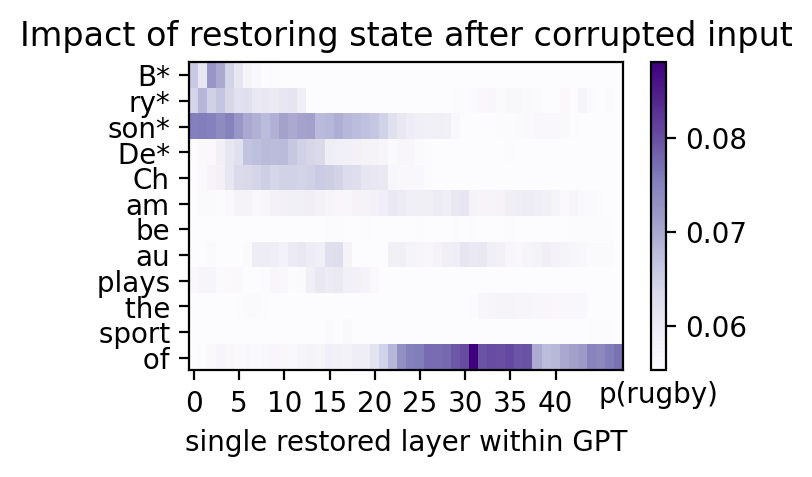

Threshold:  tensor(0.0611)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  9  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4


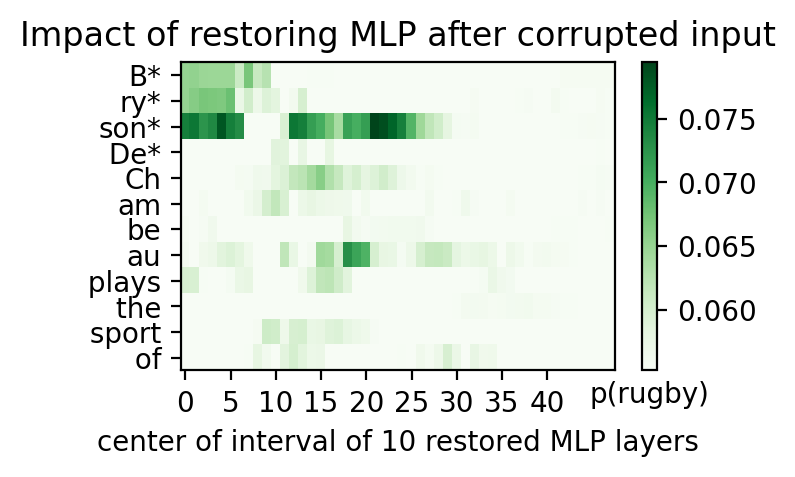

Threshold:  tensor(0.0623)

Highly Activated Neurons:
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  5  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  1  Token:  4
Layer:  2  Token:  4
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  12  Toke

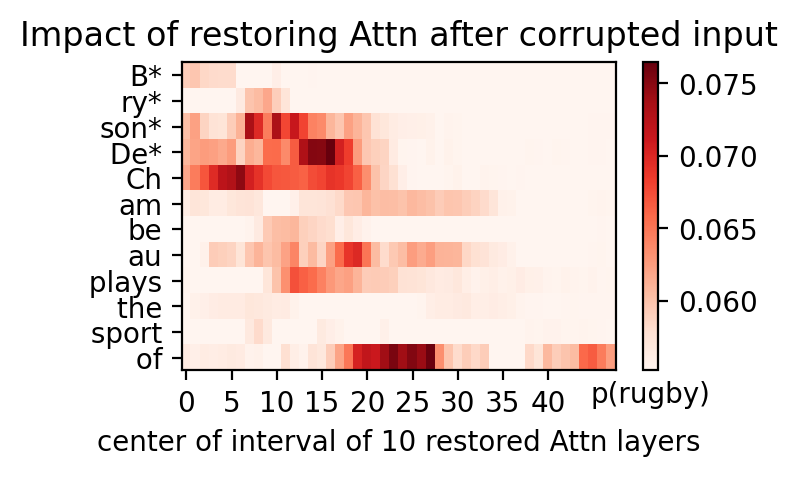

Threshold:  tensor(0.0103)

Highly Activated Neurons:
Layer:  4  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  47  Token:  8



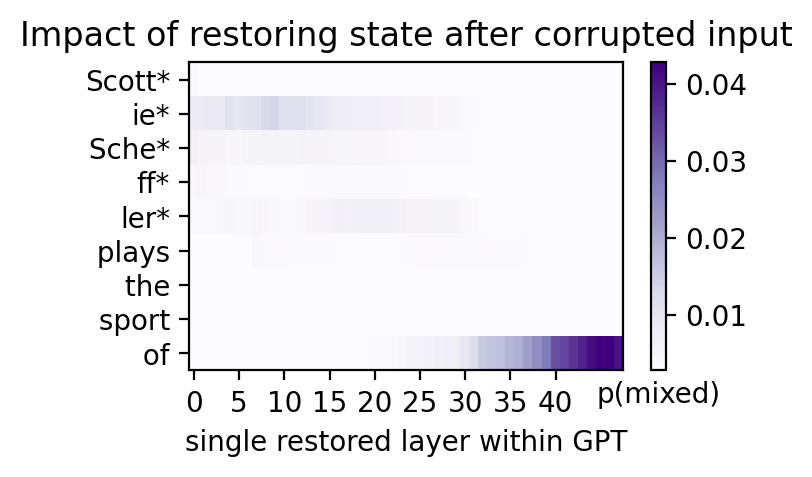

Threshold:  tensor(0.0062)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  5  Token:  2
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  47  Token:  8



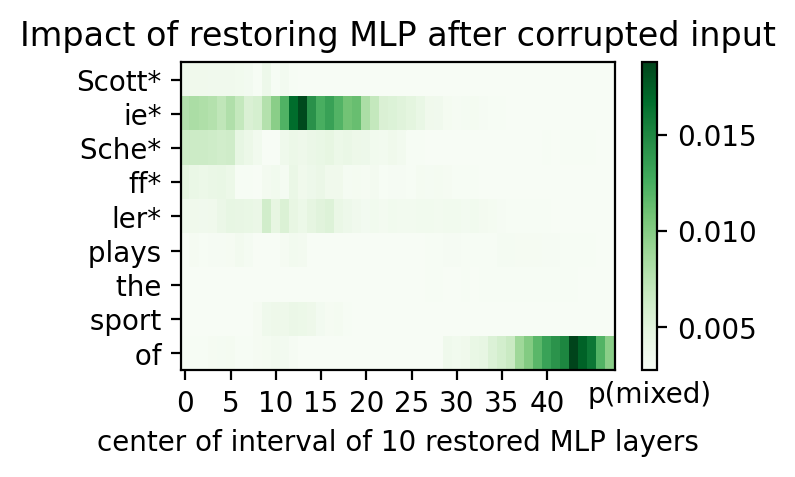

Threshold:  tensor(0.0053)

Highly Activated Neurons:
Layer:  22  Token:  8
Layer:  23  Token:  8
Layer:  24  Token:  8
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8



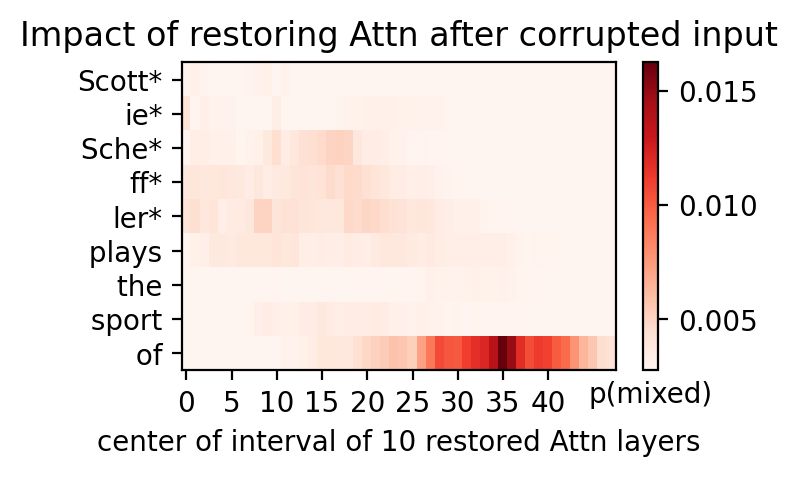

Threshold:  tensor(0.0368)

Highly Activated Neurons:
Layer:  6  Token:  5
Layer:  7  Token:  5
Layer:  8  Token:  5
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  24  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  47  Token:  8



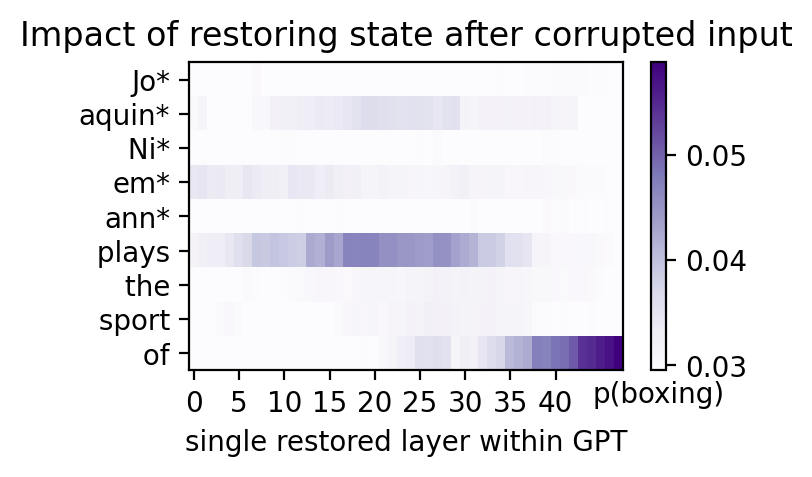

Threshold:  tensor(0.0341)

Highly Activated Neurons:
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  1
Layer:  33  Token:  1
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  9  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  7  Token:  5
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer

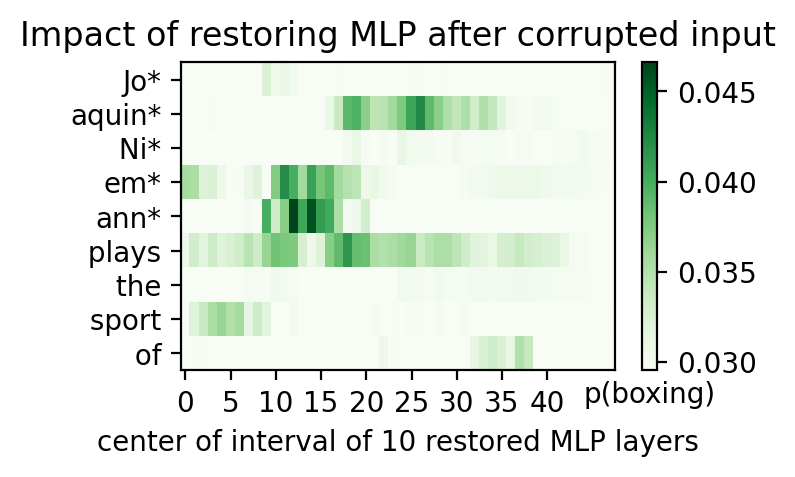

Threshold:  tensor(0.0353)

Highly Activated Neurons:
Layer:  0  Token:  5
Layer:  1  Token:  5
Layer:  2  Token:  5
Layer:  3  Token:  5
Layer:  4  Token:  5
Layer:  5  Token:  5
Layer:  6  Token:  5
Layer:  7  Token:  5
Layer:  8  Token:  5
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  21  Token:  8
Layer:  22  Token:  8
Layer:  23  Token:  8
Layer:  24  Token:  8
Layer:  28  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  47

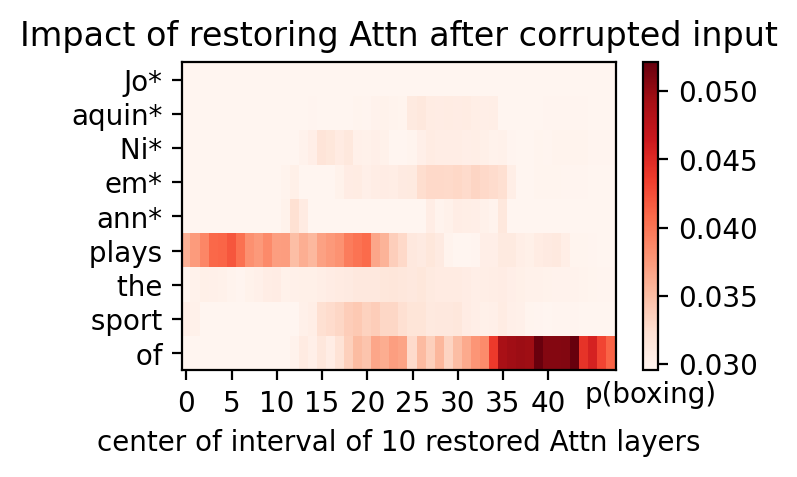

Threshold:  tensor(0.0755)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  19  Token:  0
Layer:  20  Token:  0
Layer:  21  Token:  0
Layer:  22  Token:  0
Layer:  23  Token:  0
Layer:  24  Token:  0
Layer:  25  Token:  0
Layer:  26  Token:  0
Layer:  27  Token:  0
Layer:  28  Token:  0
Layer:  29  Token:  0
Layer:  30  Token:  0
Layer:  4  Token:  1
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  14  Token:  6



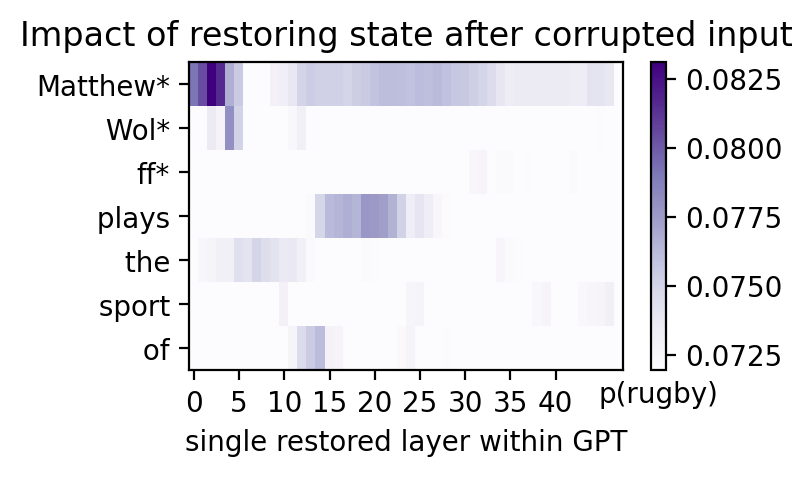

Threshold:  tensor(0.0767)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  9  Token:  0
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  11  Token:  2
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  12  Token:  6
Layer:  14  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6



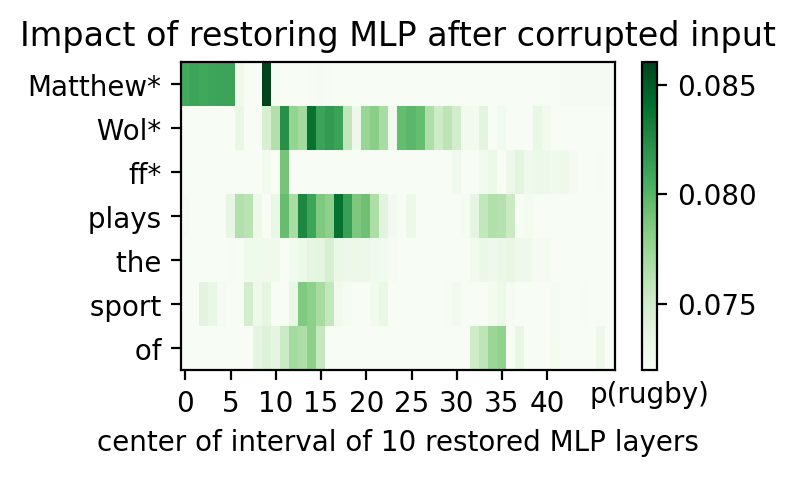

Threshold:  tensor(0.0759)

Highly Activated Neurons:
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  5  Token:  4



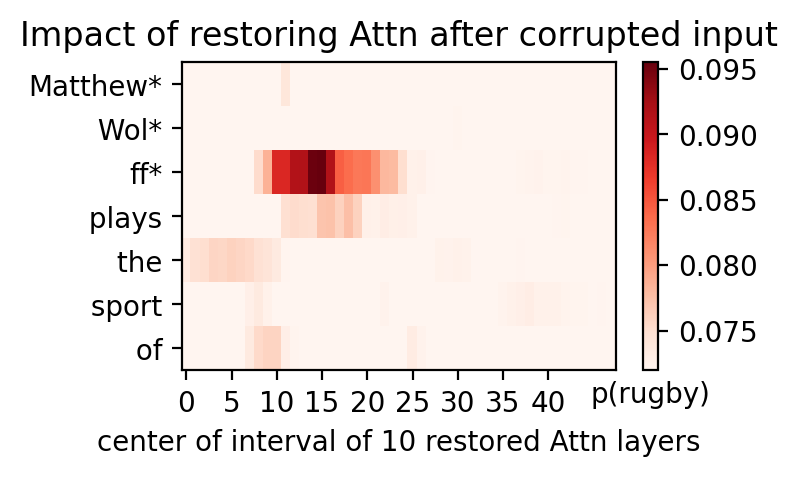

Threshold:  tensor(0.1434)

Highly Activated Neurons:
Layer:  3  Token:  2
Layer:  8  Token:  5
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  24  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5



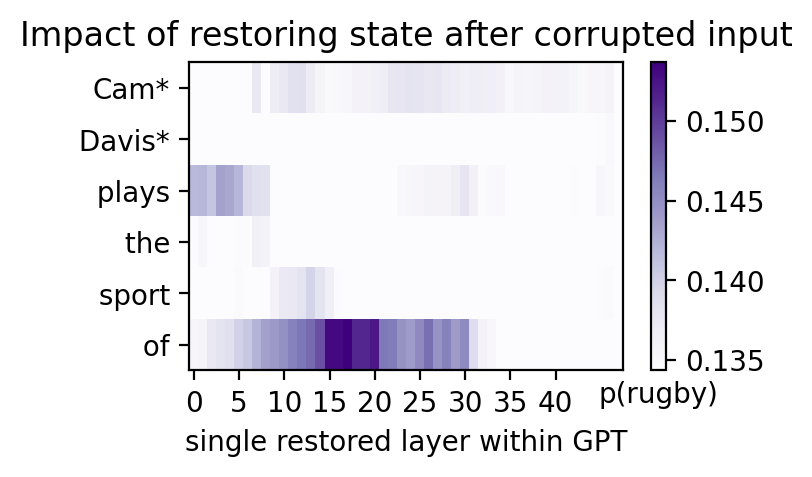

Threshold:  tensor(0.1445)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  39  Token:  5



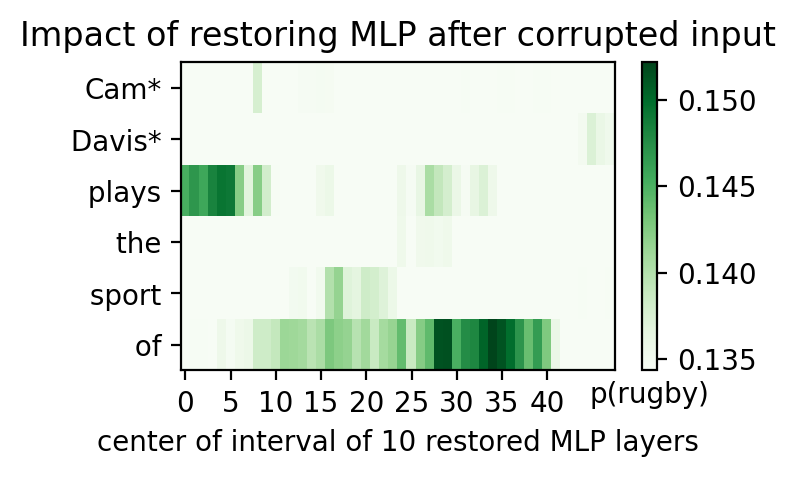

Threshold:  tensor(0.1408)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  3  Token:  5
Layer:  4  Token:  5
Layer:  5  Token:  5
Layer:  6  Token:  5
Layer:  7  Token:  5
Layer:  8  Token:  5
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5



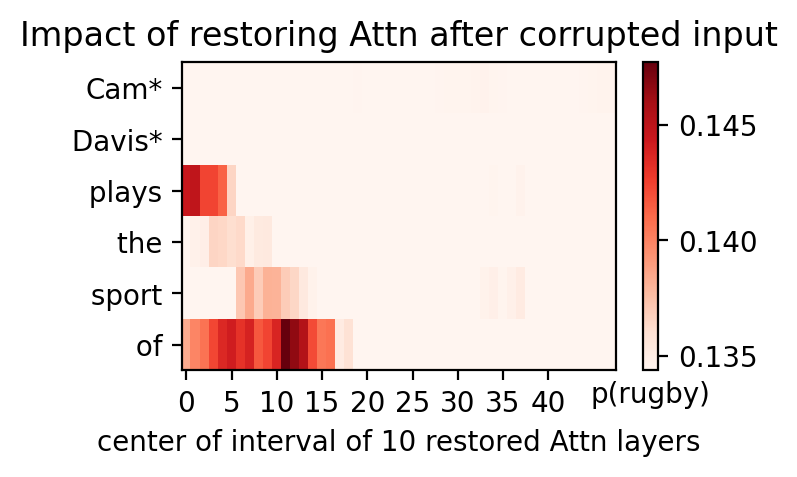

In [ ]:
prompts = [
    "Tiger Woods plays the sport of",
    "Rory McIlroy plays the sport of",
    "Jordan Spieth plays the sport of",
    "Dustin Johnson plays the sport of",
    "Bryson DeChambeau plays the sport of",
    "Scottie Scheffler plays the sport of",
    "Joaquin Niemann plays the sport of",
    "Matthew Wolff plays the sport of",
    "Cam Davis plays the sport of"
]
for prompt in prompts:
    plot_all_flow(mt, prompt, noise=noise_level)

Threshold:  tensor(0.2845)

Highly Activated Neurons:
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  30  Token:  4
Layer:  31  Token:  4
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer: 

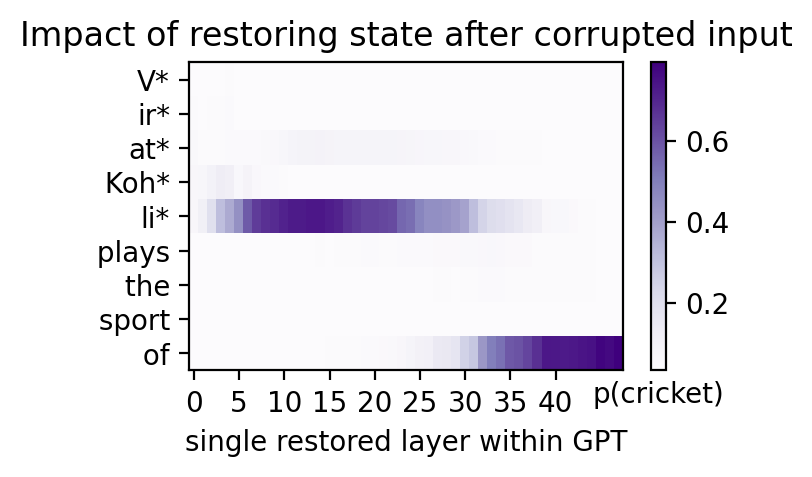

Threshold:  tensor(0.1330)

Highly Activated Neurons:
Layer:  19  Token:  2
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8



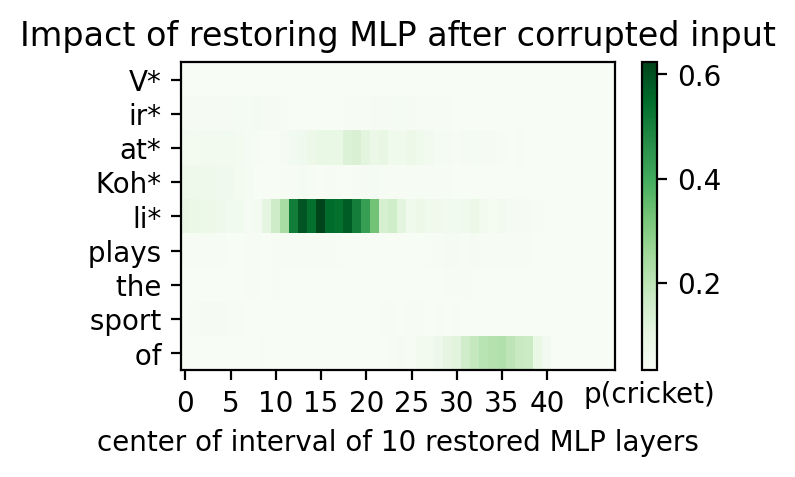

Threshold:  tensor(0.1044)

Highly Activated Neurons:
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  23  Token:  8
Layer:  24  Token:  8
Layer:  25  Token:  8
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8



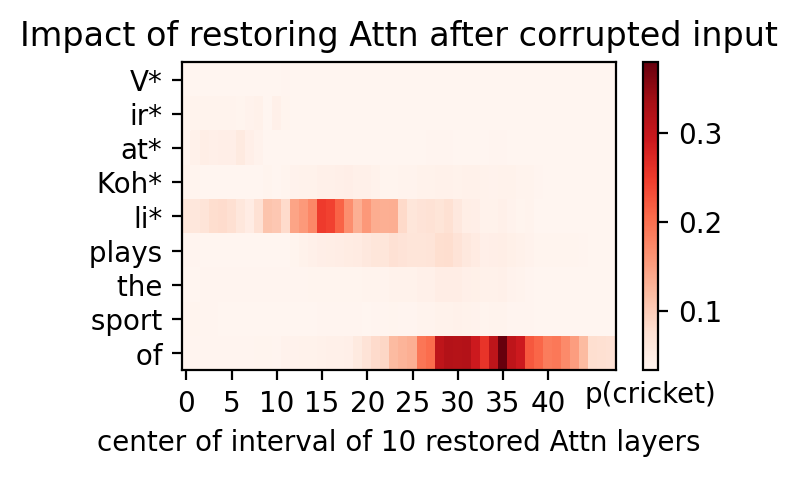

Threshold:  tensor(0.4408)

Highly Activated Neurons:
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  

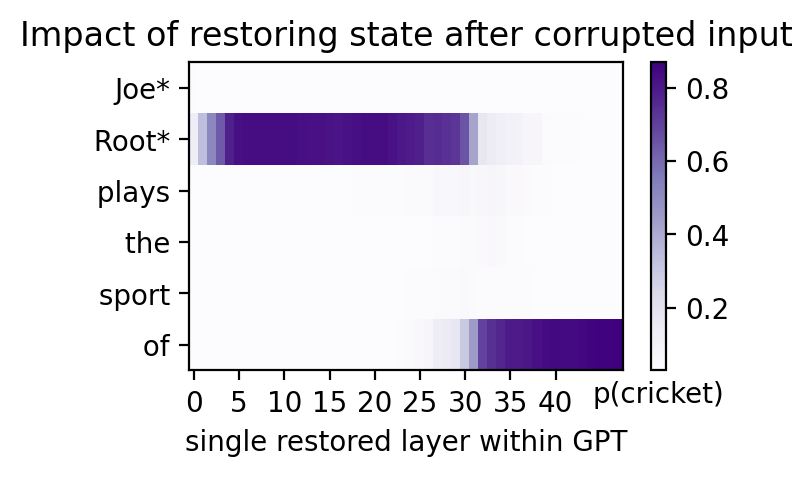

Threshold:  tensor(0.2170)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5



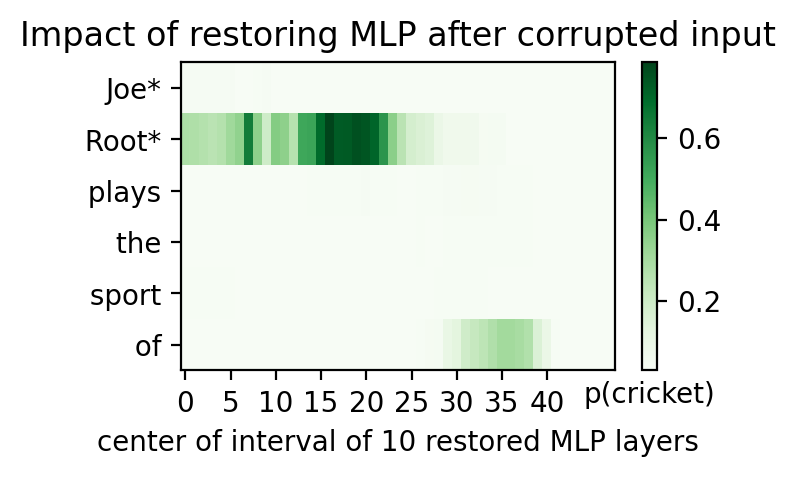

Threshold:  tensor(0.1764)

Highly Activated Neurons:
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5



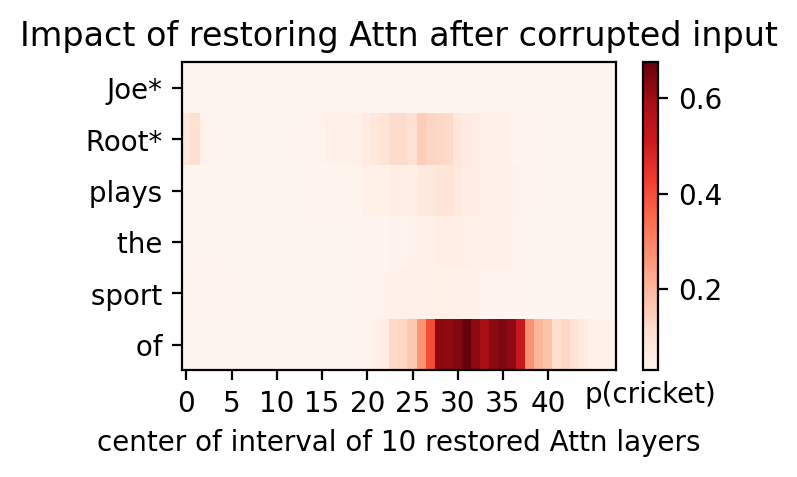

Threshold:  tensor(0.1155)

Highly Activated Neurons:
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  30  Token:  4
Layer:  31  Token:  4
Layer

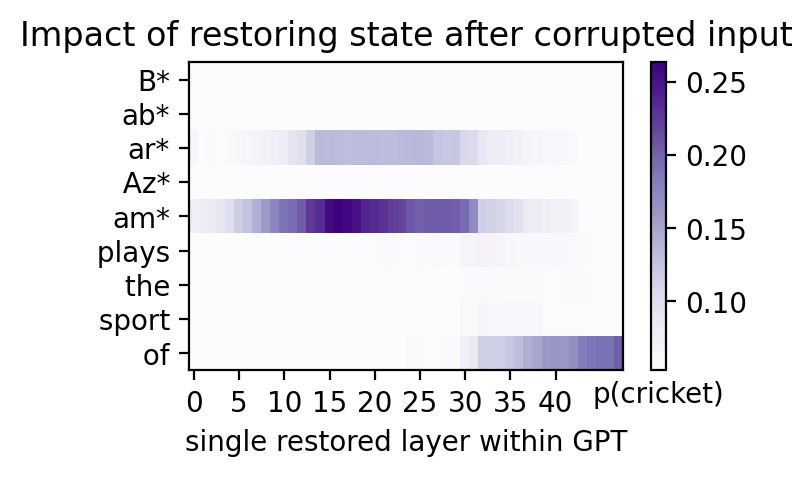

Threshold:  tensor(0.0811)

Highly Activated Neurons:
Layer:  12  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  30  Token:  4
Layer:  31  Token:  4
Layer:  32  Token:  4



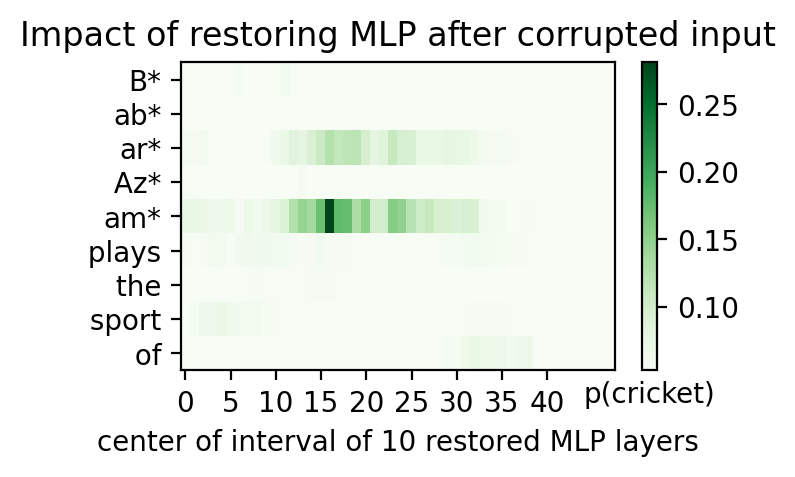

Threshold:  tensor(0.0754)

Highly Activated Neurons:
Layer:  3  Token:  1
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  47  Token:  8



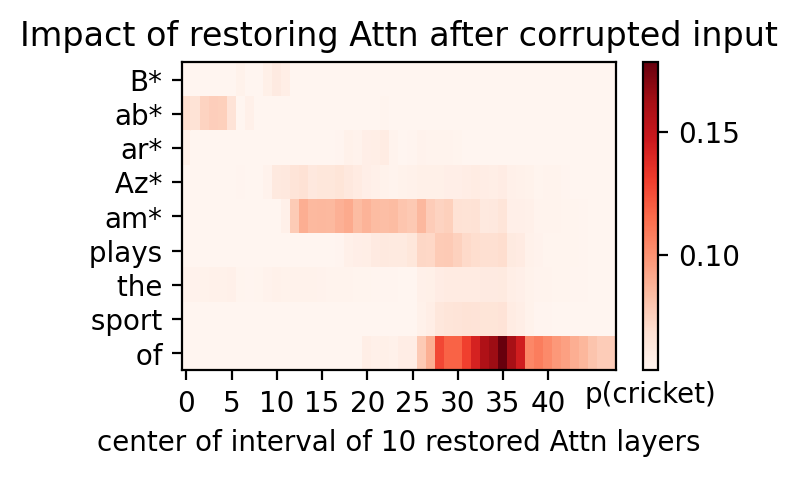

Threshold:  tensor(0.0531)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  30  Token:  3
Layer:  31  Token:  3
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42

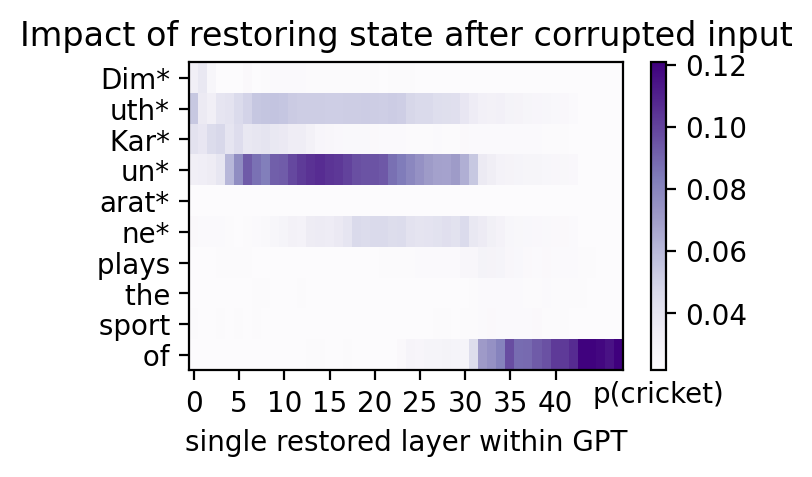

Threshold:  tensor(0.0471)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3



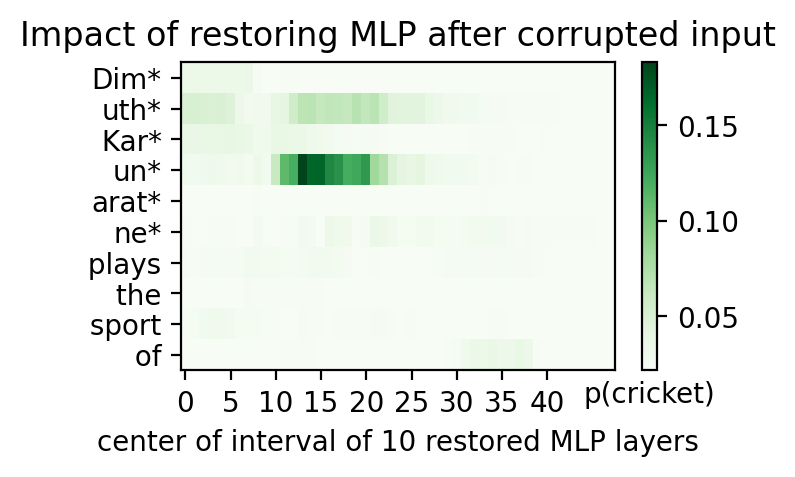

Threshold:  tensor(0.0356)

Highly Activated Neurons:
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  14  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  27  Token:  9
Layer:  28  Token:  9
Layer:  29  Token:  9
Layer:  30  Token:  9
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9
Layer:  44  Token:  9
Layer:  45  Token:  9
Layer:  46  Token:  9
Layer:  47  Token:  9



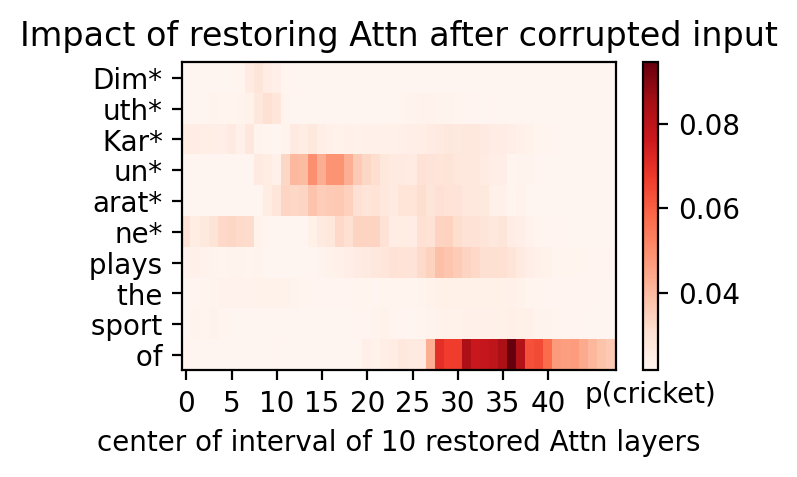

Threshold:  tensor(0.1543)

Highly Activated Neurons:
Layer:  4  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47 

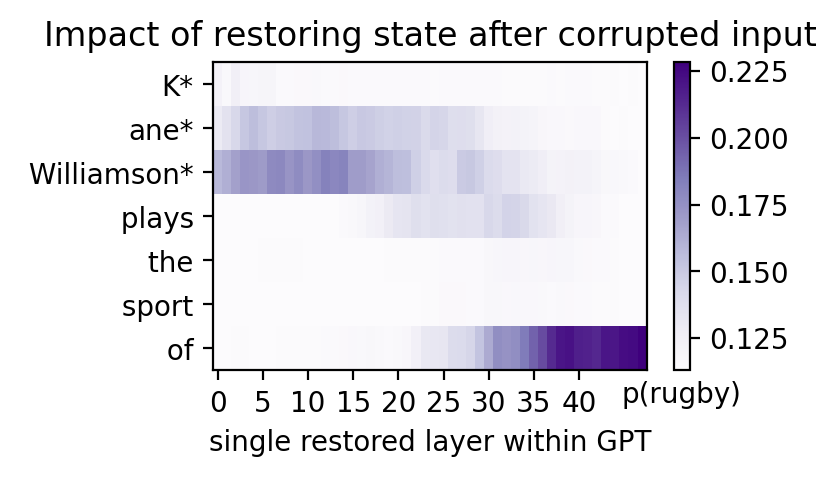

Threshold:  tensor(0.1356)

Highly Activated Neurons:
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  19  Token:  2
Layer:  24  Token:  2
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6



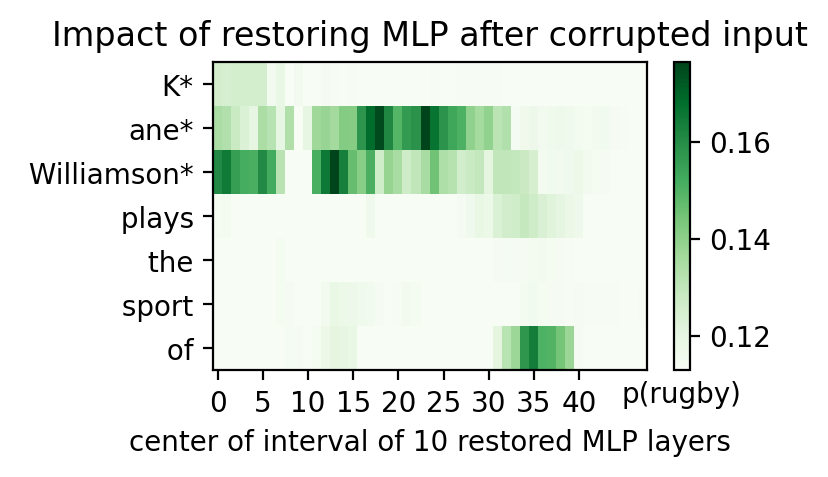

Threshold:  tensor(0.1386)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  7  Token:  1
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  22  Token:  2
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  27  Token:  3
Layer:  24  Token:  6
Layer:  25  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



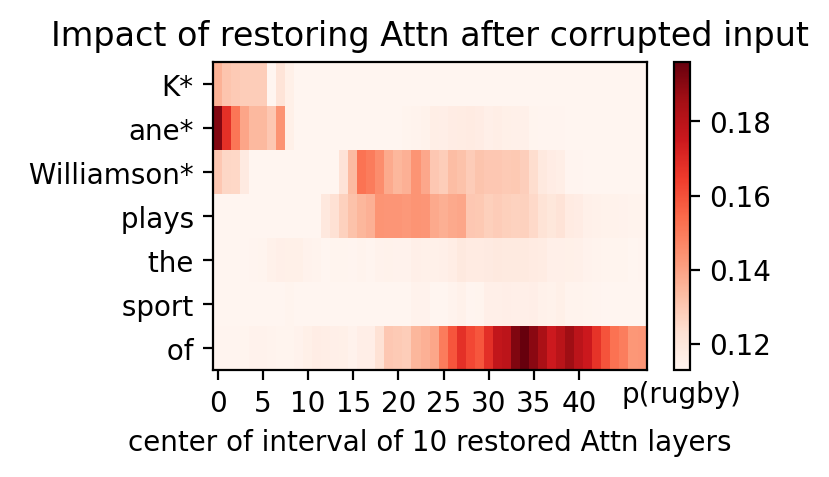

Threshold:  tensor(0.0744)

Highly Activated Neurons:
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22 

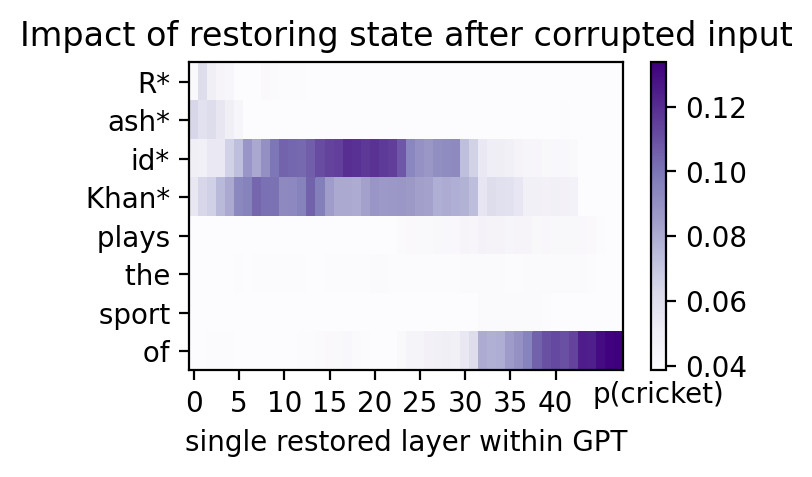

Threshold:  tensor(0.0564)

Highly Activated Neurons:
Layer:  6  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  31  Token:  2
Layer:  32  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
L

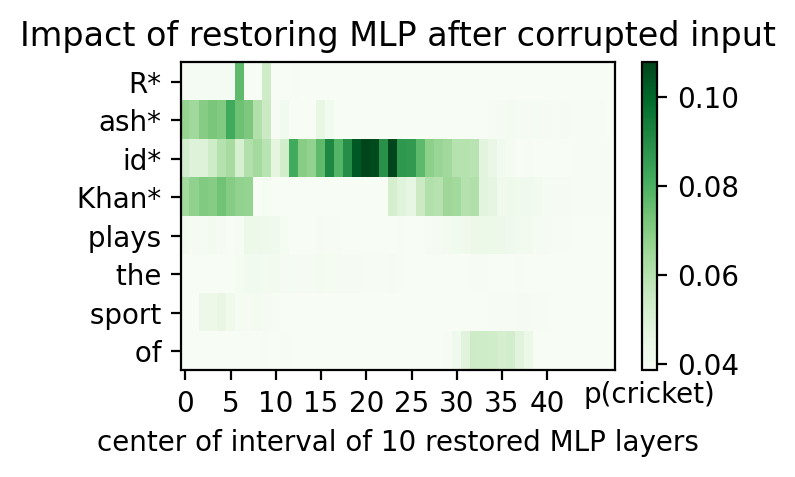

Threshold:  tensor(0.0555)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  10  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7



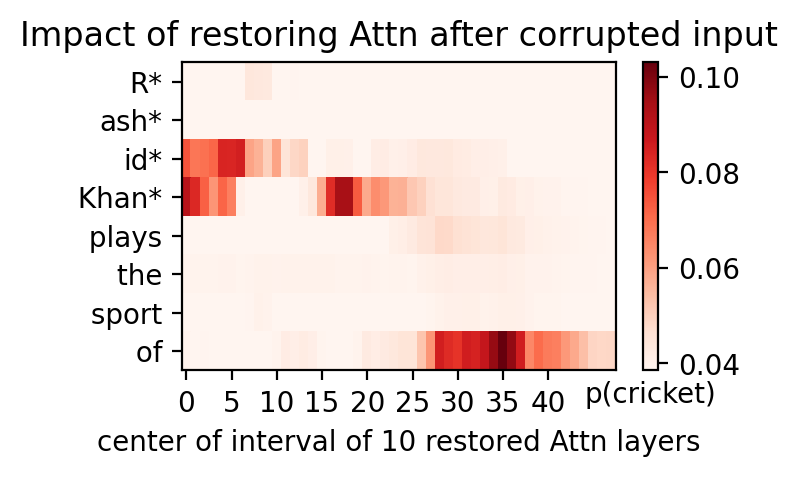

Threshold:  tensor(0.0339)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  2  Token:  0
Layer:  5  Token:  9
Layer:  7  Token:  9
Layer:  16  Token:  10
Layer:  17  Token:  10
Layer:  18  Token:  10
Layer:  19  Token:  10
Layer:  20  Token:  10
Layer:  21  Token:  10
Layer:  22  Token:  10
Layer:  23  Token:  10
Layer:  24  Token:  10
Layer:  25  Token:  10
Layer:  26  Token:  10
Layer:  27  Token:  10
Layer:  28  Token:  10
Layer:  29  Token:  10
Layer:  30  Token:  10
Layer:  31  Token:  10
Layer:  32  Token:  10
Layer:  33  Token:  10
Layer:  34  Token:  10
Layer:  35  Token:  10
Layer:  36  Token:  10
Layer:  37  Token:  10
Layer:  38  Token:  10
Layer:  39  Token:  10
Layer:  40  Token:  10
Layer:  41  Token:  10
Layer:  42  Token:  10
Layer:  43  Token:  10
Layer:  44  Token:  10
Layer:  45  Token:  10
Layer:  46  Token:  10
Layer:  47  Token:  10



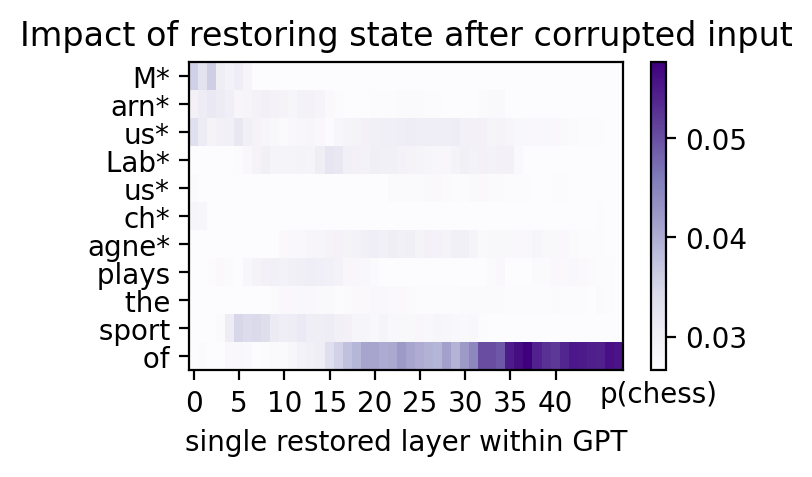

Threshold:  tensor(0.0317)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  16  Token:  2
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  23  Token:  4
Layer:  11  Token:  6
Layer:  12  Token:  6
Layer:  13  Token:  6
Layer:  3  Token:  7
Layer:  5  Token:  7
Layer:  6  Token:  7
Layer:  7  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Laye

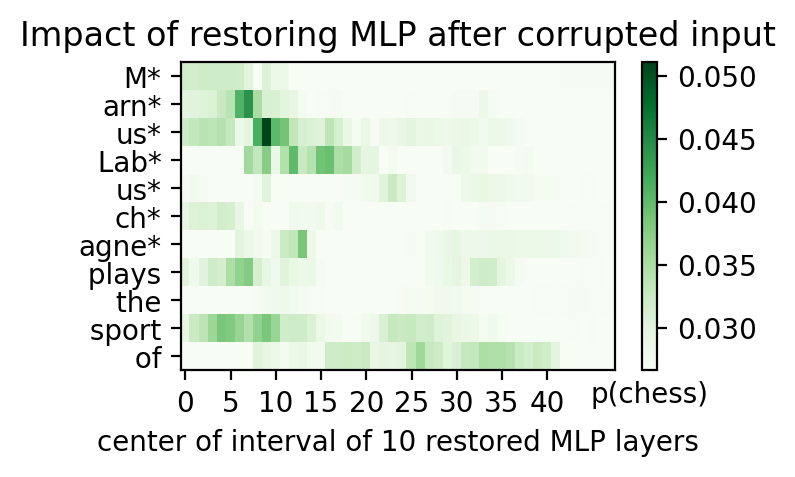

Threshold:  tensor(0.0320)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  6  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  11  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  18  Token:  2
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  14  Token:  6
Layer:  15  Token:  6
Layer:  16  Token:  6
Layer:  17  Token:  6
Layer:  18  Token:  6
Layer:  20  Token:  6
Layer:  14  Token:  7
Layer:  15  Token:  7
Layer:  1  Token:  9
Layer:  2  Token:  9
Layer:  3  Token:  9
Layer:  4  Token:  9
Layer:  5  Token:  9
Layer:  6  Token:  9
Layer:  7  Token:  9
Layer:  8  Token:  9
Layer:  9  Token:  9
Layer:  12  Token:  10
Layer:  13  Token:  10
Layer:  14  Token:  10
Layer:  15  Token:  10
Layer:  16  Token:  10
Layer:  17  Token:  10
Layer:  18  Token:  10
Layer:  19  Token:  10
Layer:  20  Token:  10
Layer

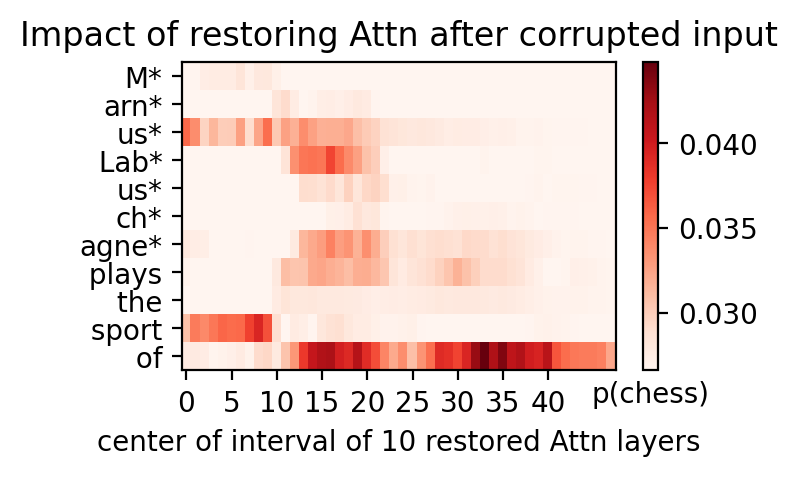

Threshold:  tensor(0.0568)

Highly Activated Neurons:
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  31  Token:  2
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



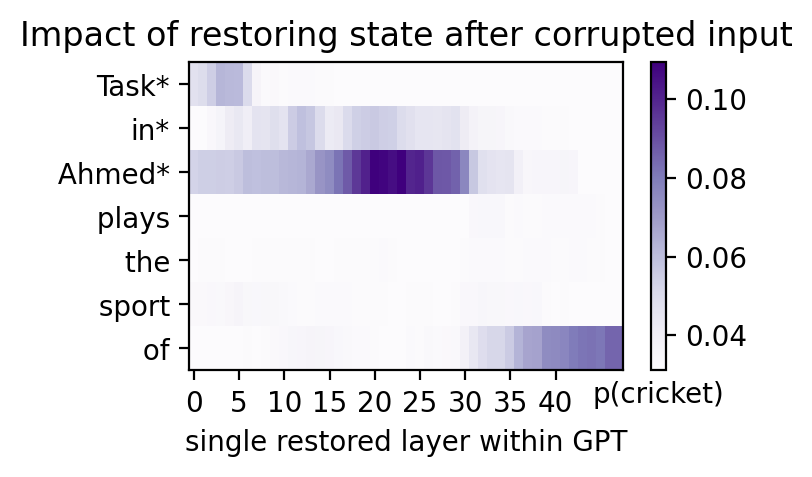

Threshold:  tensor(0.0420)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  9  Token:  0
Layer:  10  Token:  0
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  18  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  12  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  31  Token:  2
Layer:  32  Token:  2
Layer:  32  Toke

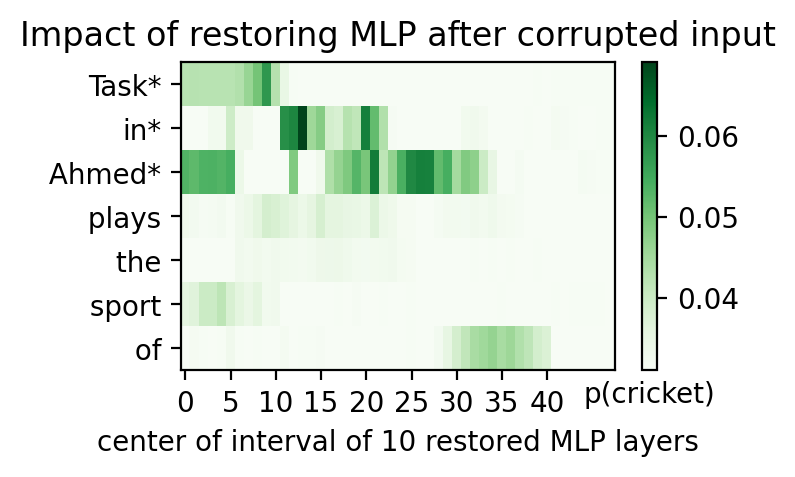

Threshold:  tensor(0.0397)

Highly Activated Neurons:
Layer:  2  Token:  1
Layer:  7  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6



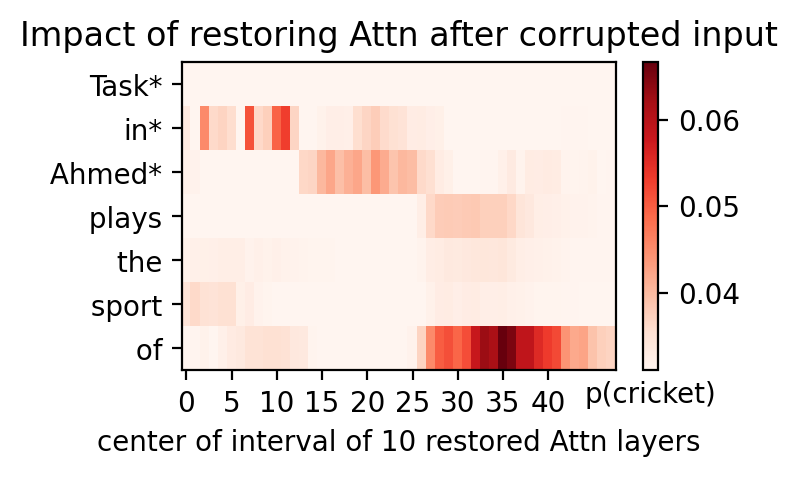

Threshold:  tensor(0.1026)

Highly Activated Neurons:
Layer:  3  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37 

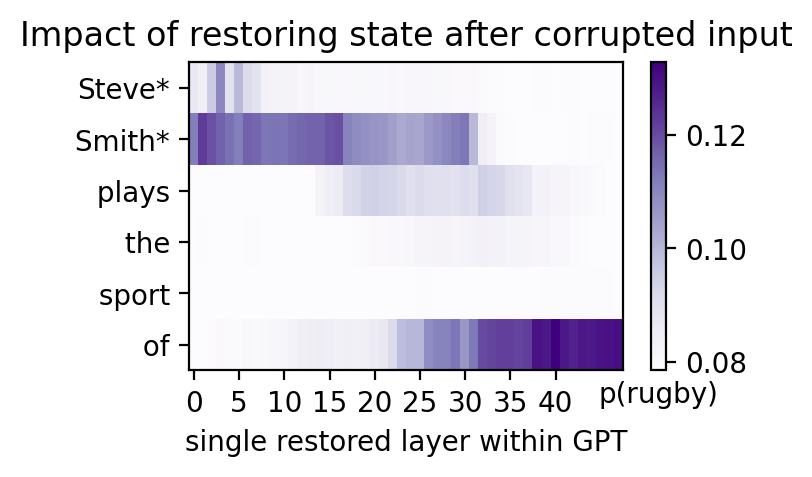

Threshold:  tensor(0.1017)

Highly Activated Neurons:
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  9  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  34  Token:  5
Layer:  37  Token:  5
Layer:  39  Token:  5



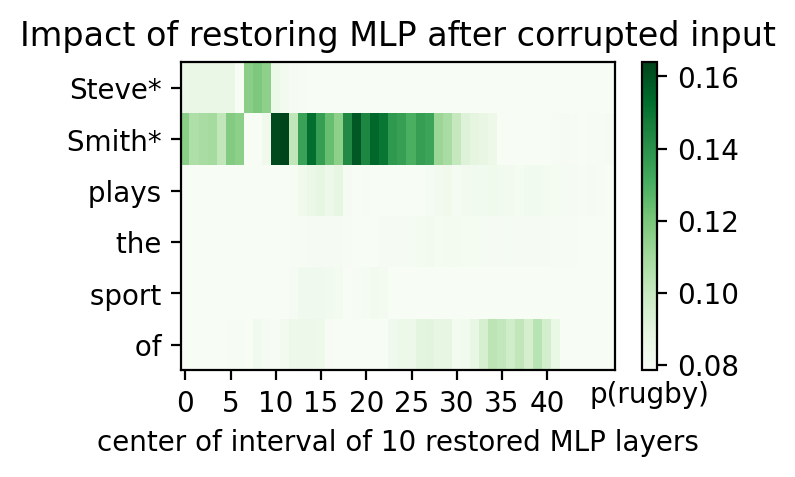

Threshold:  tensor(0.0932)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  24  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5



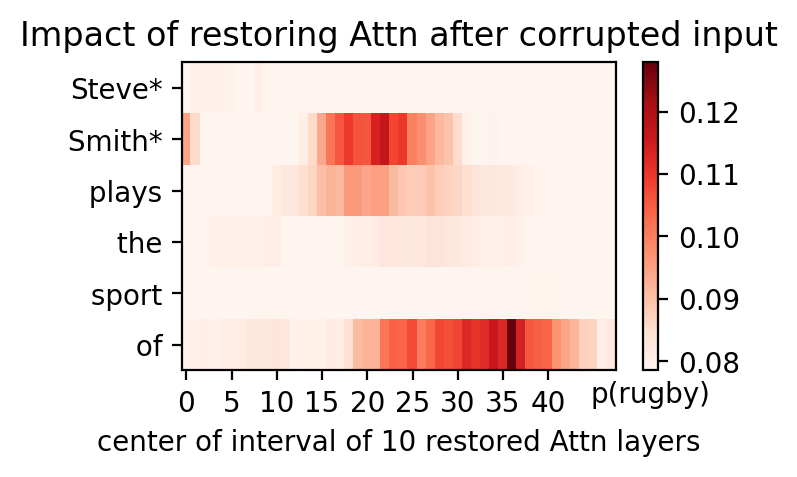

Threshold:  tensor(0.0962)

Highly Activated Neurons:
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  1
Layer:  32  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  

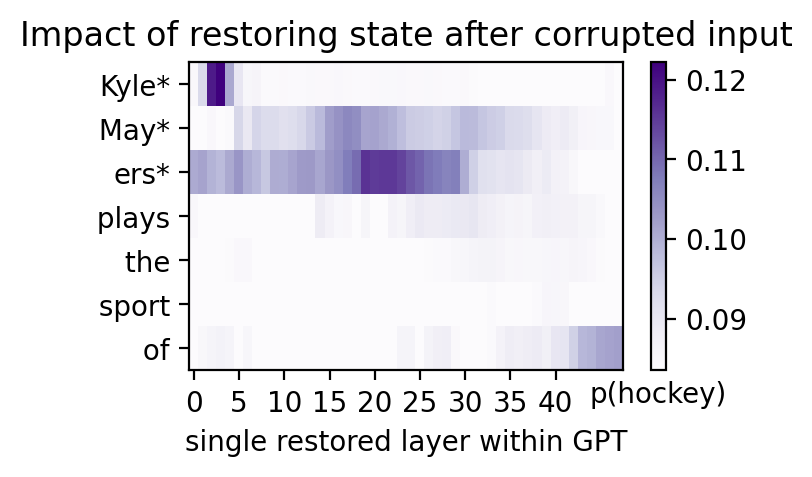

Threshold:  tensor(0.0929)

Highly Activated Neurons:
Layer:  6  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  5  Token:  2
Layer:  7  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  27  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  31  Token:  2
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  8  Token:  6
Layer:  11  Token:  6
Layer:  12  Token:  6
Layer:  13 

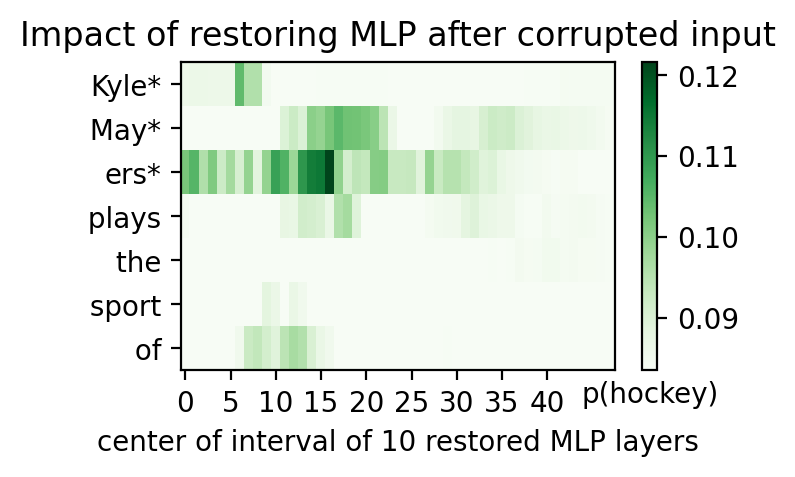

Threshold:  tensor(0.0923)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  10  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  27  Token:  3
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



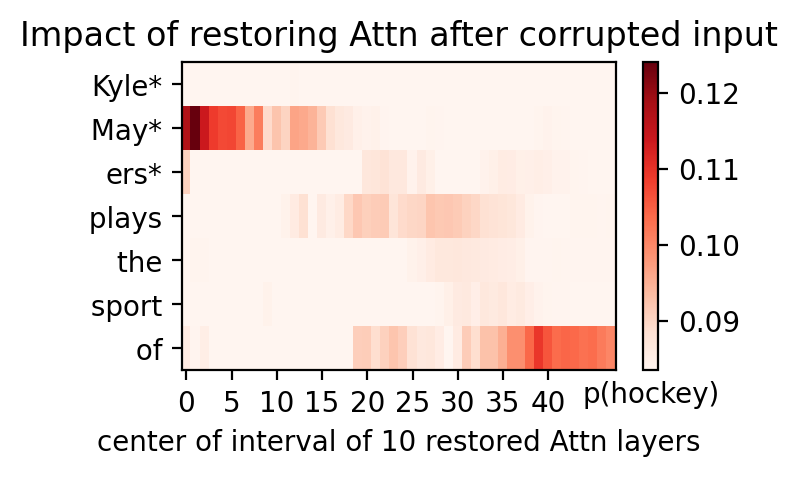

In [ ]:
prompts = [
    "Virat Kohli plays the sport of",
    "Joe Root plays the sport of",
    "Babar Azam plays the sport of",
    "Dimuth Karunaratne plays the sport of",
    "Kane Williamson plays the sport of",
    "Rashid Khan plays the sport of",
    "Marnus Labuschagne plays the sport of",
    "Taskin Ahmed plays the sport of",
    "Steve Smith plays the sport of",
    "Kyle Mayers plays the sport of"
]
for prompt in prompts:
    plot_all_flow(mt, prompt, noise=noise_level)

Threshold:  tensor(0.3513)

Highly Activated Neurons:
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  4

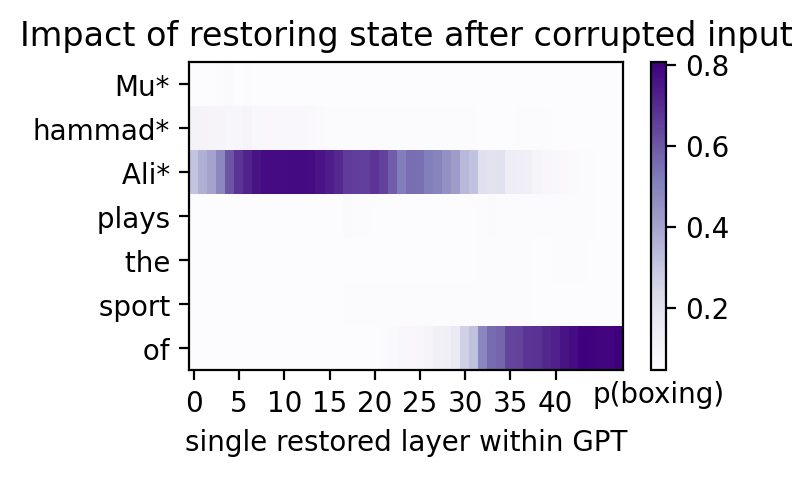

Threshold:  tensor(0.1549)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2



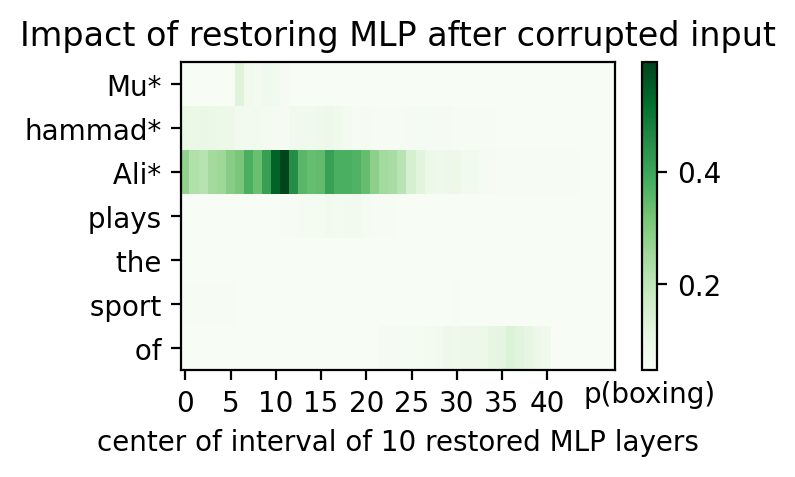

Threshold:  tensor(0.1280)

Highly Activated Neurons:
Layer:  25  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6



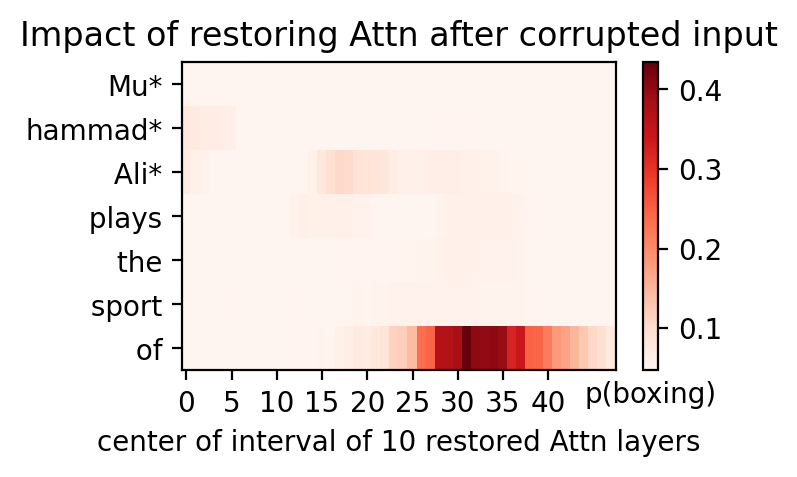

Threshold:  tensor(0.3235)

Highly Activated Neurons:
Layer:  3  Token:  5
Layer:  4  Token:  5
Layer:  5  Token:  5
Layer:  6  Token:  5
Layer:  7  Token:  5
Layer:  8  Token:  5
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  24  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  30  Token:  9
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9
Layer: 

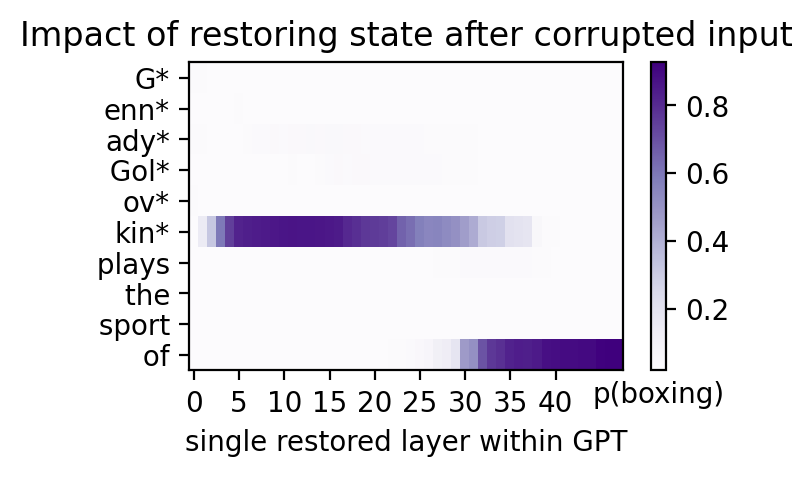

Threshold:  tensor(0.1376)

Highly Activated Neurons:
Layer:  0  Token:  5
Layer:  1  Token:  5
Layer:  2  Token:  5
Layer:  3  Token:  5
Layer:  4  Token:  5
Layer:  5  Token:  5
Layer:  6  Token:  5
Layer:  7  Token:  5
Layer:  8  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9



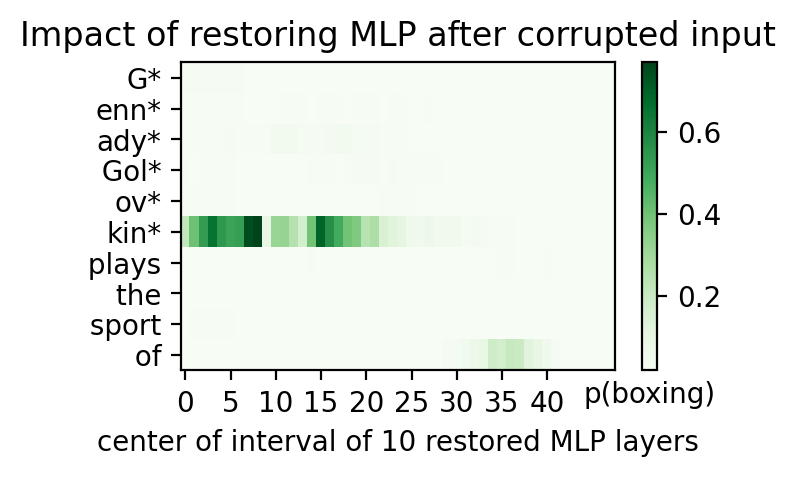

Threshold:  tensor(0.1212)

Highly Activated Neurons:
Layer:  0  Token:  5
Layer:  1  Token:  5
Layer:  2  Token:  5
Layer:  3  Token:  5
Layer:  4  Token:  5
Layer:  5  Token:  5
Layer:  25  Token:  9
Layer:  26  Token:  9
Layer:  27  Token:  9
Layer:  28  Token:  9
Layer:  29  Token:  9
Layer:  30  Token:  9
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9



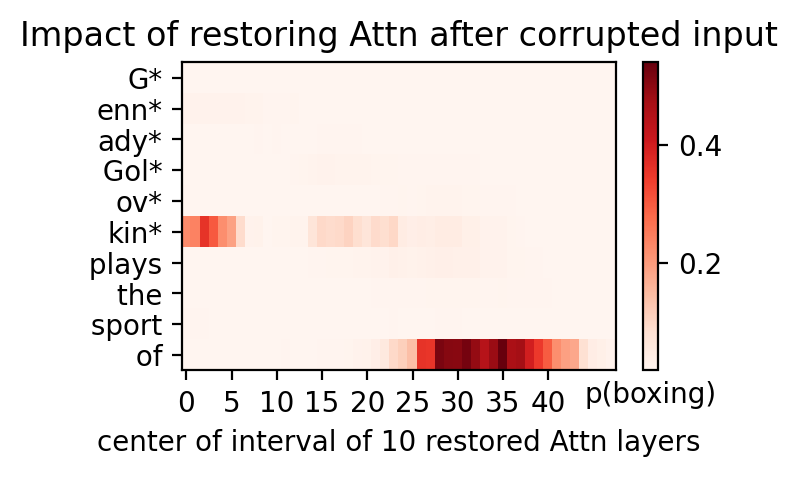

Threshold:  tensor(0.3993)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  1
Layer:  32  Token:  1
Layer:  33  Token:  1
Layer:  34  Token:  1
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40

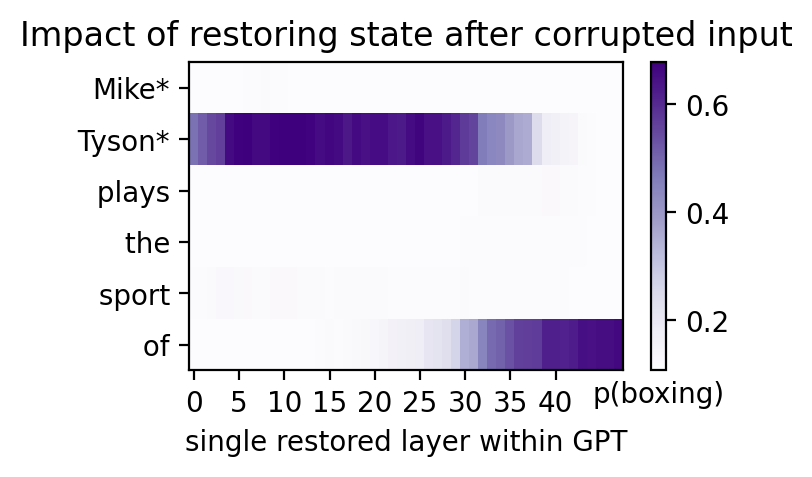

Threshold:  tensor(0.2546)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1



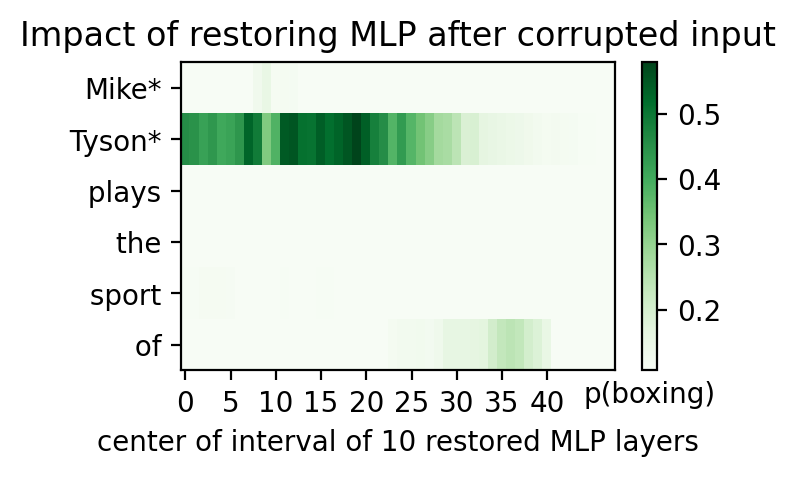

Threshold:  tensor(0.2199)

Highly Activated Neurons:
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5



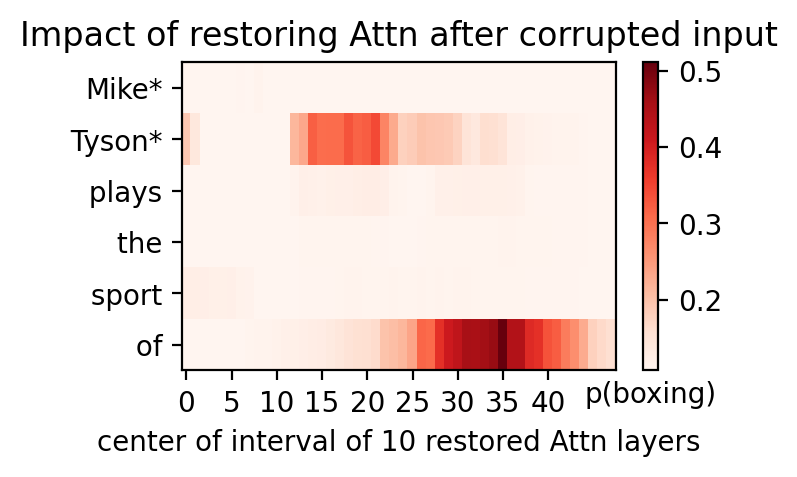

Threshold:  tensor(0.3659)

Highly Activated Neurons:
Layer:  0  Token:  4
Layer:  1  Token:  4
Layer:  2  Token:  4
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  30  Token:  4
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42

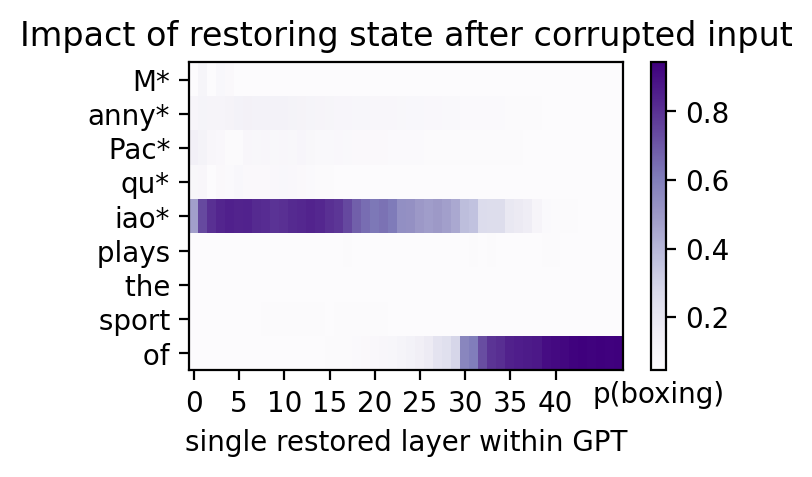

Threshold:  tensor(0.1630)

Highly Activated Neurons:
Layer:  0  Token:  4
Layer:  1  Token:  4
Layer:  2  Token:  4
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  11  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8



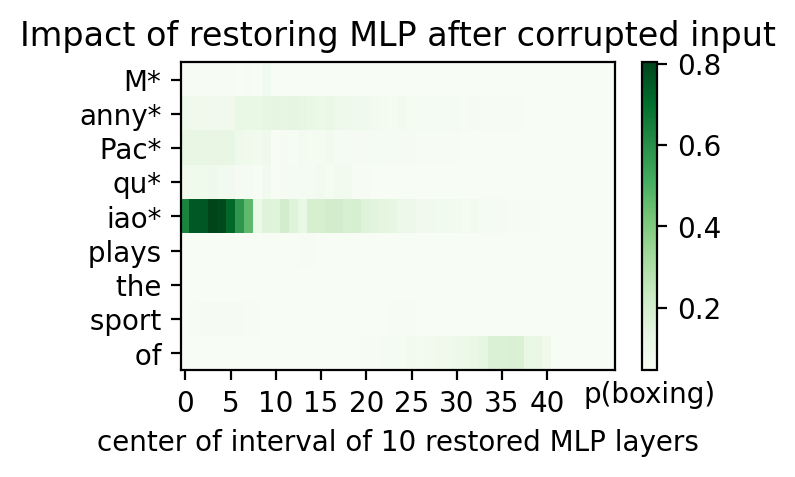

Threshold:  tensor(0.1370)

Highly Activated Neurons:
Layer:  0  Token:  4
Layer:  1  Token:  4
Layer:  2  Token:  4
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  23  Token:  8
Layer:  24  Token:  8
Layer:  25  Token:  8
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8



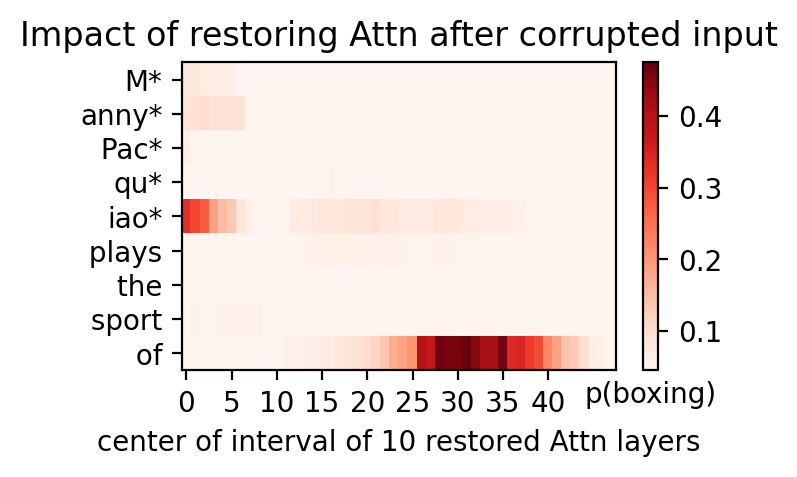

Threshold:  tensor(0.2351)

Highly Activated Neurons:
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  30  Token:  3
Layer:  31  Token:  3
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



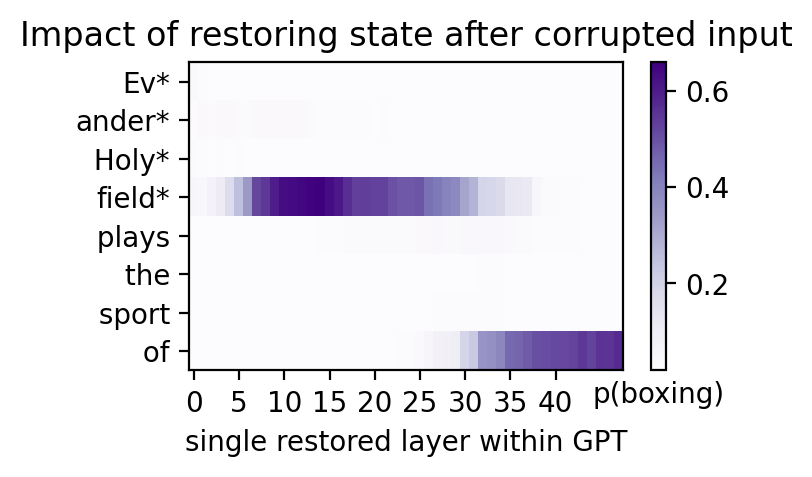

Threshold:  tensor(0.1063)

Highly Activated Neurons:
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3



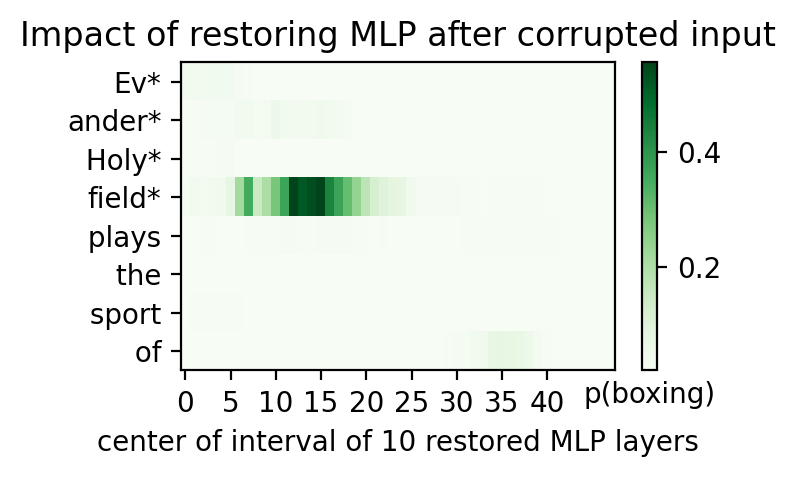

Threshold:  tensor(0.0862)

Highly Activated Neurons:
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7



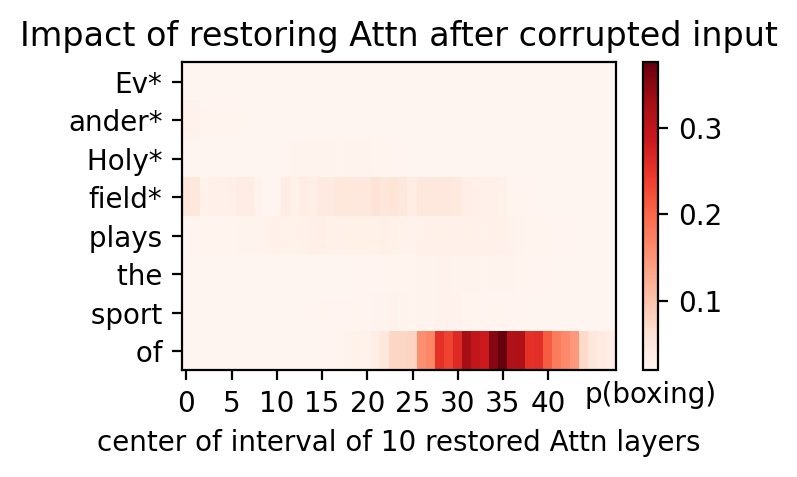

Threshold:  tensor(0.0386)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



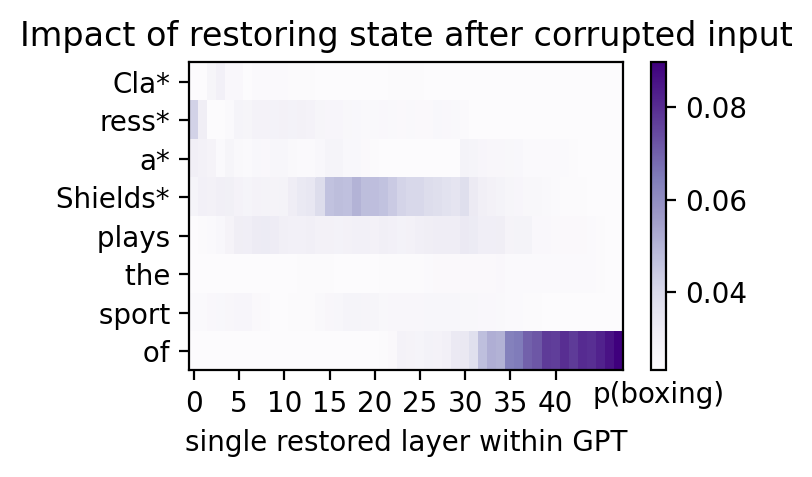

Threshold:  tensor(0.0304)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  7  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  8  Token:  3
Layer:  10  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  30  Token:  3
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  37  Token:  7



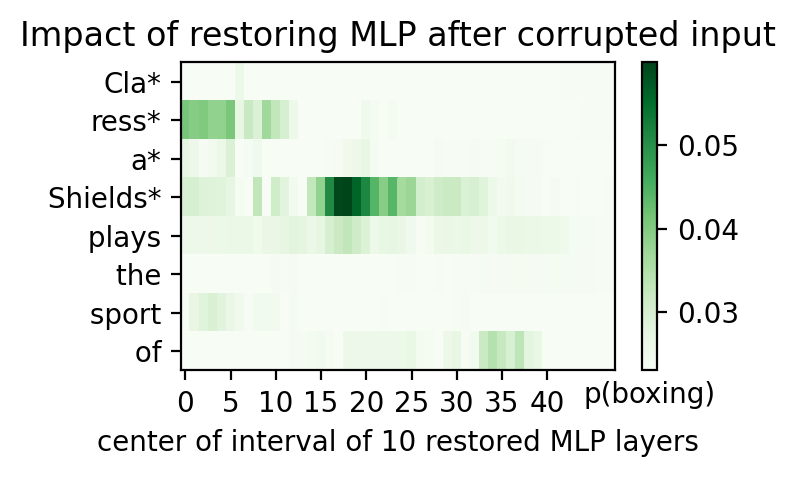

Threshold:  tensor(0.0326)

Highly Activated Neurons:
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  16  Token:  3
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  8  Token:  4
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



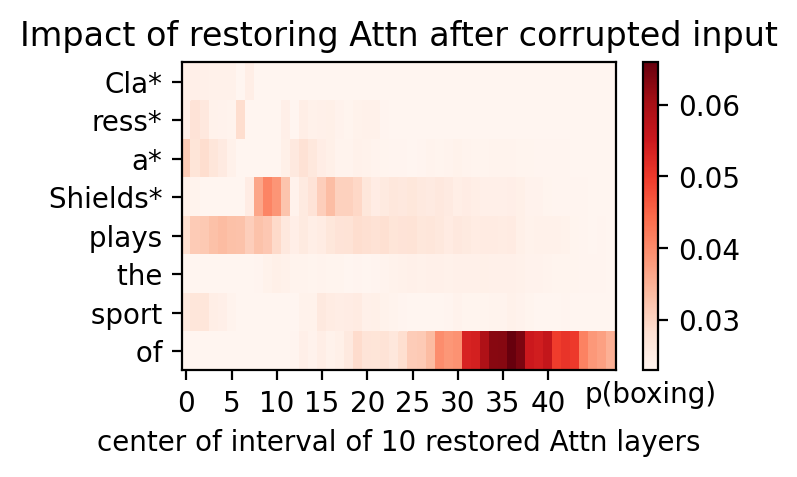

Threshold:  tensor(0.0788)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  1
Layer:  32  Token:  1
Layer:  33  Token:  1
Layer:  34  Token:  1
Layer:  35  Token:  1
Layer:  36  Token:  1
Layer:  37  Token:  1
Layer:  38  Token:  1



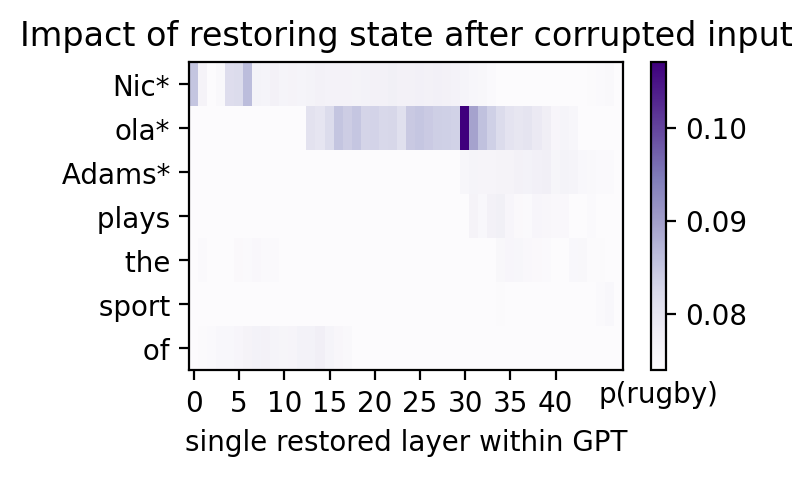

Threshold:  tensor(0.0819)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  13  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  1
Layer:  24  Token:  2
Layer:  31  Token:  2
Layer:  15  Token:  3
Layer:  17  Token:  3
Layer:  33  Token:  3
Layer:  13  Token:  6
Layer:  14  Token:  6



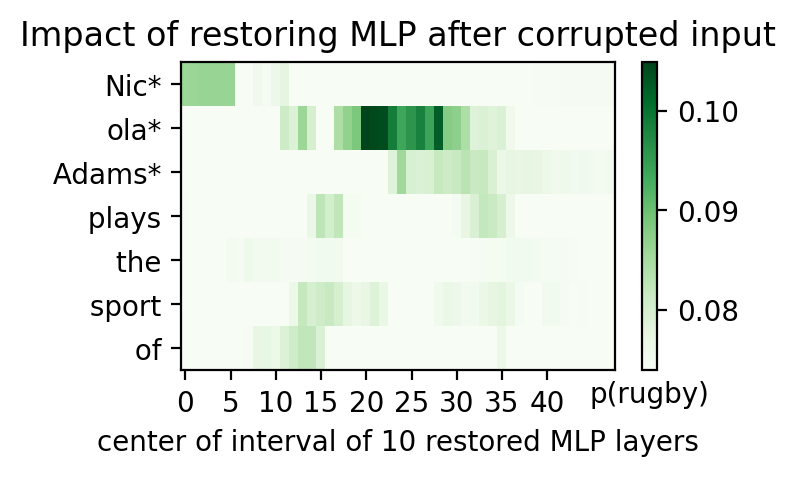

Threshold:  tensor(0.0805)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  9  Token:  0
Layer:  10  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  31  Token:  2
Layer:  32  Token:  2
Layer:  33  Token:  2
Layer:  34  Token:  2
Layer:  35  Token:  2
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



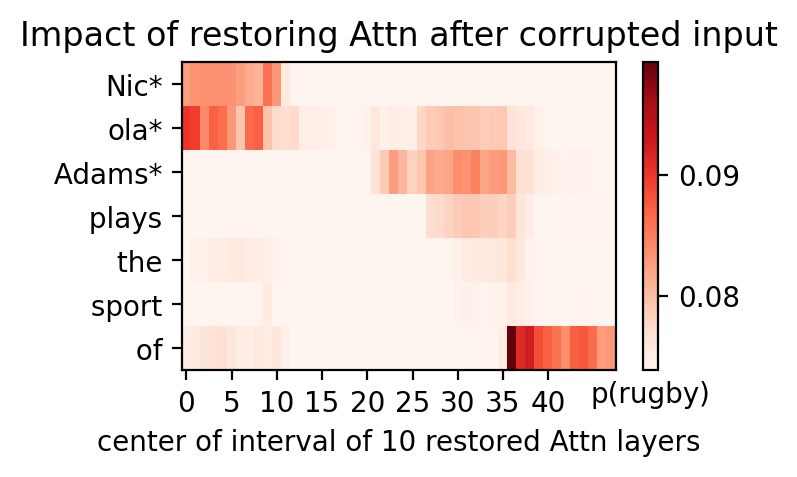

Threshold:  tensor(0.0988)

Highly Activated Neurons:
Layer:  6  Token:  0



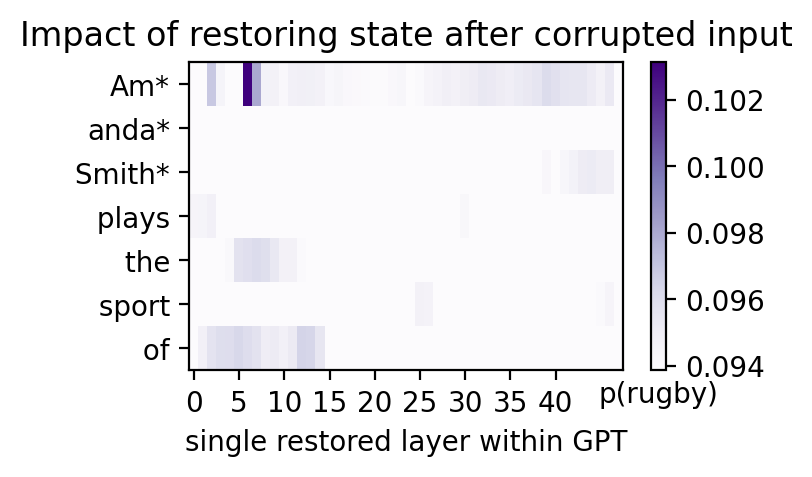

Threshold:  tensor(0.1015)

Highly Activated Neurons:
Layer:  10  Token:  0
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  12  Token:  6
Layer:  13  Token:  6



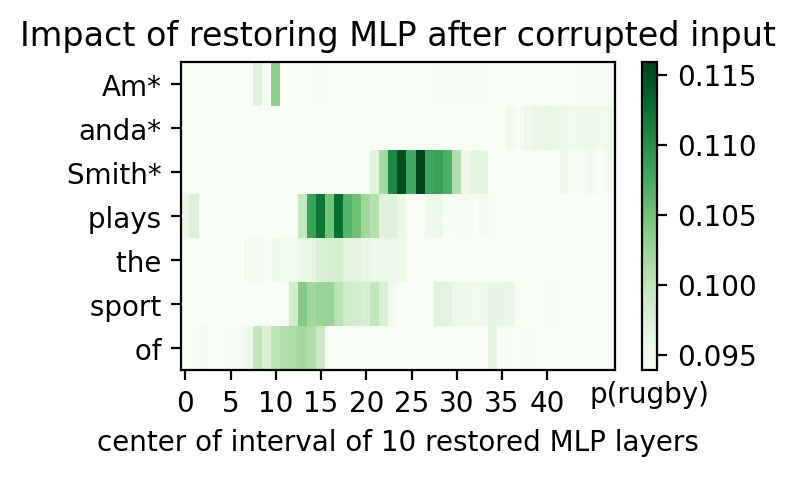

Threshold:  tensor(0.0961)

Highly Activated Neurons:
Layer:  8  Token:  0
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  1  Token:  6



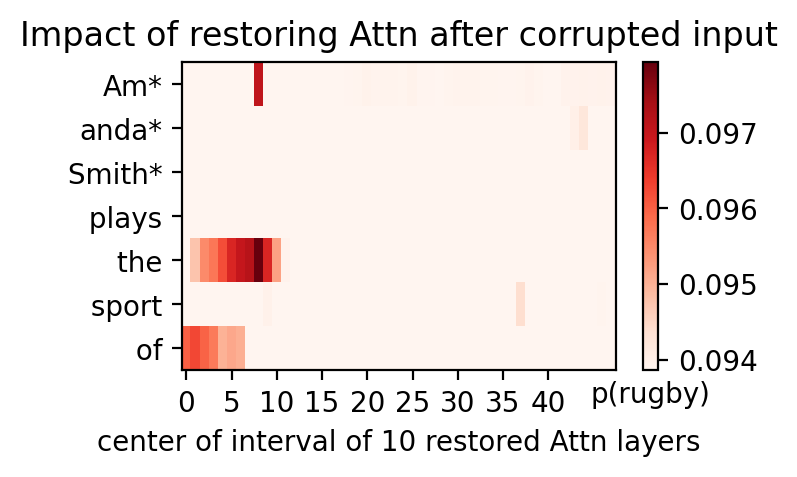

Threshold:  tensor(0.0724)

Highly Activated Neurons:
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  1
Layer:  32  Token:  1
Layer:  33  Token:  1
Layer:  34  Token:  1
Layer:  35  Token:  1
Layer:  36  Token:  1
Layer:  37  Token:  1
Layer:  38  Token:  1
Layer:  39  Token:  1
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  30  Token:  3
Layer:  23  Token:  7
Layer:  24

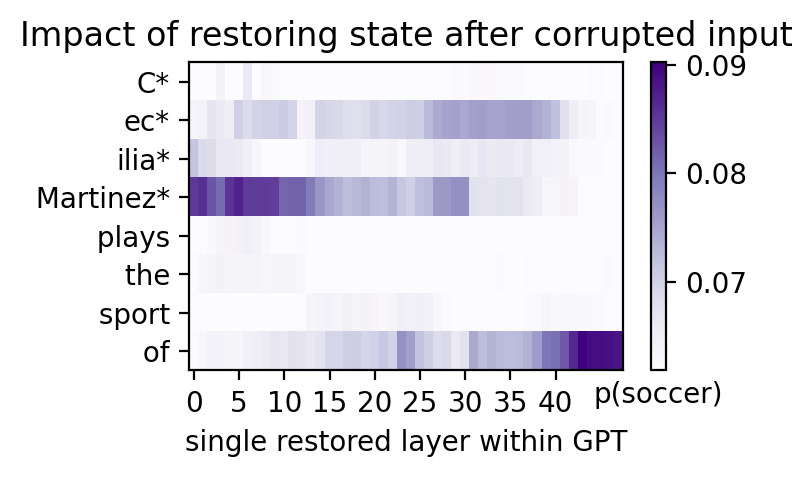

Threshold:  tensor(0.0675)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  20  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  21  Token:  3
Layer:  24  Token:  3
Layer:  28  Token:  3
Layer:  31  Token:  3
Layer:  32  Token:  3
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  29  Token:  6



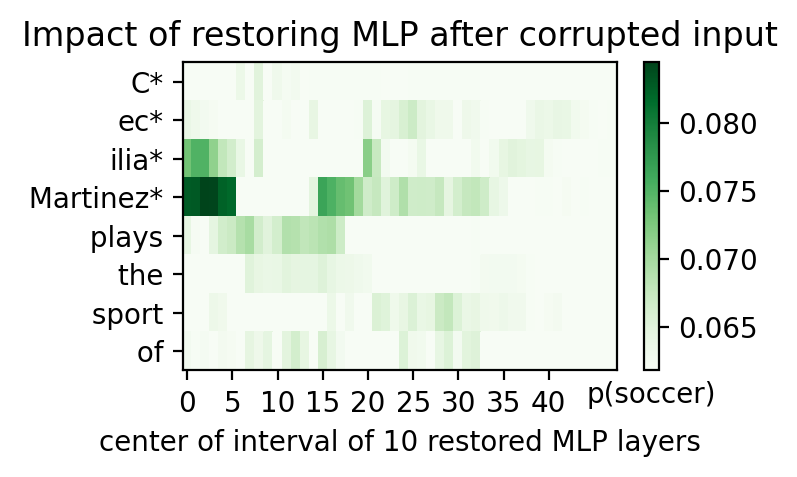

Threshold:  tensor(0.0672)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  7  Token:  0
Layer:  8  Token:  0
Layer:  0  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  0  Token:  3
Layer:  11  Token:  7
Layer:  19  Token:  7
Layer:  20  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



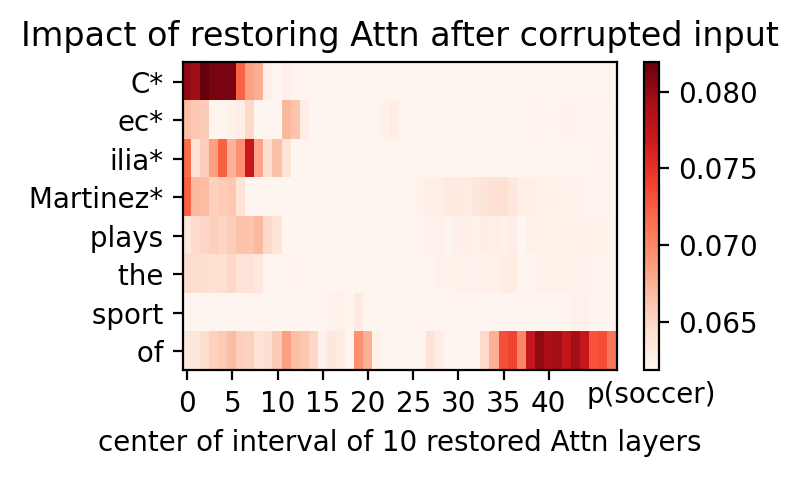

In [ ]:
prompts = [
    "Muhammad Ali plays the sport of",
    "Gennady Golovkin plays the sport of",
    "Mike Tyson plays the sport of",
    "Manny Pacquiao plays the sport of",
    "Evander Holyfield plays the sport of",
    "Claressa Shields plays the sport of",
    "Nicola Adams plays the sport of",
    "Amanda Smith plays the sport of",
    "Cecilia Martinez plays the sport of"
]
for prompt in prompts:
    plot_all_flow(mt, prompt, noise=noise_level)

Threshold:  tensor(0.2154)

Highly Activated Neurons:
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



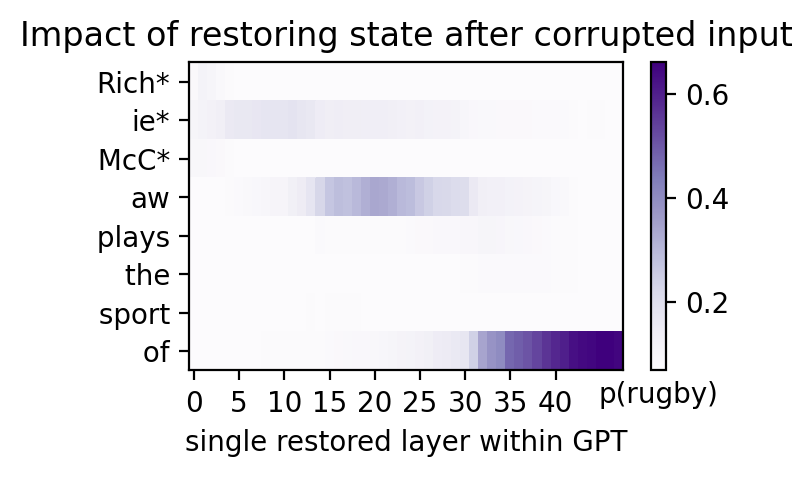

Threshold:  tensor(0.1053)

Highly Activated Neurons:
Layer:  6  Token:  0
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  12  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7



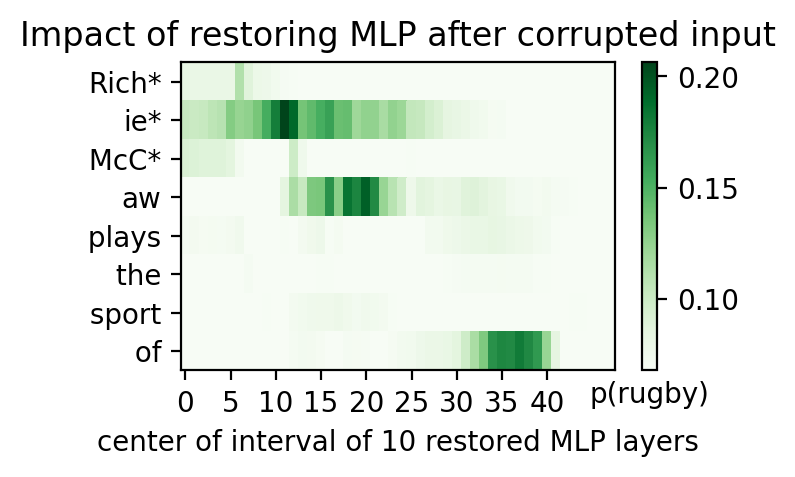

Threshold:  tensor(0.1358)

Highly Activated Neurons:
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



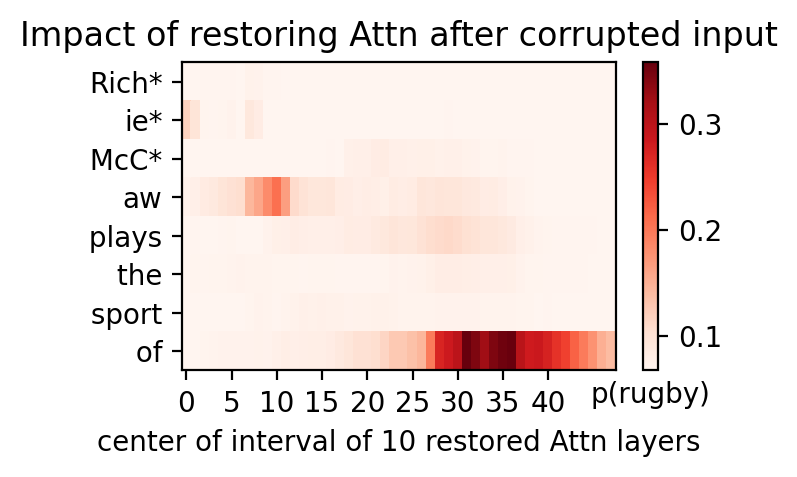

Threshold:  tensor(0.1291)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:

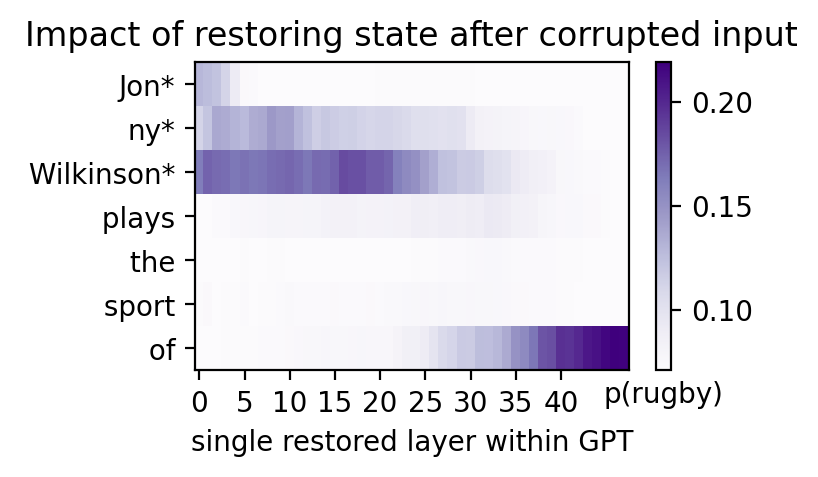

Threshold:  tensor(0.0979)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
L

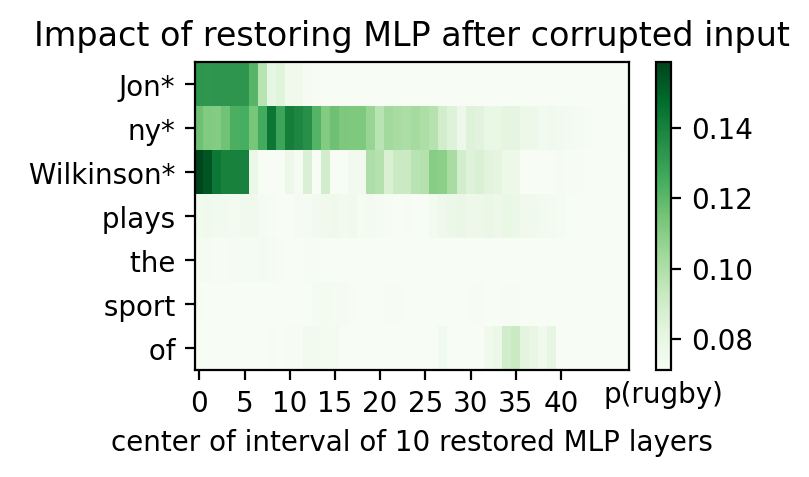

Threshold:  tensor(0.0966)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  10  Token:  1
Layer:  10  Token:  2
Layer:  23  Token:  2
Layer:  23  Token:  6
Layer:  24  Token:  6
Layer:  25  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



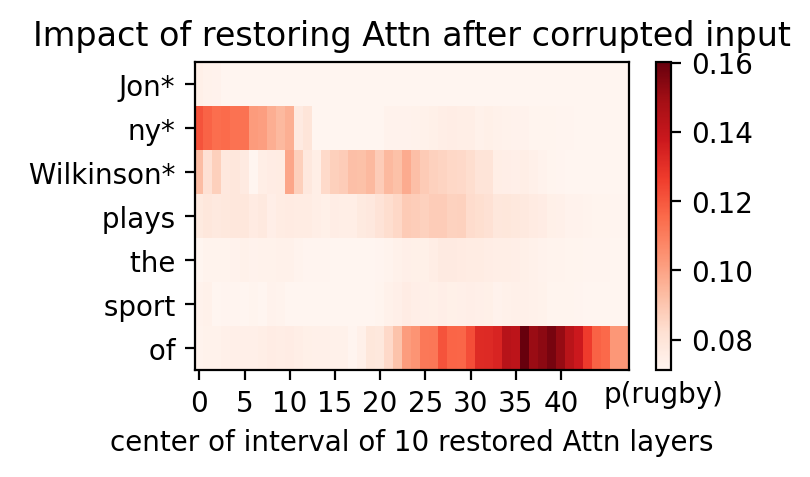

Threshold:  tensor(0.2019)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  24  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  4

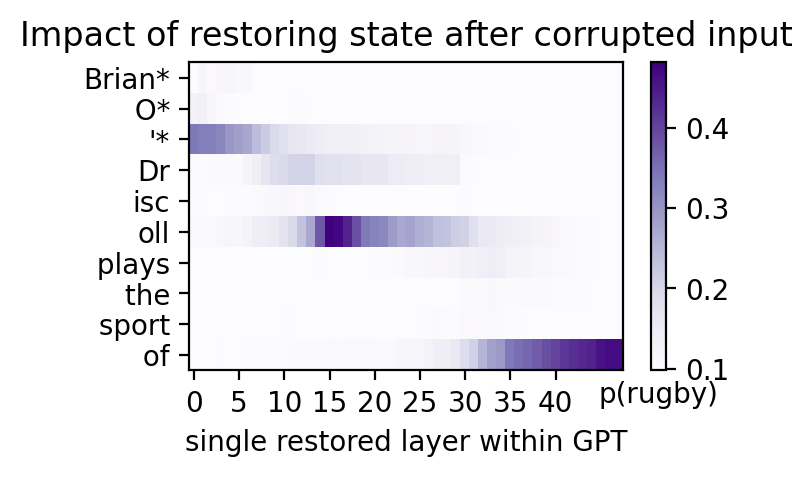

Threshold:  tensor(0.1570)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  34  Token:  9
Layer:  35  Token:  9



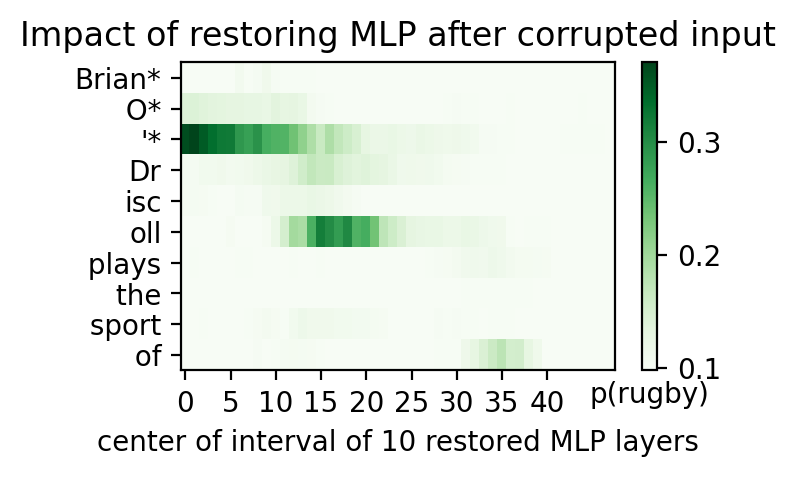

Threshold:  tensor(0.1572)

Highly Activated Neurons:
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  7  Token:  5
Layer:  8  Token:  5
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  29  Token:  5
Layer:  26  Token:  9
Layer:  27  Token:  9
Layer:  28  Token:  9
Layer:  29  Token:  9
Layer:  30  Token:  9
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9
Layer:  44  Token:  9
Layer:  45  Token:  9
Layer:  46  Token:  9
Layer:  47  Token:  9



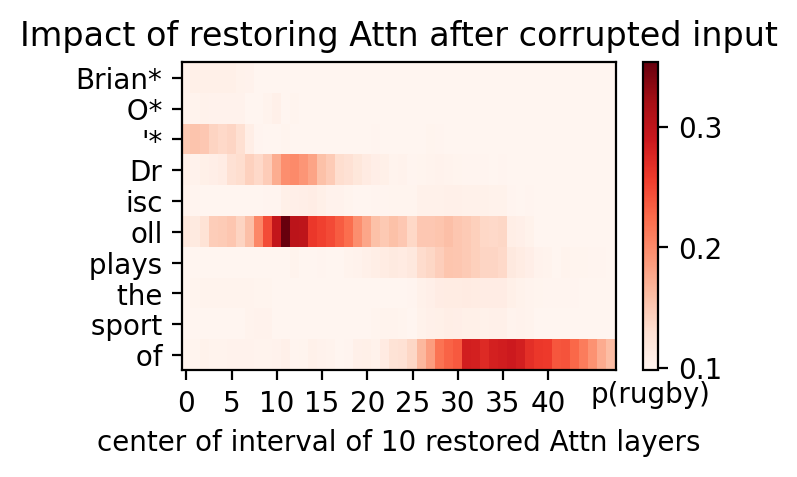

Threshold:  tensor(0.2694)

Highly Activated Neurons:
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  30  Token:  4
Layer:  31  Token:  4
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  47  Token:  8



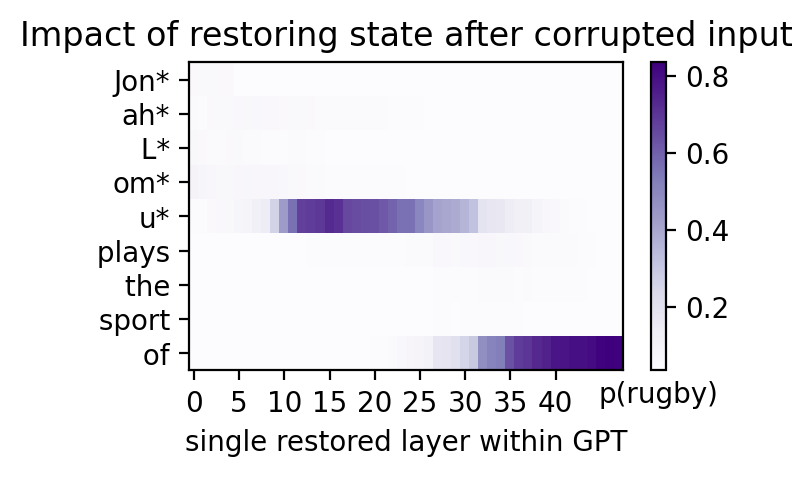

Threshold:  tensor(0.1074)

Highly Activated Neurons:
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8



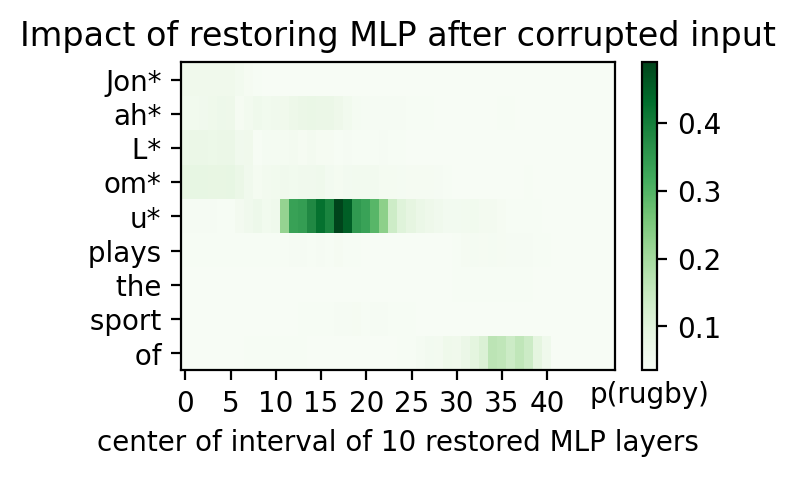

Threshold:  tensor(0.1260)

Highly Activated Neurons:
Layer:  23  Token:  8
Layer:  24  Token:  8
Layer:  25  Token:  8
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8



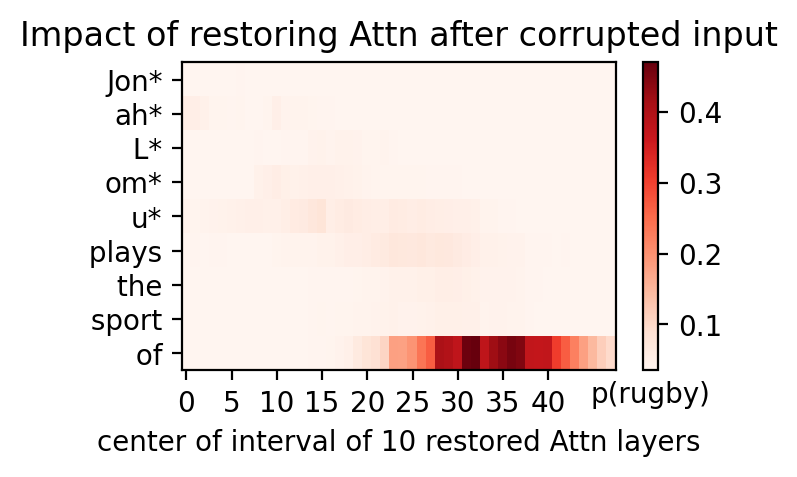

Threshold:  tensor(0.1450)

Highly Activated Neurons:
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



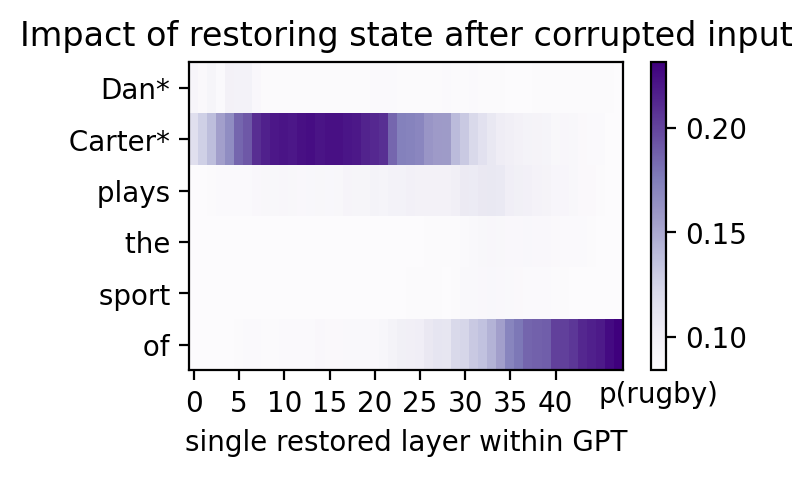

Threshold:  tensor(0.1353)

Highly Activated Neurons:
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1



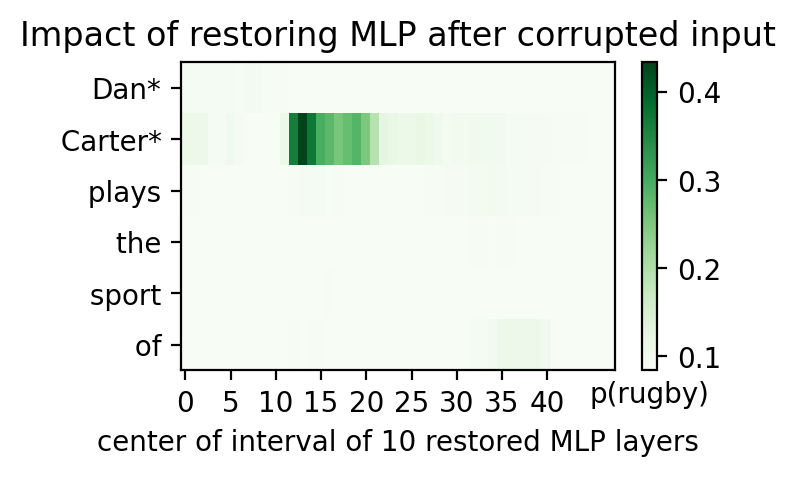

Threshold:  tensor(0.1056)

Highly Activated Neurons:
Layer:  23  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



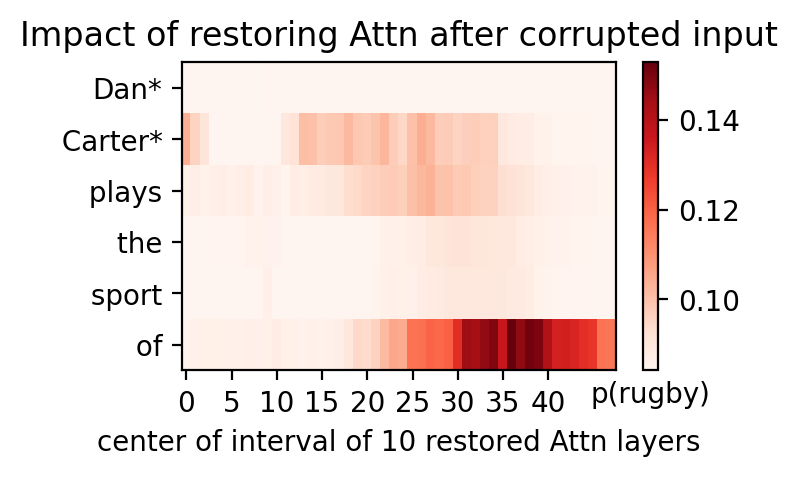

Threshold:  tensor(0.1429)

Highly Activated Neurons:
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  3

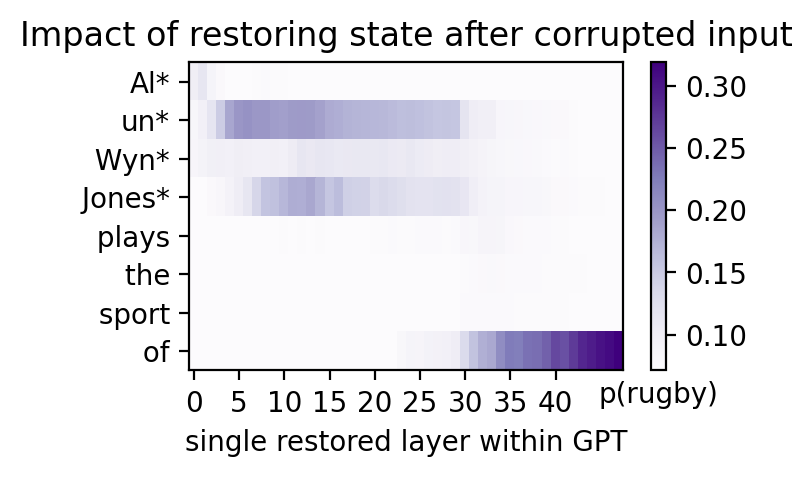

Threshold:  tensor(0.1091)

Highly Activated Neurons:
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7



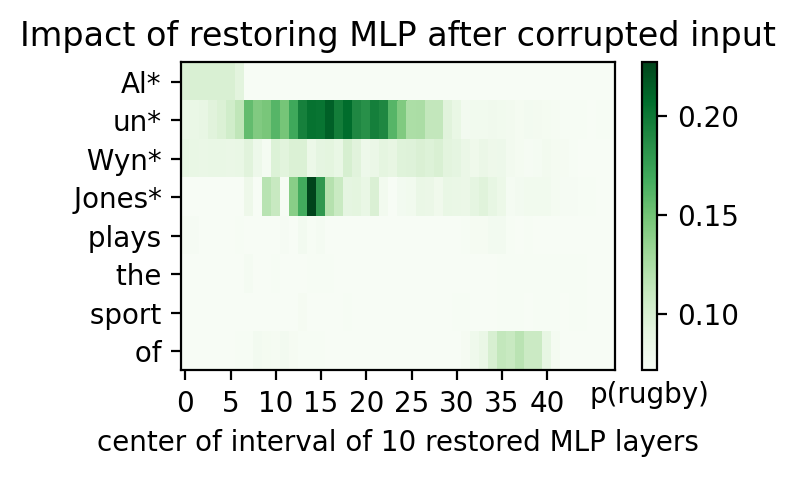

Threshold:  tensor(0.1049)

Highly Activated Neurons:
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



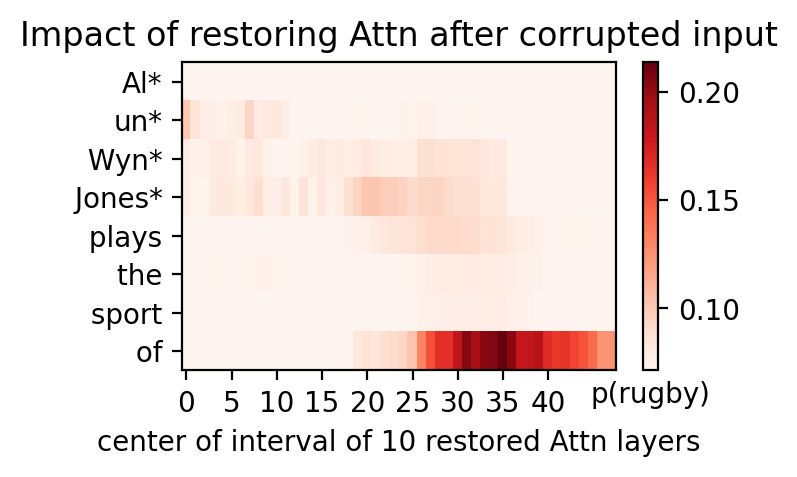

Threshold:  tensor(0.4293)

Highly Activated Neurons:
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  31  Token:  2
Layer:  32  Token:  2
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:

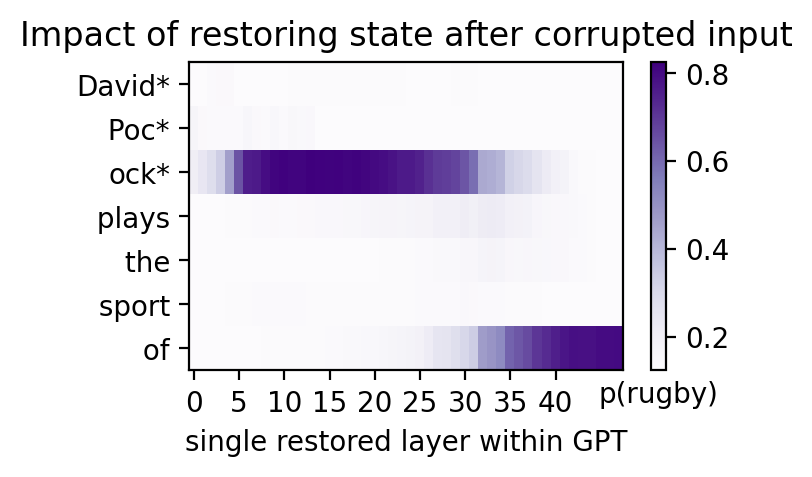

Threshold:  tensor(0.2601)

Highly Activated Neurons:
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  35  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6



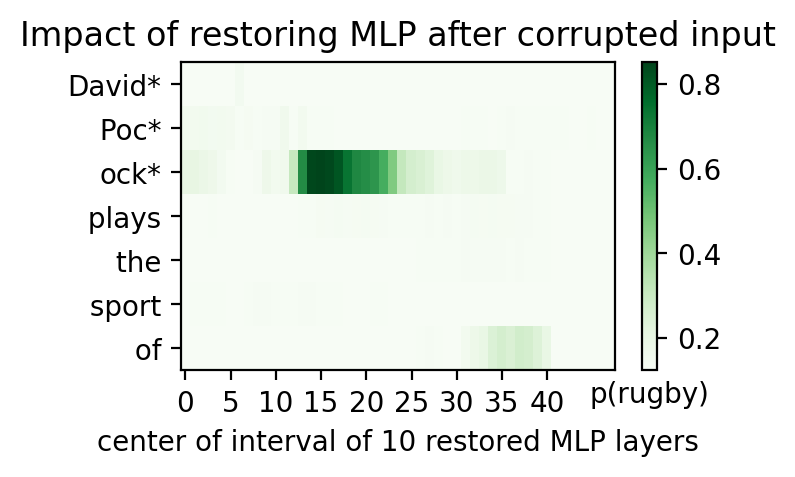

Threshold:  tensor(0.2563)

Highly Activated Neurons:
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  31  Token:  2
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



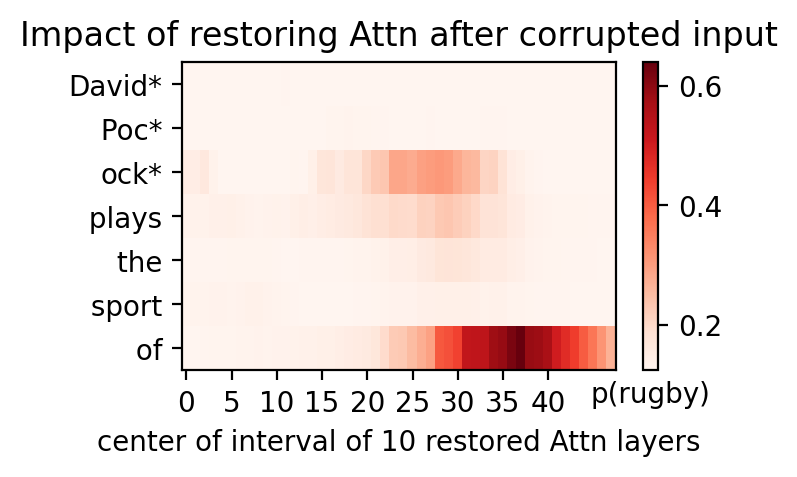

Threshold:  tensor(0.0492)

Highly Activated Neurons:
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  23  Token:  8
Layer:  24  Token:  8
Layer:  25  Token:  8
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  47  Token:  8



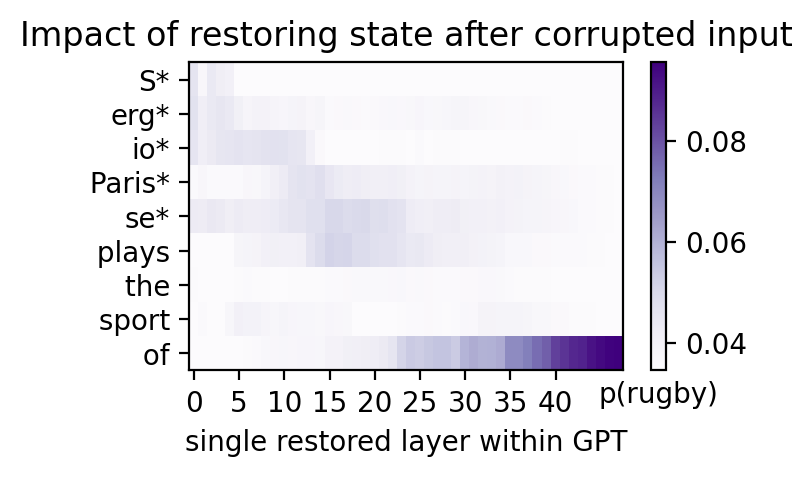

Threshold:  tensor(0.0431)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:

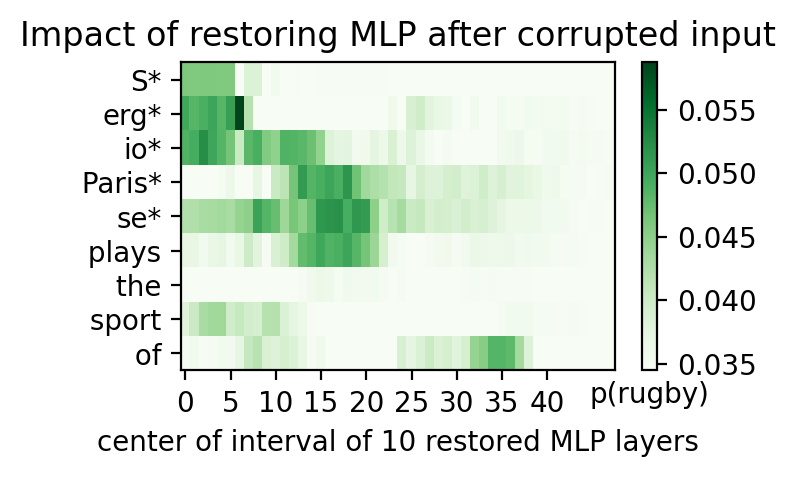

Threshold:  tensor(0.0445)

Highly Activated Neurons:
Layer:  7  Token:  2
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  10  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  9  Token:  5
Layer:  10  Token:  5
Layer:  11  Token:  5
Layer:  12  Token:  5
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  19  Token:  8
Layer:  20  Token:  8
Layer:  21  Token:  8
Layer:  22  Token:  8
Layer:  23  Token:  8
Layer:  24  Token:  8
Layer:  25  Token:  8
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Laye

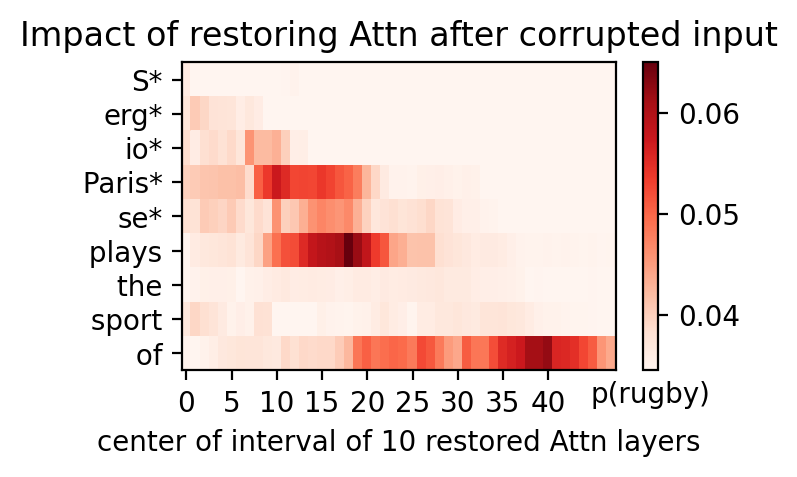

Threshold:  tensor(0.0780)

Highly Activated Neurons:
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  30  Token:  4
Layer:  31  Token:  4
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  47  Token:  8



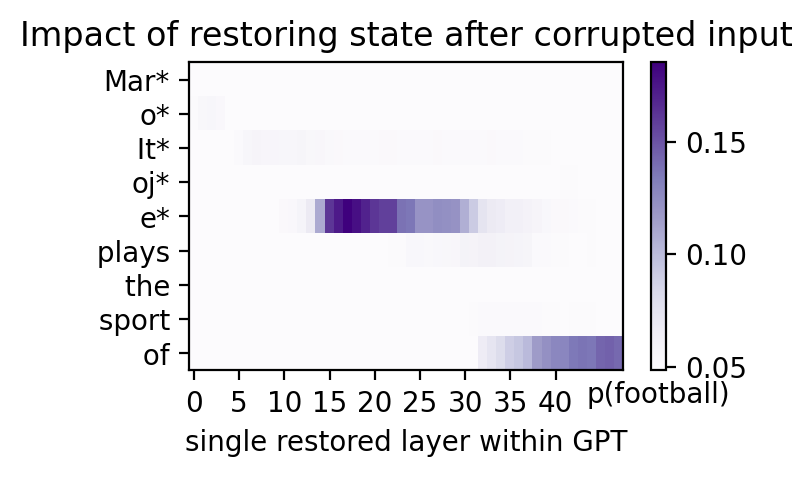

Threshold:  tensor(0.0563)

Highly Activated Neurons:
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8



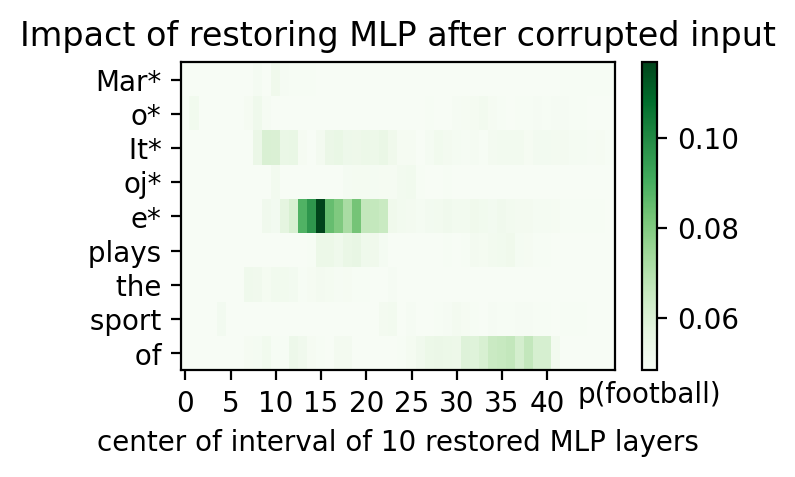

Threshold:  tensor(0.0620)

Highly Activated Neurons:
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8



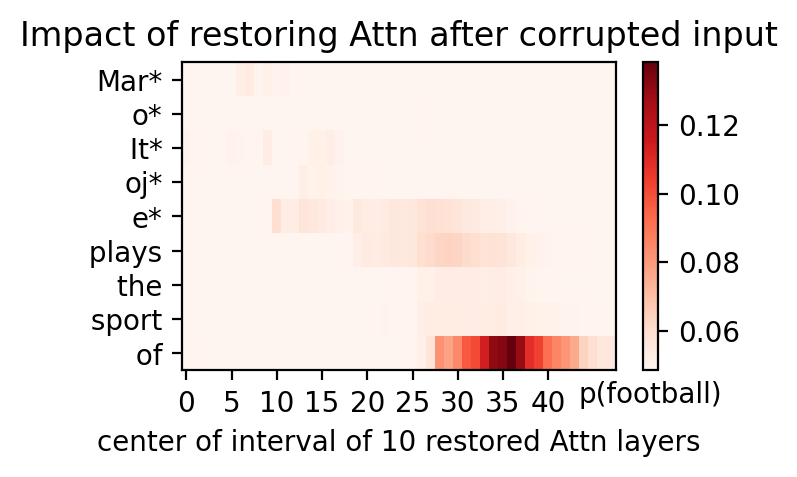

Threshold:  tensor(0.1551)

Highly Activated Neurons:
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  1
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer

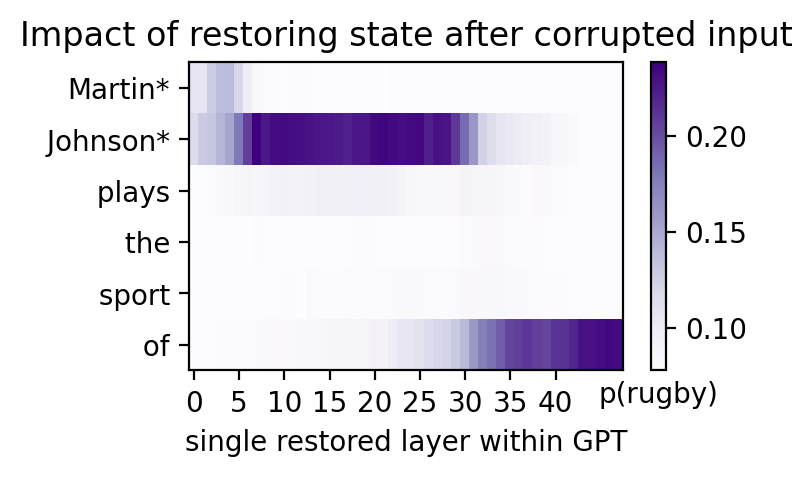

Threshold:  tensor(0.1416)

Highly Activated Neurons:
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1



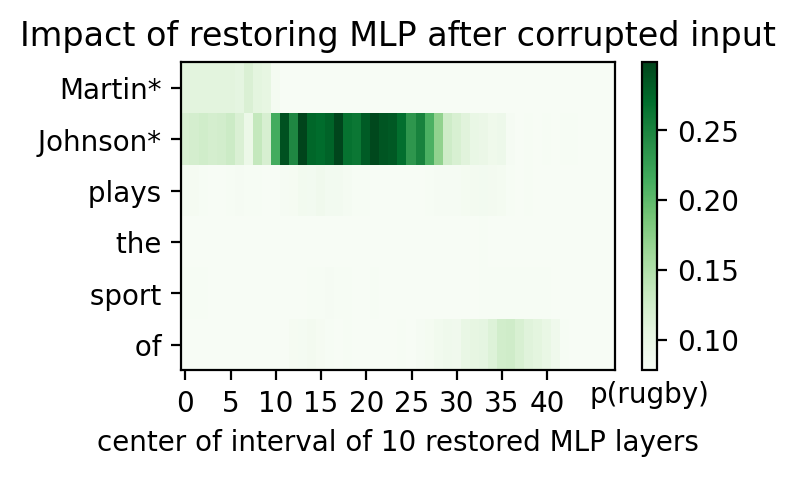

Threshold:  tensor(0.1119)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  23  Token:  5
Layer:  24  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5



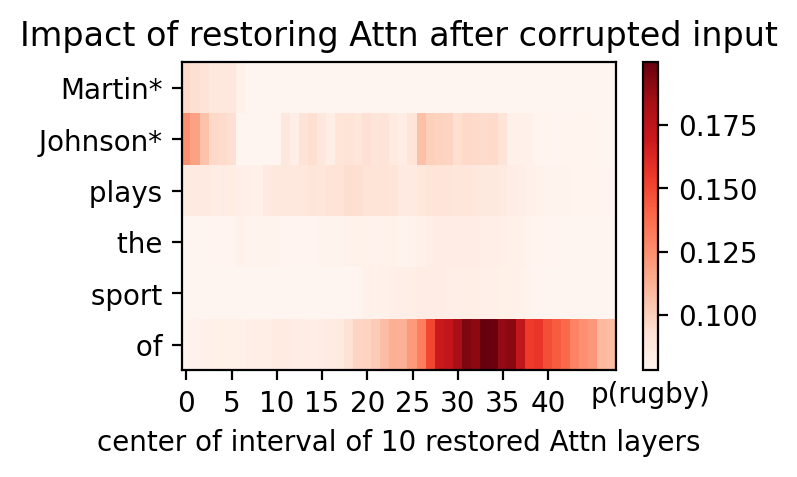

In [ ]:
prompts = [
    "Richie McCaw plays the sport of",
    "Jonny Wilkinson plays the sport of",
    "Brian O'Driscoll plays the sport of",
    "Jonah Lomu plays the sport of",
    "Dan Carter plays the sport of",
    "Alun Wyn Jones plays the sport of",
    "David Pocock plays the sport of",
    "Sergio Parisse plays the sport of",
    "Maro Itoje plays the sport of",
    "Martin Johnson plays the sport of"
]
for prompt in prompts:
    plot_all_flow(mt, prompt, noise=noise_level)

Threshold:  tensor(0.2457)

Highly Activated Neurons:
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  

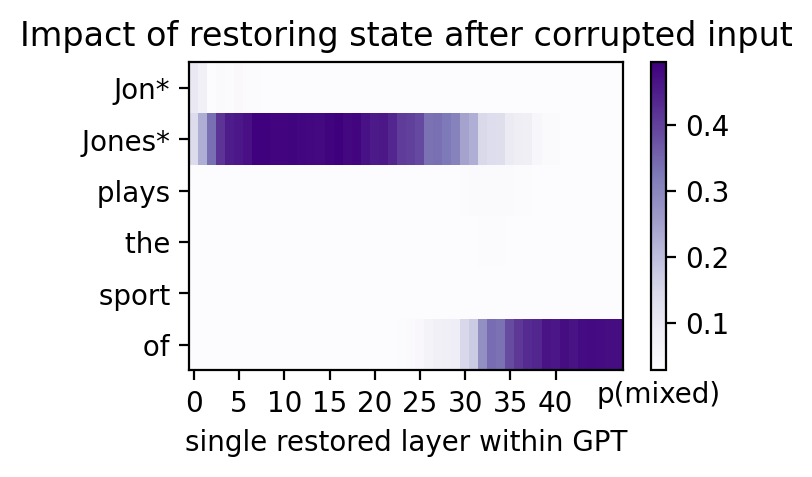

Threshold:  tensor(0.1311)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5



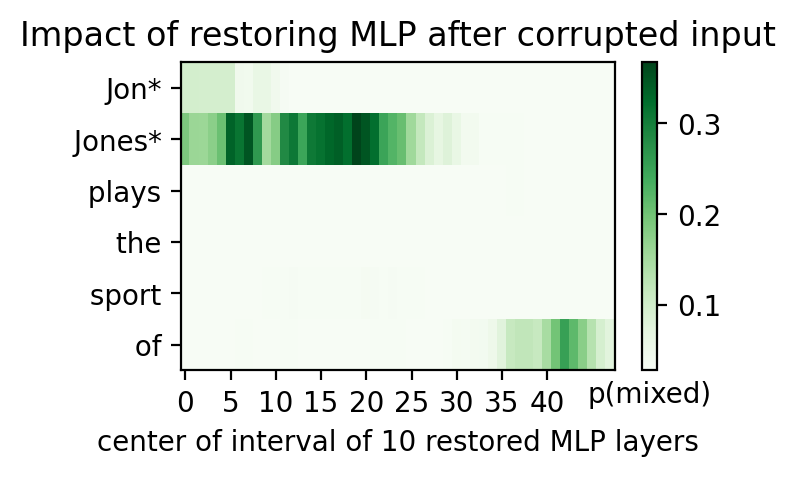

Threshold:  tensor(0.0940)

Highly Activated Neurons:
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5



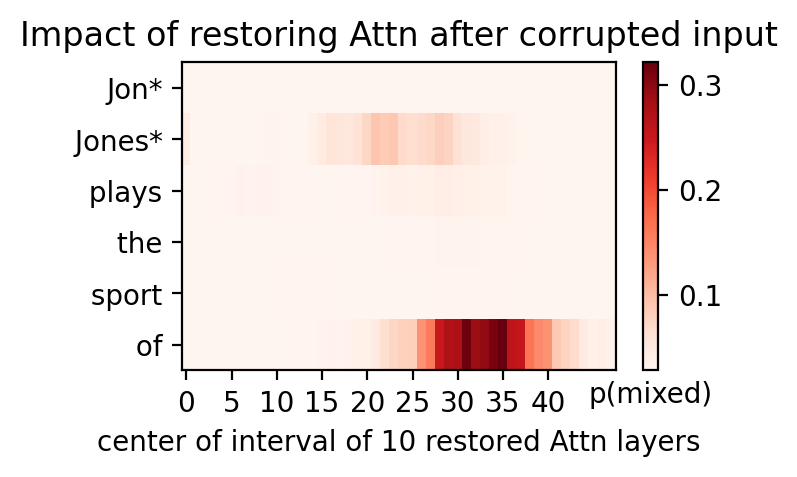

Threshold:  tensor(0.1884)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



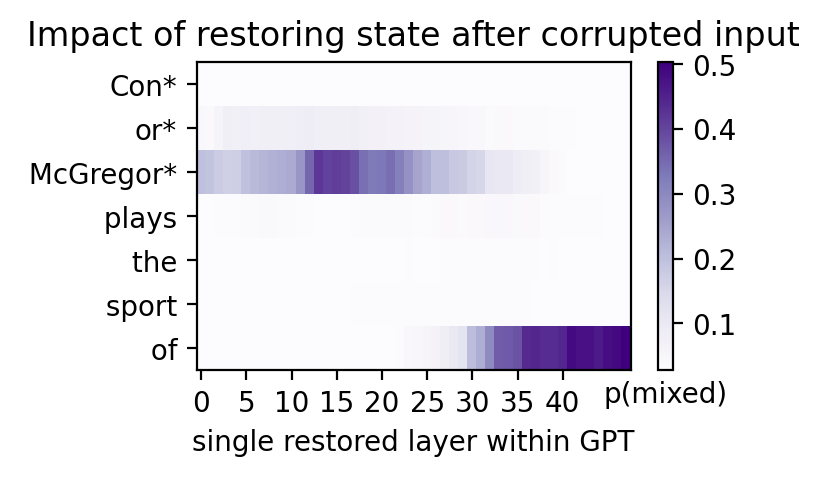

Threshold:  tensor(0.0993)

Highly Activated Neurons:
Layer:  9  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  16  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  21  Token:  2
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



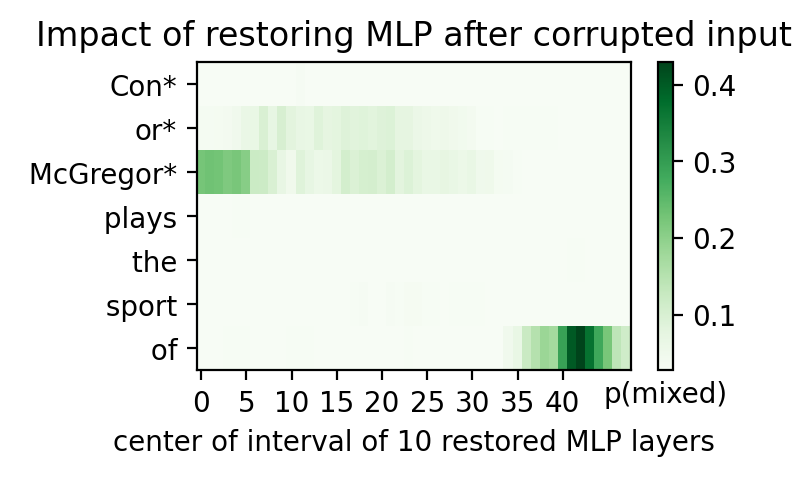

Threshold:  tensor(0.0835)

Highly Activated Neurons:
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  24  Token:  6
Layer:  25  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6



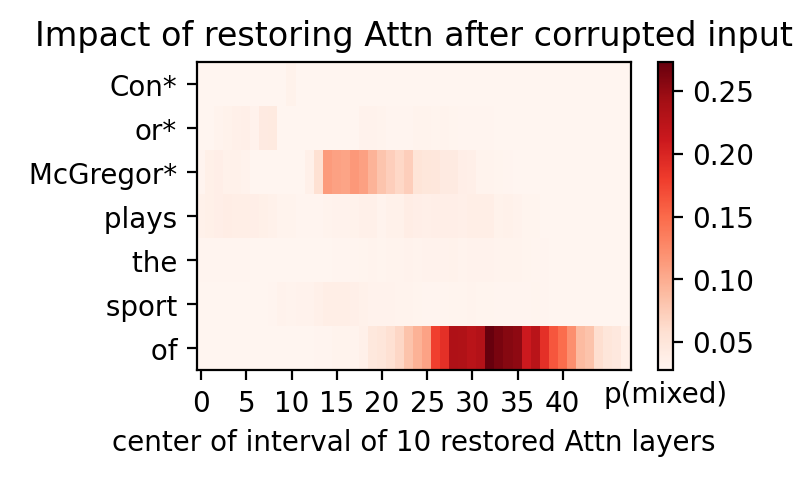

Threshold:  tensor(0.0539)

Highly Activated Neurons:
Layer:  8  Token:  6
Layer:  9  Token:  6
Layer:  10  Token:  6
Layer:  11  Token:  6
Layer:  12  Token:  6
Layer:  13  Token:  6
Layer:  14  Token:  6
Layer:  15  Token:  6
Layer:  16  Token:  6
Layer:  17  Token:  6
Layer:  18  Token:  6
Layer:  19  Token:  6
Layer:  20  Token:  6
Layer:  21  Token:  6
Layer:  22  Token:  6
Layer:  23  Token:  6
Layer:  24  Token:  6
Layer:  25  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  10
Layer:  32  Token:  10
Layer:  33  Token:  10
Layer:  34  Token:  10
Layer:  35  Token:  10
Layer:  36  Token:  10
Layer:  37  Token:  10
Layer:  38  Token:  10
Layer:  39  Token:  10
Layer:  40  Token:  10
Layer:  41  Token:  10
Layer:  42  Token:  10
Layer:  43  Token:  10
Layer:  44  Token:  10
Layer:  45  Token:  10
Layer:  46  Token:  10
Layer:  47  Token:  10



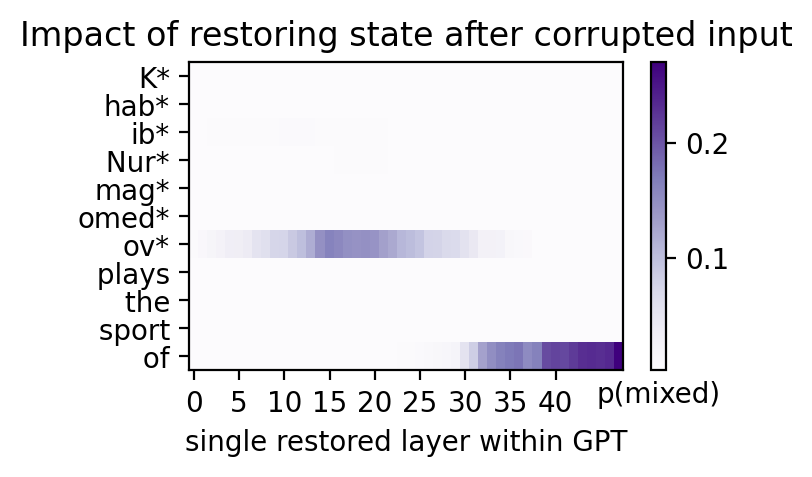

Threshold:  tensor(0.0099)

Highly Activated Neurons:
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  1  Token:  6
Layer:  2  Token:  6
Layer:  3  Token:  6
Layer:  15  Token:  6
Layer:  16  Token:  6
Layer:  17  Token:  6
Layer:  18  Token:  6
Layer:  19  Token:  6
Layer:  20  Token:  6
Layer:  21  Token:  6
Layer:  35  Token:  10
Layer:  36  Token:  10
Layer:  37  Token:  10
Layer:  38  Token:  10
Layer:  39  Token:  10
Layer:  40  Token:  10
Layer:  41  Token:  10
Layer:  42  Token:  10
Layer:  43  Token:  10
Layer:  44  Token:  10
Layer:  45  Token:  10
Layer:  46  Token:  10



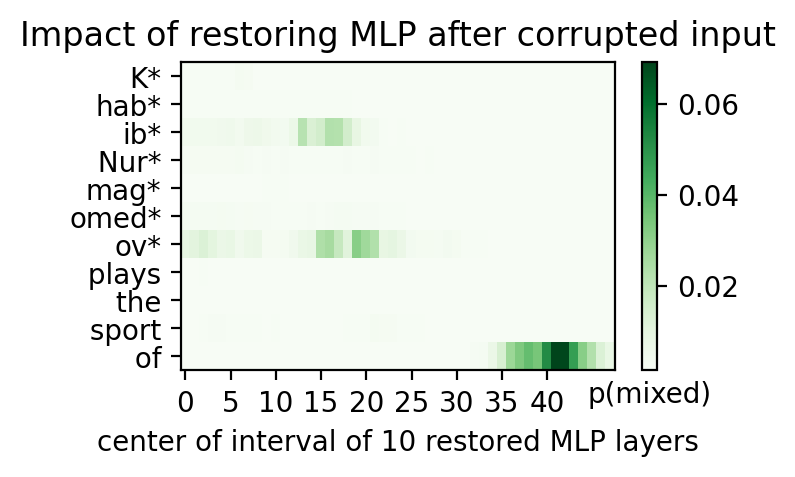

Threshold:  tensor(0.0140)

Highly Activated Neurons:
Layer:  26  Token:  10
Layer:  27  Token:  10
Layer:  28  Token:  10
Layer:  29  Token:  10
Layer:  30  Token:  10
Layer:  31  Token:  10
Layer:  32  Token:  10
Layer:  33  Token:  10
Layer:  34  Token:  10
Layer:  35  Token:  10
Layer:  36  Token:  10
Layer:  37  Token:  10
Layer:  38  Token:  10
Layer:  39  Token:  10
Layer:  40  Token:  10



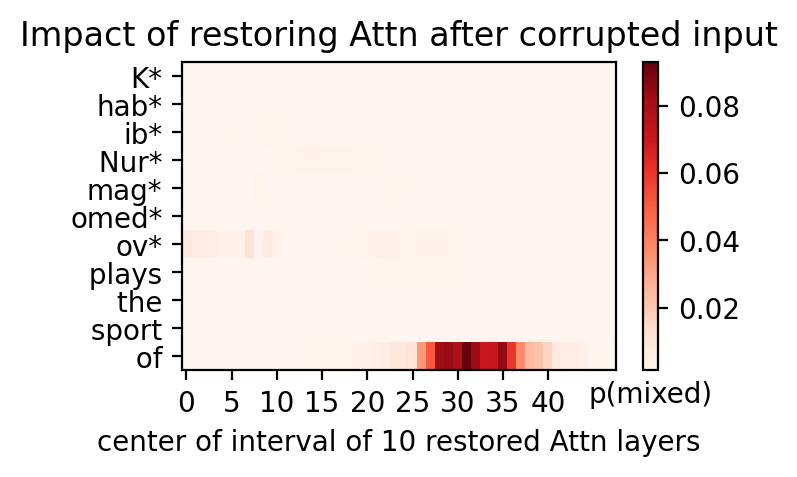

Threshold:  tensor(0.0332)

Highly Activated Neurons:
Layer:  13  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  22  Token:  5
Layer:  23  Token:  5
Layer:  24  Token:  5
Layer:  25  Token:  5
Layer:  26  Token:  5
Layer:  27  Token:  5
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9
Layer:  44  Token:  9
Layer:  45  Token:  9
Layer:  46  Token:  9
Layer:  47  Token:  9



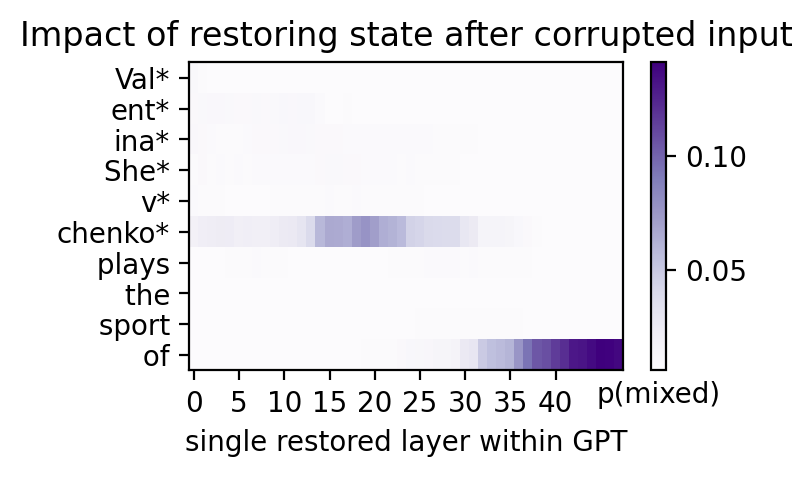

Threshold:  tensor(0.0134)

Highly Activated Neurons:
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  0  Token:  5
Layer:  1  Token:  5
Layer:  2  Token:  5
Layer:  3  Token:  5
Layer:  4  Token:  5
Layer:  5  Token:  5
Layer:  6  Token:  5
Layer:  14  Token:  5
Layer:  15  Token:  5
Layer:  16  Token:  5
Layer:  17  Token:  5
Layer:  18  Token:  5
Layer:  19  Token:  5
Layer:  20  Token:  5
Layer:  21  Token:  5
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9
Layer:  44  Token:  9
Layer:  45  Token:  9
Layer:  46  Token:  9
Layer:  47  Token:  9



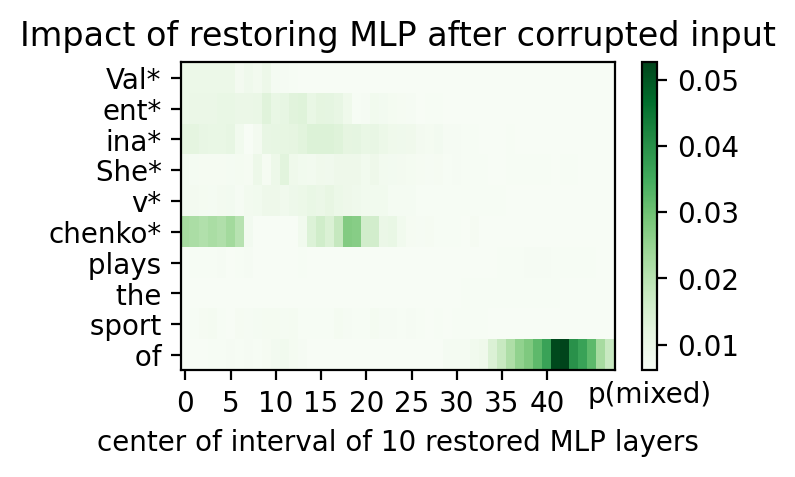

Threshold:  tensor(0.0149)

Highly Activated Neurons:
Layer:  26  Token:  9
Layer:  27  Token:  9
Layer:  28  Token:  9
Layer:  29  Token:  9
Layer:  30  Token:  9
Layer:  31  Token:  9
Layer:  32  Token:  9
Layer:  33  Token:  9
Layer:  34  Token:  9
Layer:  35  Token:  9
Layer:  36  Token:  9
Layer:  37  Token:  9
Layer:  38  Token:  9
Layer:  39  Token:  9
Layer:  40  Token:  9
Layer:  41  Token:  9
Layer:  42  Token:  9
Layer:  43  Token:  9



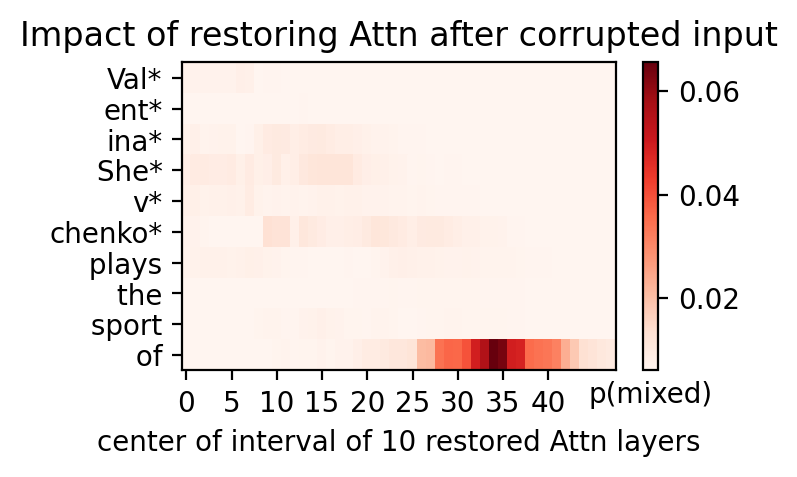

Threshold:  tensor(0.0476)

Highly Activated Neurons:
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



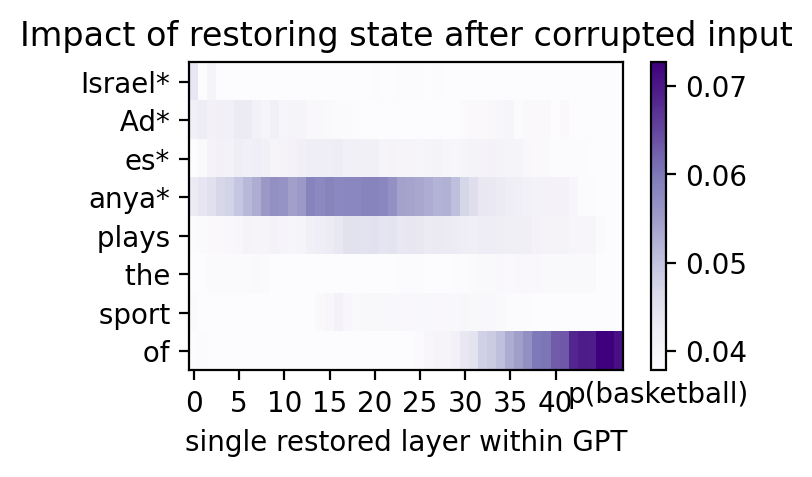

Threshold:  tensor(0.0424)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  12  Token:  1
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  21  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  7  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  17  Token: 

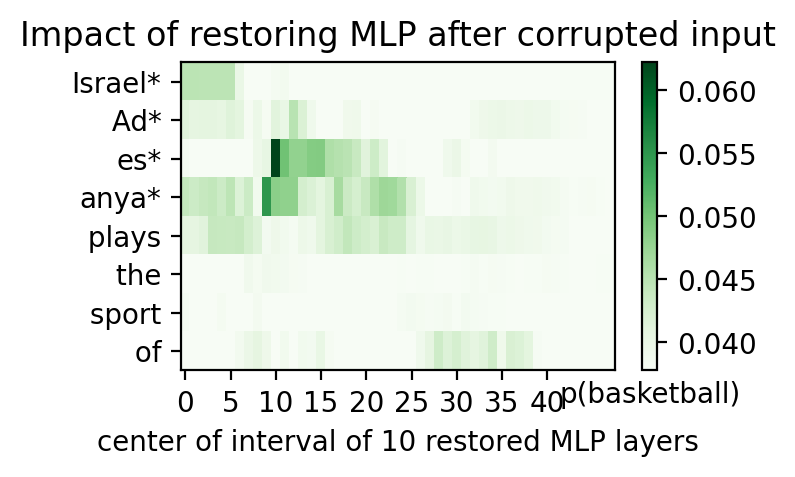

Threshold:  tensor(0.0437)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  10  Token:  2
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  7
Layer:  23  Token:  7
Layer:  25  Token:  7
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer

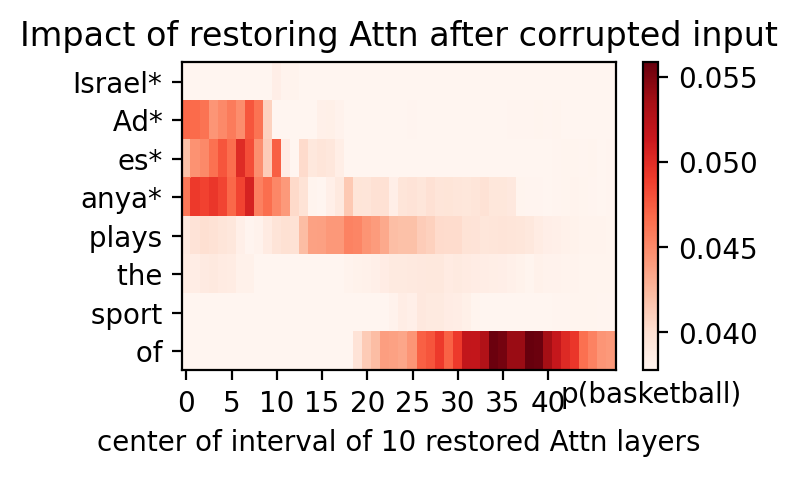

Threshold:  tensor(0.0347)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  1
Layer:  32  Token:  1
Layer:  33  Token:  1
Layer:  34  Token:  1
Layer:  35  Token:  1
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39 

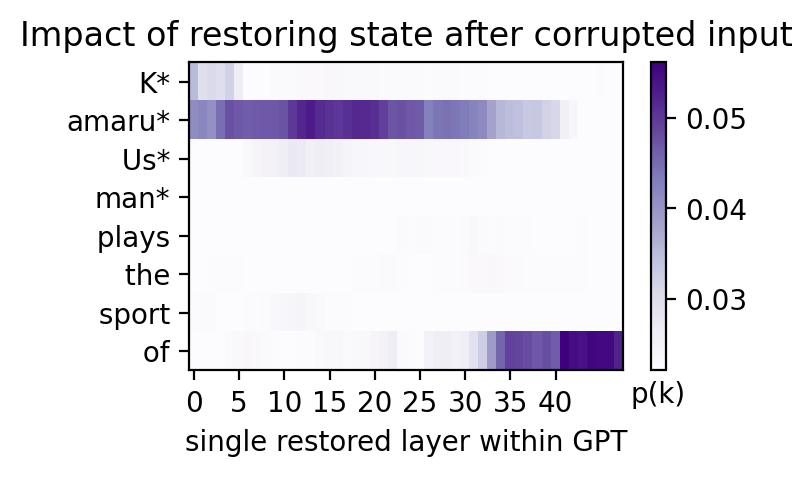

Threshold:  tensor(0.0305)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  6  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



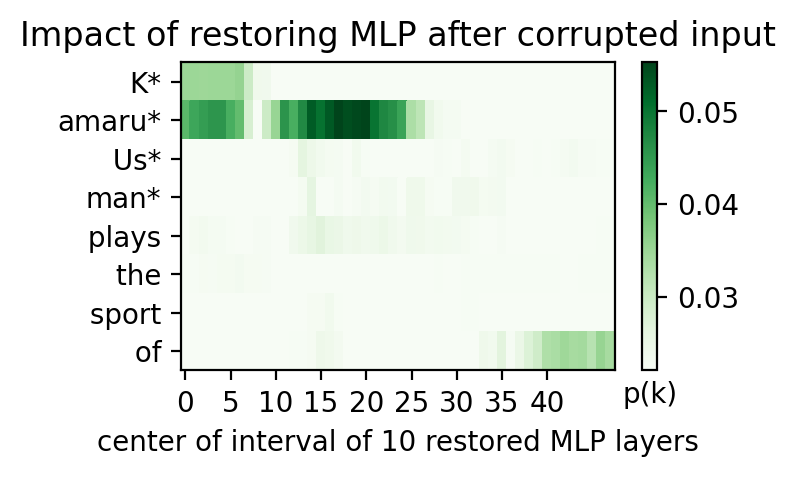

Threshold:  tensor(0.0286)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  0  Token:  3
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7



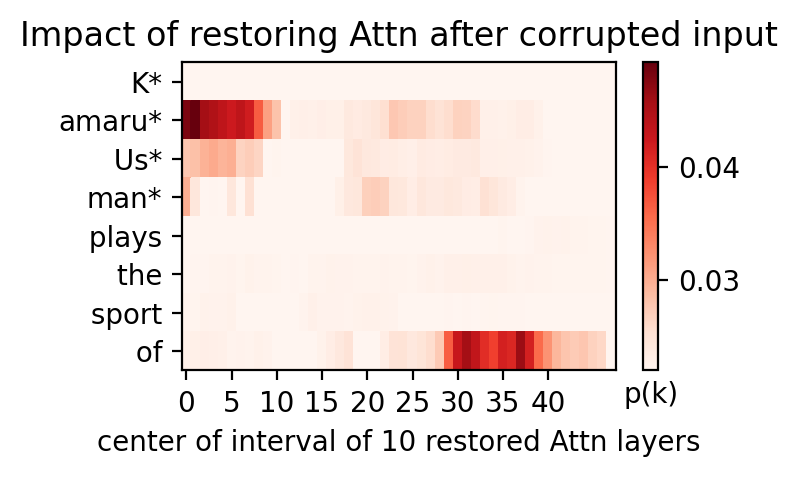

Threshold:  tensor(0.1041)

Highly Activated Neurons:
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  30  Token:  4
Layer:  31  Token:  4
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  47  Token:  8



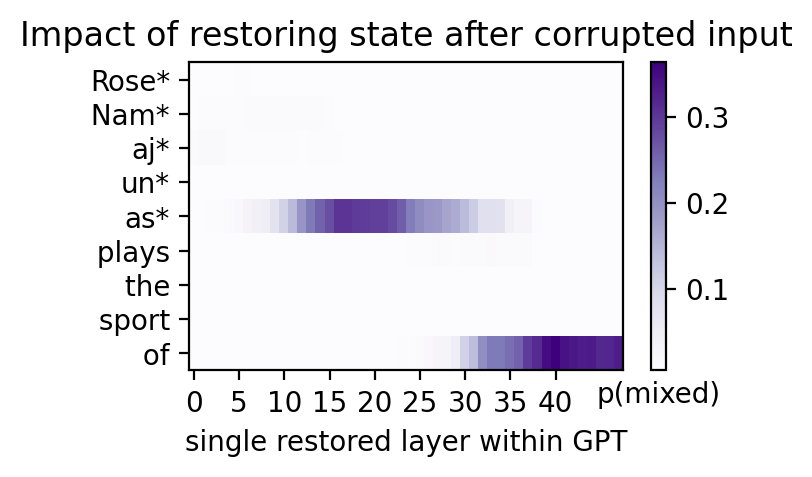

Threshold:  tensor(0.0671)

Highly Activated Neurons:
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8



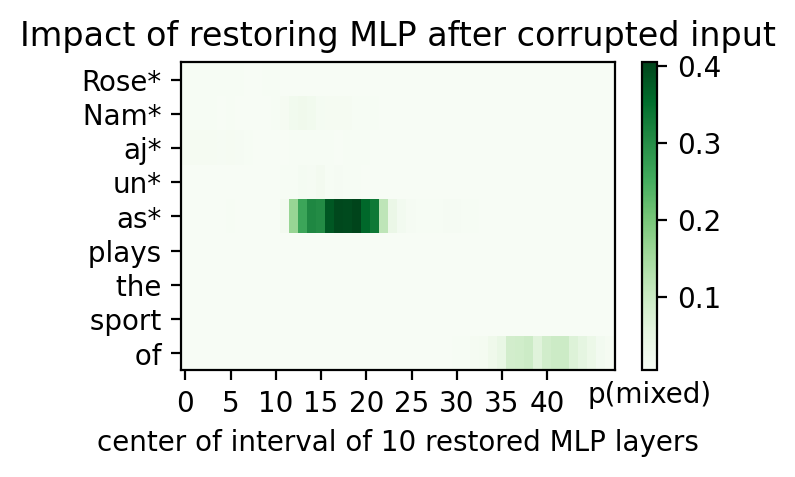

Threshold:  tensor(0.0402)

Highly Activated Neurons:
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  23  Token:  4
Layer:  25  Token:  8
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8



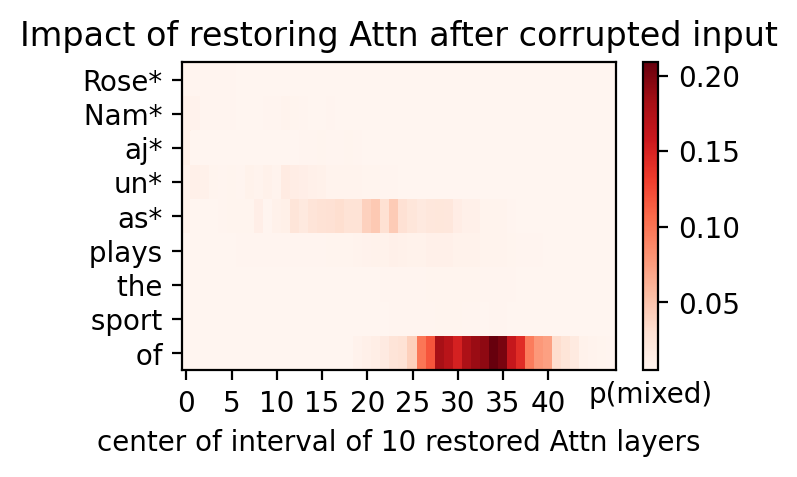

Threshold:  tensor(0.1197)

Highly Activated Neurons:
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



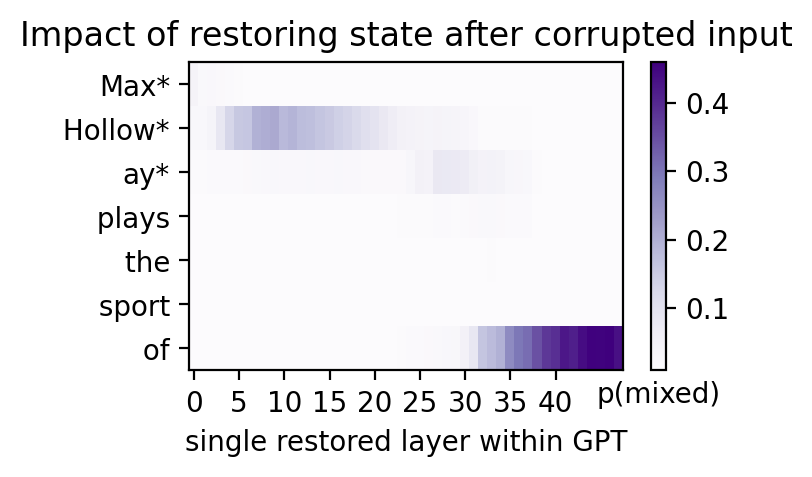

Threshold:  tensor(0.0554)

Highly Activated Neurons:
Layer:  6  Token:  1
Layer:  10  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



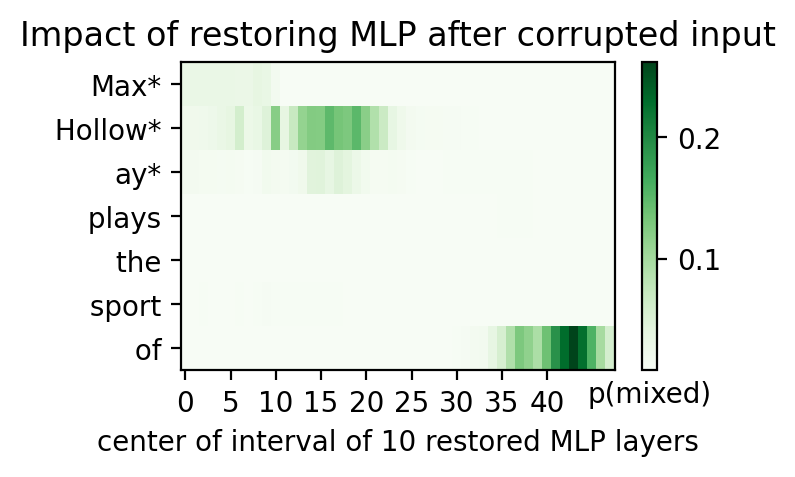

Threshold:  tensor(0.0464)

Highly Activated Neurons:
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6



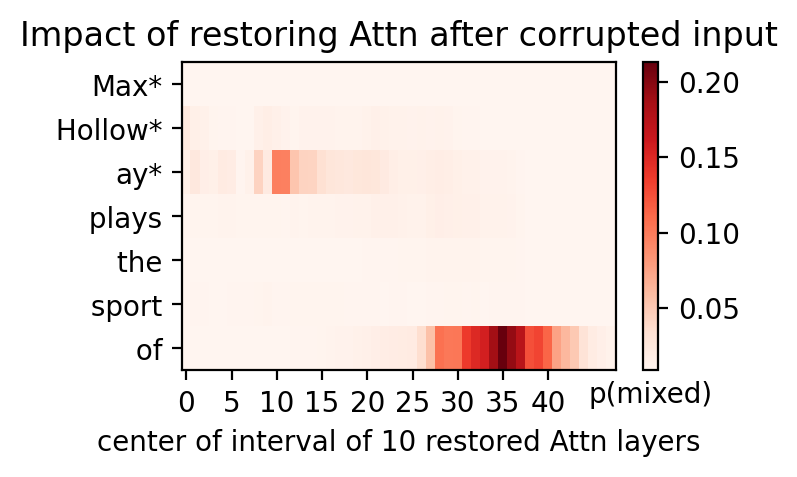

Threshold:  tensor(0.1884)

Highly Activated Neurons:
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



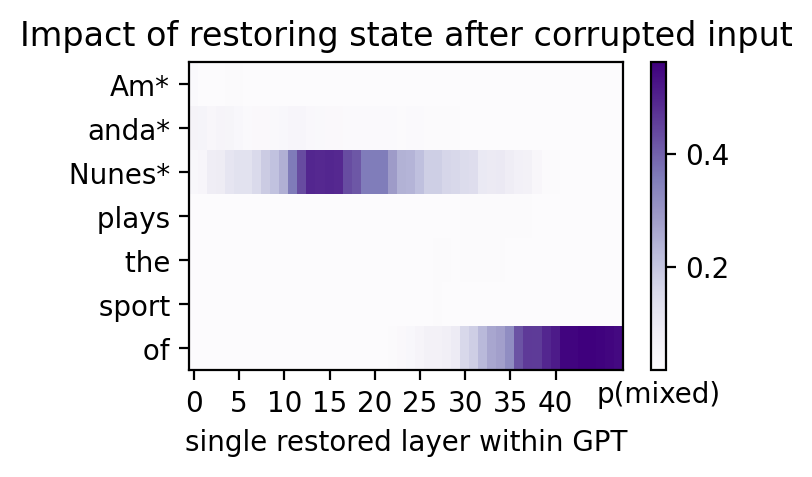

Threshold:  tensor(0.0621)

Highly Activated Neurons:
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  4  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6



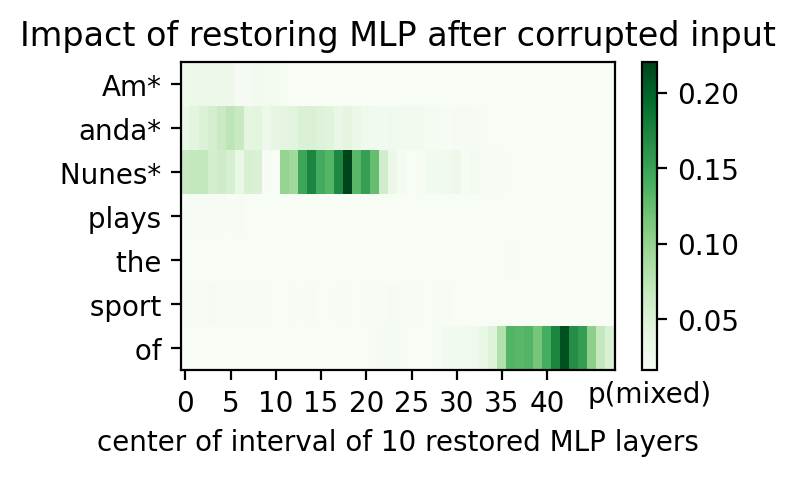

Threshold:  tensor(0.0682)

Highly Activated Neurons:
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  6
Layer:  24  Token:  6
Layer:  25  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6



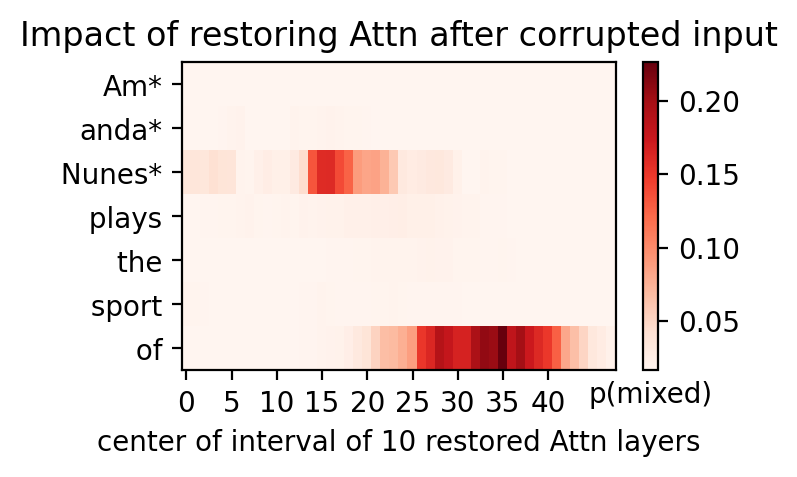

Threshold:  tensor(0.1286)

Highly Activated Neurons:
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  29  Token:  4
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46  Token:  8
Layer:  47  Token:  8



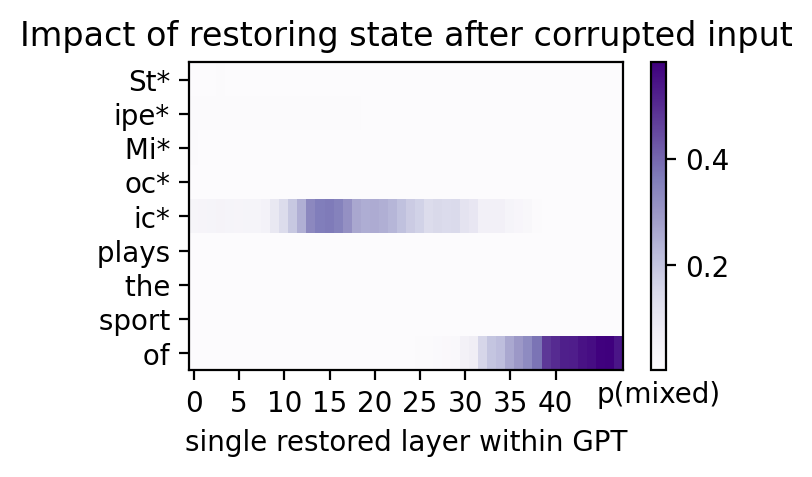

Threshold:  tensor(0.0587)

Highly Activated Neurons:
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8



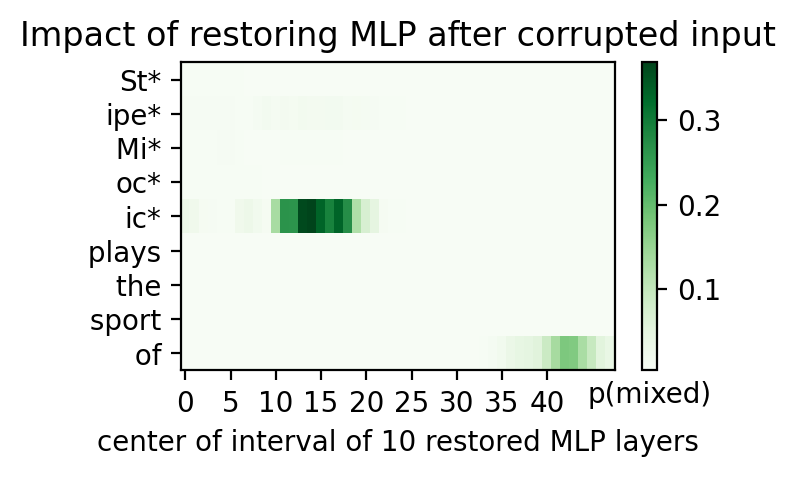

Threshold:  tensor(0.0338)

Highly Activated Neurons:
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8



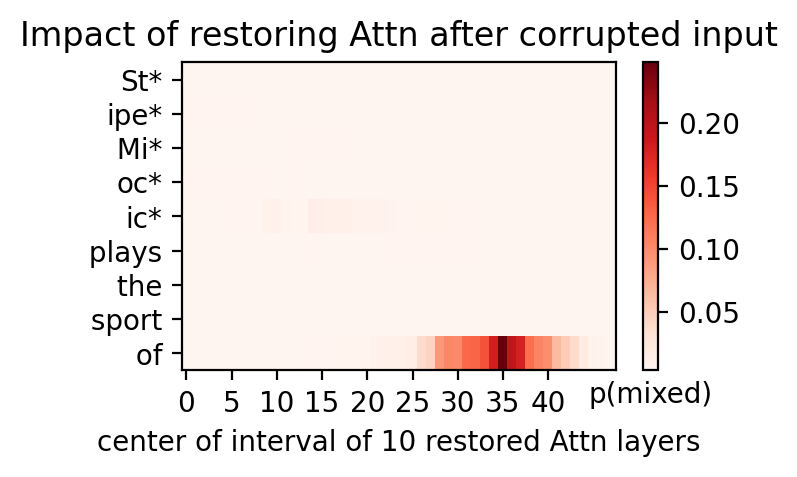

In [ ]:
prompts = [
    "Jon Jones plays the sport of",
    "Conor McGregor plays the sport of",
    "Khabib Nurmagomedov plays the sport of",
    "Valentina Shevchenko plays the sport of",
    "Israel Adesanya plays the sport of",
    "Kamaru Usman plays the sport of",
    "Rose Namajunas plays the sport of",
    "Max Holloway plays the sport of",
    "Amanda Nunes plays the sport of",
    "Stipe Miocic plays the sport of"
]
for prompt in prompts:
    plot_all_flow(mt, prompt, noise=noise_level)

Threshold:  tensor(0.3715)

Highly Activated Neurons:
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  1
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



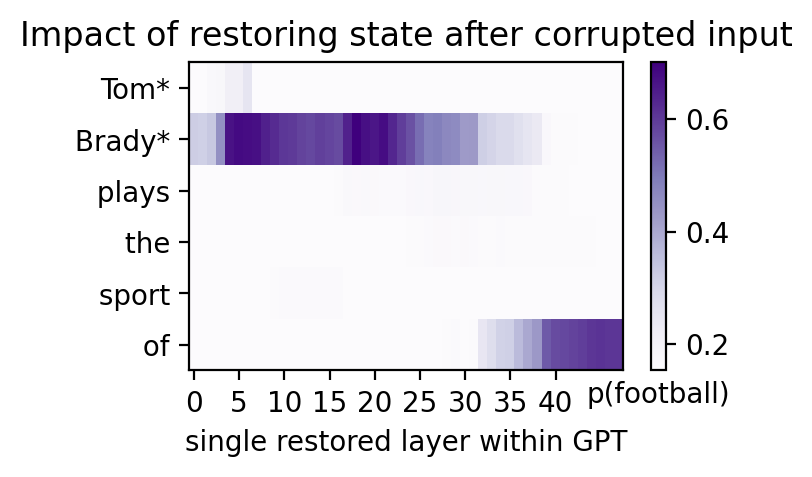

Threshold:  tensor(0.2594)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1



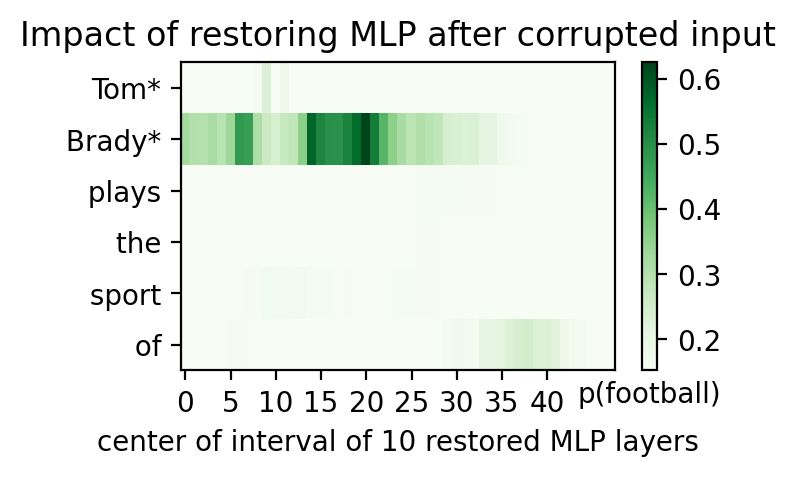

Threshold:  tensor(0.2159)

Highly Activated Neurons:
Layer:  18  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5



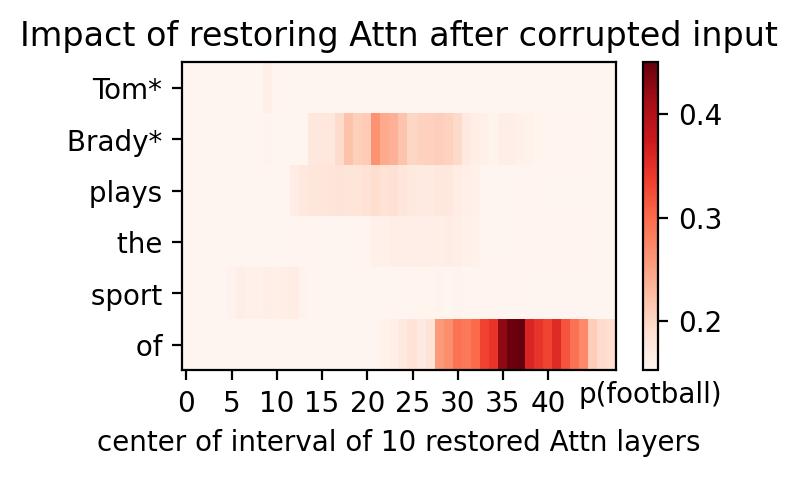

Threshold:  tensor(0.3559)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  1
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



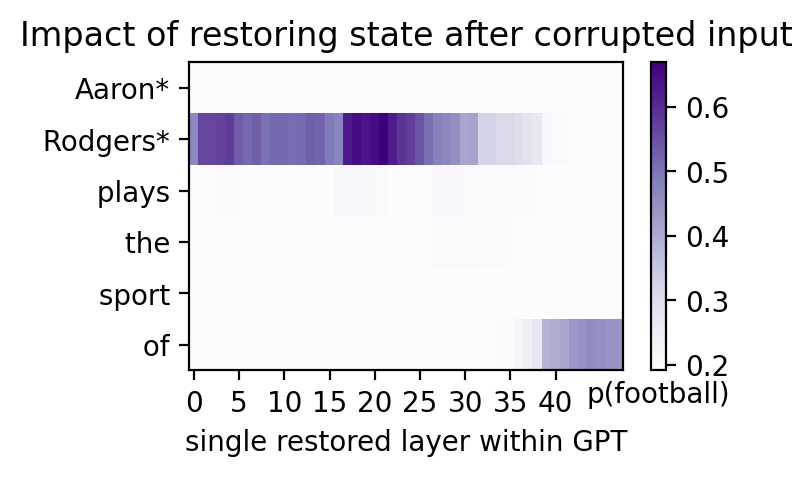

Threshold:  tensor(0.2840)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1



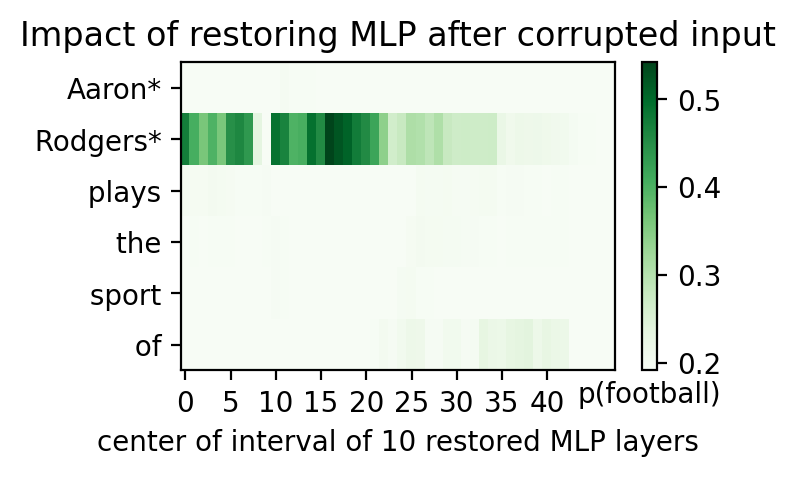

Threshold:  tensor(0.2313)

Highly Activated Neurons:
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  25  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5



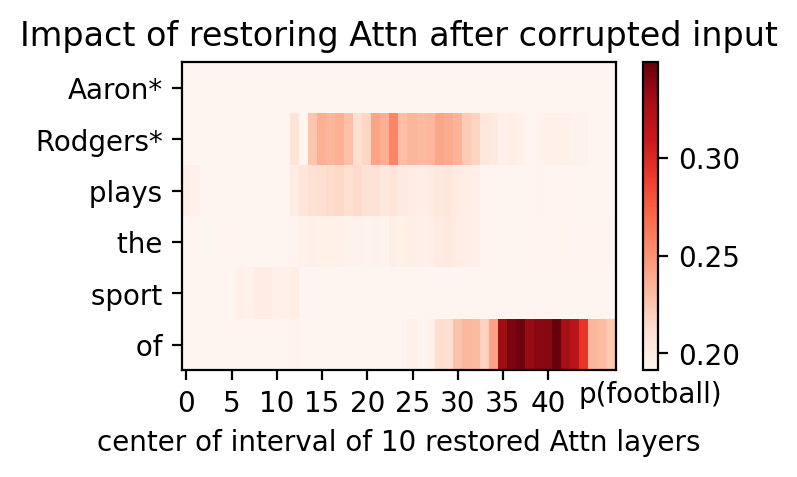

Threshold:  tensor(0.4074)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  31  Token:  1
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



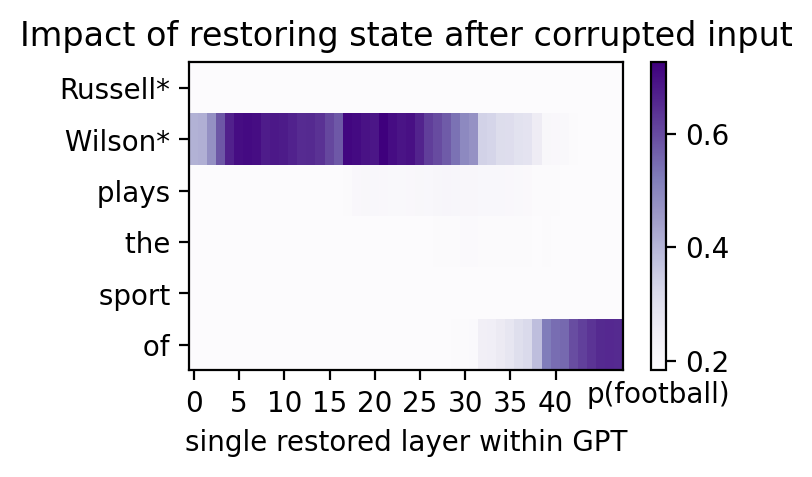

Threshold:  tensor(0.2902)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1



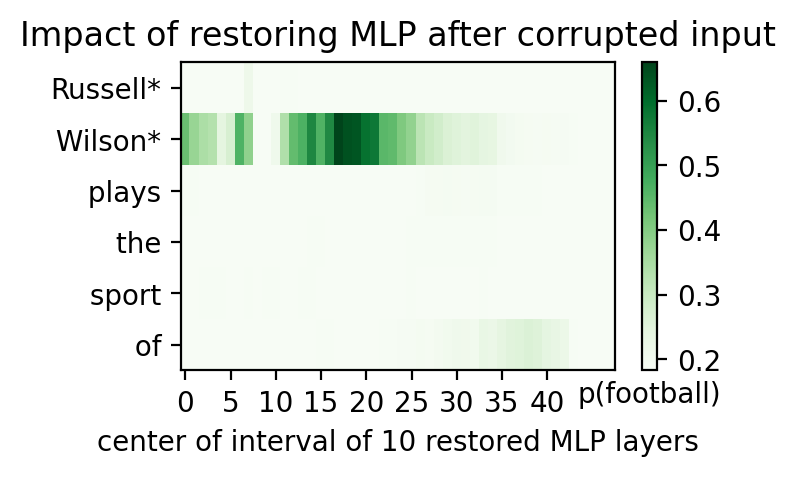

Threshold:  tensor(0.2430)

Highly Activated Neurons:
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  28  Token:  1
Layer:  29  Token:  1
Layer:  30  Token:  1
Layer:  28  Token:  5
Layer:  29  Token:  5
Layer:  30  Token:  5
Layer:  31  Token:  5
Layer:  32  Token:  5
Layer:  33  Token:  5
Layer:  34  Token:  5
Layer:  35  Token:  5
Layer:  36  Token:  5
Layer:  37  Token:  5
Layer:  38  Token:  5
Layer:  39  Token:  5
Layer:  40  Token:  5
Layer:  41  Token:  5
Layer:  42  Token:  5
Layer:  43  Token:  5
Layer:  44  Token:  5
Layer:  45  Token:  5
Layer:  46  Token:  5
Layer:  47  Token:  5



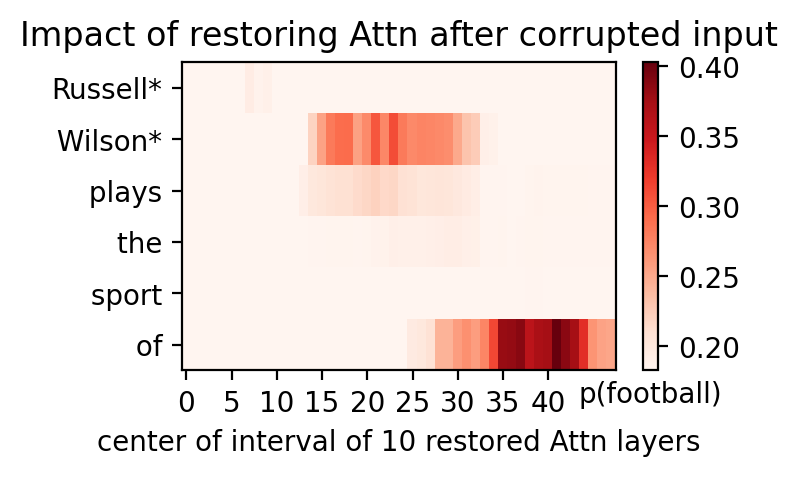

Threshold:  tensor(0.2636)

Highly Activated Neurons:
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



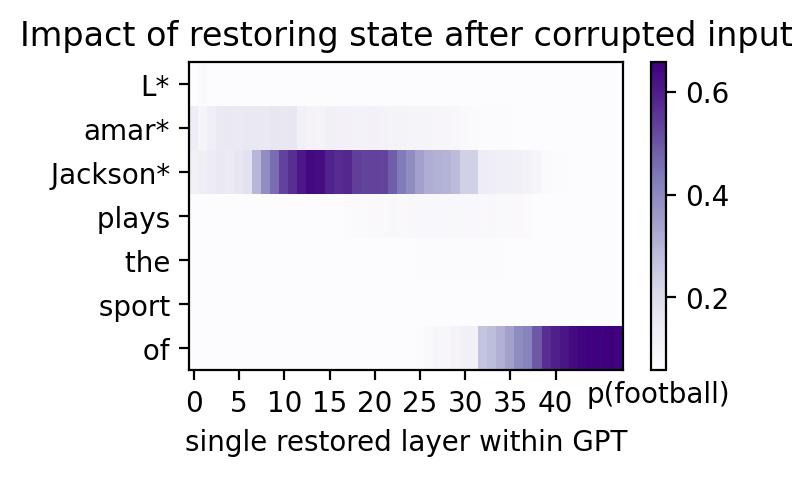

Threshold:  tensor(0.1151)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6



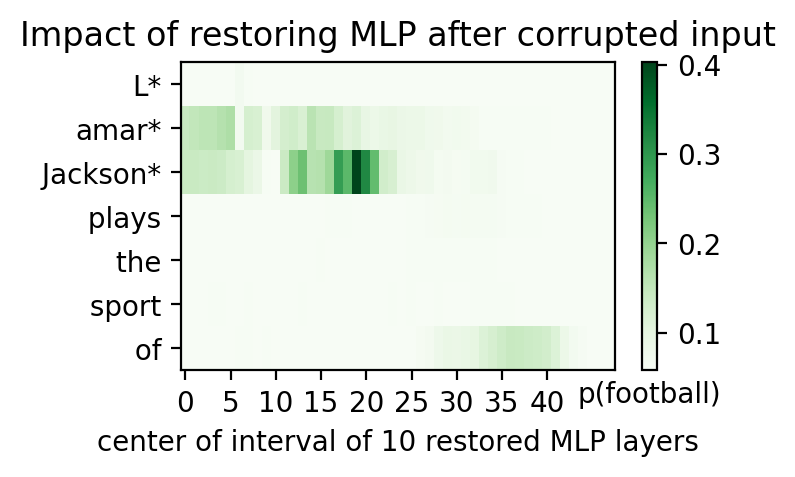

Threshold:  tensor(0.1168)

Highly Activated Neurons:
Layer:  17  Token:  2
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6



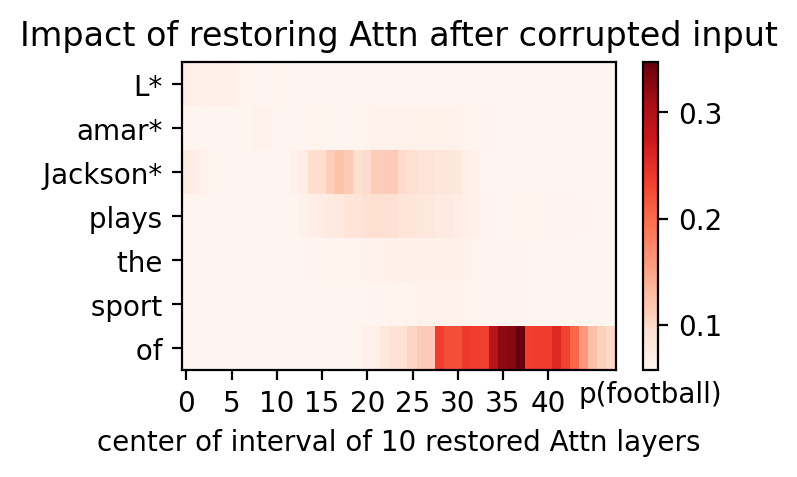

Threshold:  tensor(0.2821)

Highly Activated Neurons:
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



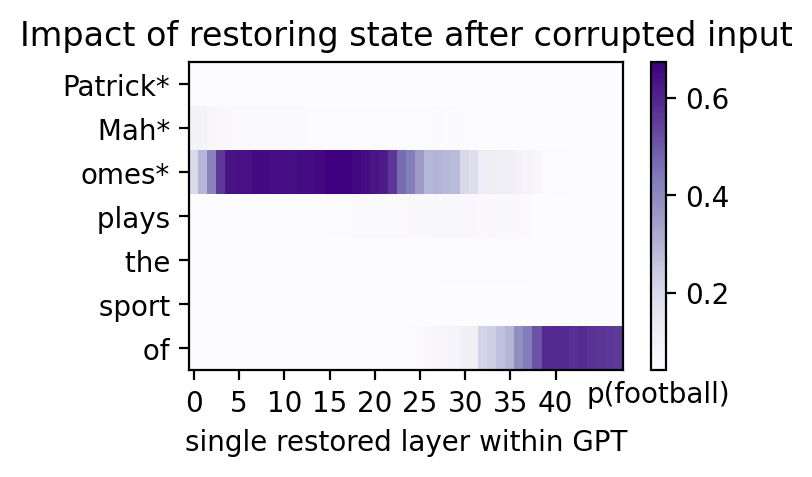

Threshold:  tensor(0.1819)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  6  Token:  2
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2



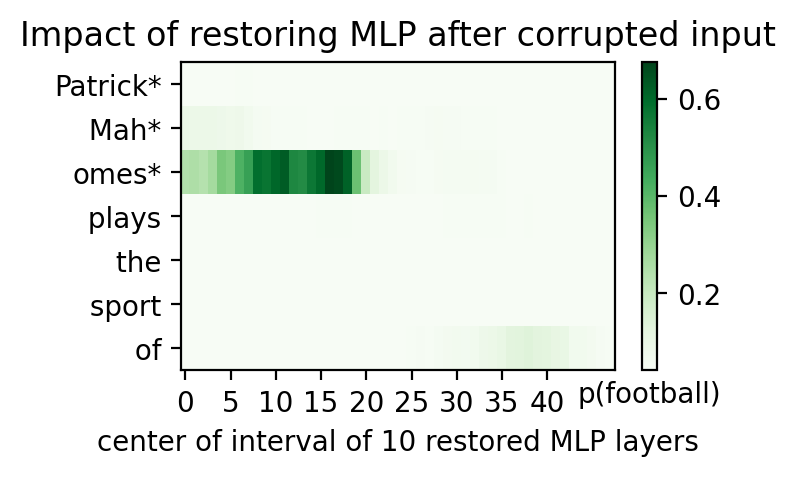

Threshold:  tensor(0.0836)

Highly Activated Neurons:
Layer:  25  Token:  6
Layer:  26  Token:  6
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6



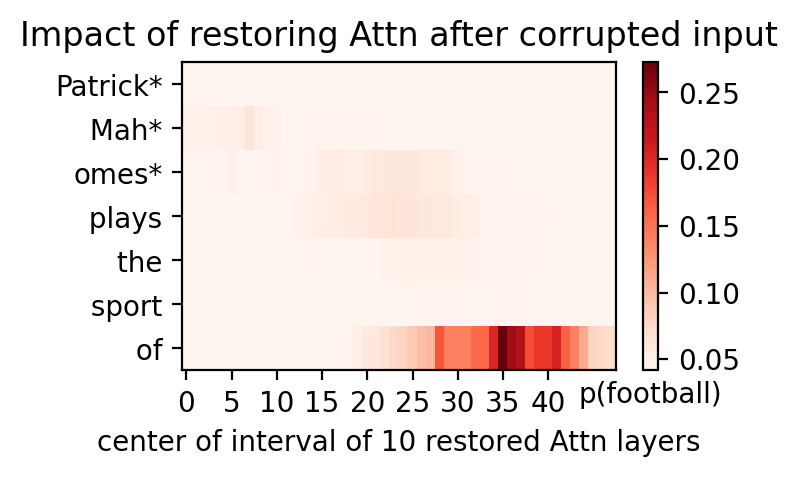

Threshold:  tensor(0.1842)

Highly Activated Neurons:
Layer:  7  Token:  2
Layer:  8  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  24  Token:  2
Layer:  25  Token:  2
Layer:  26  Token:  2
Layer:  27  Token:  2
Layer:  28  Token:  2
Layer:  29  Token:  2
Layer:  30  Token:  2
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



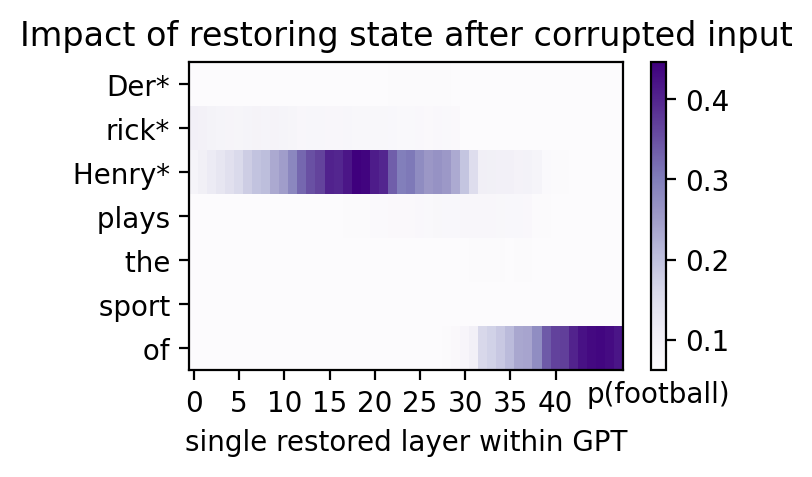

Threshold:  tensor(0.1022)

Highly Activated Neurons:
Layer:  16  Token:  1
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  21  Token:  2
Layer:  22  Token:  2
Layer:  23  Token:  2
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6



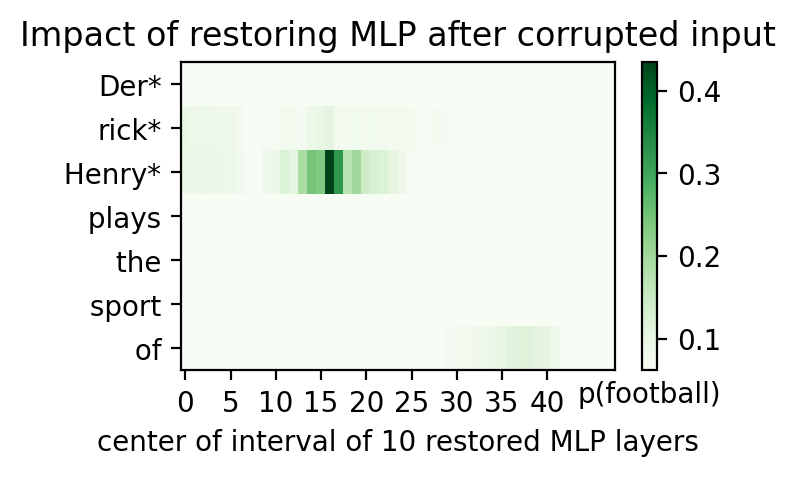

Threshold:  tensor(0.0952)

Highly Activated Neurons:
Layer:  27  Token:  6
Layer:  28  Token:  6
Layer:  29  Token:  6
Layer:  30  Token:  6
Layer:  31  Token:  6
Layer:  32  Token:  6
Layer:  33  Token:  6
Layer:  34  Token:  6
Layer:  35  Token:  6
Layer:  36  Token:  6
Layer:  37  Token:  6
Layer:  38  Token:  6
Layer:  39  Token:  6
Layer:  40  Token:  6
Layer:  41  Token:  6
Layer:  42  Token:  6
Layer:  43  Token:  6
Layer:  44  Token:  6
Layer:  45  Token:  6
Layer:  46  Token:  6
Layer:  47  Token:  6



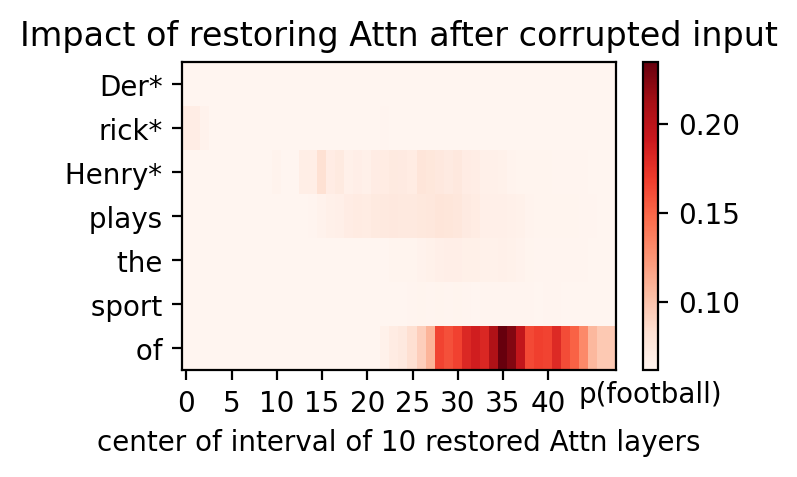

Threshold:  tensor(0.1607)

Highly Activated Neurons:
Layer:  0  Token:  4
Layer:  1  Token:  4
Layer:  2  Token:  4
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  9  Token:  4
Layer:  10  Token:  4
Layer:  11  Token:  4
Layer:  12  Token:  4
Layer:  13  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  23  Token:  4
Layer:  24  Token:  4
Layer:  25  Token:  4
Layer:  26  Token:  4
Layer:  27  Token:  4
Layer:  28  Token:  4
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8
Layer:  46

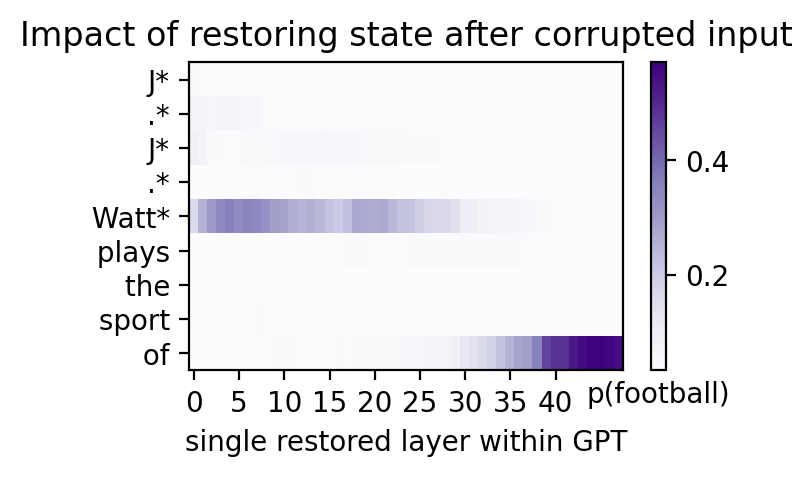

Threshold:  tensor(0.0792)

Highly Activated Neurons:
Layer:  0  Token:  2
Layer:  1  Token:  2
Layer:  2  Token:  2
Layer:  3  Token:  2
Layer:  4  Token:  2
Layer:  5  Token:  2
Layer:  0  Token:  4
Layer:  1  Token:  4
Layer:  2  Token:  4
Layer:  3  Token:  4
Layer:  4  Token:  4
Layer:  5  Token:  4
Layer:  6  Token:  4
Layer:  7  Token:  4
Layer:  8  Token:  4
Layer:  14  Token:  4
Layer:  15  Token:  4
Layer:  17  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  21  Token:  4
Layer:  22  Token:  4
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8



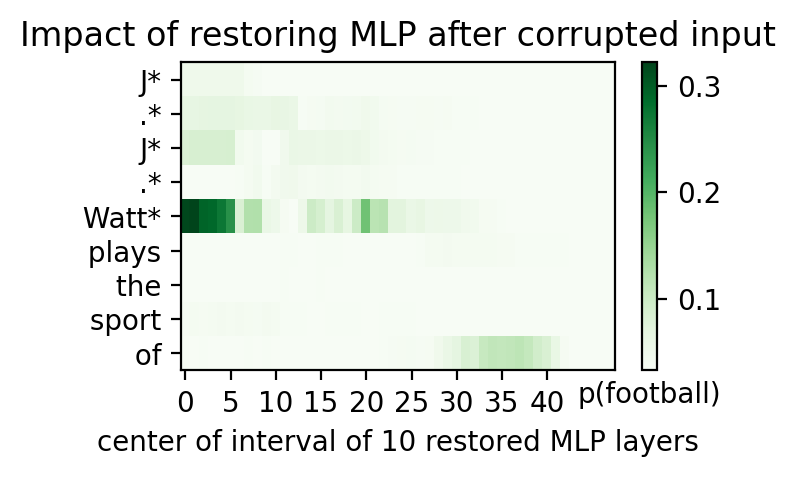

Threshold:  tensor(0.0541)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  7  Token:  3
Layer:  0  Token:  4
Layer:  1  Token:  4
Layer:  2  Token:  4
Layer:  3  Token:  4
Layer:  15  Token:  4
Layer:  16  Token:  4
Layer:  17  Token:  4
Layer:  18  Token:  4
Layer:  19  Token:  4
Layer:  20  Token:  4
Layer:  25  Token:  8
Layer:  26  Token:  8
Layer:  27  Token:  8
Layer:  28  Token:  8
Layer:  29  Token:  8
Layer:  30  Token:  8
Layer:  31  Token:  8
Layer:  32  Token:  8
Layer:  33  Token:  8
Layer:  34  Token:  8
Layer:  35  Token:  8
Layer:  36  Token:  8
Layer:  37  Token:  8
Layer:  38  Token:  8
Layer:  39  Token:  8
Layer:  40  Token:  8
Layer:  41  Token:  8
Layer:  42  Token:  8
Layer:  43  Token:  8
Layer:  44  Token:  8
Layer:  45  Token:  8



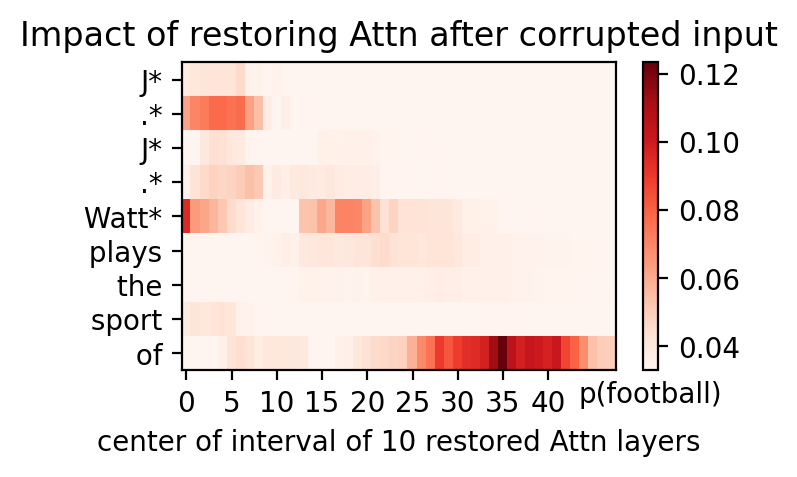

Threshold:  tensor(0.1463)

Highly Activated Neurons:
Layer:  13  Token:  2
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  9  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer: 

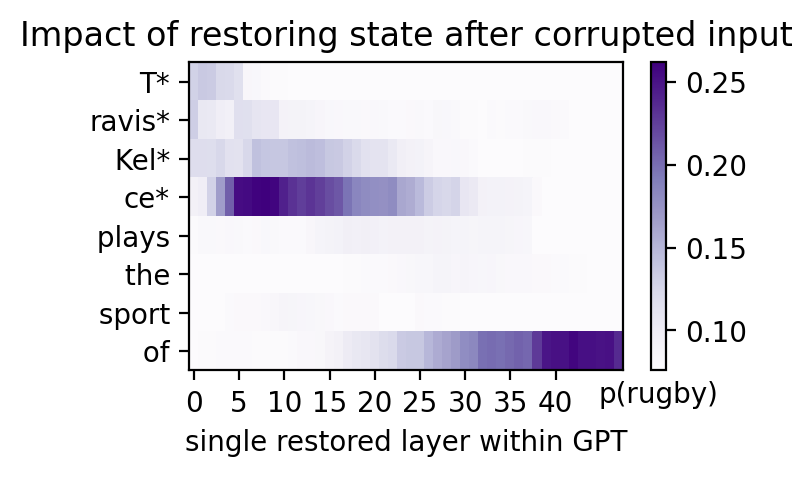

Threshold:  tensor(0.1237)

Highly Activated Neurons:
Layer:  0  Token:  0
Layer:  1  Token:  0
Layer:  2  Token:  0
Layer:  3  Token:  0
Layer:  4  Token:  0
Layer:  5  Token:  0
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7



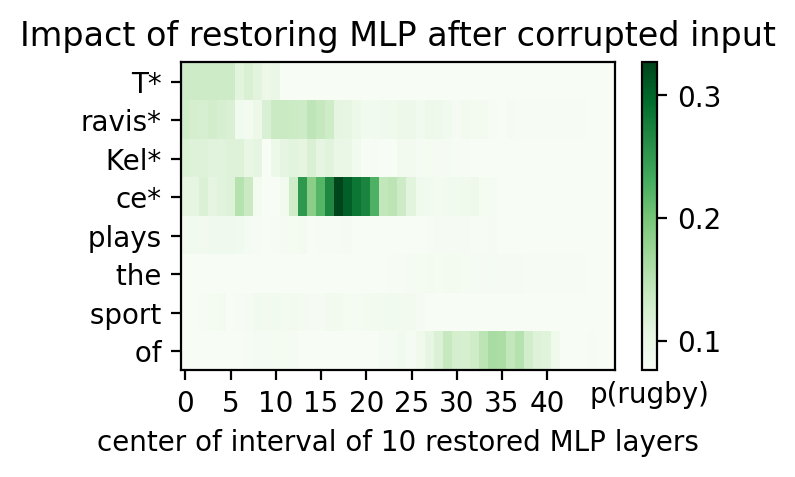

Threshold:  tensor(0.1009)

Highly Activated Neurons:
Layer:  1  Token:  2
Layer:  5  Token:  2
Layer:  9  Token:  2
Layer:  10  Token:  2
Layer:  11  Token:  2
Layer:  12  Token:  2
Layer:  13  Token:  2
Layer:  14  Token:  2
Layer:  15  Token:  2
Layer:  16  Token:  2
Layer:  17  Token:  2
Layer:  18  Token:  2
Layer:  19  Token:  2
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  16  Token:  4
Layer:  14  Token:  7
Layer:  15  Token:  7
Layer:  16  Token:  7
Layer:  17  Token:  7
Layer:  18  Token:  7
Layer:  19  Token:  7
Layer:  20  Token:  7
Layer:  21  Token:  7
Layer:  22  Token:  7
Layer:  23  Token:  7
Layer:  24  Token:  7
Layer:  25  Token:  7
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Lay

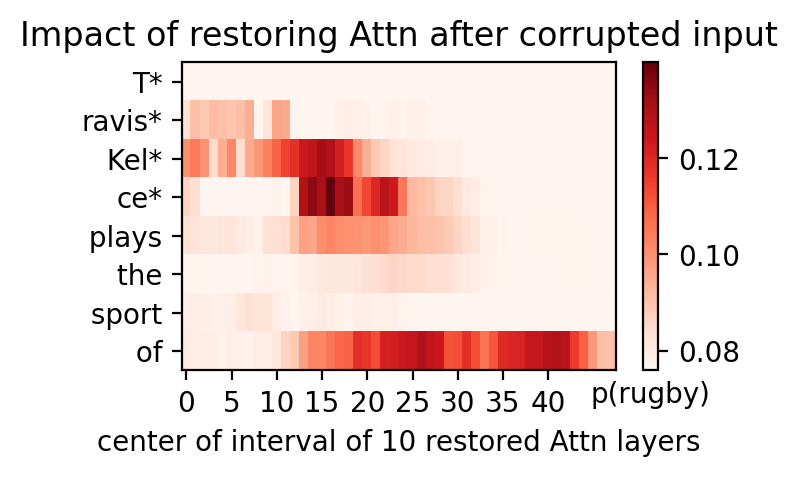

Threshold:  tensor(0.1906)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  7  Token:  1
Layer:  8  Token:  1
Layer:  9  Token:  1
Layer:  10  Token:  1
Layer:  11  Token:  1
Layer:  12  Token:  1
Layer:  13  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  26  Token:  3
Layer:  27  Token:  3
Layer:  28  Token:  3
Layer:  29  Token:  3
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35

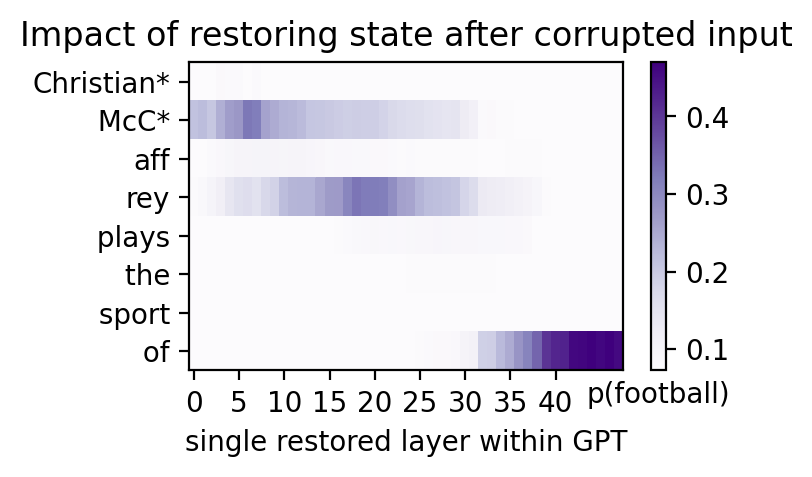

Threshold:  tensor(0.1136)

Highly Activated Neurons:
Layer:  0  Token:  1
Layer:  1  Token:  1
Layer:  2  Token:  1
Layer:  3  Token:  1
Layer:  4  Token:  1
Layer:  5  Token:  1
Layer:  6  Token:  1
Layer:  11  Token:  1
Layer:  14  Token:  1
Layer:  15  Token:  1
Layer:  16  Token:  1
Layer:  17  Token:  1
Layer:  18  Token:  1
Layer:  19  Token:  1
Layer:  20  Token:  1
Layer:  21  Token:  1
Layer:  22  Token:  1
Layer:  23  Token:  1
Layer:  24  Token:  1
Layer:  25  Token:  1
Layer:  26  Token:  1
Layer:  27  Token:  1
Layer:  29  Token:  1
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7



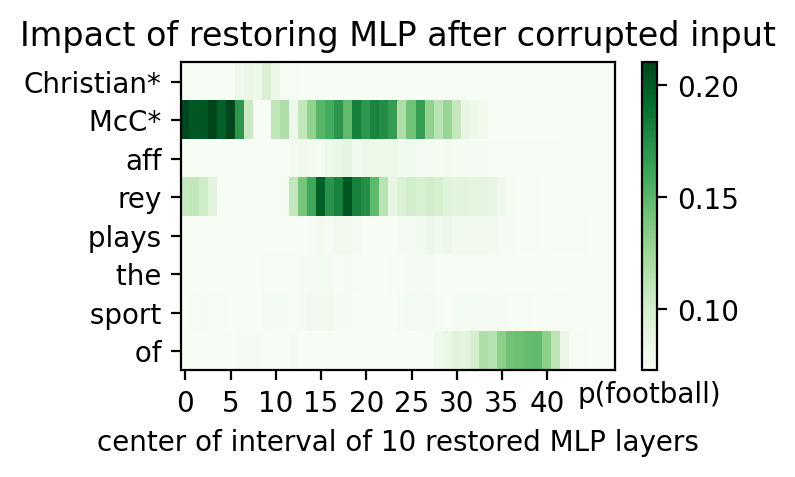

Threshold:  tensor(0.1291)

Highly Activated Neurons:
Layer:  0  Token:  3
Layer:  1  Token:  3
Layer:  2  Token:  3
Layer:  3  Token:  3
Layer:  4  Token:  3
Layer:  5  Token:  3
Layer:  6  Token:  3
Layer:  7  Token:  3
Layer:  8  Token:  3
Layer:  10  Token:  3
Layer:  11  Token:  3
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7



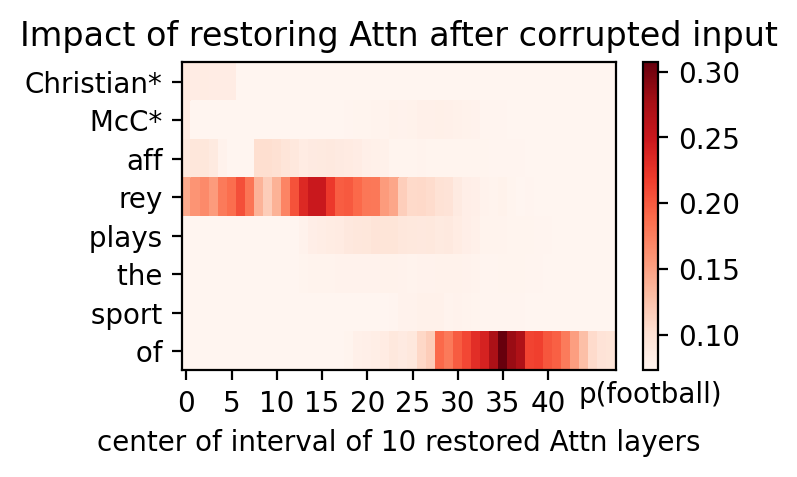

Threshold:  tensor(0.2568)

Highly Activated Neurons:
Layer:  12  Token:  3
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  23  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7
Layer:  45  Token:  7
Layer:  46  Token:  7
Layer:  47  Token:  7



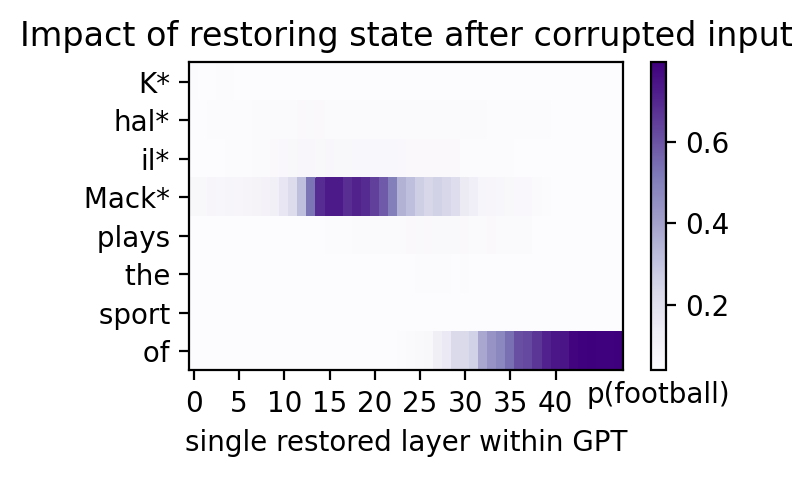

Threshold:  tensor(0.0900)

Highly Activated Neurons:
Layer:  19  Token:  2
Layer:  20  Token:  2
Layer:  16  Token:  3
Layer:  17  Token:  3
Layer:  18  Token:  3
Layer:  19  Token:  3
Layer:  20  Token:  3
Layer:  21  Token:  3
Layer:  22  Token:  3
Layer:  24  Token:  3
Layer:  25  Token:  3
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7



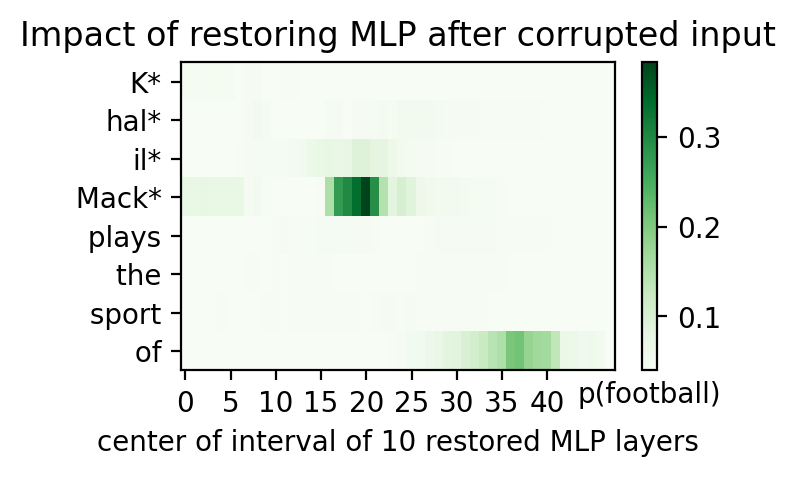

Threshold:  tensor(0.0908)

Highly Activated Neurons:
Layer:  13  Token:  3
Layer:  14  Token:  3
Layer:  15  Token:  3
Layer:  16  Token:  3
Layer:  23  Token:  7
Layer:  24  Token:  7
Layer:  25  Token:  7
Layer:  26  Token:  7
Layer:  27  Token:  7
Layer:  28  Token:  7
Layer:  29  Token:  7
Layer:  30  Token:  7
Layer:  31  Token:  7
Layer:  32  Token:  7
Layer:  33  Token:  7
Layer:  34  Token:  7
Layer:  35  Token:  7
Layer:  36  Token:  7
Layer:  37  Token:  7
Layer:  38  Token:  7
Layer:  39  Token:  7
Layer:  40  Token:  7
Layer:  41  Token:  7
Layer:  42  Token:  7
Layer:  43  Token:  7
Layer:  44  Token:  7



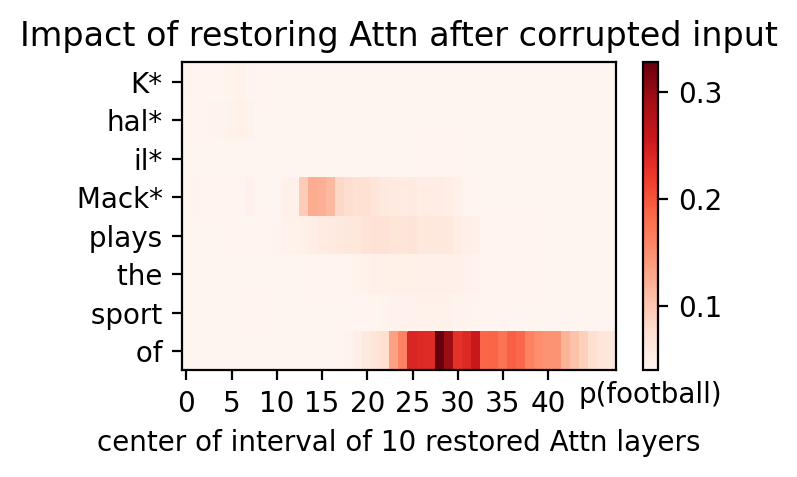

In [ ]:
prompts = [
    "Tom Brady plays the sport of",
    "Aaron Rodgers plays the sport of",
    "Russell Wilson plays the sport of",
    "Lamar Jackson plays the sport of",
    "Patrick Mahomes plays the sport of",
    "Derrick Henry plays the sport of",
    "J.J. Watt plays the sport of",
    "Travis Kelce plays the sport of",
    "Christian McCaffrey plays the sport of",
    "Khalil Mack plays the sport of"
]
for prompt in prompts:
    plot_all_flow(mt, prompt, noise=noise_level)